In [ ]:
!pip install tsai

     |████████████████████████████████| 234 kB 4.3 MB/s 
     |████████████████████████████████| 2.5 MB 22.0 MB/s 
     |████████████████████████████████| 188 kB 52.3 MB/s 
     |████████████████████████████████| 60 kB 7.9 MB/s 
  Attempting uninstall: fastai
    Found existing installation: fastai 1.0.61
    Uninstalling fastai-1.0.61:
      Successfully uninstalled fastai-1.0.61


需要修改一下/usr/local/lib/python3.7/dist-packages/tsai-0.2.26-py3.7.egg/tsai/models/utils.py这里的内容。添加一个NewModel或者之类的东西。再次手动增加内容。
后续可以考虑添加对应的包，直接在安装的时候成功。
同时如果针对LSTM-FCN，需要添加一个参数输入的内容

In [ ]:
from google.colab import drive
import os
drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Thesis_exp')
!ls

Mounted at /content/drive
ACSF1_raw_data.csv
Adiac_raw_data.csv
AllGestureWiimoteX_raw_data.csv
AllGestureWiimoteY_raw_data.csv
AllGestureWiimoteZ_raw_data.csv
ArrowHead_raw_data.csv
Beef_raw_data.csv
BeetleFly_raw_data.csv
BirdChicken_raw_data.csv
BME_raw_data.csv
Car_raw_data.csv
CBF_raw_data.csv
Chinatown_raw_data.csv
ChlorineConcentration_raw_data.csv
CinCECGTorso_raw_data.csv
Coffee_raw_data.csv
Computers_raw_data.csv
CricketX_raw_data.csv
CricketY_raw_data.csv
CricketZ_raw_data.csv
data
DiatomSizeReduction_raw_data.csv
DistalPhalanxOutlineAgeGroup_raw_data.csv
DistalPhalanxOutlineCorrect_raw_data.csv
DistalPhalanxTW_raw_data.csv
Earthquakes_raw_data.csv
ECG200_raw_data.csv
ECG5000_raw_data.csv
ECGFiveDays_raw_data.csv
EOGHorizontalSignal_raw_data.csv
EOGVerticalSignal_raw_data.csv
EthanolLevel_raw_data.csv
FaceAll_raw_data.csv
FaceFour_raw_data.csv
FacesUCR_raw_data.csv
FiftyWords_raw_data.csv
Fish_raw_data.csv
FordA_raw_data.csv
FreezerRegularTrain_raw_data.csv
FreezerSmallTrain

In [ ]:
from tsai.all import *
import os
computer_setup()


os             : Linux-5.4.144+-x86_64-with-Ubuntu-18.04-bionic
python         : 3.7.13
tsai           : 0.3.0
fastai         : 2.5.6
fastcore       : 1.4.2
torch          : 1.10.0+cu111
n_cpus         : 4
device         : cuda (Tesla P100-PCIE-16GB)


In [ ]:
# coding:UTF-8
# V2, ResNet Imporve


from tsai.imports import *
from tsai.utils import *
from torch.nn.init import normal_
from fastai.torch_core import Module
from fastai.layers import *
from torch.nn.utils import weight_norm, spectral_norm

Convolution = [8, 16, 32, 64, 128, 256]
# ZeroOp, 默认
# MaxPooling, 默认
# Dropout, 0-0.5之间
# Activate = {1: 'softmax', 2: 'elu', 3: 'Relu', 4: 'selu', 5: 'sigmoid'}
Activate = ['softmax', 'elu', 'Relu', 'selu', 'sigmoid']
Dense = [8, 16, 32, 64, 128, 256]



from tsai.imports import *
from tsai.utils import *
from torch.nn.init import normal_
from fastai.torch_core import Module
from fastai.layers import *
from torch.nn.utils import weight_norm, spectral_norm


# DenseBlock
class DenseBlock(nn.Sequential):
    "Create a sequence of conv1d (`ni` to `nf`), activation (if `act_cls`) and `norm_type` layers."
    def __init__(self, cin, cout, **kwargs):
        layers = []
        layers += nn.Linear(cin, cout)
        layers += nn.ReLU()
        super().__init__(*layers)
        # 找到此时ConvBlock的父类Sequential, 随后调用它的初始化函数



class NewModel(Module):
    def __init__(self, c_in, c_out, seq_len=None, hidden_size=100, rnn_layers=1, bias=True, cell_dropout=0,
                 rnn_dropout=0.8, bidirectional=False, shuffle=True,
                 fc_dropout=0., conv_layers=[128, 256, 128], kss=[7, 5, 3], se=0, Phenotype=[]):
        if shuffle: assert seq_len is not None, 'need seq_len if shuffle=True'

        # RNN
        front_output = conv_layers[2]
        self.rnn = nn.LSTM(seq_len if shuffle else c_in, hidden_size, num_layers=rnn_layers, bias=bias,
                              batch_first=True,
                              dropout=cell_dropout, bidirectional=bidirectional)
        self.rnn_dropout = nn.Dropout(rnn_dropout) if rnn_dropout else noop
        self.shuffle = Permute(0, 2,
                               1) if not shuffle else noop  # You would normally permute x. Authors did the opposite.
        print(seq_len)
        # FCN，主要解决下方cnn部分的内容
        assert len(conv_layers) == len(kss)

        # 卷积之后，再加一层池化、激活函数
        self.convblock1 = ConvBlock(c_in, conv_layers[0], kss[0])
        self.se1 = SqueezeExciteBlock(conv_layers[0], se) if se != 0 else noop

        self.convblock2 = ConvBlock(conv_layers[0], conv_layers[1], kss[1])
        self.se2 = SqueezeExciteBlock(conv_layers[1], se) if se != 0 else noop

        self.convblock3 = ConvBlock(conv_layers[1], conv_layers[2], kss[2])

        
        self.add_layer1, front_output = self._make_layer(Phenotype[0], front_output)
        self.add_layer2, front_output = self._make_layer(Phenotype[1], front_output)
        self.add_layer3, front_output = self._make_layer(Phenotype[2], front_output)
        self.add_layer4, front_output = self._make_layer(Phenotype[3], front_output)
        self.add_layer5, front_output = self._make_layer(Phenotype[4], front_output)
        self.add_layer6, front_output = self._make_layer(Phenotype[5], front_output)
        self.add_layer7, front_output = self._make_layer(Phenotype[6], front_output)
        self.add_layer8, front_output = self._make_layer(Phenotype[7], front_output)
        self.add_layer9, front_output = self._make_layer(Phenotype[8], front_output)
        self.add_layer10, front_output = self._make_layer(Phenotype[9], front_output)
        self.add_layer11, front_output = self._make_layer(Phenotype[10], front_output)
        self.add_layer12, front_output = self._make_layer(Phenotype[11], front_output)
        self.add_layer13, front_output = self._make_layer(Phenotype[12], front_output)
        self.add_layer14, front_output = self._make_layer(Phenotype[13], front_output)
        self.add_layer15, front_output = self._make_layer(Phenotype[14], front_output)


        self.gap = GAP1d(1)

        # Common
        self.concat = Concat()
        self.fc_dropout = nn.Dropout(fc_dropout) if fc_dropout else noop
        self.fc = nn.Linear(hidden_size * (1 + bidirectional) + front_output, c_out)
        

    def forward(self, x):
        # RNN
        rnn_input = self.shuffle(x)  # permute --> (batch_size, seq_len, n_vars) when batch_first=True
        output, _ = self.rnn(rnn_input)
        last_out = output[:, -1]  # output of last sequence step (many-to-one)
        last_out = self.rnn_dropout(last_out)

        # FCN
        x = self.convblock1(x)
        x = self.se1(x)
        x = self.convblock2(x)
        x = self.se2(x)
        x = self.convblock3(x)

        
        if self.add_layer1 != 0:
            if isinstance(self.add_layer1, nn.MaxPool1d):
                x, indices = self.add_layer1(x)
                x = nn.MaxUnpool1d(self.add_layer1.kernel_size, self.add_layer1.stride)(x, indices)
            elif isinstance(self.add_layer1, nn.Linear):
                x = torch.transpose(x, 1, 2)
                x = self.add_layer1(x)
                x = torch.transpose(x, 1, 2)
            else:
                x = self.add_layer1(x)  
  
        if self.add_layer2 != 0:
            if isinstance(self.add_layer2, nn.MaxPool1d):
                x, indices = self.add_layer2(x)
                x = nn.MaxUnpool1d(self.add_layer2.kernel_size, self.add_layer2.stride)(x, indices)
            elif isinstance(self.add_layer2, nn.Linear):
                x = torch.transpose(x, 1, 2)
                x = self.add_layer2(x)
                x = torch.transpose(x, 1, 2)
            else:
                x = self.add_layer2(x)  
          
        if self.add_layer3 != 0:
          if isinstance(self.add_layer3, nn.MaxPool1d):
              x, indices = self.add_layer3(x)
              x = nn.MaxUnpool1d(self.add_layer3.kernel_size, self.add_layer3.stride)(x, indices)
          elif isinstance(self.add_layer3, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer3(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer3(x)  
        
        if self.add_layer4 != 0:
          if isinstance(self.add_layer4, nn.MaxPool1d):
              x, indices = self.add_layer4(x)
              x = nn.MaxUnpool1d(self.add_layer4.kernel_size, self.add_layer4.stride)(x, indices)
          elif isinstance(self.add_layer4, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer4(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer4(x)  
        
        if self.add_layer5 != 0:
          if isinstance(self.add_layer5, nn.MaxPool1d):
              x, indices = self.add_layer5(x)
              x = nn.MaxUnpool1d(self.add_layer5.kernel_size, self.add_layer5.stride)(x, indices)
          elif isinstance(self.add_layer5, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer5(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer5(x)  
        
        if self.add_layer6 != 0:
          if isinstance(self.add_layer6, nn.MaxPool1d):
              x, indices = self.add_layer6(x)
              x = nn.MaxUnpool1d(self.add_layer6.kernel_size, self.add_layer6.stride)(x, indices)
          elif isinstance(self.add_layer6, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer6(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer6(x)  
        
        if self.add_layer7 != 0:
          if isinstance(self.add_layer7, nn.MaxPool1d):
              x, indices = self.add_layer7(x)
              x = nn.MaxUnpool1d(self.add_layer7.kernel_size, self.add_layer7.stride)(x, indices)
          elif isinstance(self.add_layer7, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer7(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer7(x)  
        
        if self.add_layer8 != 0:
          if isinstance(self.add_layer8, nn.MaxPool1d):
              x, indices = self.add_layer8(x)
              x = nn.MaxUnpool1d(self.add_layer8.kernel_size, self.add_layer8.stride)(x, indices)
          elif isinstance(self.add_layer8, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer8(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer8(x)  
        
        if self.add_layer9 != 0:
          if isinstance(self.add_layer9, nn.MaxPool1d):
              x, indices = self.add_layer9(x)
              x = nn.MaxUnpool1d(self.add_layer9.kernel_size, self.add_layer9.stride)(x, indices)
          elif isinstance(self.add_layer9, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer9(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer9(x)  
        
        if self.add_layer10 != 0:
          if isinstance(self.add_layer10, nn.MaxPool1d):
              x, indices = self.add_layer10(x)
              x = nn.MaxUnpool1d(self.add_layer10.kernel_size, self.add_layer10.stride)(x, indices)
          elif isinstance(self.add_layer10, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer10(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer10(x)  
        
        if self.add_layer11 != 0:
          if isinstance(self.add_layer11, nn.MaxPool1d):
              x, indices = self.add_layer11(x)
              x = nn.MaxUnpool1d(self.add_layer11.kernel_size, self.add_layer11.stride)(x, indices)
          elif isinstance(self.add_layer11, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer11(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer11(x)  
        
        if self.add_layer12 != 0:
          if isinstance(self.add_layer12, nn.MaxPool1d):
              x, indices = self.add_layer12(x)
              x = nn.MaxUnpool1d(self.add_layer12.kernel_size, self.add_layer12.stride)(x, indices)
          elif isinstance(self.add_layer12, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer12(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer12(x)  
        
        if self.add_layer13 != 0:
          if isinstance(self.add_layer13, nn.MaxPool1d):
              x, indices = self.add_layer13(x)
              x = nn.MaxUnpool1d(self.add_layer13.kernel_size, self.add_layer13.stride)(x, indices)
          elif isinstance(self.add_layer13, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer13(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer13(x)  
        
        if self.add_layer14 != 0:
          if isinstance(self.add_layer14, nn.MaxPool1d):
              x, indices = self.add_layer14(x)
              x = nn.MaxUnpool1d(self.add_layer14.kernel_size, self.add_layer14.stride)(x, indices)
          elif isinstance(self.add_layer14, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer14(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer14(x)  
        
        if self.add_layer15 != 0:
          if isinstance(self.add_layer15, nn.MaxPool1d):
              x, indices = self.add_layer15(x)
              x = nn.MaxUnpool1d(self.add_layer15.kernel_size, self.add_layer15.stride)(x, indices)
          elif isinstance(self.add_layer15, nn.Linear):
              x = torch.transpose(x, 1, 2)
              x = self.add_layer15(x)
              x = torch.transpose(x, 1, 2)
          else:
              x = self.add_layer15(x)  




        x = self.gap(x)

        # Concat
        x = self.concat([last_out, x])
        x = self.fc_dropout(x)
        x = self.fc(x)

        return x
    
    
    def _make_layer(self, Phenotype, front_output):
        # Make layer by Phenotype
        if Phenotype[0] == 0:  # conv
            out_size = Convolution[int(Phenotype[1])]            
            return ConvBlock(front_output, out_size, 3), out_size
        
        elif Phenotype[0] == 1:  # ZeroOp
            return 0, front_output

        elif Phenotype[0] == 2:  # Maxpooling, Pooling size = 3, zero padding.
            return nn.MaxPool1d(kernel_size=3, stride=1, padding=0, return_indices=True), front_output

        elif Phenotype[0] == 3:  # Dropout
            dropout_rate = Phenotype[1]
            return nn.Dropout(dropout_rate), front_output

        elif Phenotype[0] == 4: # Activate
            if Phenotype[1] == 0:
                act = nn.Softmax()
            elif Phenotype[1] == 1:
                act = nn.ELU()
            elif Phenotype[1] == 2:
                act = nn.ReLU()
            elif Phenotype[1] == 3:
                act = nn.SELU()
            elif Phenotype[1] == 4:
                act = nn.Sigmoid()
            return act, front_output

        elif Phenotype[0] == 5: # FC
            out_size = Dense[int(Phenotype[1])]
            return nn.Linear(front_output, out_size), out_size



Currently dataset is DodgerLoopDay
(158, 1, 288)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/DodgerLoopDay_0_0.pkl
保存成功 ./generation/DodgerLoopDay_0_1.pkl
保存成功 ./generation/DodgerLoopDay_0_2.pkl
保存成功 ./generation/DodgerLoopDay_0_3.pkl
保存成功 ./generation/DodgerLoopDay_0_4.pkl
保存成功 ./generation/DodgerLoopDay_0_5.pkl
保存成功 ./generation/DodgerLoopDay_0_6.pkl
保存成功 ./generation/DodgerLoopDay_0_7.pkl
保存成功 ./generation/DodgerLoopDay_0_8.pkl
保存成功 ./generation/DodgerLoopDay_0_9.pkl
完成种群记录
第1个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=

epoch,train_loss,valid_loss,accuracy,time
0,1.967738,1.947638,0.212500,00:00
1,1.950646,1.946953,0.225000,00:00
2,1.957888,1.946054,0.225000,00:00
3,1.958038,1.945097,0.225000,00:00
4,1.956582,1.943727,0.237500,00:00
5,1.961462,1.941924,0.250000,00:00
6,1.960247,1.939780,0.250000,00:00
7,1.955122,1.937372,0.275000,00:00
8,1.953006,1.934158,0.300000,00:00
9,1.951706,1.930653,0.300000,00:00


训练耗时:4
第2个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,1.998145,1.943030,0.187500,00:00
1,1.975998,1.942384,0.200000,00:00
2,1.982789,1.941429,0.200000,00:00
3,1.978823,1.940036,0.212500,00:00
4,1.973186,1.938328,0.200000,00:00
5,1.972206,1.936431,0.200000,00:00
6,1.970281,1.933985,0.212500,00:00
7,1.959233,1.930825,0.212500,00:00
8,1.954438,1.926701,0.212500,00:00
9,1.955930,1.921976,0.250000,00:00


训练耗时:6
第3个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer4): Dropout(p=0.36085510033196144, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=Fals

epoch,train_loss,valid_loss,accuracy,time
0,1.982894,1.945135,0.137500,00:00
1,1.972694,1.943720,0.137500,00:00
2,1.980490,1.942166,0.137500,00:00
3,1.971247,1.940270,0.137500,00:00
4,1.967121,1.938006,0.150000,00:00
5,1.966890,1.935303,0.175000,00:00
6,1.969182,1.932085,0.175000,00:00
7,1.965837,1.928246,0.175000,00:00
8,1.961399,1.923825,0.200000,00:00
9,1.955682,1.918873,0.225000,00:00


训练耗时:4
第4个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4106706851700236, inplace=False)
  (add_layer2): Sigmoid()
  (add_layer3): Dropout(p=0.19424461947549193, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilati

epoch,train_loss,valid_loss,accuracy,time
0,1.958943,1.941283,0.137500,00:00
1,1.957559,1.940511,0.137500,00:00
2,1.959538,1.939886,0.137500,00:00
3,1.968543,1.938485,0.137500,00:00
4,1.966056,1.936911,0.137500,00:00
5,1.964391,1.934767,0.137500,00:00
6,1.959449,1.932537,0.137500,00:00
7,1.963276,1.929868,0.150000,00:00
8,1.958723,1.925988,0.162500,00:00
9,1.961602,1.921330,0.187500,00:00


训练耗时:5
第5个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,1.974820,1.939512,0.137500,00:00
1,1.967474,1.938910,0.137500,00:00
2,1.967191,1.937883,0.137500,00:00
3,1.964058,1.936611,0.137500,00:00
4,1.958283,1.934904,0.137500,00:00
5,1.952726,1.932695,0.137500,00:00
6,1.953774,1.929939,0.137500,00:00
7,1.953627,1.926719,0.137500,00:00
8,1.952597,1.922663,0.137500,00:00
9,1.949682,1.917619,0.137500,00:00


训练耗时:6
第6个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer4): Linear(in_features=128, out_features=128, bias=True)
  (add_layer5): Dropout(p=0.14038324899797044, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=Fa

epoch,train_loss,valid_loss,accuracy,time
0,1.980522,1.972107,0.125000,00:00
1,1.994155,1.971535,0.137500,00:00
2,2.005250,1.970512,0.125000,00:00
3,1.996637,1.969049,0.125000,00:00
4,1.988579,1.967116,0.125000,00:00
5,1.986802,1.964390,0.125000,00:00
6,1.975123,1.961055,0.125000,00:00
7,1.966361,1.956494,0.125000,00:00
8,1.962662,1.951531,0.137500,00:00
9,1.959688,1.945361,0.137500,00:00


训练耗时:5
第7个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): Dropout(p=0.2076478838791141, inplace=False)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): Dropout(p=0.05661304666742162, inplace=False)
  (

epoch,train_loss,valid_loss,accuracy,time
0,2.010620,1.970766,0.125000,00:00
1,1.992545,1.969501,0.125000,00:00
2,1.989582,1.968123,0.125000,00:00
3,1.980882,1.966056,0.125000,00:00
4,1.980132,1.964179,0.125000,00:00
5,1.980033,1.961241,0.125000,00:00
6,1.977839,1.958120,0.125000,00:00
7,1.971953,1.954143,0.125000,00:00
8,1.969644,1.949664,0.125000,00:00
9,1.968500,1.944329,0.162500,00:00


训练耗时:4
第8个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )

epoch,train_loss,valid_loss,accuracy,time
0,1.955883,1.940537,0.150000,00:00
1,1.957642,1.939880,0.162500,00:00
2,1.960115,1.938948,0.162500,00:00
3,1.951245,1.937742,0.162500,00:00
4,1.944844,1.936257,0.162500,00:00
5,1.946445,1.934400,0.162500,00:00
6,1.946213,1.931975,0.162500,00:00
7,1.948734,1.929017,0.175000,00:00
8,1.946252,1.925621,0.187500,00:00
9,1.942655,1.921424,0.200000,00:00


训练耗时:5
第9个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
 

epoch,train_loss,valid_loss,accuracy,time
0,1.939401,1.948482,0.200000,00:00
1,1.948088,1.947076,0.200000,00:00
2,1.956717,1.945492,0.200000,00:00
3,1.954821,1.943821,0.200000,00:00
4,1.951442,1.941848,0.200000,00:00
5,1.948685,1.939598,0.212500,00:00
6,1.947314,1.937048,0.225000,00:00
7,1.945137,1.934275,0.225000,00:00
8,1.946579,1.931222,0.250000,00:00
9,1.939888,1.927782,0.262500,00:00


训练耗时:5
第10个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,1.965799,1.973711,0.137500,00:00
1,1.978622,1.966663,0.137500,00:00
2,1.988628,1.962208,0.125000,00:00
3,1.988884,1.958395,0.112500,00:00
4,1.985393,1.954944,0.100000,00:00
5,1.983991,1.951250,0.137500,00:00
6,1.979580,1.947232,0.162500,00:00
7,1.979592,1.942818,0.150000,00:00
8,1.974440,1.937358,0.150000,00:00
9,1.968130,1.932006,0.200000,00:00


训练耗时:6

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/DodgerLoopDay_1_0.pkl
保存成功./generation/DodgerLoopDay_1_1.pkl
保存成功./generation/DodgerLoopDay_1_2.pkl
保存成功./generation/DodgerLoopDay_1_3.pkl
保存成功./generation/DodgerLoopDay_1_4.pkl
保存成功./generation/DodgerLoopDay_1_5.pkl
保存成功./generation/DodgerLoopDay_1_6.pkl
保存成功./generation/DodgerLoopDay_1_7.pkl
保存成功./generation/DodgerLoopDay_1_8.pkl
保存成功./generation/DodgerLoopDay_1_9.pkl
完成种群记录
Parent_fitness: [[0.48750001]
 [0.5625    ]
 [0.55000001]
 [0.38750002]
 [0.5       ]
 [0.48750001]
 [0.53750002]
 [0.46250001]
 [0.52500004]
 [0.53750002]]
第1个变异个体
子代个体基因型受限
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvB

epoch,train_loss,valid_loss,accuracy,time
0,1.962557,1.947506,0.187500,00:00
1,1.959572,1.946859,0.175000,00:00
2,1.965420,1.946146,0.162500,00:00
3,1.963039,1.945117,0.162500,00:00
4,1.959879,1.943434,0.162500,00:00
5,1.962476,1.941355,0.150000,00:00
6,1.959855,1.938893,0.162500,00:00
7,1.959891,1.935916,0.162500,00:00
8,1.960739,1.932291,0.187500,00:00
9,1.953929,1.928188,0.212500,00:00


训练耗时:6
Mutate better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer4): Dropout(p=0.36085510033196144, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1

epoch,train_loss,valid_loss,accuracy,time
0,1.936100,1.953077,0.100000,00:00
1,1.953677,1.952036,0.100000,00:00
2,1.961940,1.950829,0.100000,00:00
3,1.954381,1.949367,0.100000,00:00
4,1.948505,1.947602,0.100000,00:00
5,1.954384,1.945335,0.125000,00:00
6,1.957804,1.942439,0.150000,00:00
7,1.956847,1.938992,0.200000,00:00
8,1.956015,1.934945,0.212500,00:00
9,1.954553,1.930045,0.225000,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.985713,1.948937,0.062500,00:00
1,1.978543,1.948052,0.062500,00:00
2,1.970391,1.946916,0.062500,00:00
3,1.978452,1.945409,0.062500,00:00
4,1.963105,1.943590,0.075000,00:00
5,1.966080,1.941316,0.075000,00:00
6,1.964144,1.938465,0.062500,00:00
7,1.961520,1.935055,0.125000,00:00
8,1.960401,1.931185,0.137500,00:00
9,1.959176,1.926367,0.137500,00:00


训练耗时:6
Mutate better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer4): Linear(in_features=128, out_features=128, bias=True)
  (add_layer5): Dropout(p=0.14038324899797044, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation

epoch,train_loss,valid_loss,accuracy,time
0,1.950092,1.921012,0.237500,00:00
1,1.964561,1.920240,0.212500,00:00
2,1.963128,1.919705,0.212500,00:00
3,1.952193,1.918526,0.175000,00:00
4,1.955743,1.917164,0.187500,00:00
5,1.956570,1.915301,0.187500,00:00
6,1.952303,1.912739,0.187500,00:00
7,1.948278,1.909585,0.187500,00:00
8,1.941905,1.905517,0.200000,00:00
9,1.942045,1.900357,0.250000,00:00


训练耗时:5
Mutate better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): Dropout(p=0.05661304666742162, inplace=False)
  (add_layer6): Dropout(p=0.4712527643882997, in

epoch,train_loss,valid_loss,accuracy,time
0,1.962745,1.943151,0.150000,00:00
1,1.968927,1.942621,0.150000,00:00
2,1.973636,1.942125,0.150000,00:00
3,1.972151,1.940653,0.162500,00:00
4,1.966662,1.938889,0.162500,00:00
5,1.959009,1.936817,0.162500,00:00
6,1.956662,1.934170,0.162500,00:00
7,1.957221,1.930852,0.162500,00:00
8,1.953355,1.927220,0.162500,00:00
9,1.953476,1.922807,0.162500,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.993612,1.952279,0.162500,00:00
1,1.987942,1.951546,0.162500,00:00
2,1.980053,1.950638,0.175000,00:00
3,1.971717,1.949426,0.175000,00:00
4,1.969387,1.947809,0.175000,00:00
5,1.975836,1.945725,0.175000,00:00
6,1.971229,1.943115,0.187500,00:00
7,1.966199,1.939812,0.200000,00:00
8,1.962037,1.936013,0.212500,00:00
9,1.966018,1.931624,0.212500,00:00


训练耗时:5
Mutate better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.963803,1.956386,0.137500,00:00
1,1.954692,1.954740,0.125000,00:00
2,1.953581,1.953062,0.112500,00:00
3,1.947049,1.951161,0.125000,00:00
4,1.947103,1.948981,0.125000,00:00
5,1.945590,1.946520,0.125000,00:00
6,1.941346,1.943730,0.112500,00:00
7,1.937898,1.940454,0.125000,00:00
8,1.935218,1.936777,0.137500,00:00
9,1.933114,1.932380,0.187500,00:00


训练耗时:6
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer4): SELU()
  (add_layer5): Dropout(p=0.39677009186132045, inplace=False)
  (add_layer9): SELU()
  (add_layer10): Dropout(p=0.40978925838030233, inplace=False)
  (add_layer11): MaxPool1d(ke

epoch,train_loss,valid_loss,accuracy,time
0,2.016342,1.986675,0.137500,00:00
1,1.995556,1.971091,0.100000,00:00
2,1.985882,1.962431,0.075000,00:00
3,1.983821,1.956771,0.087500,00:00
4,1.972391,1.952263,0.087500,00:00
5,1.967970,1.948229,0.087500,00:00
6,1.966893,1.943972,0.125000,00:00
7,1.964656,1.939433,0.125000,00:00
8,1.961113,1.934140,0.137500,00:00
9,1.959178,1.928643,0.150000,00:00


训练耗时:5
Parent Better
Select完成
After selection [[0.48750001]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.51249999]
 [0.5       ]
 [0.53750002]
 [0.5       ]
 [0.52500004]
 [0.53750002]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.888521,1.940681,0.162500,00:00
1,1.920402,1.939675,0.162500,00:00
2,1.923660,1.938573,0.162500,00:00
3,1.922633,1.937243,0.200000,00:00
4,1.923050,1.935607,0.200000,00:00
5,1.926602,1.933294,0.237500,00:00
6,1.924694,1.930397,0.237500,00:00
7,1.923064,1.926868,0.262500,00:00
8,1.922815,1.922280,0.275000,00:00
9,1.918205,1.917022,0.287500,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer4): Dropout(p=0.36085510033196144, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1

epoch,train_loss,valid_loss,accuracy,time
0,1.983249,1.969901,0.050000,00:00
1,1.966889,1.968080,0.050000,00:00
2,1.965852,1.966164,0.075000,00:00
3,1.966796,1.964021,0.075000,00:00
4,1.961562,1.961448,0.087500,00:00
5,1.962241,1.958441,0.087500,00:00
6,1.965363,1.954859,0.087500,00:00
7,1.964069,1.950618,0.100000,00:00
8,1.961097,1.945929,0.112500,00:00
9,1.960113,1.940649,0.125000,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.960982,1.950423,0.050000,00:00
1,1.953786,1.949632,0.075000,00:00
2,1.955836,1.948756,0.075000,00:00
3,1.961226,1.947412,0.075000,00:00
4,1.969764,1.945839,0.087500,00:00
5,1.967034,1.943645,0.112500,00:00
6,1.965547,1.940947,0.137500,00:00
7,1.961938,1.937770,0.150000,00:00
8,1.960878,1.933928,0.162500,00:00
9,1.959991,1.929696,0.187500,00:00


训练耗时:7
Mutate better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Dropout(p=0.4333626056653481, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.002558509501489392, i

epoch,train_loss,valid_loss,accuracy,time
0,1.927178,1.943755,0.175000,00:00
1,1.940575,1.942517,0.175000,00:00
2,1.944429,1.941146,0.175000,00:00
3,1.958139,1.939474,0.175000,00:00
4,1.948156,1.937547,0.187500,00:00
5,1.948481,1.935052,0.175000,00:00
6,1.950853,1.932147,0.187500,00:00
7,1.945573,1.928712,0.187500,00:00
8,1.947997,1.924892,0.200000,00:00
9,1.946833,1.920357,0.200000,00:00


训练耗时:5
Mutate better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): Dropout(p=0.2076478838791141, inplace=False)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, in

epoch,train_loss,valid_loss,accuracy,time
0,1.969869,1.950801,0.187500,00:00
1,1.979216,1.950099,0.187500,00:00
2,1.974662,1.948799,0.187500,00:00
3,1.975651,1.947418,0.187500,00:00
4,1.973976,1.945631,0.200000,00:00
5,1.972287,1.943615,0.200000,00:00
6,1.968492,1.940888,0.212500,00:00
7,1.962711,1.937847,0.212500,00:00
8,1.964192,1.934008,0.200000,00:00
9,1.962663,1.929600,0.212500,00:00


训练耗时:5
Mutate better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.970428,1.974317,0.125000,00:00
1,1.976922,1.969610,0.125000,00:00
2,1.981191,1.965718,0.125000,00:00
3,1.977468,1.962615,0.137500,00:00
4,1.970191,1.959711,0.125000,00:00
5,1.967811,1.956157,0.150000,00:00
6,1.966227,1.952044,0.175000,00:00
7,1.964162,1.946139,0.175000,00:00
8,1.956366,1.939304,0.200000,00:00
9,1.949680,1.932322,0.225000,00:00


训练耗时:6
Mutate better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.969825,1.953260,0.175000,00:00
1,1.965972,1.952662,0.150000,00:00
2,1.950316,1.951529,0.150000,00:00
3,1.955966,1.949638,0.150000,00:00
4,1.961081,1.947212,0.150000,00:00
5,1.958211,1.944188,0.162500,00:00
6,1.951109,1.940342,0.175000,00:00
7,1.946614,1.935921,0.187500,00:00
8,1.944200,1.930967,0.200000,00:00
9,1.948857,1.925077,0.212500,00:00


训练耗时:6
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=256, bias=True)
  (add_layer4): SELU()
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): C

epoch,train_loss,valid_loss,accuracy,time
0,1.963605,1.957220,0.100000,00:00
1,1.964412,1.955482,0.100000,00:00
2,1.954894,1.954042,0.100000,00:00
3,1.950457,1.953105,0.112500,00:00
4,1.956596,1.950805,0.087500,00:00
5,1.954032,1.948633,0.087500,00:00
6,1.952129,1.945583,0.100000,00:00
7,1.952673,1.941711,0.100000,00:00
8,1.952156,1.936983,0.112500,00:00
9,1.948538,1.931757,0.175000,00:00


训练耗时:6
Parent Better
Select完成
After selection [[0.48750001]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.53750002]
 [0.51249999]
 [0.55000001]
 [0.51249999]
 [0.52500004]
 [0.53750002]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.984171,1.957636,0.137500,00:00
1,1.989964,1.956309,0.125000,00:00
2,1.974194,1.955354,0.112500,00:00
3,1.971852,1.953950,0.100000,00:00
4,1.972404,1.952161,0.100000,00:00
5,1.976072,1.949895,0.112500,00:00
6,1.970618,1.947110,0.112500,00:00
7,1.966424,1.943654,0.137500,00:00
8,1.965498,1.939351,0.112500,00:00
9,1.962424,1.934071,0.112500,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.958365,1.947019,0.100000,00:00
1,1.958605,1.946122,0.112500,00:00
2,1.953594,1.944970,0.112500,00:00
3,1.955226,1.943441,0.125000,00:00
4,1.958509,1.941399,0.137500,00:00
5,1.957290,1.938689,0.137500,00:00
6,1.955598,1.935296,0.150000,00:00
7,1.958352,1.931101,0.162500,00:00
8,1.955217,1.926111,0.175000,00:00
9,1.955942,1.920249,0.162500,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.984115,1.982000,0.050000,00:00
1,1.987155,1.981148,0.062500,00:00
2,1.980439,1.979652,0.050000,00:00
3,1.993162,1.978230,0.050000,00:00
4,1.989841,1.976406,0.050000,00:00
5,1.991138,1.974075,0.050000,00:00
6,1.986587,1.971208,0.075000,00:00
7,1.982087,1.967652,0.100000,00:00
8,1.977577,1.963280,0.137500,00:00
9,1.969920,1.958331,0.137500,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Dropout(p=0.4333626056653481, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.002558509501489392, i

epoch,train_loss,valid_loss,accuracy,time
0,1.955072,1.959167,0.137500,00:00
1,1.968838,1.954006,0.137500,00:00
2,1.967611,1.949887,0.137500,00:00
3,1.960625,1.946189,0.125000,00:00
4,1.956940,1.942980,0.137500,00:00
5,1.955235,1.939597,0.150000,00:00
6,1.951028,1.936675,0.187500,00:00
7,1.949407,1.933421,0.225000,00:00
8,1.945500,1.930395,0.262500,00:00
9,1.939617,1.926458,0.250000,00:00


训练耗时:5
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=T

epoch,train_loss,valid_loss,accuracy,time
0,1.931455,1.950012,0.100000,00:00
1,1.969994,1.948921,0.112500,00:00
2,1.960288,1.947940,0.137500,00:00
3,1.962025,1.946883,0.125000,00:00
4,1.960045,1.945413,0.137500,00:00
5,1.956045,1.943511,0.137500,00:00
6,1.956260,1.941169,0.175000,00:00
7,1.956400,1.938293,0.225000,00:00
8,1.954347,1.934612,0.275000,00:00
9,1.952091,1.929995,0.300000,00:00


训练耗时:6
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=32, bias=True)
  (add_layer4): Dropout(p=0.12368405434486923, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=

epoch,train_loss,valid_loss,accuracy,time
0,1.940702,1.949459,0.137500,00:00
1,1.925314,1.948094,0.137500,00:00
2,1.926710,1.946578,0.137500,00:00
3,1.929980,1.944805,0.137500,00:00
4,1.933161,1.942719,0.137500,00:00
5,1.937483,1.940200,0.137500,00:00
6,1.937477,1.937221,0.150000,00:00
7,1.940431,1.933806,0.150000,00:00
8,1.938751,1.929873,0.150000,00:00
9,1.938668,1.925375,0.150000,00:00


训练耗时:5
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.971224,1.953758,0.150000,00:00
1,1.964146,1.952682,0.150000,00:00
2,1.963637,1.951643,0.150000,00:00
3,1.961511,1.949819,0.150000,00:00
4,1.958895,1.948128,0.150000,00:00
5,1.965614,1.945563,0.150000,00:00
6,1.967277,1.942191,0.150000,00:00
7,1.964881,1.937882,0.150000,00:00
8,1.962153,1.932581,0.150000,00:00
9,1.958665,1.926184,0.175000,00:00


训练耗时:5
Mutate better
Select完成
After selection [[0.48750001]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.53750002]
 [0.51249999]
 [0.55000001]
 [0.51249999]
 [0.52500004]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.984717,1.956702,0.137500,00:00
1,1.987301,1.955054,0.150000,00:00
2,1.972065,1.953094,0.137500,00:00
3,1.969493,1.951525,0.137500,00:00
4,1.965785,1.950842,0.150000,00:00
5,1.961593,1.948778,0.137500,00:00
6,1.960558,1.946336,0.112500,00:00
7,1.952948,1.943306,0.137500,00:00
8,1.944127,1.938775,0.150000,00:00
9,1.940423,1.935067,0.175000,00:00


训练耗时:6
Parent Better
第3个变异个体
子代个体基因型受限
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1

epoch,train_loss,valid_loss,accuracy,time
0,1.979173,1.947353,0.125000,00:00
1,1.998513,1.946127,0.137500,00:00
2,1.990856,1.944971,0.137500,00:00
3,1.997820,1.943635,0.137500,00:00
4,1.983126,1.941741,0.137500,00:00
5,1.975683,1.938829,0.137500,00:00
6,1.969438,1.935664,0.137500,00:00
7,1.970470,1.931684,0.150000,00:00
8,1.962823,1.927557,0.175000,00:00
9,1.961938,1.922782,0.187500,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,2.024563,1.967643,0.050000,00:00
1,2.008440,1.966505,0.050000,00:00
2,2.016699,1.965188,0.050000,00:00
3,2.013134,1.963655,0.050000,00:00
4,2.012627,1.961902,0.050000,00:00
5,2.004185,1.959631,0.062500,00:00
6,1.997889,1.956675,0.062500,00:00
7,1.992221,1.953179,0.087500,00:00
8,1.987797,1.949367,0.100000,00:00
9,1.982105,1.944860,0.100000,00:00


训练耗时:5
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, inplace=False)
  (add_layer5): Dropout(p=0.05661304666742162, i

epoch,train_loss,valid_loss,accuracy,time
0,1.997850,1.952598,0.175000,00:00
1,1.998920,1.951275,0.187500,00:00
2,1.985519,1.950327,0.212500,00:00
3,1.984758,1.948747,0.212500,00:00
4,1.973974,1.947091,0.212500,00:00
5,1.968480,1.944978,0.212500,00:00
6,1.962646,1.942751,0.212500,00:00
7,1.958107,1.939765,0.200000,00:00
8,1.961111,1.936131,0.212500,00:00
9,1.958486,1.931872,0.200000,00:00


训练耗时:5
Mutate better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.952770,1.949182,0.150000,00:00
1,1.944341,1.948001,0.150000,00:00
2,1.944561,1.946822,0.162500,00:00
3,1.947298,1.945655,0.175000,00:00
4,1.950454,1.944024,0.175000,00:00
5,1.950125,1.941855,0.175000,00:00
6,1.946096,1.939102,0.175000,00:00
7,1.940469,1.936039,0.175000,00:00
8,1.938686,1.932478,0.175000,00:00
9,1.936233,1.928248,0.175000,00:00


训练耗时:5
Mutate better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.979181,1.952054,0.100000,00:00
1,1.953377,1.950717,0.075000,00:00
2,1.953654,1.949333,0.087500,00:00
3,1.954120,1.947889,0.100000,00:00
4,1.957550,1.946174,0.100000,00:00
5,1.953260,1.944167,0.100000,00:00
6,1.952297,1.941793,0.087500,00:00
7,1.947914,1.938851,0.087500,00:00
8,1.946428,1.935587,0.087500,00:00
9,1.943114,1.931746,0.075000,00:00


训练耗时:5
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer4): SELU()
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer10): Dropout(p=0.40978925838030233, inplace=False)
  (add_layer11): MaxPoo

epoch,train_loss,valid_loss,accuracy,time
0,1.946847,1.934193,0.187500,00:00
1,1.954729,1.933113,0.187500,00:00
2,1.963327,1.932059,0.187500,00:00
3,1.952739,1.931126,0.187500,00:00
4,1.947133,1.929527,0.187500,00:00
5,1.946072,1.927597,0.212500,00:00
6,1.948147,1.925011,0.212500,00:00
7,1.942007,1.921665,0.212500,00:00
8,1.939454,1.917677,0.212500,00:00
9,1.934844,1.912710,0.250000,00:00


训练耗时:5
Parent Better
Select完成
After selection [[0.48750001]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.53750002]
 [0.51249999]
 [0.5625    ]
 [0.53750002]
 [0.52500004]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.934231,1.966694,0.087500,00:00
1,1.951882,1.965969,0.087500,00:00
2,1.951878,1.965146,0.100000,00:00
3,1.959039,1.964108,0.100000,00:00
4,1.958395,1.962754,0.112500,00:00
5,1.958674,1.960883,0.112500,00:00
6,1.960528,1.958523,0.112500,00:00
7,1.962273,1.955552,0.112500,00:00
8,1.961365,1.952002,0.112500,00:00
9,1.963157,1.947785,0.112500,00:00


训练耗时:5
Mutate better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.977742,1.950101,0.175000,00:00
1,1.976420,1.948646,0.150000,00:00
2,1.981334,1.947392,0.162500,00:00
3,1.974456,1.946068,0.150000,00:00
4,1.973927,1.944497,0.150000,00:00
5,1.968307,1.942831,0.175000,00:00
6,1.967656,1.940710,0.212500,00:00
7,1.960210,1.937105,0.212500,00:00
8,1.958707,1.932706,0.225000,00:00
9,1.957340,1.927457,0.200000,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer4): Dropout(p=0.36085510033196144, inplace=False)
  (add_layer5): Dropout(p=0.21128750540919244, inplace=False)
  (add_lay

epoch,train_loss,valid_loss,accuracy,time
0,1.948131,1.948641,0.162500,00:00
1,1.951427,1.947565,0.162500,00:00
2,1.959150,1.946330,0.162500,00:00
3,1.972658,1.944824,0.175000,00:00
4,1.970980,1.942963,0.175000,00:00
5,1.967044,1.940634,0.187500,00:00
6,1.966236,1.937817,0.187500,00:00
7,1.972547,1.934333,0.187500,00:00
8,1.965546,1.930163,0.187500,00:00
9,1.966161,1.925169,0.212500,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.956089,1.958614,0.150000,00:00
1,1.976449,1.957433,0.137500,00:00
2,1.975913,1.956173,0.125000,00:00
3,1.967235,1.954762,0.125000,00:00
4,1.962199,1.952767,0.125000,00:00
5,1.961336,1.950345,0.125000,00:00
6,1.959593,1.947412,0.125000,00:00
7,1.956874,1.943859,0.125000,00:00
8,1.951063,1.939692,0.150000,00:00
9,1.945169,1.934897,0.162500,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Dropout(p=0.4333626056653481, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.002558509501489392, i

epoch,train_loss,valid_loss,accuracy,time
0,1.990851,1.964013,0.175000,00:00
1,1.992105,1.962957,0.150000,00:00
2,1.976853,1.962391,0.150000,00:00
3,1.972345,1.961556,0.150000,00:00
4,1.969376,1.960318,0.150000,00:00
5,1.967697,1.958827,0.150000,00:00
6,1.962253,1.956515,0.162500,00:00
7,1.957370,1.953863,0.162500,00:00
8,1.952568,1.950553,0.150000,00:00
9,1.953768,1.946607,0.125000,00:00


训练耗时:5
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=

epoch,train_loss,valid_loss,accuracy,time
0,1.972533,1.957522,0.050000,00:00
1,1.976260,1.956110,0.050000,00:00
2,1.960636,1.954827,0.050000,00:00
3,1.960643,1.953152,0.050000,00:00
4,1.953928,1.951130,0.050000,00:00
5,1.960716,1.948559,0.050000,00:00
6,1.960912,1.946130,0.050000,00:00
7,1.961027,1.942995,0.062500,00:00
8,1.960743,1.938582,0.062500,00:00
9,1.958906,1.934237,0.062500,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.975927,1.946128,0.175000,00:00
1,1.980754,1.945073,0.175000,00:00
2,1.974519,1.944400,0.175000,00:00
3,1.970570,1.943286,0.187500,00:00
4,1.965999,1.942129,0.175000,00:00
5,1.962646,1.940628,0.162500,00:00
6,1.961541,1.938799,0.162500,00:00
7,1.960585,1.936252,0.150000,00:00
8,1.957019,1.933344,0.137500,00:00
9,1.954788,1.929716,0.150000,00:00


训练耗时:5
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.962669,1.955315,0.150000,00:00
1,1.965573,1.954019,0.150000,00:00
2,1.960145,1.952652,0.150000,00:00
3,1.950686,1.951066,0.162500,00:00
4,1.946300,1.949199,0.162500,00:00
5,1.950435,1.947046,0.162500,00:00
6,1.951277,1.944456,0.162500,00:00
7,1.958091,1.941537,0.162500,00:00
8,1.956555,1.938074,0.162500,00:00
9,1.955863,1.933957,0.162500,00:00


训练耗时:5
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer4): SELU()
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.1878346976822558, inplace=False)
  (add_layer9): ConvBlock

epoch,train_loss,valid_loss,accuracy,time
0,2.000107,1.962014,0.125000,00:00
1,2.012439,1.953815,0.125000,00:00
2,1.995838,1.949378,0.137500,00:00
3,1.991304,1.946005,0.125000,00:00
4,1.986944,1.943582,0.100000,00:00
5,1.981508,1.940612,0.112500,00:00
6,1.978374,1.937504,0.137500,00:00
7,1.977207,1.933820,0.150000,00:00
8,1.972818,1.929142,0.200000,00:00
9,1.969289,1.923363,0.250000,00:00


训练耗时:5
Parent Better
Select完成
After selection [[0.51249999]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.53750002]
 [0.51249999]
 [0.5625    ]
 [0.53750002]
 [0.52500004]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.990124,1.956882,0.150000,00:00
1,1.984754,1.956124,0.150000,00:00
2,1.976339,1.955099,0.150000,00:00
3,1.987891,1.953764,0.150000,00:00
4,1.979120,1.952031,0.150000,00:00
5,1.973251,1.949889,0.150000,00:00
6,1.972298,1.947127,0.162500,00:00
7,1.972587,1.943661,0.162500,00:00
8,1.972090,1.939559,0.162500,00:00
9,1.973811,1.934894,0.150000,00:00


训练耗时:5
Mutate better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, ep

epoch,train_loss,valid_loss,accuracy,time
0,1.937957,1.938873,0.162500,00:00
1,1.946435,1.938314,0.175000,00:00
2,1.941408,1.937276,0.175000,00:00
3,1.932667,1.935834,0.175000,00:00
4,1.933649,1.934031,0.187500,00:00
5,1.931767,1.931651,0.187500,00:00
6,1.930617,1.928731,0.187500,00:00
7,1.931291,1.925012,0.187500,00:00
8,1.924242,1.920508,0.212500,00:00
9,1.921510,1.915068,0.212500,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.935895,1.946866,0.162500,00:00
1,1.958399,1.945981,0.162500,00:00
2,1.969786,1.944952,0.175000,00:00
3,1.964653,1.943572,0.175000,00:00
4,1.961919,1.941771,0.175000,00:00
5,1.958962,1.939479,0.175000,00:00
6,1.950915,1.936634,0.187500,00:00
7,1.949659,1.933120,0.187500,00:00
8,1.946465,1.928930,0.200000,00:00
9,1.941244,1.923999,0.237500,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.986848,1.971304,0.150000,00:00
1,1.992693,1.970648,0.150000,00:00
2,1.985165,1.970037,0.150000,00:00
3,1.984106,1.968908,0.150000,00:00
4,1.986386,1.967362,0.150000,00:00
5,1.990283,1.964877,0.150000,00:00
6,1.988138,1.961653,0.150000,00:00
7,1.985050,1.957901,0.162500,00:00
8,1.983552,1.953314,0.162500,00:00
9,1.979768,1.947659,0.162500,00:00


训练耗时:6
Mutate better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.945867,1.933992,0.175000,00:00
1,1.948133,1.932825,0.175000,00:00
2,1.944437,1.932224,0.162500,00:00
3,1.942644,1.931341,0.150000,00:00
4,1.943005,1.930327,0.125000,00:00
5,1.943307,1.928946,0.150000,00:00
6,1.941202,1.927320,0.175000,00:00
7,1.941044,1.924784,0.175000,00:00
8,1.936689,1.922108,0.162500,00:00
9,1.933746,1.919009,0.187500,00:00


训练耗时:5
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, inplace=False)
  (add_layer5): Dropout(p=0.05661304666742162, i

epoch,train_loss,valid_loss,accuracy,time
0,1.957110,1.934876,0.137500,00:00
1,1.968363,1.933588,0.137500,00:00
2,1.952431,1.932283,0.150000,00:00
3,1.941158,1.930248,0.162500,00:00
4,1.939859,1.927805,0.187500,00:00
5,1.942345,1.924982,0.187500,00:00
6,1.941635,1.921575,0.187500,00:00
7,1.937907,1.917255,0.212500,00:00
8,1.941142,1.912801,0.225000,00:00
9,1.941305,1.907527,0.287500,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer4): Dropout(p=0.0780268524634774, inplace=False)
  (add_layer5): Dropout(p=0.18038765061914813, inplace=False)
  (add_layer6): Linear(in_features=128, out_features=256, bias=True)
  (add_la

epoch,train_loss,valid_loss,accuracy,time
0,1.975942,1.976528,0.137500,00:00
1,1.968594,1.974195,0.150000,00:00
2,1.974432,1.971805,0.150000,00:00
3,1.977385,1.968913,0.137500,00:00
4,1.972529,1.965354,0.150000,00:00
5,1.966446,1.961688,0.162500,00:00
6,1.961819,1.957408,0.150000,00:00
7,1.956663,1.952952,0.150000,00:00
8,1.952893,1.948142,0.150000,00:00
9,1.948993,1.943078,0.212500,00:00


训练耗时:5
Parent Better
第9个变异个体
子代个体基因型受限
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.52500004]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.55000001]
 [0.51249999]
 [0.5625    ]
 [0.53750002]
 [0.52500004]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.

epoch,train_loss,valid_loss,accuracy,time
0,1.952004,1.946876,0.150000,00:00
1,1.936545,1.946031,0.162500,00:00
2,1.935112,1.944985,0.162500,00:00
3,1.933264,1.943584,0.175000,00:00
4,1.930649,1.941844,0.175000,00:00
5,1.933912,1.939595,0.187500,00:00
6,1.932601,1.936829,0.200000,00:00
7,1.929302,1.933444,0.187500,00:00
8,1.930147,1.929384,0.187500,00:00
9,1.930038,1.924582,0.212500,00:00


训练耗时:5
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,1.965555,1.947624,0.212500,00:00
1,1.955023,1.947133,0.212500,00:00
2,1.971830,1.946378,0.187500,00:00
3,1.970336,1.945645,0.200000,00:00
4,1.971251,1.944050,0.200000,00:00
5,1.976902,1.942198,0.212500,00:00
6,1.973790,1.939628,0.212500,00:00
7,1.966638,1.936432,0.225000,00:00
8,1.961446,1.932666,0.237500,00:00
9,1.958758,1.928330,0.250000,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): MaxPool1d(kernel_size=3, st

epoch,train_loss,valid_loss,accuracy,time
0,2.001493,1.951982,0.175000,00:00
1,1.977148,1.951012,0.162500,00:00
2,1.974647,1.949891,0.162500,00:00
3,1.981345,1.948507,0.162500,00:00
4,1.976904,1.946712,0.150000,00:00
5,1.975057,1.944449,0.150000,00:00
6,1.973418,1.941699,0.150000,00:00
7,1.970940,1.938315,0.150000,00:00
8,1.969029,1.934273,0.150000,00:00
9,1.966774,1.929621,0.162500,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.963472,1.958441,0.162500,00:00
1,1.964740,1.952518,0.162500,00:00
2,1.969206,1.948119,0.162500,00:00
3,1.969457,1.945978,0.150000,00:00
4,1.963611,1.944045,0.162500,00:00
5,1.963739,1.943290,0.150000,00:00
6,1.962823,1.940846,0.187500,00:00
7,1.957809,1.938841,0.187500,00:00
8,1.956316,1.935971,0.212500,00:00
9,1.955717,1.932762,0.250000,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Dropout(p=0.4333626056653481, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.002558509501489392, i

epoch,train_loss,valid_loss,accuracy,time
0,1.955885,1.946959,0.125000,00:00
1,1.954689,1.946029,0.137500,00:00
2,1.965035,1.944923,0.137500,00:00
3,1.956196,1.943672,0.137500,00:00
4,1.956980,1.941890,0.150000,00:00
5,1.958256,1.939838,0.162500,00:00
6,1.955315,1.937037,0.162500,00:00
7,1.950692,1.933869,0.212500,00:00
8,1.948222,1.929867,0.212500,00:00
9,1.947585,1.925116,0.225000,00:00


训练耗时:5
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, inplace=False)
  (add_layer5): Dropout(p=0.05661304666742162, i

epoch,train_loss,valid_loss,accuracy,time
0,1.963552,1.937291,0.137500,00:00
1,1.975591,1.936303,0.137500,00:00
2,1.971184,1.934741,0.137500,00:00
3,1.963344,1.933283,0.137500,00:00
4,1.963812,1.931648,0.162500,00:00
5,1.955676,1.929408,0.175000,00:00
6,1.954784,1.927085,0.175000,00:00
7,1.958098,1.924332,0.187500,00:00
8,1.953263,1.920481,0.212500,00:00
9,1.950721,1.916063,0.225000,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.923172,1.935053,0.225000,00:00
1,1.934286,1.934289,0.225000,00:00
2,1.936435,1.933214,0.250000,00:00
3,1.944069,1.931763,0.262500,00:00
4,1.944196,1.929778,0.287500,00:00
5,1.947532,1.927255,0.337500,00:00
6,1.941503,1.924011,0.375000,00:00
7,1.937972,1.920146,0.375000,00:00
8,1.935079,1.915524,0.375000,00:00
9,1.930684,1.909803,0.400000,00:00


训练耗时:5
Mutate better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.966287,1.954197,0.150000,00:00
1,1.974618,1.953382,0.175000,00:00
2,1.966063,1.952289,0.162500,00:00
3,1.963199,1.951295,0.175000,00:00
4,1.956907,1.950107,0.175000,00:00
5,1.954008,1.948214,0.187500,00:00
6,1.955965,1.945818,0.162500,00:00
7,1.952590,1.942785,0.187500,00:00
8,1.950549,1.939165,0.237500,00:00
9,1.950634,1.935523,0.262500,00:00


训练耗时:5
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.990295,1.951665,0.125000,00:00
1,1.986391,1.949369,0.125000,00:00
2,1.983426,1.947272,0.125000,00:00
3,1.986007,1.945039,0.137500,00:00
4,1.984258,1.942641,0.125000,00:00
5,1.982127,1.939827,0.150000,00:00
6,1.976056,1.936222,0.162500,00:00
7,1.974539,1.932069,0.162500,00:00
8,1.970928,1.927162,0.187500,00:00
9,1.966475,1.921545,0.187500,00:00


训练耗时:5
Parent Better
Select完成
After selection [[0.52500004]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.55000001]
 [0.51249999]
 [0.5625    ]
 [0.5625    ]
 [0.52500004]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.951157,1.929777,0.225000,00:00
1,1.954440,1.929132,0.225000,00:00
2,1.955330,1.928296,0.225000,00:00
3,1.948991,1.927178,0.225000,00:00
4,1.945541,1.925698,0.212500,00:00
5,1.942192,1.923790,0.200000,00:00
6,1.942028,1.921464,0.212500,00:00
7,1.940570,1.918636,0.212500,00:00
8,1.939725,1.915242,0.200000,00:00
9,1.939128,1.911253,0.200000,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): SELU()
  (add_layer8): Conv

epoch,train_loss,valid_loss,accuracy,time
0,1.927217,1.943489,0.125000,00:00
1,1.931904,1.942611,0.125000,00:00
2,1.952218,1.941554,0.125000,00:00
3,1.953915,1.940185,0.125000,00:00
4,1.951826,1.938482,0.150000,00:00
5,1.951872,1.936272,0.150000,00:00
6,1.947378,1.933586,0.150000,00:00
7,1.948446,1.930389,0.150000,00:00
8,1.948258,1.926530,0.150000,00:00
9,1.942563,1.921863,0.150000,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.959620,1.953521,0.137500,00:00
1,1.957661,1.950937,0.137500,00:00
2,1.968807,1.949414,0.150000,00:00
3,1.978660,1.947771,0.137500,00:00
4,1.974546,1.945825,0.137500,00:00
5,1.967571,1.943190,0.137500,00:00
6,1.960095,1.940326,0.125000,00:00
7,1.955616,1.936935,0.137500,00:00
8,1.955468,1.932620,0.150000,00:00
9,1.954525,1.927263,0.162500,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Dropout(p=0.4333626056653481, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer9): ConvBlock(
    (0): Conv1d(128, 1

epoch,train_loss,valid_loss,accuracy,time
0,1.945275,1.960064,0.137500,00:00
1,1.968971,1.958958,0.137500,00:00
2,1.974244,1.957739,0.137500,00:00
3,1.975442,1.956157,0.150000,00:00
4,1.975216,1.954141,0.150000,00:00
5,1.977932,1.951795,0.150000,00:00
6,1.981153,1.948849,0.162500,00:00
7,1.980488,1.945238,0.187500,00:00
8,1.981303,1.941087,0.212500,00:00
9,1.978611,1.936266,0.237500,00:00


训练耗时:5
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): Dropout(p=0.032813975785283445, inplace=False)
  (add_layer6): Dropout(p=0.4712527643882997, i

epoch,train_loss,valid_loss,accuracy,time
0,2.004895,1.971784,0.125000,00:00
1,1.997886,1.970338,0.125000,00:00
2,1.984287,1.968569,0.125000,00:00
3,1.984395,1.967128,0.125000,00:00
4,1.988347,1.964857,0.125000,00:00
5,1.986002,1.962355,0.125000,00:00
6,1.984403,1.959835,0.125000,00:00
7,1.982287,1.956456,0.125000,00:00
8,1.980693,1.953398,0.125000,00:00
9,1.978969,1.949093,0.150000,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.952865,1.925873,0.237500,00:00
1,1.929826,1.925046,0.237500,00:00
2,1.928789,1.924311,0.225000,00:00
3,1.930183,1.923644,0.212500,00:00
4,1.930343,1.922879,0.200000,00:00
5,1.930672,1.921713,0.200000,00:00
6,1.928239,1.920061,0.200000,00:00
7,1.924918,1.917528,0.212500,00:00
8,1.922785,1.913982,0.225000,00:00
9,1.917298,1.909437,0.275000,00:00


训练耗时:5
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.967795,1.956191,0.212500,00:00
1,1.974855,1.954453,0.212500,00:00
2,1.975626,1.952523,0.225000,00:00
3,1.965240,1.950475,0.237500,00:00
4,1.964016,1.948094,0.237500,00:00
5,1.966015,1.945591,0.250000,00:00
6,1.962781,1.942596,0.275000,00:00
7,1.958280,1.939290,0.275000,00:00
8,1.955357,1.935539,0.275000,00:00
9,1.951949,1.931264,0.275000,00:00


训练耗时:5
Mutate better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.976300,1.958282,0.125000,00:00
1,1.971943,1.956590,0.150000,00:00
2,1.981793,1.955352,0.137500,00:00
3,1.976328,1.953508,0.137500,00:00
4,1.973799,1.951850,0.150000,00:00
5,1.967591,1.949293,0.150000,00:00
6,1.970999,1.946145,0.150000,00:00
7,1.972048,1.942596,0.162500,00:00
8,1.974951,1.938352,0.162500,00:00
9,1.972726,1.933331,0.162500,00:00


训练耗时:5
Parent Better
Select完成
After selection [[0.52500004]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.55000001]
 [0.51249999]
 [0.5625    ]
 [0.5625    ]
 [0.55000001]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.998649,1.945145,0.112500,00:00
1,1.989615,1.944323,0.125000,00:00
2,1.979048,1.943271,0.125000,00:00
3,1.976568,1.941900,0.137500,00:00
4,1.970198,1.940152,0.137500,00:00
5,1.969341,1.937955,0.150000,00:00
6,1.965026,1.935253,0.150000,00:00
7,1.965882,1.931920,0.150000,00:00
8,1.957782,1.928015,0.162500,00:00
9,1.952763,1.923533,0.187500,00:00


训练耗时:5
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,1.946599,1.925841,0.200000,00:00
1,1.952038,1.925680,0.200000,00:00
2,1.966711,1.925099,0.250000,00:00
3,1.959486,1.924215,0.262500,00:00
4,1.958765,1.922475,0.275000,00:00
5,1.951761,1.920144,0.275000,00:00
6,1.952338,1.917171,0.275000,00:00
7,1.949094,1.913539,0.287500,00:00
8,1.950848,1.908935,0.312500,00:00
9,1.947803,1.903770,0.350000,00:00


训练耗时:6
Parent Better
第3个变异个体
子代个体基因型受限
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1

epoch,train_loss,valid_loss,accuracy,time
0,1.930760,1.937373,0.150000,00:00
1,1.938497,1.935098,0.150000,00:00
2,1.935066,1.933654,0.112500,00:00
3,1.949105,1.932665,0.200000,00:00
4,1.950204,1.931355,0.187500,00:00
5,1.948454,1.928610,0.200000,00:00
6,1.947922,1.925406,0.212500,00:00
7,1.950684,1.921948,0.225000,00:00
8,1.946229,1.917995,0.275000,00:00
9,1.945271,1.913101,0.275000,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Linear(in_features=128, out_features=64, bias=True)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.00255850950148

epoch,train_loss,valid_loss,accuracy,time
0,1.937714,1.959242,0.100000,00:00
1,1.940361,1.958227,0.100000,00:00
2,1.936535,1.957025,0.112500,00:00
3,1.941751,1.955482,0.125000,00:00
4,1.940259,1.953248,0.125000,00:00
5,1.939360,1.950379,0.137500,00:00
6,1.942799,1.946828,0.137500,00:00
7,1.944959,1.942481,0.187500,00:00
8,1.943405,1.937139,0.212500,00:00
9,1.942577,1.930976,0.212500,00:00


训练耗时:5
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, inplace=False)
  (add_layer5): Dropout(p=0.05661304666742162, i

epoch,train_loss,valid_loss,accuracy,time
0,1.930789,1.954418,0.200000,00:00
1,1.973149,1.951916,0.200000,00:00
2,1.952140,1.949758,0.200000,00:00
3,1.952554,1.947892,0.187500,00:00
4,1.954847,1.946261,0.162500,00:00
5,1.953159,1.944669,0.150000,00:00
6,1.951098,1.942644,0.137500,00:00
7,1.954583,1.940066,0.137500,00:00
8,1.954590,1.937110,0.137500,00:00
9,1.952493,1.933773,0.162500,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.973059,1.942187,0.175000,00:00
1,1.950425,1.941503,0.175000,00:00
2,1.950867,1.940604,0.175000,00:00
3,1.947443,1.939311,0.175000,00:00
4,1.956736,1.937492,0.187500,00:00
5,1.963887,1.935135,0.187500,00:00
6,1.963694,1.932269,0.212500,00:00
7,1.962330,1.928619,0.187500,00:00
8,1.960191,1.924228,0.187500,00:00
9,1.957928,1.919109,0.212500,00:00


训练耗时:5
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.980253,1.964804,0.162500,00:00
1,1.980752,1.963772,0.162500,00:00
2,1.973821,1.962580,0.150000,00:00
3,1.973348,1.961376,0.150000,00:00
4,1.974994,1.959758,0.150000,00:00
5,1.978071,1.957559,0.150000,00:00
6,1.977046,1.954919,0.137500,00:00
7,1.972580,1.951811,0.137500,00:00
8,1.970936,1.947740,0.150000,00:00
9,1.968941,1.943633,0.162500,00:00


训练耗时:5
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.962401,1.930516,0.125000,00:00
1,1.964636,1.929932,0.125000,00:00
2,1.957487,1.929469,0.112500,00:00
3,1.948006,1.928331,0.112500,00:00
4,1.953654,1.926913,0.112500,00:00
5,1.958854,1.924915,0.112500,00:00
6,1.954507,1.922384,0.112500,00:00
7,1.947474,1.918843,0.112500,00:00
8,1.948882,1.914521,0.112500,00:00
9,1.944584,1.909111,0.125000,00:00


训练耗时:5
Parent Better
Select完成
After selection [[0.52500004]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.55000001]
 [0.51249999]
 [0.5625    ]
 [0.5625    ]
 [0.55000001]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (

epoch,train_loss,valid_loss,accuracy,time
0,1.998797,1.956690,0.125000,00:00
1,1.982870,1.955789,0.137500,00:00
2,1.969308,1.954760,0.137500,00:00
3,1.960727,1.953414,0.150000,00:00
4,1.960754,1.951641,0.150000,00:00
5,1.959045,1.949429,0.187500,00:00
6,1.962125,1.946584,0.200000,00:00
7,1.959715,1.943088,0.200000,00:00
8,1.960869,1.938863,0.212500,00:00
9,1.954319,1.933970,0.225000,00:00


训练耗时:6
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,1.975241,1.936107,0.237500,00:00
1,1.975069,1.936208,0.225000,00:00
2,1.960438,1.935784,0.212500,00:00
3,1.949160,1.934534,0.212500,00:00
4,1.945239,1.931980,0.212500,00:00
5,1.939654,1.928963,0.212500,00:00
6,1.937665,1.925389,0.200000,00:00
7,1.936031,1.921163,0.200000,00:00
8,1.935413,1.916425,0.225000,00:00
9,1.933594,1.910828,0.237500,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,2.006652,1.945745,0.162500,00:00
1,1.966870,1.944562,0.175000,00:00
2,1.958029,1.943169,0.175000,00:00
3,1.963040,1.941406,0.175000,00:00
4,1.971412,1.939182,0.175000,00:00
5,1.973046,1.936434,0.175000,00:00
6,1.970379,1.933005,0.200000,00:00
7,1.964213,1.928883,0.187500,00:00
8,1.967828,1.923973,0.187500,00:00
9,1.963135,1.918476,0.212500,00:00


训练耗时:5
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,1.988207,1.964977,0.075000,00:00
1,2.004383,1.963769,0.075000,00:00
2,1.989544,1.962654,0.075000,00:00
3,1.988941,1.961250,0.062500,00:00
4,1.981791,1.959670,0.087500,00:00
5,1.977818,1.957599,0.087500,00:00
6,1.975592,1.955484,0.087500,00:00
7,1.974162,1.952433,0.100000,00:00
8,1.974769,1.948560,0.100000,00:00
9,1.970687,1.943695,0.112500,00:00


训练耗时:6
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer5): Dropout(p=0.4333626056653481, inplace=False)
  (add_layer6): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer7): Dropout(p=0.002558509501489392, i

epoch,train_loss,valid_loss,accuracy,time
0,1.977829,1.953334,0.175000,00:00
1,1.972914,1.952524,0.175000,00:00
2,1.979735,1.951461,0.162500,00:00
3,1.986954,1.950310,0.162500,00:00
4,1.982995,1.948505,0.175000,00:00
5,1.979838,1.946150,0.175000,00:00
6,1.973854,1.943066,0.162500,00:00
7,1.969659,1.939066,0.162500,00:00
8,1.971059,1.934208,0.175000,00:00
9,1.966696,1.928586,0.187500,00:00


训练耗时:5
Mutate better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Dropout(p=0.27078885785894014, inplace=False)
  (add_layer5): Dropout(p=0.05661304666742162, i

epoch,train_loss,valid_loss,accuracy,time
0,1.989988,1.940618,0.125000,00:00
1,1.953952,1.940079,0.112500,00:00
2,1.955102,1.939083,0.100000,00:00
3,1.961081,1.937715,0.100000,00:00
4,1.959018,1.936196,0.087500,00:00
5,1.959390,1.934083,0.125000,00:00
6,1.957719,1.931947,0.125000,00:00
7,1.959687,1.929467,0.125000,00:00
8,1.961323,1.926535,0.112500,00:00
9,1.957394,1.922571,0.112500,00:00


训练耗时:5
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,2.005482,1.959166,0.137500,00:00
1,1.988493,1.957804,0.137500,00:00
2,1.981409,1.956399,0.137500,00:00
3,1.974176,1.954609,0.150000,00:00
4,1.970833,1.952396,0.137500,00:00
5,1.972344,1.949508,0.137500,00:00
6,1.967076,1.946143,0.137500,00:00
7,1.962714,1.942087,0.137500,00:00
8,1.963771,1.937159,0.150000,00:00
9,1.959384,1.931361,0.175000,00:00


训练耗时:5
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.988335,1.960433,0.187500,00:00
1,1.964180,1.958532,0.162500,00:00
2,1.961537,1.956599,0.150000,00:00
3,1.957286,1.954568,0.150000,00:00
4,1.954820,1.952359,0.150000,00:00
5,1.956861,1.949943,0.150000,00:00
6,1.953255,1.946994,0.150000,00:00
7,1.951286,1.944011,0.150000,00:00
8,1.952675,1.940960,0.150000,00:00
9,1.948179,1.937619,0.150000,00:00


训练耗时:5
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.52500004]
 [0.57499999]
 [0.55000001]
 [0.38750002]
 [0.55000001]
 [0.52500004]
 [0.5625    ]
 [0.5625    ]
 [0.55000001]
 [0.5625    ]]
Round Best:
0.574999988079071
structure is [['ZeroOp', 'Default'], ['conv', 8], ['Dense', 8], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_st

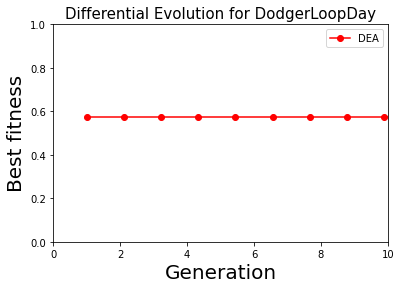

Currently dataset is DodgerLoopGame
(158, 1, 288)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/DodgerLoopGame_0_0.pkl
保存成功 ./generation/DodgerLoopGame_0_1.pkl
保存成功 ./generation/DodgerLoopGame_0_2.pkl
保存成功 ./generation/DodgerLoopGame_0_3.pkl
保存成功 ./generation/DodgerLoopGame_0_4.pkl
保存成功 ./generation/DodgerLoopGame_0_5.pkl
保存成功 ./generation/DodgerLoopGame_0_6.pkl
保存成功 ./generation/DodgerLoopGame_0_7.pkl
保存成功 ./generation/DodgerLoopGame_0_8.pkl
保存成功 ./generation/DodgerLoopGame_0_9.pkl
完成种群记录
第1个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): Batc

epoch,train_loss,valid_loss,accuracy,time
0,0.777613,0.718812,0.456522,00:00
1,0.725443,0.718278,0.456522,00:00
2,0.718211,0.717607,0.456522,00:00
3,0.722349,0.716479,0.456522,00:00
4,0.723776,0.714996,0.463768,00:00
5,0.717961,0.712934,0.456522,00:00
6,0.711354,0.710455,0.463768,00:00
7,0.717391,0.707418,0.471014,00:00
8,0.714844,0.704274,0.478261,00:00
9,0.707587,0.701183,0.500000,00:00


训练耗时:7
第2个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer

epoch,train_loss,valid_loss,accuracy,time
0,0.673534,0.692297,0.521739,00:00
1,0.675975,0.691821,0.521739,00:00
2,0.680225,0.691345,0.521739,00:00
3,0.692217,0.690792,0.521739,00:00
4,0.691012,0.690055,0.521739,00:00
5,0.685520,0.689324,0.536232,00:00
6,0.685510,0.688447,0.536232,00:00
7,0.688390,0.687210,0.550725,00:00
8,0.690796,0.685749,0.586957,00:00
9,0.688978,0.684103,0.601449,00:00


训练耗时:6
第3个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.714530,0.686621,0.528986,00:00
1,0.693635,0.685343,0.557971,00:00
2,0.695067,0.684112,0.550725,00:00
3,0.695373,0.682924,0.630435,00:00
4,0.696917,0.681795,0.623188,00:00
5,0.703900,0.680372,0.644928,00:00
6,0.701953,0.678847,0.681159,00:00
7,0.698661,0.676973,0.688406,00:00
8,0.693804,0.674818,0.702899,00:00
9,0.689589,0.672537,0.702899,00:00


训练耗时:9
第4个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.2803260506070277, inplace=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=

epoch,train_loss,valid_loss,accuracy,time
0,0.722471,0.682140,0.565217,00:00
1,0.717111,0.681851,0.565217,00:00
2,0.703767,0.681437,0.572464,00:00
3,0.711453,0.680846,0.572464,00:00
4,0.708842,0.680059,0.579710,00:00
5,0.704358,0.678934,0.601449,00:00
6,0.702199,0.677597,0.615942,00:00
7,0.700976,0.675954,0.630435,00:00
8,0.695333,0.674026,0.637681,00:00
9,0.695119,0.671706,0.681159,00:00


训练耗时:7
第5个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.665390,0.676509,0.630435,00:00
1,0.676771,0.676579,0.652174,00:00
2,0.668385,0.676071,0.666667,00:00
3,0.660502,0.675372,0.652174,00:00
4,0.661703,0.674426,0.652174,00:00
5,0.654899,0.673443,0.644928,00:00
6,0.654976,0.671991,0.673913,00:00
7,0.647974,0.670438,0.695652,00:00
8,0.646055,0.668164,0.702899,00:00
9,0.644023,0.665808,0.702899,00:00


训练耗时:9
第6个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
 

epoch,train_loss,valid_loss,accuracy,time
0,0.718950,0.696761,0.427536,00:00
1,0.700661,0.696055,0.420290,00:00
2,0.695256,0.695177,0.471014,00:00
3,0.701826,0.694456,0.492754,00:00
4,0.703621,0.693667,0.478261,00:00
5,0.701352,0.692669,0.492754,00:00
6,0.703843,0.691575,0.514493,00:00
7,0.702842,0.690119,0.521739,00:00
8,0.697756,0.687926,0.536232,00:00
9,0.696577,0.685456,0.543478,00:00


训练耗时:7
第7个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.688123,0.695169,0.514493,00:00
1,0.679746,0.695012,0.478261,00:00
2,0.691408,0.694837,0.492754,00:00
3,0.696403,0.694339,0.500000,00:00
4,0.686464,0.693623,0.528986,00:00
5,0.681850,0.692434,0.550725,00:00
6,0.683933,0.691136,0.565217,00:00
7,0.686903,0.689369,0.594203,00:00
8,0.685949,0.687078,0.608696,00:00
9,0.683015,0.684469,0.637681,00:00


训练耗时:9
第8个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(16, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNor

epoch,train_loss,valid_loss,accuracy,time
0,0.704189,0.685422,0.579710,00:00
1,0.699642,0.685070,0.579710,00:00
2,0.697097,0.684674,0.572464,00:00
3,0.697837,0.684177,0.586957,00:00
4,0.690214,0.683526,0.586957,00:00
5,0.683992,0.682752,0.594203,00:00
6,0.687435,0.681832,0.608696,00:00
7,0.687566,0.680697,0.608696,00:00
8,0.687870,0.679366,0.608696,00:00
9,0.688999,0.677886,0.601449,00:00


训练耗时:7
第9个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.669933,0.702214,0.420290,00:00
1,0.669878,0.701515,0.427536,00:00
2,0.679996,0.700744,0.434783,00:00
3,0.681980,0.699935,0.427536,00:00
4,0.691749,0.698957,0.434783,00:00
5,0.695598,0.697797,0.434783,00:00
6,0.698958,0.696391,0.427536,00:00
7,0.697472,0.694633,0.427536,00:00
8,0.695667,0.692734,0.449275,00:00
9,0.687292,0.690611,0.478261,00:00


训练耗时:8
第10个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,0.690895,0.691061,0.514493,00:00
1,0.688252,0.690682,0.536232,00:00
2,0.686608,0.690332,0.543478,00:00
3,0.693713,0.689865,0.550725,00:00
4,0.694267,0.689279,0.572464,00:00
5,0.696581,0.688553,0.579710,00:00
6,0.694349,0.687627,0.608696,00:00
7,0.691066,0.686462,0.623188,00:00
8,0.684998,0.685070,0.673913,00:00
9,0.679242,0.683419,0.710145,00:00


训练耗时:6

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/DodgerLoopGame_1_0.pkl
保存成功./generation/DodgerLoopGame_1_1.pkl
保存成功./generation/DodgerLoopGame_1_2.pkl
保存成功./generation/DodgerLoopGame_1_3.pkl
保存成功./generation/DodgerLoopGame_1_4.pkl
保存成功./generation/DodgerLoopGame_1_5.pkl
保存成功./generation/DodgerLoopGame_1_6.pkl
保存成功./generation/DodgerLoopGame_1_7.pkl
保存成功./generation/DodgerLoopGame_1_8.pkl
保存成功./generation/DodgerLoopGame_1_9.pkl
完成种群记录
Parent_fitness: [[0.40579709]
 [0.85507244]
 [0.84782606]
 [0.71014494]
 [0.84782606]
 [0.76086956]
 [0.86231881]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
第1个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(

epoch,train_loss,valid_loss,accuracy,time
0,0.670678,0.692956,0.456522,00:00
1,0.701009,0.694151,0.442029,00:00
2,0.696458,0.691755,0.492754,00:00
3,0.695969,0.691967,0.471014,00:00
4,0.691050,0.691184,0.478261,00:00
5,0.689848,0.690333,0.507246,00:00
6,0.691344,0.690042,0.492754,00:00
7,0.687729,0.689766,0.471014,00:00
8,0.682174,0.688929,0.471014,00:00
9,0.680730,0.687429,0.471014,00:00


训练耗时:7
Mutate better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.672370,0.706348,0.521739,00:00
1,0.712915,0.699094,0.514493,00:00
2,0.703481,0.697684,0.521739,00:00
3,0.708520,0.697340,0.500000,00:00
4,0.704673,0.696594,0.492754,00:00
5,0.701225,0.695609,0.485507,00:00
6,0.696468,0.694437,0.463768,00:00
7,0.690511,0.693063,0.485507,00:00
8,0.690502,0.691440,0.492754,00:00
9,0.685919,0.689531,0.507246,00:00


训练耗时:8
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.717481,0.691027,0.514493,00:00
1,0.703610,0.690096,0.528986,00:00
2,0.692603,0.689303,0.536232,00:00
3,0.695818,0.688467,0.536232,00:00
4,0.691139,0.687629,0.536232,00:00
5,0.694770,0.686537,0.536232,00:00
6,0.697869,0.685143,0.550725,00:00
7,0.695023,0.683606,0.557971,00:00
8,0.686274,0.681728,0.601449,00:00
9,0.686254,0.679504,0.623188,00:00


训练耗时:9
Mutate better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.728490,0.705220,0.507246,00:00
1,0.714538,0.704987,0.514493,00:00
2,0.736360,0.704445,0.500000,00:00
3,0.734395,0.703777,0.507246,00:00
4,0.725887,0.703021,0.528986,00:00
5,0.714942,0.701976,0.543478,00:00
6,0.717010,0.700686,0.550725,00:00
7,0.717441,0.699219,0.557971,00:00
8,0.713755,0.697283,0.557971,00:00
9,0.704685,0.695059,0.565217,00:00


训练耗时:8
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.722077,0.699260,0.485507,00:00
1,0.693627,0.699230,0.485507,00:00
2,0.697687,0.698238,0.485507,00:00
3,0.704135,0.697145,0.492754,00:00
4,0.703784,0.695807,0.492754,00:00
5,0.698802,0.694424,0.492754,00:00
6,0.691344,0.692658,0.485507,00:00
7,0.694534,0.690886,0.485507,00:00
8,0.694778,0.688755,0.514493,00:00
9,0.689309,0.686091,0.536232,00:00


训练耗时:8
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.663284,0.692606,0.492754,00:00
1,0.683137,0.692484,0.500000,00:00
2,0.690440,0.692273,0.500000,00:00
3,0.684738,0.692021,0.500000,00:00
4,0.684288,0.691688,0.507246,00:00
5,0.684666,0.691233,0.507246,00:00
6,0.682413,0.690668,0.507246,00:00
7,0.679813,0.689969,0.507246,00:00
8,0.676793,0.689112,0.521739,00:00
9,0.673911,0.688097,0.521739,00:00


训练耗时:6
Parent Better
Select完成
After selection [[0.80434781]
 [0.85507244]
 [0.85507244]
 [0.71014494]
 [0.85507244]
 [0.76086956]
 [0.86231881]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8695651888847351
structure is [['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlo

epoch,train_loss,valid_loss,accuracy,time
0,0.697920,0.699749,0.449275,00:00
1,0.713025,0.698817,0.449275,00:00
2,0.708234,0.697821,0.456522,00:00
3,0.701877,0.696875,0.463768,00:00
4,0.712343,0.695684,0.471014,00:00
5,0.721724,0.694297,0.463768,00:00
6,0.719135,0.692556,0.485507,00:00
7,0.720080,0.690365,0.507246,00:00
8,0.720111,0.687780,0.543478,00:00
9,0.719533,0.684636,0.572464,00:00


训练耗时:8
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.710556,0.695190,0.485507,00:00
1,0.711096,0.691245,0.492754,00:00
2,0.690710,0.689698,0.485507,00:00
3,0.673689,0.687628,0.507246,00:00
4,0.669431,0.686074,0.608696,00:00
5,0.656728,0.684346,0.623188,00:00
6,0.650521,0.682262,0.630435,00:00
7,0.647178,0.680043,0.659420,00:00
8,0.642690,0.677980,0.710145,00:00
9,0.634723,0.676031,0.717391,00:00


训练耗时:9
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.673779,0.692504,0.514493,00:00
1,0.689159,0.692129,0.528986,00:00
2,0.697878,0.691771,0.528986,00:00
3,0.691863,0.691339,0.579710,00:00
4,0.697178,0.690776,0.557971,00:00
5,0.697163,0.689941,0.601449,00:00
6,0.693447,0.688929,0.601449,00:00
7,0.688693,0.687878,0.608696,00:00
8,0.689512,0.686508,0.601449,00:00
9,0.688633,0.684733,0.615942,00:00


训练耗时:7
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.690700,0.693013,0.507246,00:00
1,0.671642,0.692572,0.507246,00:00
2,0.682365,0.692046,0.521739,00:00
3,0.690886,0.691452,0.536232,00:00
4,0.687528,0.690655,0.536232,00:00
5,0.680944,0.689793,0.550725,00:00
6,0.683462,0.688465,0.543478,00:00
7,0.679046,0.686940,0.557971,00:00
8,0.678648,0.685139,0.586957,00:00
9,0.676664,0.682989,0.594203,00:00


训练耗时:8
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(16, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.727022,0.699890,0.463768,00:00
1,0.743173,0.699244,0.463768,00:00
2,0.735837,0.698409,0.463768,00:00
3,0.724565,0.697401,0.463768,00:00
4,0.719709,0.695949,0.478261,00:00
5,0.716234,0.694045,0.492754,00:00
6,0.713190,0.691715,0.521739,00:00
7,0.711956,0.689095,0.507246,00:00
8,0.708933,0.685948,0.521739,00:00
9,0.707464,0.682413,0.586957,00:00


训练耗时:7
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.710718,0.698964,0.507246,00:00
1,0.713530,0.698621,0.514493,00:00
2,0.713059,0.698112,0.507246,00:00
3,0.716852,0.697505,0.507246,00:00
4,0.710663,0.696719,0.514493,00:00
5,0.701690,0.695697,0.521739,00:00
6,0.706744,0.694501,0.536232,00:00
7,0.705134,0.692905,0.536232,00:00
8,0.703603,0.691078,0.536232,00:00
9,0.704625,0.688936,0.536232,00:00


训练耗时:8
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.80434781]
 [0.85507244]
 [0.86231881]
 [0.71014494]
 [0.85507244]
 [0.76086956]
 [0.86231881]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8695651888847351
structure is [['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): R

epoch,train_loss,valid_loss,accuracy,time
0,0.703153,0.694841,0.478261,00:00
1,0.698820,0.694425,0.471014,00:00
2,0.700571,0.693768,0.492754,00:00
3,0.689086,0.692927,0.536232,00:00
4,0.695468,0.691900,0.572464,00:00
5,0.699051,0.690838,0.536232,00:00
6,0.695749,0.689988,0.572464,00:00
7,0.695947,0.688943,0.586957,00:00
8,0.691618,0.687609,0.601449,00:00
9,0.687252,0.686053,0.630435,00:00


训练耗时:7
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.719950,0.690210,0.521739,00:00
1,0.711804,0.690198,0.543478,00:00
2,0.705029,0.689985,0.521739,00:00
3,0.699642,0.689445,0.536232,00:00
4,0.706860,0.688772,0.536232,00:00
5,0.697393,0.687926,0.543478,00:00
6,0.694572,0.686809,0.550725,00:00
7,0.700958,0.685412,0.594203,00:00
8,0.706544,0.683888,0.608696,00:00
9,0.705782,0.682038,0.630435,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.685756,0.697740,0.463768,00:00
1,0.686874,0.696399,0.500000,00:00
2,0.687576,0.695883,0.528986,00:00
3,0.692138,0.695333,0.528986,00:00
4,0.691972,0.694276,0.550725,00:00
5,0.689568,0.693309,0.550725,00:00
6,0.697508,0.692317,0.550725,00:00
7,0.695438,0.690906,0.579710,00:00
8,0.688875,0.689274,0.594203,00:00
9,0.681409,0.687350,0.623188,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.684716,0.688712,0.521739,00:00
1,0.703117,0.688572,0.521739,00:00
2,0.698272,0.688113,0.521739,00:00
3,0.693903,0.687410,0.521739,00:00
4,0.690622,0.686400,0.521739,00:00
5,0.687679,0.684887,0.521739,00:00
6,0.687543,0.683336,0.521739,00:00
7,0.684782,0.681585,0.528986,00:00
8,0.681574,0.679834,0.536232,00:00
9,0.680985,0.677732,0.536232,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.691999,0.673909,0.586957,00:00
1,0.687005,0.673070,0.615942,00:00
2,0.686109,0.672308,0.623188,00:00
3,0.675807,0.671351,0.644928,00:00
4,0.666981,0.670060,0.637681,00:00
5,0.664895,0.668462,0.688406,00:00
6,0.664947,0.666554,0.717391,00:00
7,0.662586,0.664134,0.746377,00:00
8,0.660306,0.661383,0.760870,00:00
9,0.659189,0.658303,0.804348,00:00


训练耗时:8
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.729461,0.700840,0.449275,00:00
1,0.712307,0.699784,0.449275,00:00
2,0.701458,0.699469,0.456522,00:00
3,0.692475,0.699270,0.456522,00:00
4,0.702109,0.698643,0.449275,00:00
5,0.704446,0.698778,0.456522,00:00
6,0.704582,0.697929,0.463768,00:00
7,0.703244,0.695445,0.463768,00:00
8,0.700378,0.693003,0.463768,00:00
9,0.698189,0.688385,0.471014,00:00


训练耗时:8
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.80434781]
 [0.85507244]
 [0.86231881]
 [0.71014494]
 [0.85507244]
 [0.76086956]
 [0.86231881]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8695651888847351
structure is [['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): R

epoch,train_loss,valid_loss,accuracy,time
0,0.681097,0.704436,0.463768,00:00
1,0.707250,0.703420,0.434783,00:00
2,0.695271,0.702152,0.442029,00:00
3,0.703768,0.700907,0.434783,00:00
4,0.702080,0.699770,0.449275,00:00
5,0.706195,0.699050,0.471014,00:00
6,0.710888,0.698146,0.478261,00:00
7,0.707463,0.697094,0.463768,00:00
8,0.700929,0.695804,0.463768,00:00
9,0.698168,0.693969,0.492754,00:00


训练耗时:7
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.689845,0.707939,0.398551,00:00
1,0.700078,0.707646,0.398551,00:00
2,0.712873,0.706807,0.405797,00:00
3,0.707735,0.706137,0.413043,00:00
4,0.711756,0.705040,0.398551,00:00
5,0.705680,0.703530,0.434783,00:00
6,0.712418,0.701181,0.471014,00:00
7,0.708217,0.698349,0.514493,00:00
8,0.710946,0.694914,0.528986,00:00
9,0.708974,0.691035,0.557971,00:00


训练耗时:8
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.675793,0.694661,0.500000,00:00
1,0.687043,0.693997,0.528986,00:00
2,0.686839,0.693490,0.507246,00:00
3,0.678731,0.692916,0.521739,00:00
4,0.678651,0.692143,0.543478,00:00
5,0.684466,0.691087,0.528986,00:00
6,0.689408,0.689658,0.536232,00:00
7,0.689439,0.687839,0.528986,00:00
8,0.693128,0.685679,0.557971,00:00
9,0.690139,0.683043,0.608696,00:00


训练耗时:8
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.723970,0.709302,0.362319,00:00
1,0.704434,0.708929,0.369565,00:00
2,0.701249,0.708183,0.376812,00:00
3,0.704282,0.707227,0.398551,00:00
4,0.708883,0.706101,0.398551,00:00
5,0.703474,0.704747,0.413043,00:00
6,0.701188,0.703313,0.442029,00:00
7,0.698366,0.701589,0.463768,00:00
8,0.693613,0.699822,0.485507,00:00
9,0.693256,0.697669,0.521739,00:00


训练耗时:8
Mutate better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.673455,0.698831,0.398551,00:00
1,0.686990,0.698845,0.376812,00:00
2,0.689580,0.699050,0.405797,00:00
3,0.694976,0.699061,0.391304,00:00
4,0.695344,0.698923,0.384058,00:00
5,0.690289,0.698514,0.391304,00:00
6,0.688714,0.697802,0.405797,00:00
7,0.683580,0.696941,0.427536,00:00
8,0.679106,0.695959,0.478261,00:00
9,0.675858,0.694281,0.492754,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.730591,0.704760,0.427536,00:00
1,0.718049,0.703613,0.427536,00:00
2,0.715223,0.702564,0.405797,00:00
3,0.717759,0.701612,0.420290,00:00
4,0.710680,0.700674,0.456522,00:00
5,0.696616,0.699454,0.463768,00:00
6,0.696913,0.697814,0.478261,00:00
7,0.689089,0.695738,0.521739,00:00
8,0.686364,0.693217,0.543478,00:00
9,0.680820,0.690303,0.572464,00:00


训练耗时:8
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.691892,0.692602,0.521739,00:00
1,0.718269,0.692458,0.521739,00:00
2,0.709934,0.692233,0.521739,00:00
3,0.720143,0.691750,0.521739,00:00
4,0.717682,0.690881,0.521739,00:00
5,0.723918,0.689583,0.521739,00:00
6,0.724490,0.687871,0.521739,00:00
7,0.724493,0.685635,0.521739,00:00
8,0.723431,0.683032,0.521739,00:00
9,0.719132,0.680112,0.521739,00:00


训练耗时:8
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.80434781]
 [0.85507244]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.76086956]
 [0.86231881]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8695651888847351
structure is [['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['Dense', 16], ['conv', 8], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['conv', 256], ['conv', 64], ['conv', 256], ['Maxpooling', 'Default'], ['conv', 8], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=T

epoch,train_loss,valid_loss,accuracy,time
0,0.652758,0.687110,0.550725,00:00
1,0.659517,0.687214,0.536232,00:00
2,0.663297,0.687279,0.528986,00:00
3,0.672178,0.686126,0.536232,00:00
4,0.672254,0.685285,0.550725,00:00
5,0.673207,0.684587,0.550725,00:00
6,0.673614,0.683230,0.557971,00:00
7,0.674100,0.681238,0.557971,00:00
8,0.673963,0.678993,0.601449,00:00
9,0.678496,0.676185,0.630435,00:00


训练耗时:8
Mutate better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.695328,0.714006,0.471014,00:00
1,0.687234,0.713668,0.471014,00:00
2,0.688697,0.712859,0.471014,00:00
3,0.697077,0.711815,0.471014,00:00
4,0.691079,0.710290,0.471014,00:00
5,0.684659,0.708784,0.471014,00:00
6,0.678438,0.707346,0.471014,00:00
7,0.672965,0.705620,0.471014,00:00
8,0.664484,0.703977,0.471014,00:00
9,0.659484,0.702525,0.463768,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.708357,0.695543,0.536232,00:00
1,0.700022,0.695134,0.528986,00:00
2,0.690177,0.694506,0.536232,00:00
3,0.690019,0.693730,0.536232,00:00
4,0.685476,0.692743,0.536232,00:00
5,0.678002,0.691692,0.536232,00:00
6,0.677568,0.690435,0.543478,00:00
7,0.676335,0.688895,0.543478,00:00
8,0.675330,0.687067,0.543478,00:00
9,0.672590,0.684866,0.528986,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.677604,0.689432,0.528986,00:00
1,0.683922,0.689639,0.557971,00:00
2,0.683679,0.689683,0.586957,00:00
3,0.689247,0.689538,0.608696,00:00
4,0.686920,0.689012,0.601449,00:00
5,0.689271,0.688301,0.623188,00:00
6,0.691752,0.687503,0.637681,00:00
7,0.687255,0.686180,0.659420,00:00
8,0.685114,0.684436,0.673913,00:00
9,0.681668,0.682245,0.659420,00:00


训练耗时:7
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.707233,0.687094,0.528986,00:00
1,0.684302,0.687044,0.536232,00:00
2,0.685385,0.686411,0.543478,00:00
3,0.681406,0.685436,0.536232,00:00
4,0.672469,0.683958,0.557971,00:00
5,0.676372,0.682214,0.586957,00:00
6,0.678546,0.680243,0.601449,00:00
7,0.675045,0.677803,0.652174,00:00
8,0.675020,0.675092,0.688406,00:00
9,0.669155,0.671942,0.702899,00:00


训练耗时:8
Mutate better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.728264,0.695590,0.550725,00:00
1,0.741099,0.695152,0.528986,00:00
2,0.715776,0.694439,0.521739,00:00
3,0.725077,0.693563,0.521739,00:00
4,0.722605,0.692550,0.528986,00:00
5,0.722295,0.691300,0.536232,00:00
6,0.721993,0.689955,0.543478,00:00
7,0.717329,0.688220,0.550725,00:00
8,0.710388,0.686149,0.543478,00:00
9,0.706632,0.683620,0.543478,00:00


训练耗时:9
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.686780,0.699435,0.514493,00:00
1,0.707141,0.699256,0.514493,00:00
2,0.697358,0.698927,0.514493,00:00
3,0.702186,0.698444,0.514493,00:00
4,0.700116,0.697795,0.514493,00:00
5,0.705532,0.696954,0.514493,00:00
6,0.695677,0.695960,0.514493,00:00
7,0.692589,0.694805,0.514493,00:00
8,0.690809,0.693480,0.521739,00:00
9,0.687028,0.692029,0.521739,00:00


训练耗时:7
Parent Better
Select完成
After selection [[0.83333331]
 [0.85507244]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.76086956]
 [0.87681162]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8768116235733032
structure is [['conv', 8], ['conv', 8], ['conv', 32], ['conv', 8], ['conv', 8], ['Dense', 128], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 64], ['conv', 256], ['conv', 16], ['conv', 256], ['conv', 8], ['Activate', 'Relu'], ['conv', 8]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(

epoch,train_loss,valid_loss,accuracy,time
0,0.696902,0.694479,0.521739,00:00
1,0.718261,0.694869,0.507246,00:00
2,0.713746,0.694669,0.514493,00:00
3,0.716490,0.693789,0.536232,00:00
4,0.709390,0.692612,0.536232,00:00
5,0.706042,0.691709,0.507246,00:00
6,0.699250,0.690497,0.521739,00:00
7,0.697777,0.689118,0.507246,00:00
8,0.694426,0.687287,0.528986,00:00
9,0.693087,0.684968,0.521739,00:00


训练耗时:8
Mutate better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
子代个体基因型受限
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=Fal

epoch,train_loss,valid_loss,accuracy,time
0,0.709217,0.696255,0.420290,00:00
1,0.711148,0.695665,0.427536,00:00
2,0.702114,0.694974,0.427536,00:00
3,0.690017,0.694256,0.442029,00:00
4,0.692547,0.693271,0.463768,00:00
5,0.690896,0.691922,0.463768,00:00
6,0.681493,0.690147,0.478261,00:00
7,0.677134,0.688003,0.485507,00:00
8,0.674544,0.685333,0.521739,00:00
9,0.677296,0.682533,0.579710,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.681439,0.704713,0.478261,00:00
1,0.680123,0.699854,0.478261,00:00
2,0.681848,0.696593,0.478261,00:00
3,0.680653,0.694251,0.478261,00:00
4,0.687737,0.692327,0.507246,00:00
5,0.690840,0.690464,0.528986,00:00
6,0.688325,0.688931,0.579710,00:00
7,0.689575,0.687402,0.608696,00:00
8,0.688735,0.686186,0.615942,00:00
9,0.687789,0.684838,0.652174,00:00


训练耗时:7
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.701435,0.700213,0.471014,00:00
1,0.684309,0.696881,0.478261,00:00
2,0.670143,0.694558,0.463768,00:00
3,0.667314,0.693375,0.521739,00:00
4,0.664006,0.691760,0.543478,00:00
5,0.662941,0.690319,0.543478,00:00
6,0.657313,0.688834,0.550725,00:00
7,0.660337,0.686833,0.557971,00:00
8,0.656250,0.684751,0.572464,00:00
9,0.654239,0.682503,0.572464,00:00


训练耗时:8
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.745824,0.746739,0.478261,00:00
1,0.708092,0.709562,0.478261,00:00
2,0.696840,0.696751,0.500000,00:00
3,0.688451,0.692295,0.528986,00:00
4,0.681947,0.690218,0.536232,00:00
5,0.672981,0.688995,0.572464,00:00
6,0.671439,0.688033,0.579710,00:00
7,0.664894,0.686493,0.594203,00:00
8,0.659460,0.684879,0.623188,00:00
9,0.655918,0.682709,0.601449,00:00


训练耗时:8
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.87681162]
 [0.85507244]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.76086956]
 [0.87681162]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8768116235733032
structure is [['conv', 32], ['ZeroOp', 'Default'], ['conv', 256], ['conv', 8], ['Dropout', 0.20532781077164375], ['conv', 128], ['conv', 64], ['Activate', 'sigmoid'], ['conv', 8], ['conv', 32], ['conv', 128], ['conv', 64], ['Dropout', 0.1726779906263068], ['conv', 128], ['conv', 32]]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256

epoch,train_loss,valid_loss,accuracy,time
0,0.688618,0.788950,0.521739,00:00
1,0.687701,0.715265,0.521739,00:00
2,0.675532,0.690771,0.521739,00:00
3,0.681399,0.687264,0.521739,00:00
4,0.682484,0.686854,0.565217,00:00
5,0.673951,0.685760,0.594203,00:00
6,0.669429,0.684409,0.608696,00:00
7,0.666165,0.682996,0.644928,00:00
8,0.662669,0.681368,0.666667,00:00
9,0.659144,0.678608,0.666667,00:00


训练耗时:8
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.654381,0.689359,0.521739,00:00
1,0.648681,0.688802,0.536232,00:00
2,0.659884,0.688373,0.543478,00:00
3,0.659457,0.687649,0.572464,00:00
4,0.667182,0.686752,0.572464,00:00
5,0.672076,0.685598,0.586957,00:00
6,0.669837,0.684084,0.586957,00:00
7,0.665289,0.682142,0.608696,00:00
8,0.667984,0.679888,0.652174,00:00
9,0.666970,0.677223,0.673913,00:00


训练耗时:6
Mutate better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.760089,0.707754,0.434783,00:00
1,0.741334,0.707638,0.427536,00:00
2,0.737065,0.707349,0.427536,00:00
3,0.727379,0.706717,0.427536,00:00
4,0.719915,0.705747,0.427536,00:00
5,0.711653,0.704703,0.427536,00:00
6,0.706236,0.703239,0.427536,00:00
7,0.706595,0.701409,0.427536,00:00
8,0.699179,0.699091,0.427536,00:00
9,0.695566,0.696404,0.456522,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.707088,0.689709,0.543478,00:00
1,0.700288,0.689281,0.528986,00:00
2,0.686887,0.688846,0.514493,00:00
3,0.683893,0.688197,0.543478,00:00
4,0.676332,0.687378,0.557971,00:00
5,0.678692,0.686424,0.586957,00:00
6,0.676791,0.685060,0.608696,00:00
7,0.670737,0.683361,0.615942,00:00
8,0.670467,0.681678,0.644928,00:00
9,0.667724,0.679446,0.681159,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,0.699078,0.689777,0.521739,00:00
1,0.698103,0.689656,0.521739,00:00
2,0.698385,0.689314,0.514493,00:00
3,0.698561,0.688922,0.521739,00:00
4,0.699927,0.688530,0.528986,00:00
5,0.696899,0.688075,0.528986,00:00
6,0.695055,0.687403,0.536232,00:00
7,0.691545,0.686626,0.543478,00:00
8,0.690053,0.685183,0.528986,00:00
9,0.688191,0.683278,0.536232,00:00


训练耗时:7
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.738458,0.692143,0.528986,00:00
1,0.712606,0.691923,0.521739,00:00
2,0.698479,0.691600,0.521739,00:00
3,0.689234,0.691100,0.521739,00:00
4,0.684990,0.690423,0.528986,00:00
5,0.684682,0.689400,0.528986,00:00
6,0.686158,0.688232,0.550725,00:00
7,0.684033,0.686687,0.550725,00:00
8,0.684233,0.684828,0.550725,00:00
9,0.683994,0.682708,0.543478,00:00


训练耗时:8
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.701439,0.687031,0.521739,00:00
1,0.710662,0.683787,0.543478,00:00
2,0.710077,0.683695,0.565217,00:00
3,0.712596,0.683691,0.565217,00:00
4,0.707147,0.683264,0.557971,00:00
5,0.700501,0.682405,0.557971,00:00
6,0.688659,0.681424,0.579710,00:00
7,0.687187,0.680424,0.594203,00:00
8,0.683424,0.679158,0.623188,00:00
9,0.675368,0.677687,0.644928,00:00


训练耗时:8
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.87681162]
 [0.884058  ]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.76086956]
 [0.87681162]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8840579986572266
structure is [['Activate', 'selu'], ['Maxpooling', 'Default'], ['conv', 32], ['Dense', 32], ['ZeroOp', 'Default'], ['Dense', 256], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.18286116877250974], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Activate', 'elu'], ['ZeroOp', 'Default']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=

epoch,train_loss,valid_loss,accuracy,time
0,0.703193,0.699068,0.485507,00:00
1,0.758706,0.698357,0.507246,00:00
2,0.748985,0.697367,0.456522,00:00
3,0.737204,0.696396,0.500000,00:00
4,0.736493,0.695401,0.507246,00:00
5,0.736342,0.694245,0.514493,00:00
6,0.731914,0.692969,0.500000,00:00
7,0.728506,0.691392,0.514493,00:00
8,0.725251,0.689501,0.543478,00:00
9,0.723427,0.687415,0.543478,00:00


训练耗时:7
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.724116,0.704688,0.442029,00:00
1,0.702356,0.704199,0.434783,00:00
2,0.692748,0.703546,0.442029,00:00
3,0.691400,0.702761,0.442029,00:00
4,0.686403,0.701701,0.442029,00:00
5,0.693982,0.700501,0.456522,00:00
6,0.691230,0.698986,0.478261,00:00
7,0.694006,0.697245,0.485507,00:00
8,0.691387,0.694936,0.507246,00:00
9,0.693216,0.692275,0.528986,00:00


训练耗时:6
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.731794,0.692445,0.507246,00:00
1,0.709399,0.691496,0.528986,00:00
2,0.708919,0.690462,0.514493,00:00
3,0.701247,0.689451,0.521739,00:00
4,0.695162,0.688297,0.528986,00:00
5,0.688623,0.686847,0.543478,00:00
6,0.687165,0.685199,0.572464,00:00
7,0.689256,0.683307,0.601449,00:00
8,0.681273,0.680973,0.623188,00:00
9,0.678060,0.678363,0.666667,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.719633,0.704217,0.528986,00:00
1,0.705123,0.703561,0.528986,00:00
2,0.720009,0.702639,0.528986,00:00
3,0.712862,0.701718,0.528986,00:00
4,0.699123,0.700461,0.536232,00:00
5,0.693866,0.698960,0.536232,00:00
6,0.692176,0.697235,0.528986,00:00
7,0.696625,0.695029,0.528986,00:00
8,0.694513,0.692306,0.550725,00:00
9,0.693137,0.689300,0.557971,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.714297,0.695522,0.514493,00:00
1,0.715349,0.695522,0.514493,00:00
2,0.708573,0.695339,0.514493,00:00
3,0.711337,0.695071,0.514493,00:00
4,0.705234,0.694686,0.507246,00:00
5,0.703534,0.694184,0.485507,00:00
6,0.700964,0.693475,0.514493,00:00
7,0.700820,0.692534,0.536232,00:00
8,0.699249,0.691215,0.543478,00:00
9,0.699864,0.689472,0.557971,00:00


训练耗时:7
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.702533,0.692489,0.514493,00:00
1,0.705797,0.692106,0.507246,00:00
2,0.716302,0.691786,0.536232,00:00
3,0.702246,0.691378,0.550725,00:00
4,0.698629,0.690805,0.565217,00:00
5,0.695635,0.689913,0.579710,00:00
6,0.696157,0.688683,0.594203,00:00
7,0.692120,0.687062,0.615942,00:00
8,0.693808,0.684864,0.659420,00:00
9,0.682789,0.682176,0.717391,00:00


训练耗时:8
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.714086,0.702363,0.471014,00:00
1,0.714492,0.701826,0.471014,00:00
2,0.713044,0.701093,0.471014,00:00
3,0.686870,0.700274,0.478261,00:00
4,0.679661,0.699194,0.485507,00:00
5,0.683102,0.697952,0.478261,00:00
6,0.686670,0.696513,0.478261,00:00
7,0.685683,0.694955,0.485507,00:00
8,0.678210,0.693103,0.507246,00:00
9,0.677584,0.691199,0.507246,00:00


训练耗时:8
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.87681162]
 [0.884058  ]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.76086956]
 [0.87681162]
 [0.86231881]
 [0.86956519]
 [0.59420288]]
Round Best:
0.8840579986572266
structure is [['Activate', 'selu'], ['Maxpooling', 'Default'], ['conv', 32], ['Dense', 32], ['ZeroOp', 'Default'], ['Dense', 256], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.18286116877250974], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Activate', 'elu'], ['ZeroOp', 'Default']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=

epoch,train_loss,valid_loss,accuracy,time
0,0.665860,0.684594,0.586957,00:00
1,0.674882,0.684265,0.594203,00:00
2,0.665609,0.684025,0.586957,00:00
3,0.686974,0.683473,0.594203,00:00
4,0.692517,0.682556,0.601449,00:00
5,0.689712,0.681623,0.601449,00:00
6,0.690835,0.680422,0.623188,00:00
7,0.693992,0.678890,0.630435,00:00
8,0.690318,0.676971,0.637681,00:00
9,0.690183,0.674858,0.637681,00:00


训练耗时:8
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(256, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,0.697479,0.697642,0.521739,00:00
1,0.708229,0.697371,0.492754,00:00
2,0.710286,0.696928,0.514493,00:00
3,0.709108,0.696313,0.514493,00:00
4,0.705498,0.695657,0.514493,00:00
5,0.696511,0.694854,0.492754,00:00
6,0.691881,0.693819,0.521739,00:00
7,0.686777,0.692752,0.507246,00:00
8,0.681878,0.691692,0.550725,00:00
9,0.673580,0.690232,0.550725,00:00


训练耗时:7
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.624247,0.758339,0.478261,00:00
1,0.657454,0.715832,0.478261,00:00
2,0.673196,0.696350,0.478261,00:00
3,0.665923,0.686752,0.478261,00:00
4,0.663094,0.681120,0.492754,00:00
5,0.670954,0.676966,0.536232,00:00
6,0.672824,0.673602,0.579710,00:00
7,0.668930,0.669891,0.637681,00:00
8,0.666997,0.665745,0.681159,00:00
9,0.662708,0.661132,0.695652,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.609623,0.669614,0.724638,00:00
1,0.628312,0.668935,0.695652,00:00
2,0.656067,0.668405,0.695652,00:00
3,0.657967,0.667706,0.688406,00:00
4,0.655011,0.666865,0.695652,00:00
5,0.660462,0.665851,0.688406,00:00
6,0.659140,0.664485,0.717391,00:00
7,0.662891,0.662929,0.731884,00:00
8,0.663948,0.661097,0.746377,00:00
9,0.665578,0.658980,0.768116,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.714169,0.688338,0.478261,00:00
1,0.703673,0.687758,0.471014,00:00
2,0.699616,0.686870,0.463768,00:00
3,0.697143,0.685965,0.557971,00:00
4,0.693684,0.684877,0.637681,00:00
5,0.691047,0.683636,0.681159,00:00
6,0.688395,0.682440,0.724638,00:00
7,0.688430,0.681374,0.702899,00:00
8,0.684774,0.679962,0.717391,00:00
9,0.684070,0.678284,0.746377,00:00


训练耗时:7
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1

epoch,train_loss,valid_loss,accuracy,time
0,0.701169,0.712845,0.471014,00:00
1,0.699090,0.710630,0.449275,00:00
2,0.703551,0.709526,0.442029,00:00
3,0.698298,0.708380,0.442029,00:00
4,0.685173,0.706824,0.442029,00:00
5,0.684848,0.704880,0.449275,00:00
6,0.688870,0.702582,0.442029,00:00
7,0.683520,0.699783,0.449275,00:00
8,0.681486,0.696591,0.463768,00:00
9,0.681163,0.692979,0.471014,00:00


训练耗时:8
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,0.746266,0.713013,0.521739,00:00
1,0.761702,0.707694,0.521739,00:00
2,0.757122,0.705588,0.521739,00:00
3,0.752445,0.704290,0.521739,00:00
4,0.745427,0.704454,0.521739,00:00
5,0.737217,0.703793,0.521739,00:00
6,0.730332,0.703167,0.521739,00:00
7,0.728469,0.702437,0.521739,00:00
8,0.724270,0.700500,0.521739,00:00
9,0.713353,0.698215,0.521739,00:00


训练耗时:8
Mutate better
Select完成
After selection [[0.87681162]
 [0.884058  ]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.76086956]
 [0.87681162]
 [0.86231881]
 [0.86956519]
 [0.73913044]]
Round Best:
0.8840579986572266
structure is [['Activate', 'selu'], ['Maxpooling', 'Default'], ['conv', 32], ['Dense', 32], ['ZeroOp', 'Default'], ['Dense', 256], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.18286116877250974], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Activate', 'elu'], ['ZeroOp', 'Default']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.729463,0.690525,0.500000,00:00
1,0.708903,0.687724,0.543478,00:00
2,0.704228,0.685574,0.565217,00:00
3,0.687333,0.683673,0.630435,00:00
4,0.673678,0.681912,0.615942,00:00
5,0.677909,0.679767,0.608696,00:00
6,0.674334,0.677847,0.601449,00:00
7,0.668759,0.675929,0.572464,00:00
8,0.664344,0.673772,0.594203,00:00
9,0.662790,0.671442,0.594203,00:00


训练耗时:8
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.697683,0.686644,0.550725,00:00
1,0.687970,0.686433,0.557971,00:00
2,0.693191,0.686133,0.557971,00:00
3,0.695456,0.685634,0.565217,00:00
4,0.690852,0.684875,0.572464,00:00
5,0.694090,0.684086,0.579710,00:00
6,0.694092,0.683001,0.579710,00:00
7,0.690181,0.681860,0.608696,00:00
8,0.685450,0.680214,0.630435,00:00
9,0.683129,0.678631,0.637681,00:00


训练耗时:7
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.728225,0.687393,0.550725,00:00
1,0.708024,0.687147,0.550725,00:00
2,0.704709,0.686800,0.550725,00:00
3,0.702765,0.686420,0.550725,00:00
4,0.689733,0.685802,0.550725,00:00
5,0.693329,0.684949,0.550725,00:00
6,0.693537,0.683794,0.550725,00:00
7,0.689426,0.682400,0.550725,00:00
8,0.687875,0.680580,0.557971,00:00
9,0.685933,0.678546,0.557971,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,0.714822,0.698469,0.405797,00:00
1,0.706924,0.696646,0.485507,00:00
2,0.696960,0.695672,0.521739,00:00
3,0.690698,0.695172,0.514493,00:00
4,0.687727,0.694689,0.521739,00:00
5,0.680324,0.694145,0.528986,00:00
6,0.678356,0.693322,0.565217,00:00
7,0.672075,0.692185,0.586957,00:00
8,0.669777,0.690924,0.601449,00:00
9,0.668097,0.689048,0.630435,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, t

epoch,train_loss,valid_loss,accuracy,time
0,0.706931,0.696952,0.456522,00:00
1,0.707212,0.696885,0.463768,00:00
2,0.704724,0.696720,0.463768,00:00
3,0.699700,0.696451,0.434783,00:00
4,0.699369,0.695808,0.478261,00:00
5,0.705383,0.694919,0.492754,00:00
6,0.701564,0.693933,0.500000,00:00
7,0.698607,0.692720,0.485507,00:00
8,0.696079,0.691247,0.528986,00:00
9,0.693728,0.689466,0.550725,00:00


训练耗时:7
Mutate better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.765599,0.692304,0.528986,00:00
1,0.741847,0.691965,0.514493,00:00
2,0.749046,0.691571,0.521739,00:00
3,0.731679,0.691012,0.528986,00:00
4,0.725571,0.690256,0.514493,00:00
5,0.724128,0.689148,0.536232,00:00
6,0.716184,0.687674,0.557971,00:00
7,0.709596,0.686052,0.594203,00:00
8,0.707649,0.684390,0.615942,00:00
9,0.705868,0.682360,0.623188,00:00


训练耗时:8
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.696541,0.695327,0.463768,00:00
1,0.700319,0.694587,0.471014,00:00
2,0.703351,0.693667,0.471014,00:00
3,0.702564,0.692890,0.463768,00:00
4,0.695536,0.691506,0.478261,00:00
5,0.688943,0.689846,0.471014,00:00
6,0.684594,0.687619,0.485507,00:00
7,0.682465,0.685100,0.514493,00:00
8,0.687525,0.682258,0.565217,00:00
9,0.684846,0.679279,0.615942,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_ru

epoch,train_loss,valid_loss,accuracy,time
0,0.673042,0.713864,0.456522,00:00
1,0.683054,0.713350,0.463768,00:00
2,0.692964,0.712960,0.463768,00:00
3,0.698199,0.712475,0.471014,00:00
4,0.706824,0.711758,0.471014,00:00
5,0.715334,0.710852,0.471014,00:00
6,0.711390,0.709654,0.463768,00:00
7,0.705212,0.707853,0.471014,00:00
8,0.699692,0.705647,0.478261,00:00
9,0.704574,0.702435,0.478261,00:00


训练耗时:8
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,0.725779,0.724534,0.478261,00:00
1,0.719778,0.720312,0.478261,00:00
2,0.718668,0.716751,0.478261,00:00
3,0.711653,0.713892,0.471014,00:00
4,0.703761,0.711887,0.471014,00:00
5,0.703464,0.710053,0.463768,00:00
6,0.698261,0.708247,0.463768,00:00
7,0.695392,0.705706,0.463768,00:00
8,0.685779,0.702638,0.463768,00:00
9,0.682105,0.699445,0.463768,00:00


训练耗时:8
Mutate better
Select完成
After selection [[0.87681162]
 [0.884058  ]
 [0.86956519]
 [0.71014494]
 [0.86956519]
 [0.78260869]
 [0.87681162]
 [0.86231881]
 [0.86956519]
 [0.79710144]]
Round Best:
0.8840579986572266
structure is [['Activate', 'selu'], ['Maxpooling', 'Default'], ['conv', 32], ['Dense', 32], ['ZeroOp', 'Default'], ['Dense', 256], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.18286116877250974], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Activate', 'elu'], ['ZeroOp', 'Default']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
 

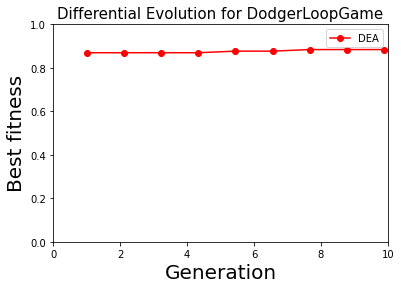

Currently dataset is DodgerLoopWeekend
(158, 1, 288)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/DodgerLoopWeekend_0_0.pkl
保存成功 ./generation/DodgerLoopWeekend_0_1.pkl
保存成功 ./generation/DodgerLoopWeekend_0_2.pkl
保存成功 ./generation/DodgerLoopWeekend_0_3.pkl
保存成功 ./generation/DodgerLoopWeekend_0_4.pkl
保存成功 ./generation/DodgerLoopWeekend_0_5.pkl
保存成功 ./generation/DodgerLoopWeekend_0_6.pkl
保存成功 ./generation/DodgerLoopWeekend_0_7.pkl
保存成功 ./generation/DodgerLoopWeekend_0_8.pkl
保存成功 ./generation/DodgerLoopWeekend_0_9.pkl
完成种群记录
第1个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), paddin

epoch,train_loss,valid_loss,accuracy,time
0,0.714379,0.769807,0.260870,00:00
1,0.699704,0.767097,0.260870,00:00
2,0.686022,0.763820,0.260870,00:00
3,0.694194,0.759528,0.260870,00:00
4,0.698261,0.754076,0.260870,00:00
5,0.689988,0.746890,0.260870,00:00
6,0.686561,0.738164,0.260870,00:00
7,0.686795,0.728005,0.260870,00:00
8,0.685203,0.716217,0.260870,00:00
9,0.683217,0.702372,0.268116,00:00


训练耗时:7
第2个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Softmax(dim=None)
  (add_layer2): ELU(alpha=1.0)
  (add_layer3): Linear(in_features=128, out_features=64, bias=True)
  (add_layer5): Dropout(p=0.427121048844223, inplace=False)
  (add_layer7): Dropout(

epoch,train_loss,valid_loss,accuracy,time
0,0.701257,0.686279,0.630435,00:00
1,0.709366,0.684840,0.644928,00:00
2,0.707271,0.682982,0.666667,00:00
3,0.709964,0.680661,0.673913,00:00
4,0.724791,0.677660,0.695652,00:00
5,0.717946,0.673589,0.702899,00:00
6,0.717539,0.668460,0.739130,00:00
7,0.710672,0.662615,0.760870,00:00
8,0.704720,0.655545,0.811594,00:00
9,0.698134,0.647349,0.876812,00:00


训练耗时:6
第3个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.698380,0.682667,0.666667,00:00
1,0.687646,0.681078,0.673913,00:00
2,0.706779,0.679275,0.695652,00:00
3,0.698317,0.676863,0.710145,00:00
4,0.698783,0.673593,0.731884,00:00
5,0.691936,0.669416,0.753623,00:00
6,0.690206,0.664141,0.775362,00:00
7,0.688667,0.657527,0.811594,00:00
8,0.684391,0.648955,0.818841,00:00
9,0.674136,0.638810,0.855072,00:00


训练耗时:8
第4个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.06561792426058616, inplace=False)
  (add_layer2): SELU()
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer6): Linear(in_features=128, o

epoch,train_loss,valid_loss,accuracy,time
0,0.640351,0.669173,0.753623,00:00
1,0.666634,0.669225,0.760870,00:00
2,0.674562,0.669052,0.760870,00:00
3,0.680116,0.668422,0.760870,00:00
4,0.686279,0.667292,0.775362,00:00
5,0.685984,0.665880,0.833333,00:00
6,0.688347,0.663972,0.855072,00:00
7,0.685128,0.662210,0.876812,00:00
8,0.678551,0.660470,0.905797,00:00
9,0.668756,0.658494,0.869565,00:00


训练耗时:7
第5个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.17855785096172622, inplace=False)
  (add_layer3): ELU(alpha=1.0)
  (add_layer4): Dropout(p=0.02115

epoch,train_loss,valid_loss,accuracy,time
0,0.693358,0.674131,0.688406,00:00
1,0.694405,0.671083,0.688406,00:00
2,0.691651,0.667387,0.724638,00:00
3,0.688329,0.663483,0.724638,00:00
4,0.698520,0.659612,0.731884,00:00
5,0.704776,0.655643,0.739130,00:00
6,0.696887,0.651047,0.739130,00:00
7,0.692083,0.645691,0.739130,00:00
8,0.687441,0.639895,0.746377,00:00
9,0.682526,0.633105,0.760870,00:00


训练耗时:7
第6个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.717678,0.699547,0.398551,00:00
1,0.671537,0.694474,0.471014,00:00
2,0.683769,0.689150,0.572464,00:00
3,0.696470,0.684282,0.644928,00:00
4,0.695335,0.679081,0.702899,00:00
5,0.687200,0.673023,0.782609,00:00
6,0.685098,0.666619,0.840580,00:00
7,0.681491,0.658620,0.855072,00:00
8,0.675299,0.648937,0.898551,00:00
9,0.668092,0.637826,0.913043,00:00


训练耗时:8
第7个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )

epoch,train_loss,valid_loss,accuracy,time
0,0.690387,0.684229,0.630435,00:00
1,0.685352,0.684764,0.644928,00:00
2,0.688613,0.684983,0.630435,00:00
3,0.695550,0.684829,0.644928,00:00
4,0.690340,0.683443,0.673913,00:00
5,0.695754,0.682795,0.688406,00:00
6,0.692484,0.681275,0.702899,00:00
7,0.691629,0.679011,0.724638,00:00
8,0.685513,0.676365,0.746377,00:00
9,0.683413,0.673659,0.797101,00:00


训练耗时:7
第8个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
 

epoch,train_loss,valid_loss,accuracy,time
0,0.771431,0.757432,0.217391,00:00
1,0.759167,0.767908,0.246377,00:00
2,0.748460,0.768197,0.246377,00:00
3,0.732947,0.764907,0.246377,00:00
4,0.731950,0.760201,0.246377,00:00
5,0.724783,0.754528,0.246377,00:00
6,0.719625,0.747364,0.246377,00:00
7,0.717519,0.738744,0.246377,00:00
8,0.713475,0.728988,0.253623,00:00
9,0.714551,0.717444,0.289855,00:00


训练耗时:8
第9个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm

epoch,train_loss,valid_loss,accuracy,time
0,0.727696,0.735652,0.260870,00:00
1,0.696971,0.730441,0.260870,00:00
2,0.685222,0.725744,0.260870,00:00
3,0.685768,0.721417,0.260870,00:00
4,0.684322,0.717244,0.260870,00:00
5,0.682322,0.712370,0.260870,00:00
6,0.684825,0.707478,0.304348,00:00
7,0.681686,0.702000,0.304348,00:00
8,0.677244,0.695844,0.347826,00:00
9,0.675685,0.689374,0.413043,00:00


训练耗时:7
第10个个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,0.672671,0.661677,0.833333,00:00
1,0.658018,0.660861,0.847826,00:00
2,0.665186,0.659329,0.847826,00:00
3,0.656355,0.657655,0.862319,00:00
4,0.659158,0.655487,0.855072,00:00
5,0.657365,0.651973,0.869565,00:00
6,0.660780,0.647549,0.891304,00:00
7,0.659445,0.642021,0.927536,00:00
8,0.657348,0.634995,0.942029,00:00
9,0.655528,0.626773,0.949275,00:00


训练耗时:8

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/DodgerLoopWeekend_1_0.pkl
保存成功./generation/DodgerLoopWeekend_1_1.pkl
保存成功./generation/DodgerLoopWeekend_1_2.pkl
保存成功./generation/DodgerLoopWeekend_1_3.pkl
保存成功./generation/DodgerLoopWeekend_1_4.pkl
保存成功./generation/DodgerLoopWeekend_1_5.pkl
保存成功./generation/DodgerLoopWeekend_1_6.pkl
保存成功./generation/DodgerLoopWeekend_1_7.pkl
保存成功./generation/DodgerLoopWeekend_1_8.pkl
保存成功./generation/DodgerLoopWeekend_1_9.pkl
完成种群记录
Parent_fitness: [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.90579712]
 [0.9710145 ]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
第1个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2

epoch,train_loss,valid_loss,accuracy,time
0,0.653573,0.695900,0.369565,00:00
1,0.664730,0.694028,0.376812,00:00
2,0.672794,0.691909,0.405797,00:00
3,0.675732,0.689240,0.420290,00:00
4,0.673576,0.685674,0.449275,00:00
5,0.673211,0.680823,0.572464,00:00
6,0.675856,0.674628,0.630435,00:00
7,0.670612,0.666838,0.739130,00:00
8,0.664123,0.657419,0.840580,00:00
9,0.657956,0.645793,0.905797,00:00


训练耗时:7
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.665528,0.681822,0.615942,00:00
1,0.679737,0.679834,0.673913,00:00
2,0.680907,0.677367,0.724638,00:00
3,0.683991,0.674389,0.760870,00:00
4,0.681960,0.670651,0.768116,00:00
5,0.685056,0.665954,0.782609,00:00
6,0.687270,0.660691,0.818841,00:00
7,0.684685,0.654009,0.833333,00:00
8,0.682462,0.646683,0.862319,00:00
9,0.681863,0.639120,0.898551,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=Fal

epoch,train_loss,valid_loss,accuracy,time
0,0.674723,0.670501,0.768116,00:00
1,0.680676,0.669915,0.775362,00:00
2,0.678436,0.669010,0.768116,00:00
3,0.673697,0.667799,0.768116,00:00
4,0.673554,0.666395,0.804348,00:00
5,0.674129,0.664664,0.826087,00:00
6,0.677225,0.662289,0.884058,00:00
7,0.672752,0.659205,0.905797,00:00
8,0.672958,0.655581,0.927536,00:00
9,0.664457,0.650835,0.934783,00:00


训练耗时:7
Mutate better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.17855785096172622, inplace=False)
  (add_layer3): ELU(alpha=1.0)
  (add_layer5): D

epoch,train_loss,valid_loss,accuracy,time
0,0.722784,0.719281,0.268116,00:00
1,0.737405,0.719259,0.253623,00:00
2,0.736469,0.718428,0.253623,00:00
3,0.730442,0.716199,0.268116,00:00
4,0.717591,0.712477,0.311594,00:00
5,0.711285,0.707866,0.347826,00:00
6,0.705487,0.701318,0.413043,00:00
7,0.700291,0.693388,0.485507,00:00
8,0.693138,0.684204,0.608696,00:00
9,0.688074,0.673511,0.797101,00:00


训练耗时:7
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.760092,0.743020,0.181159,00:00
1,0.744741,0.740177,0.188406,00:00
2,0.725468,0.737675,0.195652,00:00
3,0.723316,0.734797,0.195652,00:00
4,0.724421,0.731078,0.210145,00:00
5,0.727978,0.726542,0.224638,00:00
6,0.721405,0.720833,0.231884,00:00
7,0.719773,0.714438,0.268116,00:00
8,0.718412,0.707054,0.340580,00:00
9,0.717284,0.698044,0.413043,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.709930,0.639524,0.746377,00:00
1,0.714822,0.639258,0.746377,00:00
2,0.697757,0.638420,0.746377,00:00
3,0.692151,0.637259,0.746377,00:00
4,0.689876,0.635699,0.746377,00:00
5,0.693581,0.633764,0.746377,00:00
6,0.696223,0.631702,0.746377,00:00
7,0.695234,0.629023,0.746377,00:00
8,0.695845,0.625875,0.746377,00:00
9,0.694004,0.621551,0.753623,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.698408,0.689536,0.536232,00:00
1,0.687107,0.685365,0.579710,00:00
2,0.666085,0.681112,0.615942,00:00
3,0.673875,0.676551,0.652174,00:00
4,0.668255,0.671194,0.710145,00:00
5,0.662739,0.665300,0.731884,00:00
6,0.660722,0.658450,0.746377,00:00
7,0.658020,0.650934,0.804348,00:00
8,0.657432,0.642232,0.840580,00:00
9,0.660172,0.631695,0.884058,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.685556,0.648405,0.739130,00:00
1,0.683216,0.668487,0.731884,00:00
2,0.685633,0.681215,0.652174,00:00
3,0.701034,0.688781,0.601449,00:00
4,0.694930,0.692022,0.521739,00:00
5,0.692087,0.692617,0.492754,00:00
6,0.689083,0.690913,0.521739,00:00
7,0.683196,0.687748,0.543478,00:00
8,0.680843,0.682942,0.608696,00:00
9,0.676981,0.677218,0.666667,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,0.687728,0.665168,0.753623,00:00
1,0.722428,0.664558,0.760870,00:00
2,0.704859,0.663334,0.768116,00:00
3,0.695374,0.661171,0.775362,00:00
4,0.697421,0.657950,0.782609,00:00
5,0.703215,0.653769,0.782609,00:00
6,0.695917,0.648700,0.789855,00:00
7,0.690573,0.641397,0.797101,00:00
8,0.689473,0.633969,0.833333,00:00
9,0.682365,0.625115,0.847826,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.92753625]
 [0.9710145 ]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.686118,0.709909,0.347826,00:00
1,0.689164,0.721547,0.253623,00:00
2,0.692370,0.723518,0.253623,00:00
3,0.697221,0.716602,0.268116,00:00
4,0.697016,0.710871,0.297101,00:00
5,0.693500,0.705773,0.355072,00:00
6,0.685386,0.698546,0.384058,00:00
7,0.688422,0.689442,0.478261,00:00
8,0.680978,0.678307,0.608696,00:00
9,0.682482,0.665113,0.768116,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.646597,0.655340,0.731884,00:00
1,0.651376,0.650088,0.739130,00:00
2,0.669801,0.645816,0.739130,00:00
3,0.677187,0.642168,0.739130,00:00
4,0.681118,0.639563,0.739130,00:00
5,0.681583,0.636672,0.739130,00:00
6,0.676327,0.633016,0.746377,00:00
7,0.672557,0.628123,0.768116,00:00
8,0.669630,0.622130,0.768116,00:00
9,0.663113,0.614969,0.818841,00:00


训练耗时:7
Mutate better
第5个变异个体
子代个体基因型受限
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.719077,0.653200,0.746377,00:00
1,0.704772,0.656104,0.753623,00:00
2,0.683645,0.656415,0.753623,00:00
3,0.694617,0.655304,0.775362,00:00
4,0.692307,0.653170,0.775362,00:00
5,0.690596,0.649781,0.789855,00:00
6,0.686995,0.645631,0.818841,00:00
7,0.690296,0.640511,0.847826,00:00
8,0.682989,0.634056,0.855072,00:00
9,0.676035,0.626610,0.884058,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.672348,0.708709,0.239130,00:00
1,0.687592,0.707058,0.239130,00:00
2,0.697958,0.704808,0.253623,00:00
3,0.693595,0.701535,0.304348,00:00
4,0.689839,0.697197,0.391304,00:00
5,0.687570,0.692091,0.456522,00:00
6,0.685133,0.686009,0.586957,00:00
7,0.680865,0.679138,0.688406,00:00
8,0.674871,0.671294,0.855072,00:00
9,0.671862,0.663753,0.884058,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.703277,0.657026,0.731884,00:00
1,0.706330,0.655237,0.731884,00:00
2,0.695206,0.653134,0.731884,00:00
3,0.685918,0.650585,0.731884,00:00
4,0.689617,0.647492,0.731884,00:00
5,0.706822,0.644057,0.731884,00:00
6,0.700647,0.639533,0.739130,00:00
7,0.696175,0.634475,0.746377,00:00
8,0.691152,0.628561,0.760870,00:00
9,0.692950,0.621760,0.768116,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.674894,0.654241,0.731884,00:00
1,0.693202,0.653019,0.731884,00:00
2,0.687260,0.651372,0.731884,00:00
3,0.686658,0.649353,0.731884,00:00
4,0.678933,0.647282,0.731884,00:00
5,0.682685,0.644747,0.731884,00:00
6,0.681873,0.642304,0.731884,00:00
7,0.679510,0.639600,0.739130,00:00
8,0.676718,0.636198,0.753623,00:00
9,0.676811,0.632186,0.760870,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.809904,0.676386,0.739130,00:00
1,0.762907,0.674439,0.746377,00:00
2,0.759687,0.671830,0.746377,00:00
3,0.742376,0.668582,0.753623,00:00
4,0.742551,0.664661,0.760870,00:00
5,0.730862,0.660018,0.760870,00:00
6,0.728334,0.654332,0.775362,00:00
7,0.723051,0.647551,0.789855,00:00
8,0.717166,0.639617,0.797101,00:00
9,0.709778,0.630520,0.797101,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.9710145 ]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.715952,0.718550,0.268116,00:00
1,0.720467,0.716513,0.268116,00:00
2,0.728225,0.714086,0.268116,00:00
3,0.730254,0.710916,0.282609,00:00
4,0.719550,0.706599,0.311594,00:00
5,0.711782,0.701196,0.362319,00:00
6,0.706244,0.694352,0.427536,00:00
7,0.703929,0.686077,0.521739,00:00
8,0.705255,0.676625,0.601449,00:00
9,0.701655,0.665261,0.753623,00:00


训练耗时:7
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.606112,0.619606,0.840580,00:00
1,0.622817,0.619463,0.869565,00:00
2,0.620617,0.618315,0.869565,00:00
3,0.621872,0.616586,0.876812,00:00
4,0.636649,0.614223,0.891304,00:00
5,0.632348,0.610830,0.920290,00:00
6,0.633895,0.606712,0.934783,00:00
7,0.630957,0.601851,0.942029,00:00
8,0.631556,0.595937,0.949275,00:00
9,0.623901,0.588908,0.956522,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), pad

epoch,train_loss,valid_loss,accuracy,time
0,0.706116,0.684538,0.485507,00:00
1,0.683739,0.691814,0.391304,00:00
2,0.683701,0.694926,0.347826,00:00
3,0.663878,0.694692,0.347826,00:00
4,0.646076,0.692272,0.362319,00:00
5,0.647931,0.687406,0.391304,00:00
6,0.652847,0.680778,0.427536,00:00
7,0.649971,0.672513,0.492754,00:00
8,0.643425,0.662033,0.615942,00:00
9,0.638647,0.650098,0.702899,00:00


训练耗时:8
Parent Better
第5个变异个体
子代个体基因型受限
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.680008,0.704532,0.311594,00:00
1,0.672072,0.701909,0.340580,00:00
2,0.668847,0.698829,0.355072,00:00
3,0.668860,0.694643,0.391304,00:00
4,0.665462,0.689406,0.442029,00:00
5,0.667150,0.683314,0.514493,00:00
6,0.664698,0.675506,0.644928,00:00
7,0.667159,0.666335,0.739130,00:00
8,0.664821,0.655877,0.840580,00:00
9,0.663206,0.644266,0.920290,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.659160,0.691819,0.369565,00:00
1,0.661581,0.689590,0.420290,00:00
2,0.674796,0.687441,0.420290,00:00
3,0.669923,0.684981,0.492754,00:00
4,0.666684,0.682178,0.550725,00:00
5,0.665053,0.679023,0.615942,00:00
6,0.661123,0.675431,0.673913,00:00
7,0.665712,0.671368,0.731884,00:00
8,0.662464,0.666544,0.782609,00:00
9,0.658867,0.660768,0.847826,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.701634,0.673566,0.710145,00:00
1,0.670571,0.670367,0.717391,00:00
2,0.676379,0.667886,0.731884,00:00
3,0.674921,0.665760,0.731884,00:00
4,0.680710,0.662753,0.746377,00:00
5,0.686072,0.658979,0.746377,00:00
6,0.684361,0.654297,0.746377,00:00
7,0.682563,0.648803,0.753623,00:00
8,0.685306,0.642323,0.768116,00:00
9,0.683092,0.634968,0.811594,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=128, bias=True)
  (add_layer3): MaxPool1d(kernel_size=3, 

epoch,train_loss,valid_loss,accuracy,time
0,0.692918,0.675519,0.724638,00:00
1,0.698625,0.674216,0.724638,00:00
2,0.701454,0.672466,0.724638,00:00
3,0.704545,0.670500,0.724638,00:00
4,0.706991,0.668332,0.724638,00:00
5,0.708815,0.665924,0.724638,00:00
6,0.707609,0.663321,0.731884,00:00
7,0.699381,0.660746,0.731884,00:00
8,0.691338,0.657778,0.768116,00:00
9,0.689161,0.654739,0.782609,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.662467,0.647991,0.746377,00:00
1,0.690068,0.655154,0.739130,00:00
2,0.703186,0.658383,0.760870,00:00
3,0.697115,0.657756,0.782609,00:00
4,0.692812,0.655044,0.797101,00:00
5,0.693628,0.651610,0.804348,00:00
6,0.691095,0.647527,0.826087,00:00
7,0.690683,0.642734,0.847826,00:00
8,0.679303,0.637138,0.847826,00:00
9,0.671413,0.630836,0.876812,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.9710145 ]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.749535,0.711382,0.514493,00:00
1,0.771217,0.709351,0.550725,00:00
2,0.774197,0.707061,0.572464,00:00
3,0.763031,0.704046,0.601449,00:00
4,0.755313,0.700514,0.608696,00:00
5,0.760174,0.695957,0.630435,00:00
6,0.751386,0.690591,0.659420,00:00
7,0.750331,0.684243,0.681159,00:00
8,0.748044,0.677153,0.688406,00:00
9,0.751820,0.668895,0.717391,00:00


训练耗时:7
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.707363,0.735224,0.260870,00:00
1,0.675146,0.736904,0.260870,00:00
2,0.678149,0.733468,0.260870,00:00
3,0.684435,0.729058,0.260870,00:00
4,0.679280,0.722579,0.268116,00:00
5,0.682070,0.716192,0.289855,00:00
6,0.680565,0.708372,0.311594,00:00
7,0.677487,0.699327,0.333333,00:00
8,0.678610,0.688769,0.391304,00:00
9,0.672126,0.676501,0.507246,00:00


训练耗时:8
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.690567,0.729866,0.260870,00:00
1,0.686628,0.727214,0.260870,00:00
2,0.692258,0.723551,0.260870,00:00
3,0.698070,0.720744,0.260870,00:00
4,0.698896,0.716228,0.275362,00:00
5,0.696873,0.710733,0.297101,00:00
6,0.696926,0.704086,0.311594,00:00
7,0.696271,0.697438,0.362319,00:00
8,0.701534,0.688069,0.478261,00:00
9,0.694411,0.677328,0.608696,00:00


训练耗时:8
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.17855785096172622, inplace=False)
  (add_layer3): 

epoch,train_loss,valid_loss,accuracy,time
0,0.660191,0.659320,0.775362,00:00
1,0.679074,0.660982,0.782609,00:00
2,0.703659,0.660262,0.782609,00:00
3,0.692609,0.658355,0.789855,00:00
4,0.687607,0.655333,0.804348,00:00
5,0.699261,0.651418,0.818841,00:00
6,0.695907,0.646916,0.840580,00:00
7,0.697035,0.641051,0.862319,00:00
8,0.689600,0.634070,0.876812,00:00
9,0.684830,0.625722,0.905797,00:00


训练耗时:7
Mutate better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.728760,0.728158,0.246377,00:00
1,0.733151,0.729205,0.239130,00:00
2,0.716959,0.729444,0.246377,00:00
3,0.707440,0.728873,0.253623,00:00
4,0.707639,0.726980,0.268116,00:00
5,0.703535,0.723779,0.275362,00:00
6,0.699361,0.719155,0.289855,00:00
7,0.694909,0.713065,0.297101,00:00
8,0.688344,0.705247,0.326087,00:00
9,0.680127,0.695948,0.355072,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.677742,0.747073,0.260870,00:00
1,0.697360,0.743299,0.260870,00:00
2,0.702825,0.734932,0.260870,00:00
3,0.695413,0.730661,0.260870,00:00
4,0.694677,0.725211,0.260870,00:00
5,0.691162,0.719132,0.260870,00:00
6,0.686696,0.710659,0.260870,00:00
7,0.680008,0.696760,0.376812,00:00
8,0.678389,0.684642,0.572464,00:00
9,0.671652,0.672236,0.731884,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.701455,0.664725,0.826087,00:00
1,0.692457,0.664154,0.833333,00:00
2,0.680606,0.661555,0.833333,00:00
3,0.679034,0.658740,0.847826,00:00
4,0.683574,0.655517,0.862319,00:00
5,0.680577,0.651877,0.884058,00:00
6,0.675110,0.647739,0.876812,00:00
7,0.671521,0.642663,0.891304,00:00
8,0.673222,0.636252,0.905797,00:00
9,0.667623,0.629210,0.905797,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.720038,0.689298,0.557971,00:00
1,0.709703,0.688724,0.550725,00:00
2,0.692913,0.687834,0.579710,00:00
3,0.690890,0.685989,0.615942,00:00
4,0.692017,0.683408,0.644928,00:00
5,0.693918,0.679838,0.739130,00:00
6,0.693850,0.675292,0.826087,00:00
7,0.686153,0.669318,0.884058,00:00
8,0.682436,0.662816,0.905797,00:00
9,0.681914,0.655122,0.920290,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.676511,0.650335,0.789855,00:00
1,0.683728,0.647510,0.804348,00:00
2,0.679943,0.644259,0.804348,00:00
3,0.684492,0.640539,0.811594,00:00
4,0.677882,0.636433,0.811594,00:00
5,0.669878,0.631737,0.818841,00:00
6,0.672264,0.626279,0.826087,00:00
7,0.663188,0.620002,0.833333,00:00
8,0.662292,0.612675,0.855072,00:00
9,0.659856,0.604007,0.891304,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.707551,0.890293,0.260870,00:00
1,0.713420,0.802525,0.260870,00:00
2,0.697941,0.759513,0.260870,00:00
3,0.698483,0.733383,0.246377,00:00
4,0.704038,0.711883,0.268116,00:00
5,0.698401,0.701603,0.369565,00:00
6,0.701119,0.693965,0.521739,00:00
7,0.697444,0.686092,0.644928,00:00
8,0.691516,0.677121,0.760870,00:00
9,0.682757,0.665652,0.833333,00:00


训练耗时:8
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.690215,0.651028,0.731884,00:00
1,0.693270,0.651042,0.731884,00:00
2,0.707020,0.650003,0.739130,00:00
3,0.711498,0.648143,0.739130,00:00
4,0.701761,0.645746,0.731884,00:00
5,0.687988,0.642615,0.731884,00:00
6,0.673844,0.638576,0.731884,00:00
7,0.670925,0.633268,0.739130,00:00
8,0.671755,0.627306,0.753623,00:00
9,0.670476,0.619848,0.768116,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.666580,0.676669,0.673913,00:00
1,0.673794,0.673854,0.710145,00:00
2,0.677675,0.670456,0.724638,00:00
3,0.680253,0.667922,0.731884,00:00
4,0.682138,0.664777,0.775362,00:00
5,0.670362,0.661501,0.782609,00:00
6,0.657888,0.656780,0.833333,00:00
7,0.647188,0.649503,0.862319,00:00
8,0.638618,0.639601,0.920290,00:00
9,0.629676,0.627306,0.934783,00:00


训练耗时:8
Parent Better
第5个变异个体
子代个体基因型受限
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.722138,0.633131,0.731884,00:00
1,0.717163,0.631792,0.731884,00:00
2,0.684554,0.631496,0.731884,00:00
3,0.688311,0.630886,0.731884,00:00
4,0.687090,0.629374,0.731884,00:00
5,0.683106,0.627122,0.739130,00:00
6,0.679296,0.624177,0.739130,00:00
7,0.674514,0.620384,0.746377,00:00
8,0.666452,0.615838,0.768116,00:00
9,0.659734,0.610318,0.797101,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.697061,0.686187,0.652174,00:00
1,0.692789,0.686290,0.644928,00:00
2,0.689285,0.685761,0.666667,00:00
3,0.685615,0.684814,0.681159,00:00
4,0.684940,0.684049,0.702899,00:00
5,0.679885,0.682591,0.724638,00:00
6,0.680463,0.680400,0.760870,00:00
7,0.681981,0.677799,0.768116,00:00
8,0.679628,0.674417,0.782609,00:00
9,0.678317,0.669927,0.826087,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.735287,0.717457,0.282609,00:00
1,0.748296,0.715980,0.289855,00:00
2,0.742884,0.714281,0.304348,00:00
3,0.746099,0.711771,0.311594,00:00
4,0.751157,0.708643,0.333333,00:00
5,0.735768,0.704305,0.355072,00:00
6,0.725531,0.698662,0.398551,00:00
7,0.719157,0.691605,0.463768,00:00
8,0.713649,0.683281,0.536232,00:00
9,0.708654,0.673604,0.659420,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.656145,0.687557,0.543478,00:00
1,0.669199,0.684908,0.594203,00:00
2,0.670854,0.683074,0.608696,00:00
3,0.666839,0.681159,0.659420,00:00
4,0.670578,0.678654,0.724638,00:00
5,0.670745,0.675022,0.775362,00:00
6,0.665945,0.669989,0.869565,00:00
7,0.663450,0.664069,0.913043,00:00
8,0.662467,0.657684,0.942029,00:00
9,0.664561,0.649816,0.949275,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,0.710097,0.732035,0.246377,00:00
1,0.688060,0.706783,0.318841,00:00
2,0.685239,0.698699,0.449275,00:00
3,0.682497,0.695157,0.485507,00:00
4,0.677369,0.691878,0.521739,00:00
5,0.670796,0.687661,0.557971,00:00
6,0.665674,0.682511,0.666667,00:00
7,0.662243,0.675788,0.753623,00:00
8,0.657490,0.667931,0.826087,00:00
9,0.650041,0.658612,0.876812,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.817958,1.040369,0.260870,00:00
1,0.797858,1.028035,0.260870,00:00
2,0.794771,1.014472,0.260870,00:00
3,0.791512,1.000155,0.260870,00:00
4,0.789256,0.984585,0.260870,00:00
5,0.785889,0.966198,0.260870,00:00
6,0.785512,0.944232,0.260870,00:00
7,0.781388,0.918603,0.260870,00:00
8,0.778175,0.889431,0.260870,00:00
9,0.769901,0.857055,0.260870,00:00


训练耗时:8
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=T

epoch,train_loss,valid_loss,accuracy,time
0,0.716939,0.728701,0.181159,00:00
1,0.713263,0.731205,0.181159,00:00
2,0.701912,0.730199,0.195652,00:00
3,0.703029,0.732328,0.224638,00:00
4,0.701626,0.732135,0.224638,00:00
5,0.688512,0.730324,0.224638,00:00
6,0.683066,0.726207,0.239130,00:00
7,0.670396,0.721561,0.239130,00:00
8,0.663752,0.714889,0.246377,00:00
9,0.656481,0.706733,0.297101,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.670026,0.672280,0.702899,00:00
1,0.676739,0.671830,0.702899,00:00
2,0.674987,0.670280,0.710145,00:00
3,0.673926,0.668386,0.717391,00:00
4,0.676431,0.666026,0.717391,00:00
5,0.672043,0.663609,0.746377,00:00
6,0.670160,0.659762,0.760870,00:00
7,0.665451,0.655468,0.789855,00:00
8,0.657454,0.650780,0.811594,00:00
9,0.650069,0.645066,0.876812,00:00


训练耗时:8
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.17855785096172622, inplace=False)
  (add_layer3): ELU(alpha=1.0)
  (add_layer4): C

epoch,train_loss,valid_loss,accuracy,time
0,0.710572,0.709279,0.304348,00:00
1,0.690464,0.704083,0.347826,00:00
2,0.691318,0.698816,0.405797,00:00
3,0.695013,0.693514,0.442029,00:00
4,0.688490,0.687934,0.586957,00:00
5,0.686792,0.681982,0.644928,00:00
6,0.683303,0.675221,0.753623,00:00
7,0.680696,0.667401,0.804348,00:00
8,0.675887,0.658634,0.833333,00:00
9,0.672707,0.649016,0.869565,00:00


训练耗时:7
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.618511,0.723359,0.268116,00:00
1,0.631073,0.706844,0.282609,00:00
2,0.648090,0.702861,0.297101,00:00
3,0.637740,0.699744,0.311594,00:00
4,0.648512,0.695453,0.347826,00:00
5,0.648745,0.690228,0.362319,00:00
6,0.647133,0.683249,0.384058,00:00
7,0.643230,0.674704,0.492754,00:00
8,0.636509,0.664762,0.615942,00:00
9,0.633830,0.653144,0.681159,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.708957,0.721177,0.253623,00:00
1,0.706617,0.711595,0.217391,00:00
2,0.684154,0.703657,0.282609,00:00
3,0.673122,0.695539,0.463768,00:00
4,0.668118,0.686745,0.688406,00:00
5,0.662301,0.677225,0.739130,00:00
6,0.652815,0.666462,0.739130,00:00
7,0.640603,0.654093,0.739130,00:00
8,0.625432,0.639438,0.739130,00:00
9,0.607015,0.622875,0.739130,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.720200,0.679860,0.673913,00:00
1,0.715164,0.671908,0.710145,00:00
2,0.717739,0.665753,0.717391,00:00
3,0.711373,0.662356,0.717391,00:00
4,0.704851,0.660975,0.717391,00:00
5,0.699136,0.660080,0.724638,00:00
6,0.692921,0.658816,0.724638,00:00
7,0.692397,0.656820,0.731884,00:00
8,0.692859,0.653916,0.746377,00:00
9,0.690401,0.650322,0.760870,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.3778210945709253, inplace=False)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1

epoch,train_loss,valid_loss,accuracy,time
0,0.704523,0.732982,0.231884,00:00
1,0.715544,0.728025,0.224638,00:00
2,0.716824,0.723135,0.217391,00:00
3,0.723307,0.718922,0.217391,00:00
4,0.724520,0.714453,0.239130,00:00
5,0.723651,0.709042,0.282609,00:00
6,0.722037,0.703441,0.326087,00:00
7,0.715825,0.697303,0.413043,00:00
8,0.714123,0.691013,0.507246,00:00
9,0.714420,0.684726,0.623188,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.668347,0.625632,0.775362,00:00
1,0.682052,0.624741,0.782609,00:00
2,0.679079,0.623346,0.782609,00:00
3,0.684381,0.621403,0.797101,00:00
4,0.665929,0.618740,0.804348,00:00
5,0.670989,0.615111,0.818841,00:00
6,0.671207,0.610565,0.833333,00:00
7,0.663353,0.605075,0.847826,00:00
8,0.666385,0.598641,0.847826,00:00
9,0.661841,0.591387,0.913043,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.793955,0.751953,0.260870,00:00
1,0.768804,0.729742,0.260870,00:00
2,0.768279,0.722030,0.253623,00:00
3,0.763947,0.719979,0.253623,00:00
4,0.752570,0.717305,0.268116,00:00
5,0.741919,0.712525,0.268116,00:00
6,0.729642,0.705331,0.311594,00:00
7,0.722454,0.695507,0.391304,00:00
8,0.712569,0.683503,0.594203,00:00
9,0.704867,0.668799,0.811594,00:00


训练耗时:8
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ELU(alpha=1.0)
  (add_layer3): Linear(in_features=128, out_features=64, bias=True)
  (add_laye

epoch,train_loss,valid_loss,accuracy,time
0,0.731734,0.696900,0.434783,00:00
1,0.700412,0.695110,0.485507,00:00
2,0.698121,0.692662,0.514493,00:00
3,0.694196,0.689736,0.557971,00:00
4,0.687878,0.686151,0.652174,00:00
5,0.683891,0.681603,0.782609,00:00
6,0.686481,0.676089,0.833333,00:00
7,0.687276,0.669515,0.855072,00:00
8,0.689842,0.662418,0.876812,00:00
9,0.685167,0.654486,0.891304,00:00


训练耗时:7
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.733967,0.769940,0.260870,00:00
1,0.710629,0.759598,0.260870,00:00
2,0.722614,0.750411,0.260870,00:00
3,0.720297,0.742435,0.253623,00:00
4,0.708570,0.735248,0.260870,00:00
5,0.706358,0.727766,0.260870,00:00
6,0.688624,0.718416,0.260870,00:00
7,0.686423,0.707382,0.275362,00:00
8,0.679452,0.694552,0.384058,00:00
9,0.679166,0.680213,0.557971,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.725569,0.676337,0.710145,00:00
1,0.728664,0.678408,0.695652,00:00
2,0.719185,0.679780,0.681159,00:00
3,0.715185,0.680821,0.630435,00:00
4,0.719347,0.681676,0.630435,00:00
5,0.710416,0.682280,0.637681,00:00
6,0.702548,0.682766,0.644928,00:00
7,0.701952,0.682604,0.673913,00:00
8,0.697421,0.682077,0.659420,00:00
9,0.689761,0.681336,0.644928,00:00


训练耗时:7
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.704856,0.698944,0.413043,00:00
1,0.706969,0.699035,0.420290,00:00
2,0.737816,0.696493,0.449275,00:00
3,0.726722,0.693035,0.471014,00:00
4,0.724712,0.691022,0.492754,00:00
5,0.712978,0.689710,0.536232,00:00
6,0.711572,0.688767,0.557971,00:00
7,0.705412,0.686860,0.572464,00:00
8,0.703978,0.684191,0.565217,00:00
9,0.703162,0.679598,0.586957,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.722857,0.689741,0.543478,00:00
1,0.715312,0.687007,0.572464,00:00
2,0.707251,0.683966,0.586957,00:00
3,0.698126,0.680532,0.630435,00:00
4,0.712396,0.676247,0.673913,00:00
5,0.710553,0.671175,0.717391,00:00
6,0.712446,0.665203,0.753623,00:00
7,0.710467,0.658133,0.768116,00:00
8,0.704472,0.649977,0.804348,00:00
9,0.703049,0.640466,0.840580,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.731398,0.712176,0.311594,00:00
1,0.697403,0.709107,0.318841,00:00
2,0.692741,0.698120,0.326087,00:00
3,0.679918,0.690757,0.463768,00:00
4,0.673634,0.685812,0.507246,00:00
5,0.663587,0.679710,0.579710,00:00
6,0.662442,0.672609,0.695652,00:00
7,0.661433,0.665619,0.753623,00:00
8,0.657530,0.658484,0.811594,00:00
9,0.652986,0.650887,0.833333,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.694951,0.717322,0.289855,00:00
1,0.686209,0.710784,0.311594,00:00
2,0.683756,0.706204,0.340580,00:00
3,0.680576,0.702020,0.376812,00:00
4,0.684135,0.697343,0.398551,00:00
5,0.684832,0.691435,0.478261,00:00
6,0.685488,0.684649,0.536232,00:00
7,0.684847,0.676353,0.644928,00:00
8,0.676832,0.666670,0.746377,00:00
9,0.677277,0.655890,0.855072,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,0.676753,0.694563,0.456522,00:00
1,0.671768,0.694003,0.449275,00:00
2,0.671139,0.692903,0.449275,00:00
3,0.680231,0.690548,0.500000,00:00
4,0.674029,0.686851,0.550725,00:00
5,0.677312,0.682364,0.601449,00:00
6,0.674085,0.676857,0.710145,00:00
7,0.668773,0.669810,0.775362,00:00
8,0.666597,0.662022,0.833333,00:00
9,0.664269,0.653129,0.884058,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.729024,0.745672,0.260870,00:00
1,0.730025,0.741797,0.246377,00:00
2,0.721006,0.737808,0.253623,00:00
3,0.733958,0.733117,0.253623,00:00
4,0.723508,0.727543,0.275362,00:00
5,0.719878,0.720825,0.297101,00:00
6,0.717440,0.712589,0.355072,00:00
7,0.710696,0.703358,0.384058,00:00
8,0.709338,0.693026,0.442029,00:00
9,0.708362,0.681914,0.528986,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.97826087]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.702063,0.566221,0.739130,00:00
1,0.708897,0.566570,0.739130,00:00
2,0.703234,0.568170,0.739130,00:00
3,0.697247,0.570484,0.739130,00:00
4,0.699298,0.573091,0.739130,00:00
5,0.699652,0.575568,0.739130,00:00
6,0.697643,0.577558,0.739130,00:00
7,0.692044,0.578708,0.739130,00:00
8,0.686455,0.578855,0.739130,00:00
9,0.682376,0.577939,0.739130,00:00


训练耗时:7
Parent Better
第2个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.683393,0.695527,0.471014,00:00
1,0.671948,0.693399,0.485507,00:00
2,0.679934,0.690414,0.543478,00:00
3,0.681703,0.687620,0.557971,00:00
4,0.675886,0.683863,0.586957,00:00
5,0.675887,0.679178,0.608696,00:00
6,0.671035,0.673179,0.630435,00:00
7,0.667348,0.664988,0.681159,00:00
8,0.663932,0.656093,0.717391,00:00
9,0.657848,0.645361,0.768116,00:00


训练耗时:8
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.697196,0.660569,0.724638,00:00
1,0.713444,0.664635,0.739130,00:00
2,0.691243,0.666505,0.753623,00:00
3,0.695138,0.665909,0.775362,00:00
4,0.691159,0.663975,0.797101,00:00
5,0.690576,0.660009,0.811594,00:00
6,0.691216,0.654103,0.826087,00:00
7,0.690285,0.647528,0.840580,00:00
8,0.684002,0.639671,0.855072,00:00
9,0.683128,0.629007,0.884058,00:00


训练耗时:9
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padd

epoch,train_loss,valid_loss,accuracy,time
0,0.772611,0.691498,0.565217,00:00
1,0.757331,0.689778,0.565217,00:00
2,0.733157,0.687930,0.565217,00:00
3,0.712150,0.685949,0.579710,00:00
4,0.713134,0.683598,0.608696,00:00
5,0.709097,0.680400,0.615942,00:00
6,0.709547,0.676760,0.652174,00:00
7,0.706776,0.672104,0.673913,00:00
8,0.703802,0.666695,0.695652,00:00
9,0.697037,0.660750,0.753623,00:00


训练耗时:7
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.17855785096172622, inplace=False)
  (add_layer3): ELU(alpha=1.0)
  (add_layer4): C

epoch,train_loss,valid_loss,accuracy,time
0,0.760246,0.643861,0.739130,00:00
1,0.744241,0.644794,0.739130,00:00
2,0.725491,0.645523,0.739130,00:00
3,0.724429,0.646003,0.739130,00:00
4,0.721902,0.646194,0.739130,00:00
5,0.724126,0.646187,0.746377,00:00
6,0.715423,0.645701,0.739130,00:00
7,0.713251,0.644180,0.746377,00:00
8,0.708792,0.641665,0.746377,00:00
9,0.703132,0.638009,0.826087,00:00


训练耗时:7
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=128, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, 

epoch,train_loss,valid_loss,accuracy,time
0,0.706474,0.676672,0.659420,00:00
1,0.713310,0.675275,0.673913,00:00
2,0.699347,0.673453,0.673913,00:00
3,0.699940,0.672889,0.673913,00:00
4,0.706112,0.671031,0.673913,00:00
5,0.704426,0.667783,0.681159,00:00
6,0.692864,0.663090,0.717391,00:00
7,0.692002,0.657508,0.739130,00:00
8,0.687009,0.650750,0.760870,00:00
9,0.688997,0.642561,0.782609,00:00


训练耗时:8
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.745203,0.703590,0.420290,00:00
1,0.730025,0.701657,0.442029,00:00
2,0.735711,0.700069,0.463768,00:00
3,0.733964,0.698423,0.492754,00:00
4,0.723216,0.696484,0.507246,00:00
5,0.719155,0.694743,0.528986,00:00
6,0.720235,0.693467,0.536232,00:00
7,0.715838,0.689984,0.586957,00:00
8,0.708477,0.684405,0.608696,00:00
9,0.703730,0.676405,0.666667,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ReLU()
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=Fal

epoch,train_loss,valid_loss,accuracy,time
0,0.761826,0.651365,0.739130,00:00
1,0.745681,0.652183,0.739130,00:00
2,0.742117,0.652209,0.739130,00:00
3,0.746208,0.651579,0.739130,00:00
4,0.743768,0.650699,0.746377,00:00
5,0.729927,0.649067,0.753623,00:00
6,0.728712,0.646940,0.753623,00:00
7,0.722457,0.644553,0.753623,00:00
8,0.718313,0.641304,0.760870,00:00
9,0.711830,0.637285,0.789855,00:00


训练耗时:7
Mutate better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,0.689934,0.709355,0.268116,00:00
1,0.686100,0.714010,0.311594,00:00
2,0.693730,0.716580,0.304348,00:00
3,0.691861,0.717885,0.282609,00:00
4,0.690902,0.718158,0.282609,00:00
5,0.685480,0.717264,0.289855,00:00
6,0.686982,0.715296,0.289855,00:00
7,0.683692,0.712152,0.297101,00:00
8,0.680704,0.707861,0.347826,00:00
9,0.674232,0.702800,0.362319,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.653113,0.665050,0.804348,00:00
1,0.679674,0.657652,0.811594,00:00
2,0.671157,0.651794,0.789855,00:00
3,0.655356,0.646734,0.768116,00:00
4,0.656682,0.643116,0.760870,00:00
5,0.657958,0.639472,0.782609,00:00
6,0.661059,0.634541,0.804348,00:00
7,0.657341,0.628798,0.804348,00:00
8,0.656002,0.621255,0.811594,00:00
9,0.648660,0.613429,0.826087,00:00


训练耗时:8
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,0.735023,0.704725,0.391304,00:00
1,0.733098,0.702362,0.427536,00:00
2,0.726680,0.699692,0.463768,00:00
3,0.721757,0.697223,0.500000,00:00
4,0.722286,0.694053,0.528986,00:00
5,0.720326,0.689658,0.565217,00:00
6,0.721152,0.684260,0.623188,00:00
7,0.715875,0.677726,0.659420,00:00
8,0.712676,0.670219,0.768116,00:00
9,0.707005,0.661995,0.840580,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.642262,0.717142,0.260870,00:00
1,0.632687,0.706630,0.275362,00:00
2,0.647528,0.698410,0.297101,00:00
3,0.639165,0.689765,0.333333,00:00
4,0.633565,0.681010,0.434783,00:00
5,0.626944,0.671750,0.579710,00:00
6,0.619873,0.662559,0.702899,00:00
7,0.612172,0.653040,0.811594,00:00
8,0.607233,0.643610,0.884058,00:00
9,0.600103,0.632919,0.905797,00:00


训练耗时:8
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.735411,0.705250,0.384058,00:00
1,0.747785,0.699835,0.485507,00:00
2,0.740796,0.696176,0.521739,00:00
3,0.740285,0.692386,0.579710,00:00
4,0.736975,0.687675,0.623188,00:00
5,0.734364,0.681925,0.673913,00:00
6,0.729711,0.675082,0.710145,00:00
7,0.725784,0.667449,0.775362,00:00
8,0.721219,0.658323,0.797101,00:00
9,0.717263,0.647781,0.818841,00:00


训练耗时:8
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.681618,0.695272,0.528986,00:00
1,0.705114,0.694164,0.543478,00:00
2,0.713959,0.692166,0.586957,00:00
3,0.712092,0.689531,0.601449,00:00
4,0.716767,0.685654,0.644928,00:00
5,0.713855,0.680746,0.673913,00:00
6,0.710854,0.674690,0.702899,00:00
7,0.715177,0.668255,0.731884,00:00
8,0.710513,0.662592,0.797101,00:00
9,0.708388,0.655371,0.833333,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.692976,0.664341,0.702899,00:00
1,0.662121,0.663353,0.702899,00:00
2,0.676755,0.662054,0.724638,00:00
3,0.687642,0.660164,0.731884,00:00
4,0.673479,0.657610,0.739130,00:00
5,0.669191,0.653982,0.746377,00:00
6,0.669476,0.649606,0.797101,00:00
7,0.664309,0.644109,0.804348,00:00
8,0.663113,0.637368,0.826087,00:00
9,0.661686,0.629413,0.869565,00:00


训练耗时:6
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.683874,0.665372,0.739130,00:00
1,0.679321,0.664018,0.739130,00:00
2,0.700580,0.662733,0.746377,00:00
3,0.683717,0.661307,0.753623,00:00
4,0.682195,0.658707,0.768116,00:00
5,0.680356,0.654874,0.782609,00:00
6,0.674297,0.650108,0.797101,00:00
7,0.669315,0.644301,0.826087,00:00
8,0.672310,0.637768,0.840580,00:00
9,0.670285,0.629392,0.847826,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ReLU()
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=Fal

epoch,train_loss,valid_loss,accuracy,time
0,0.698512,0.723988,0.289855,00:00
1,0.700961,0.717527,0.311594,00:00
2,0.703034,0.712900,0.326087,00:00
3,0.699690,0.708821,0.347826,00:00
4,0.698508,0.704454,0.376812,00:00
5,0.700017,0.699428,0.405797,00:00
6,0.701517,0.693196,0.427536,00:00
7,0.699631,0.685390,0.478261,00:00
8,0.698746,0.675902,0.594203,00:00
9,0.693880,0.664686,0.702899,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.709824,0.710452,0.224638,00:00
1,0.710601,0.719795,0.224638,00:00
2,0.704674,0.725446,0.260870,00:00
3,0.702634,0.728673,0.260870,00:00
4,0.698025,0.730807,0.260870,00:00
5,0.692162,0.730235,0.260870,00:00
6,0.689559,0.727520,0.260870,00:00
7,0.682385,0.722098,0.260870,00:00
8,0.679816,0.716028,0.260870,00:00
9,0.673596,0.708516,0.260870,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,0.718653,0.625161,0.739130,00:00
1,0.704736,0.626497,0.739130,00:00
2,0.698631,0.627083,0.731884,00:00
3,0.685200,0.626928,0.746377,00:00
4,0.681134,0.625918,0.760870,00:00
5,0.683477,0.624156,0.760870,00:00
6,0.677583,0.621590,0.782609,00:00
7,0.669779,0.618442,0.804348,00:00
8,0.662920,0.614537,0.840580,00:00
9,0.659125,0.609797,0.862319,00:00


训练耗时:8
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1

epoch,train_loss,valid_loss,accuracy,time
0,0.688378,0.712724,0.347826,00:00
1,0.698768,0.701819,0.398551,00:00
2,0.687449,0.695602,0.427536,00:00
3,0.689257,0.691269,0.449275,00:00
4,0.696216,0.687274,0.514493,00:00
5,0.697356,0.682362,0.565217,00:00
6,0.697257,0.676074,0.623188,00:00
7,0.691957,0.668741,0.702899,00:00
8,0.686287,0.660218,0.753623,00:00
9,0.686138,0.650374,0.818841,00:00


训练耗时:8
Parent Better
第4个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): SELU()
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), pad

epoch,train_loss,valid_loss,accuracy,time
0,0.719259,0.643125,0.746377,00:00
1,0.717184,0.642267,0.746377,00:00
2,0.694232,0.638409,0.746377,00:00
3,0.691181,0.633642,0.739130,00:00
4,0.692632,0.628974,0.739130,00:00
5,0.689279,0.624118,0.739130,00:00
6,0.684084,0.618886,0.739130,00:00
7,0.681807,0.613047,0.739130,00:00
8,0.675348,0.606353,0.739130,00:00
9,0.668397,0.598723,0.746377,00:00


训练耗时:8
Parent Better
第5个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.17855785096172622, inplace=False)
  (add_layer3): ELU(alpha=1.0)
  (add_layer4): D

epoch,train_loss,valid_loss,accuracy,time
0,0.723599,0.731361,0.246377,00:00
1,0.748812,0.730529,0.246377,00:00
2,0.753196,0.727928,0.260870,00:00
3,0.739343,0.724338,0.297101,00:00
4,0.734800,0.719440,0.318841,00:00
5,0.729706,0.713171,0.355072,00:00
6,0.720162,0.705782,0.442029,00:00
7,0.717440,0.697206,0.507246,00:00
8,0.716908,0.687175,0.579710,00:00
9,0.707227,0.676206,0.652174,00:00


训练耗时:7
Parent Better
第6个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (

epoch,train_loss,valid_loss,accuracy,time
0,0.742344,0.707514,0.246377,00:00
1,0.726724,0.724346,0.231884,00:00
2,0.733845,0.724139,0.239130,00:00
3,0.723508,0.725510,0.246377,00:00
4,0.715447,0.725631,0.253623,00:00
5,0.706637,0.723703,0.260870,00:00
6,0.700113,0.719442,0.260870,00:00
7,0.695620,0.713250,0.268116,00:00
8,0.690773,0.705306,0.311594,00:00
9,0.684123,0.693939,0.420290,00:00


训练耗时:8
Parent Better
第7个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.706657,0.700130,0.369565,00:00
1,0.707063,0.698915,0.376812,00:00
2,0.701378,0.696815,0.427536,00:00
3,0.689229,0.694276,0.449275,00:00
4,0.690188,0.691180,0.507246,00:00
5,0.689957,0.687246,0.586957,00:00
6,0.689059,0.681952,0.710145,00:00
7,0.687138,0.675744,0.760870,00:00
8,0.683205,0.668285,0.804348,00:00
9,0.682676,0.660144,0.876812,00:00


训练耗时:7
Parent Better
第8个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,0.728581,0.730870,0.188406,00:00
1,0.740592,0.727798,0.195652,00:00
2,0.719524,0.724849,0.202899,00:00
3,0.715393,0.720975,0.210145,00:00
4,0.717662,0.716590,0.231884,00:00
5,0.716443,0.711323,0.297101,00:00
6,0.708683,0.704786,0.369565,00:00
7,0.703867,0.697344,0.456522,00:00
8,0.700408,0.688805,0.579710,00:00
9,0.696086,0.678658,0.666667,00:00


训练耗时:8
Parent Better
第9个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
 

epoch,train_loss,valid_loss,accuracy,time
0,0.683764,0.757557,0.260870,00:00
1,0.738917,0.744359,0.246377,00:00
2,0.715151,0.735979,0.224638,00:00
3,0.700284,0.729714,0.188406,00:00
4,0.695208,0.723886,0.224638,00:00
5,0.696782,0.718196,0.253623,00:00
6,0.697144,0.712241,0.289855,00:00
7,0.696798,0.705351,0.340580,00:00
8,0.690458,0.697217,0.492754,00:00
9,0.691290,0.688037,0.557971,00:00


训练耗时:7
Parent Better
第10个变异个体
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,0.732938,0.654482,0.739130,00:00
1,0.735354,0.650592,0.739130,00:00
2,0.737595,0.647651,0.739130,00:00
3,0.740898,0.643993,0.739130,00:00
4,0.732702,0.640324,0.739130,00:00
5,0.730606,0.636153,0.739130,00:00
6,0.732333,0.631717,0.739130,00:00
7,0.726236,0.626812,0.739130,00:00
8,0.713891,0.621808,0.739130,00:00
9,0.716181,0.616494,0.739130,00:00


训练耗时:8
Parent Better
Select完成
After selection [[0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]
 [0.98550725]]
Round Best:
0.9855072498321533
structure is [['Dense', 256], ['Dropout', 0.30545648921796015], ['Activate', 'sigmoid'], ['conv', 128], ['Maxpooling', 'Default'], ['Dropout', 0.3394863191533399], ['ZeroOp', 'Default'], ['conv', 8], ['Dropout', 0.30095216222804055], ['Dropout', 0.1945386804844293], ['conv', 256], ['conv', 16], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid']]
288
NewModel
NewModel(
  (rnn): LSTM(288, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,),

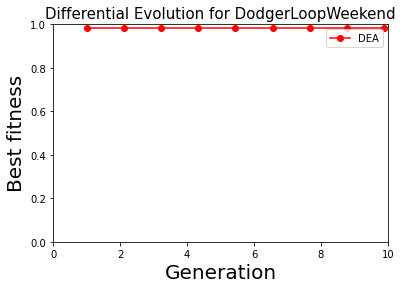

Currently dataset is GestureMidAirD1
(338, 1, 360)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/GestureMidAirD1_0_0.pkl
保存成功 ./generation/GestureMidAirD1_0_1.pkl
保存成功 ./generation/GestureMidAirD1_0_2.pkl
保存成功 ./generation/GestureMidAirD1_0_3.pkl
保存成功 ./generation/GestureMidAirD1_0_4.pkl
保存成功 ./generation/GestureMidAirD1_0_5.pkl
保存成功 ./generation/GestureMidAirD1_0_6.pkl
保存成功 ./generation/GestureMidAirD1_0_7.pkl
保存成功 ./generation/GestureMidAirD1_0_8.pkl
保存成功 ./generation/GestureMidAirD1_0_9.pkl
完成种群记录
第1个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.282379,3.263803,0.061538,00:00
1,3.275367,3.261325,0.061538,00:00
2,3.266712,3.258283,0.053846,00:00
3,3.266181,3.254116,0.053846,00:00
4,3.260988,3.248680,0.053846,00:00
5,3.258014,3.241564,0.069231,00:00
6,3.252789,3.232290,0.123077,00:00
7,3.247075,3.221188,0.130769,00:00
8,3.241096,3.207573,0.192308,00:00
9,3.234118,3.191769,0.200000,00:00


训练耗时:13
第2个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Dropout(p=0.30466549161090334, inplace=False)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.274252,3.269842,0.015385,00:00
1,3.279236,3.267177,0.015385,00:00
2,3.277693,3.263714,0.015385,00:00
3,3.276815,3.258983,0.015385,00:00
4,3.271731,3.252829,0.015385,00:00
5,3.268070,3.244732,0.015385,00:00
6,3.261973,3.234710,0.015385,00:00
7,3.253518,3.222430,0.015385,00:00
8,3.249250,3.208010,0.030769,00:00
9,3.240603,3.191002,0.061538,00:00


训练耗时:13
第3个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.272581,3.259336,0.046154,00:00
1,3.268524,3.257036,0.046154,00:00
2,3.271195,3.254120,0.053846,00:00
3,3.267703,3.250339,0.053846,00:00
4,3.263883,3.245502,0.053846,00:00
5,3.262206,3.238909,0.069231,00:00
6,3.256934,3.230296,0.076923,00:00
7,3.256492,3.219607,0.092308,00:00
8,3.251895,3.206393,0.107692,00:00
9,3.245274,3.191736,0.146154,00:00


训练耗时:18
第4个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ELU(alpha=1.0)
  (add_layer3): Linear(in_features=128, out_features=16, bias=True)
  (add_layer4): SELU()
  (

epoch,train_loss,valid_loss,accuracy,time
0,3.270267,3.264797,0.038462,00:00
1,3.265062,3.262864,0.038462,00:00
2,3.263026,3.260396,0.038462,00:00
3,3.265538,3.257131,0.038462,00:00
4,3.264674,3.252776,0.038462,00:00
5,3.262124,3.247245,0.038462,00:00
6,3.259351,3.240142,0.061538,00:00
7,3.257086,3.231526,0.076923,00:00
8,3.253076,3.220062,0.107692,00:00
9,3.246339,3.204466,0.123077,00:00


训练耗时:15
第5个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.255613,3.267486,0.046154,00:00
1,3.267137,3.265345,0.046154,00:00
2,3.273703,3.262209,0.046154,00:00
3,3.270623,3.257375,0.061538,00:00
4,3.269260,3.251643,0.069231,00:00
5,3.266772,3.245716,0.069231,00:00
6,3.263805,3.236821,0.084615,00:00
7,3.260707,3.225345,0.092308,00:00
8,3.251445,3.211305,0.100000,00:00
9,3.244962,3.196101,0.115385,00:00


训练耗时:18
第6个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,3.269375,3.266629,0.030769,00:00
1,3.266109,3.262492,0.030769,00:00
2,3.262780,3.258848,0.038462,00:00
3,3.260117,3.254759,0.038462,00:00
4,3.259241,3.249820,0.023077,00:00
5,3.257938,3.243317,0.038462,00:00
6,3.253189,3.235220,0.069231,00:00
7,3.251215,3.225549,0.076923,00:00
8,3.247557,3.214316,0.076923,00:00
9,3.243490,3.201154,0.076923,00:00


训练耗时:13
第7个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.294918,3.275764,0.015385,00:00
1,3.288984,3.273334,0.015385,00:00
2,3.287834,3.270106,0.015385,00:00
3,3.288813,3.265736,0.030769,00:00
4,3.283395,3.260425,0.038462,00:00
5,3.278908,3.253250,0.038462,00:00
6,3.273069,3.244335,0.038462,00:00
7,3.269097,3.232382,0.046154,00:00
8,3.262709,3.219213,0.061538,00:00
9,3.255337,3.203398,0.115385,00:00


训练耗时:17
第8个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,3.261820,3.255027,0.100000,00:00
1,3.259191,3.252263,0.115385,00:00
2,3.257497,3.248873,0.115385,00:00
3,3.258196,3.244242,0.123077,00:00
4,3.255575,3.237349,0.123077,00:00
5,3.254468,3.227453,0.130769,00:00
6,3.249429,3.214082,0.138462,00:00
7,3.242049,3.197286,0.153846,00:00
8,3.235063,3.176580,0.184615,00:00
9,3.225783,3.151223,0.238462,00:00


训练耗时:16
第9个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.280462,3.275335,0.053846,00:00
1,3.275900,3.267054,0.061538,00:00
2,3.268538,3.262972,0.061538,00:00
3,3.269944,3.258483,0.061538,00:00
4,3.273462,3.251973,0.076923,00:00
5,3.269842,3.244319,0.084615,00:00
6,3.265902,3.235353,0.100000,00:00
7,3.260694,3.223863,0.107692,00:00
8,3.254065,3.211151,0.123077,00:00
9,3.245607,3.195548,0.138462,00:00


训练耗时:18
第10个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_layer4): Sigmoid()


epoch,train_loss,valid_loss,accuracy,time
0,3.255115,3.245985,0.046154,00:00
1,3.264928,3.244025,0.053846,00:00
2,3.265480,3.241621,0.053846,00:00
3,3.257839,3.238501,0.053846,00:00
4,3.254902,3.234262,0.053846,00:00
5,3.251291,3.228612,0.061538,00:00
6,3.249456,3.221463,0.061538,00:00
7,3.245388,3.212295,0.092308,00:00
8,3.240656,3.200886,0.107692,00:00
9,3.238398,3.186935,0.146154,00:00


训练耗时:14

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/GestureMidAirD1_1_0.pkl
保存成功./generation/GestureMidAirD1_1_1.pkl
保存成功./generation/GestureMidAirD1_1_2.pkl
保存成功./generation/GestureMidAirD1_1_3.pkl
保存成功./generation/GestureMidAirD1_1_4.pkl
保存成功./generation/GestureMidAirD1_1_5.pkl
保存成功./generation/GestureMidAirD1_1_6.pkl
保存成功./generation/GestureMidAirD1_1_7.pkl
保存成功./generation/GestureMidAirD1_1_8.pkl
保存成功./generation/GestureMidAirD1_1_9.pkl
完成种群记录
Parent_fitness: [[0.62307692]
 [0.56153846]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.62307692]
 [0.5       ]
 [0.6769231 ]
 [0.53076923]
 [0.6076923 ]]
第1个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (

epoch,train_loss,valid_loss,accuracy,time
0,3.277952,3.251713,0.053846,00:00
1,3.274868,3.249263,0.053846,00:00
2,3.265797,3.246308,0.053846,00:00
3,3.266335,3.242375,0.053846,00:00
4,3.259526,3.236904,0.053846,00:00
5,3.254008,3.229227,0.076923,00:00
6,3.249703,3.218466,0.100000,00:00
7,3.244375,3.205277,0.123077,00:00
8,3.237813,3.187377,0.138462,00:00
9,3.228698,3.167003,0.153846,00:00


训练耗时:14
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Dropout(p=0.30466549161090334, inplace=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride

epoch,train_loss,valid_loss,accuracy,time
0,3.273100,3.263932,0.038462,00:00
1,3.269012,3.262333,0.046154,00:00
2,3.265804,3.259598,0.046154,00:00
3,3.264356,3.255408,0.053846,00:00
4,3.259446,3.248708,0.076923,00:00
5,3.255428,3.239794,0.092308,00:00
6,3.249780,3.225549,0.092308,00:00
7,3.244614,3.204718,0.123077,00:00
8,3.237006,3.177411,0.115385,00:00
9,3.228262,3.142433,0.123077,00:00


训练耗时:16
Mutate better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.287201,3.268362,0.030769,00:00
1,3.285088,3.265707,0.030769,00:00
2,3.283092,3.262640,0.030769,00:00
3,3.282203,3.258653,0.030769,00:00
4,3.279891,3.252397,0.053846,00:00
5,3.272665,3.245040,0.061538,00:00
6,3.268929,3.235786,0.061538,00:00
7,3.265410,3.225027,0.092308,00:00
8,3.257958,3.211218,0.123077,00:00
9,3.251770,3.195097,0.138462,00:00


训练耗时:17
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.300244,3.281313,0.030769,00:00
1,3.294211,3.278530,0.030769,00:00
2,3.286853,3.275114,0.038462,00:00
3,3.280315,3.270838,0.038462,00:00
4,3.274541,3.265415,0.038462,00:00
5,3.271357,3.258643,0.046154,00:00
6,3.265692,3.250383,0.053846,00:00
7,3.261216,3.239729,0.069231,00:00
8,3.255034,3.226839,0.107692,00:00
9,3.248029,3.212117,0.123077,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.281200,3.263674,0.038462,00:00
1,3.278759,3.261024,0.038462,00:00
2,3.278733,3.257538,0.038462,00:00
3,3.269392,3.252990,0.046154,00:00
4,3.268163,3.247148,0.046154,00:00
5,3.264200,3.239801,0.053846,00:00
6,3.257076,3.230695,0.130769,00:00
7,3.249221,3.220362,0.176923,00:00
8,3.242918,3.205706,0.223077,00:00
9,3.236670,3.189522,0.253846,00:00


训练耗时:18
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.279299,3.256086,0.023077,00:00
1,3.273010,3.254053,0.038462,00:00
2,3.268976,3.251212,0.053846,00:00
3,3.265404,3.246907,0.076923,00:00
4,3.260532,3.241239,0.084615,00:00
5,3.253863,3.233714,0.107692,00:00
6,3.251159,3.223504,0.100000,00:00
7,3.243185,3.211059,0.107692,00:00
8,3.235357,3.194978,0.115385,00:00
9,3.228500,3.171992,0.146154,00:00


训练耗时:15
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.265306,3.264765,0.084615,00:00
1,3.277089,3.262182,0.092308,00:00
2,3.281134,3.258841,0.084615,00:00
3,3.280609,3.254341,0.084615,00:00
4,3.279986,3.248752,0.076923,00:00
5,3.278175,3.241817,0.084615,00:00
6,3.269429,3.233528,0.115385,00:00
7,3.262117,3.222041,0.146154,00:00
8,3.253609,3.208161,0.153846,00:00
9,3.246085,3.191038,0.192308,00:00


训练耗时:18
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.269505,3.258667,0.038462,00:00
1,3.260911,3.256372,0.023077,00:00
2,3.254998,3.253734,0.038462,00:00
3,3.250711,3.250650,0.046154,00:00
4,3.247269,3.246787,0.046154,00:00
5,3.243810,3.242525,0.061538,00:00
6,3.240280,3.237661,0.053846,00:00
7,3.232777,3.231486,0.076923,00:00
8,3.226162,3.223870,0.153846,00:00
9,3.216971,3.214904,0.176923,00:00


训练耗时:15
Parent Better
Select完成
After selection [[0.62307692]
 [0.66153848]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.62307692]
 [0.54615384]
 [0.6769231 ]
 [0.53076923]
 [0.6076923 ]]
Round Best:
0.6769230961799622
structure is [['ZeroOp', 'Default'], ['conv', 64], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['Dense', 16], ['Maxpooling', 'Default'], ['conv', 256], ['conv', 64], ['Activate', 'selu'], ['ZeroOp', 'Default'], ['conv', 128], ['Dense', 256], ['Dense', 32]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, a

epoch,train_loss,valid_loss,accuracy,time
0,3.268257,3.268274,0.038462,00:00
1,3.272346,3.265527,0.038462,00:00
2,3.272195,3.262016,0.053846,00:00
3,3.276595,3.257468,0.053846,00:00
4,3.275536,3.251309,0.061538,00:00
5,3.272289,3.243402,0.061538,00:00
6,3.270456,3.233427,0.061538,00:00
7,3.262862,3.220966,0.084615,00:00
8,3.256596,3.205637,0.092308,00:00
9,3.249749,3.188597,0.115385,00:00


训练耗时:13
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(32, 256, kernel_size=(3,), s

epoch,train_loss,valid_loss,accuracy,time
0,3.289547,3.258044,0.030769,00:00
1,3.276204,3.257046,0.038462,00:00
2,3.275588,3.254840,0.046154,00:00
3,3.271831,3.251106,0.046154,00:00
4,3.268471,3.244837,0.046154,00:00
5,3.261110,3.235601,0.053846,00:00
6,3.256783,3.222461,0.069231,00:00
7,3.245908,3.204599,0.138462,00:00
8,3.238511,3.181987,0.161538,00:00
9,3.229121,3.150934,0.246154,00:00


训练耗时:15
Mutate better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.272886,3.270766,0.038462,00:00
1,3.279452,3.268145,0.030769,00:00
2,3.278214,3.264748,0.023077,00:00
3,3.276596,3.260218,0.053846,00:00
4,3.276642,3.254591,0.061538,00:00
5,3.273725,3.247496,0.076923,00:00
6,3.273904,3.238147,0.107692,00:00
7,3.270644,3.227631,0.100000,00:00
8,3.264916,3.214360,0.146154,00:00
9,3.261018,3.197919,0.200000,00:00


训练耗时:17
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.252823,3.263329,0.023077,00:00
1,3.268294,3.260634,0.023077,00:00
2,3.273512,3.257249,0.038462,00:00
3,3.268947,3.252885,0.053846,00:00
4,3.266001,3.247128,0.069231,00:00
5,3.259522,3.239793,0.092308,00:00
6,3.255531,3.230499,0.100000,00:00
7,3.250246,3.219253,0.130769,00:00
8,3.245570,3.205688,0.138462,00:00
9,3.239980,3.189503,0.161538,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.256514,3.254285,0.015385,00:00
1,3.263297,3.250431,0.053846,00:00
2,3.260535,3.247042,0.061538,00:00
3,3.263281,3.244133,0.084615,00:00
4,3.260168,3.240267,0.076923,00:00
5,3.255823,3.234833,0.084615,00:00
6,3.253574,3.227586,0.100000,00:00
7,3.251167,3.218735,0.092308,00:00
8,3.246260,3.208110,0.100000,00:00
9,3.241030,3.195151,0.107692,00:00


训练耗时:13
Mutate better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.282759,3.266790,0.053846,00:00
1,3.273086,3.264324,0.053846,00:00
2,3.270198,3.261473,0.046154,00:00
3,3.261550,3.257693,0.061538,00:00
4,3.262139,3.253259,0.069231,00:00
5,3.261768,3.246116,0.092308,00:00
6,3.257102,3.237513,0.100000,00:00
7,3.254057,3.227289,0.100000,00:00
8,3.248507,3.214239,0.123077,00:00
9,3.242991,3.199066,0.161538,00:00


训练耗时:17
Mutate better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.284343,3.255745,0.015385,00:00
1,3.275970,3.254360,0.030769,00:00
2,3.272042,3.252468,0.038462,00:00
3,3.269470,3.249903,0.030769,00:00
4,3.268037,3.246562,0.030769,00:00
5,3.264621,3.242206,0.030769,00:00
6,3.260080,3.236523,0.038462,00:00
7,3.256868,3.229468,0.046154,00:00
8,3.250643,3.220811,0.061538,00:00
9,3.244776,3.209966,0.084615,00:00


训练耗时:17
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_lay

epoch,train_loss,valid_loss,accuracy,time
0,3.277663,3.254269,0.038462,00:00
1,3.267608,3.251286,0.030769,00:00
2,3.261110,3.248294,0.030769,00:00
3,3.259041,3.244538,0.030769,00:00
4,3.259271,3.239324,0.046154,00:00
5,3.254855,3.233084,0.061538,00:00
6,3.252733,3.225042,0.053846,00:00
7,3.246445,3.214431,0.061538,00:00
8,3.240170,3.201780,0.069231,00:00
9,3.234274,3.186145,0.092308,00:00


训练耗时:15
Parent Better
Select完成
After selection [[0.62307692]
 [0.66923076]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.64615387]
 [0.55384618]
 [0.6769231 ]
 [0.53076923]
 [0.6076923 ]]
Round Best:
0.6769230961799622
structure is [['ZeroOp', 'Default'], ['conv', 64], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['Dense', 16], ['Maxpooling', 'Default'], ['conv', 256], ['conv', 64], ['Activate', 'selu'], ['ZeroOp', 'Default'], ['conv', 128], ['Dense', 256], ['Dense', 32]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, a

epoch,train_loss,valid_loss,accuracy,time
0,3.265260,3.256875,0.053846,00:00
1,3.264363,3.254538,0.053846,00:00
2,3.261562,3.251580,0.053846,00:00
3,3.260817,3.247384,0.069231,00:00
4,3.256888,3.241777,0.084615,00:00
5,3.255062,3.234492,0.100000,00:00
6,3.250814,3.225070,0.115385,00:00
7,3.249731,3.213645,0.123077,00:00
8,3.245101,3.199544,0.146154,00:00
9,3.237269,3.183065,0.184615,00:00


训练耗时:13
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(32, 256, kernel_size=(3,), s

epoch,train_loss,valid_loss,accuracy,time
0,3.271443,3.264412,0.015385,00:00
1,3.276303,3.261447,0.015385,00:00
2,3.268193,3.258743,0.015385,00:00
3,3.266782,3.257027,0.023077,00:00
4,3.266951,3.252694,0.023077,00:00
5,3.262091,3.244617,0.030769,00:00
6,3.260229,3.233799,0.015385,00:00
7,3.254191,3.221050,0.015385,00:00
8,3.249900,3.204936,0.046154,00:00
9,3.240705,3.178090,0.053846,00:00


训练耗时:15
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.246914,3.250415,0.076923,00:00
1,3.252787,3.248087,0.084615,00:00
2,3.254097,3.244880,0.092308,00:00
3,3.250995,3.240272,0.100000,00:00
4,3.254939,3.234037,0.107692,00:00
5,3.250464,3.225944,0.115385,00:00
6,3.243258,3.215575,0.115385,00:00
7,3.238587,3.203113,0.138462,00:00
8,3.231768,3.187878,0.153846,00:00
9,3.220924,3.171314,0.138462,00:00


训练耗时:17
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.279676,3.258644,0.046154,00:00
1,3.273321,3.256241,0.046154,00:00
2,3.265040,3.253737,0.046154,00:00
3,3.258487,3.249564,0.046154,00:00
4,3.258237,3.243726,0.046154,00:00
5,3.252196,3.236911,0.046154,00:00
6,3.252117,3.228008,0.053846,00:00
7,3.244872,3.216468,0.092308,00:00
8,3.240174,3.203972,0.130769,00:00
9,3.234702,3.187996,0.153846,00:00


训练耗时:18
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Sigmoid()
  (add_layer4):

epoch,train_loss,valid_loss,accuracy,time
0,3.273561,3.255998,0.053846,00:00
1,3.270335,3.253574,0.030769,00:00
2,3.266963,3.250651,0.046154,00:00
3,3.265743,3.246969,0.046154,00:00
4,3.263296,3.242061,0.061538,00:00
5,3.260722,3.235502,0.061538,00:00
6,3.256774,3.227292,0.069231,00:00
7,3.253822,3.217208,0.069231,00:00
8,3.249128,3.205168,0.076923,00:00
9,3.241209,3.190977,0.107692,00:00


训练耗时:14
Mutate better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.260930,3.266316,0.061538,00:00
1,3.268637,3.264066,0.069231,00:00
2,3.265736,3.261323,0.069231,00:00
3,3.267317,3.257699,0.069231,00:00
4,3.268005,3.252753,0.069231,00:00
5,3.267240,3.245761,0.076923,00:00
6,3.262063,3.236199,0.092308,00:00
7,3.257860,3.224735,0.100000,00:00
8,3.249716,3.211982,0.107692,00:00
9,3.241982,3.195205,0.138462,00:00


训练耗时:17
Mutate better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.245000,3.243737,0.038462,00:00
1,3.256179,3.241852,0.053846,00:00
2,3.255647,3.238265,0.053846,00:00
3,3.247740,3.233623,0.061538,00:00
4,3.246716,3.227426,0.069231,00:00
5,3.244570,3.220476,0.100000,00:00
6,3.238060,3.211661,0.115385,00:00
7,3.232502,3.200346,0.138462,00:00
8,3.228132,3.187616,0.138462,00:00
9,3.220955,3.170732,0.215385,00:00


训练耗时:17
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): Linear(in_features=128, out_features=8, bias=True)
  (add_lay

epoch,train_loss,valid_loss,accuracy,time
0,3.262292,3.246415,0.046154,00:00
1,3.259814,3.243621,0.053846,00:00
2,3.257423,3.240367,0.046154,00:00
3,3.258318,3.236005,0.053846,00:00
4,3.256661,3.230680,0.053846,00:00
5,3.254637,3.224069,0.061538,00:00
6,3.249334,3.215749,0.076923,00:00
7,3.245545,3.205713,0.092308,00:00
8,3.240498,3.193628,0.123077,00:00
9,3.237398,3.179193,0.146154,00:00


训练耗时:14
Parent Better
Select完成
After selection [[0.62307692]
 [0.66923076]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.6769231 ]
 [0.57692307]
 [0.6769231 ]
 [0.53846157]
 [0.6076923 ]]
Round Best:
0.6769230961799622
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Activate', 'sigmoid'], ['Dropout', 0.15636858313320456], ['Activate', 'selu'], ['conv', 128], ['ZeroOp', 'Default'], ['Activate', 'Relu'], ['conv', 8], ['ZeroOp', 'Default'], ['Dense', 8], ['ZeroOp', 'Default'], ['Dense', 128], ['Dropout', 0.4883793924021583], ['Dropout', 0.48328048086879083]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.310251,3.276289,0.030769,00:00
1,3.308558,3.273774,0.030769,00:00
2,3.303782,3.270454,0.030769,00:00
3,3.294305,3.265617,0.030769,00:00
4,3.287661,3.259331,0.038462,00:00
5,3.286348,3.250762,0.061538,00:00
6,3.282095,3.240262,0.069231,00:00
7,3.277437,3.227123,0.115385,00:00
8,3.274337,3.210711,0.123077,00:00
9,3.266236,3.192908,0.123077,00:00


训练耗时:17
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(32, 256, kernel_size=(3,), s

epoch,train_loss,valid_loss,accuracy,time
0,3.298339,3.282804,0.000000,00:00
1,3.280991,3.280887,0.000000,00:00
2,3.274487,3.277396,0.007692,00:00
3,3.270998,3.272940,0.007692,00:00
4,3.265837,3.266527,0.030769,00:00
5,3.261170,3.256597,0.023077,00:00
6,3.257283,3.240155,0.046154,00:00
7,3.252968,3.217864,0.069231,00:00
8,3.242769,3.192971,0.153846,00:00
9,3.231817,3.158107,0.176923,00:00


训练耗时:15
Mutate better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.250026,3.279661,0.015385,00:00
1,3.269915,3.277283,0.015385,00:00
2,3.269350,3.274084,0.015385,00:00
3,3.265952,3.269779,0.023077,00:00
4,3.265967,3.264485,0.030769,00:00
5,3.263627,3.257479,0.038462,00:00
6,3.262908,3.249117,0.038462,00:00
7,3.261753,3.238393,0.038462,00:00
8,3.258301,3.224952,0.046154,00:00
9,3.253544,3.209315,0.053846,00:00


训练耗时:17
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.245589,3.240163,0.061538,00:00
1,3.258082,3.237807,0.061538,00:00
2,3.257927,3.234476,0.061538,00:00
3,3.251153,3.230125,0.069231,00:00
4,3.246584,3.224565,0.069231,00:00
5,3.245854,3.217350,0.076923,00:00
6,3.239454,3.207896,0.107692,00:00
7,3.234044,3.196494,0.138462,00:00
8,3.227420,3.182504,0.176923,00:00
9,3.220273,3.165124,0.223077,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.289237,3.278575,0.038462,00:00
1,3.281323,3.274823,0.038462,00:00
2,3.280856,3.271184,0.038462,00:00
3,3.275453,3.265991,0.038462,00:00
4,3.273234,3.259079,0.038462,00:00
5,3.272070,3.250917,0.038462,00:00
6,3.266856,3.240094,0.038462,00:00
7,3.260327,3.227336,0.053846,00:00
8,3.253796,3.214318,0.092308,00:00
9,3.245807,3.199059,0.123077,00:00


训练耗时:17
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.296722,3.263948,0.046154,00:00
1,3.286865,3.262224,0.046154,00:00
2,3.286051,3.259137,0.046154,00:00
3,3.277014,3.255452,0.046154,00:00
4,3.273345,3.250390,0.046154,00:00
5,3.270432,3.243783,0.046154,00:00
6,3.266748,3.235147,0.046154,00:00
7,3.260026,3.223484,0.053846,00:00
8,3.254669,3.210740,0.046154,00:00
9,3.248332,3.193930,0.076923,00:00


训练耗时:17
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.271353,3.240938,0.061538,00:00
1,3.274441,3.238297,0.061538,00:00
2,3.256408,3.234961,0.061538,00:00
3,3.252387,3.230564,0.061538,00:00
4,3.247741,3.224818,0.061538,00:00
5,3.241702,3.217017,0.061538,00:00
6,3.236915,3.206548,0.069231,00:00
7,3.230198,3.193591,0.084615,00:00
8,3.223876,3.176236,0.107692,00:00
9,3.217112,3.153350,0.153846,00:00


训练耗时:16
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.255219,3.247313,0.046154,00:00
1,3.266369,3.245314,0.046154,00:00
2,3.258594,3.242646,0.053846,00:00
3,3.251171,3.239239,0.069231,00:00
4,3.243579,3.234496,0.069231,00:00
5,3.242512,3.228264,0.069231,00:00
6,3.239465,3.220016,0.069231,00:00
7,3.233690,3.210040,0.069231,00:00
8,3.226608,3.198071,0.084615,00:00
9,3.219935,3.182910,0.107692,00:00


训练耗时:16
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.62307692]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.6769231 ]
 [0.57692307]
 [0.6769231 ]
 [0.53846157]
 [0.6076923 ]]
Round Best:
0.699999988079071
structure is [['Dropout', 0.4616636975841916], ['Dense', 32], ['conv', 256], ['Dropout', 0.014425281140704405], ['conv', 16], ['conv', 32], ['Dropout', 0.14674951702291816], ['conv', 128], ['conv', 64], ['Dense', 128], ['Dropout', 0.06138783882477222], ['ZeroOp', 'Default'], ['Dense', 32], ['conv', 64], ['conv', 64]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bi

epoch,train_loss,valid_loss,accuracy,time
0,3.269140,3.253984,0.046154,00:00
1,3.259500,3.251892,0.053846,00:00
2,3.261327,3.249116,0.053846,00:00
3,3.258892,3.245322,0.061538,00:00
4,3.261780,3.240110,0.061538,00:00
5,3.258723,3.233536,0.061538,00:00
6,3.254844,3.224845,0.061538,00:00
7,3.248639,3.214152,0.084615,00:00
8,3.241951,3.201319,0.084615,00:00
9,3.234144,3.186406,0.076923,00:00


训练耗时:13
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.269600,3.250313,0.084615,00:00
1,3.266201,3.249248,0.069231,00:00
2,3.264130,3.245048,0.084615,00:00
3,3.259602,3.238564,0.107692,00:00
4,3.254742,3.230087,0.100000,00:00
5,3.249721,3.215919,0.092308,00:00
6,3.239653,3.198802,0.100000,00:00
7,3.229340,3.179379,0.138462,00:00
8,3.220356,3.148330,0.146154,00:00
9,3.209095,3.117671,0.153846,00:00


训练耗时:17
Parent Better
第3个变异个体
子代个体基因型受限
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=

epoch,train_loss,valid_loss,accuracy,time
0,3.288083,3.268025,0.000000,00:00
1,3.290678,3.265996,0.000000,00:00
2,3.288140,3.262737,0.000000,00:00
3,3.284867,3.258471,0.000000,00:00
4,3.283258,3.252804,0.000000,00:00
5,3.275670,3.245906,0.015385,00:00
6,3.273020,3.237280,0.030769,00:00
7,3.264966,3.226239,0.061538,00:00
8,3.257361,3.212729,0.123077,00:00
9,3.251798,3.196088,0.176923,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.273880,3.264319,0.015385,00:00
1,3.279233,3.261982,0.015385,00:00
2,3.279621,3.259056,0.023077,00:00
3,3.272700,3.255026,0.023077,00:00
4,3.268321,3.249584,0.023077,00:00
5,3.262300,3.242703,0.061538,00:00
6,3.257082,3.233610,0.076923,00:00
7,3.252549,3.222684,0.115385,00:00
8,3.244220,3.208882,0.130769,00:00
9,3.236848,3.192791,0.153846,00:00


训练耗时:17
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.270097,3.243082,0.061538,00:00
1,3.258893,3.240520,0.069231,00:00
2,3.254023,3.236962,0.084615,00:00
3,3.250343,3.230653,0.107692,00:00
4,3.243270,3.223446,0.130769,00:00
5,3.241750,3.215070,0.161538,00:00
6,3.233486,3.205954,0.153846,00:00
7,3.228026,3.194567,0.146154,00:00
8,3.221547,3.180285,0.138462,00:00
9,3.212887,3.162791,0.161538,00:00


训练耗时:17
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=8, bias=True)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): Linear(in_features=8, out

epoch,train_loss,valid_loss,accuracy,time
0,3.290755,3.272531,0.038462,00:00
1,3.274642,3.270407,0.030769,00:00
2,3.277285,3.267843,0.038462,00:00
3,3.275694,3.264152,0.038462,00:00
4,3.278297,3.259611,0.038462,00:00
5,3.277102,3.253770,0.038462,00:00
6,3.273903,3.246428,0.053846,00:00
7,3.268855,3.237365,0.069231,00:00
8,3.263410,3.226455,0.100000,00:00
9,3.258391,3.213823,0.123077,00:00


训练耗时:14
Parent Better
Select完成
After selection [[0.63846153]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.6769231 ]
 [0.57692307]
 [0.6769231 ]
 [0.53846157]
 [0.6076923 ]]
Round Best:
0.699999988079071
structure is [['Dropout', 0.4616636975841916], ['Dense', 32], ['conv', 256], ['Dropout', 0.014425281140704405], ['conv', 16], ['conv', 32], ['Dropout', 0.14674951702291816], ['conv', 128], ['conv', 64], ['Dense', 128], ['Dropout', 0.06138783882477222], ['ZeroOp', 'Default'], ['Dense', 32], ['conv', 64], ['conv', 64]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(25

epoch,train_loss,valid_loss,accuracy,time
0,3.260631,3.261625,0.023077,00:00
1,3.264281,3.259612,0.046154,00:00
2,3.263626,3.256706,0.061538,00:00
3,3.266963,3.252815,0.053846,00:00
4,3.261239,3.247967,0.053846,00:00
5,3.256634,3.241536,0.053846,00:00
6,3.254281,3.233291,0.053846,00:00
7,3.250579,3.222987,0.092308,00:00
8,3.244934,3.210705,0.115385,00:00
9,3.239131,3.196127,0.176923,00:00


训练耗时:13
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.259224,3.254262,0.030769,00:00
1,3.263189,3.251919,0.038462,00:00
2,3.260788,3.249445,0.046154,00:00
3,3.266299,3.245764,0.046154,00:00
4,3.261027,3.240877,0.061538,00:00
5,3.256248,3.234184,0.061538,00:00
6,3.251393,3.226320,0.061538,00:00
7,3.245346,3.215997,0.076923,00:00
8,3.238634,3.203618,0.084615,00:00
9,3.232538,3.188797,0.100000,00:00


训练耗时:17
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.271929,3.272928,0.023077,00:00
1,3.286526,3.270839,0.023077,00:00
2,3.288867,3.267430,0.023077,00:00
3,3.282598,3.263569,0.046154,00:00
4,3.280451,3.257888,0.061538,00:00
5,3.274520,3.250155,0.076923,00:00
6,3.271639,3.240003,0.100000,00:00
7,3.266546,3.228469,0.123077,00:00
8,3.258420,3.214163,0.153846,00:00
9,3.251949,3.196998,0.176923,00:00


训练耗时:18
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,3.290312,3.274724,0.000000,00:00
1,3.280222,3.271726,0.007692,00:00
2,3.287872,3.268515,0.007692,00:00
3,3.288138,3.264596,0.023077,00:00
4,3.278819,3.258890,0.030769,00:00
5,3.275645,3.251299,0.038462,00:00
6,3.270400,3.240274,0.046154,00:00
7,3.260125,3.226209,0.076923,00:00
8,3.251064,3.208029,0.084615,00:00
9,3.241321,3.184643,0.161538,00:00


训练耗时:18
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.268667,3.260913,0.061538,00:00
1,3.260248,3.258373,0.069231,00:00
2,3.266739,3.255100,0.076923,00:00
3,3.271290,3.250894,0.069231,00:00
4,3.267289,3.245216,0.076923,00:00
5,3.264505,3.237604,0.069231,00:00
6,3.260419,3.227595,0.076923,00:00
7,3.255435,3.215172,0.076923,00:00
8,3.247249,3.199011,0.100000,00:00
9,3.240628,3.177911,0.123077,00:00


训练耗时:17
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.260710,3.249758,0.000000,00:00
1,3.264169,3.247585,0.000000,00:00
2,3.256583,3.244553,0.000000,00:00
3,3.255927,3.240136,0.000000,00:00
4,3.251941,3.233850,0.000000,00:00
5,3.250068,3.225299,0.030769,00:00
6,3.244381,3.214189,0.069231,00:00
7,3.239642,3.200563,0.130769,00:00
8,3.232694,3.184350,0.169231,00:00
9,3.224812,3.165117,0.223077,00:00


训练耗时:16
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.285456,3.276306,0.000000,00:00
1,3.279566,3.273230,0.000000,00:00
2,3.286525,3.270047,0.000000,00:00
3,3.285388,3.266199,0.015385,00:00
4,3.279834,3.261549,0.015385,00:00
5,3.279102,3.255428,0.015385,00:00
6,3.275188,3.247448,0.030769,00:00
7,3.270702,3.237417,0.030769,00:00
8,3.265657,3.225227,0.061538,00:00
9,3.259299,3.210999,0.076923,00:00


训练耗时:17
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride

epoch,train_loss,valid_loss,accuracy,time
0,3.253961,3.258217,0.038462,00:00
1,3.253682,3.257103,0.038462,00:00
2,3.252151,3.254770,0.038462,00:00
3,3.251472,3.251431,0.053846,00:00
4,3.248217,3.246671,0.061538,00:00
5,3.243403,3.240409,0.061538,00:00
6,3.236338,3.230347,0.069231,00:00
7,3.229153,3.216630,0.084615,00:00
8,3.216834,3.199336,0.092308,00:00
9,3.207151,3.175959,0.130769,00:00


训练耗时:18
Mutate better
Select完成
After selection [[0.63846153]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.6769231 ]
 [0.6769231 ]
 [0.6769231 ]
 [0.53846157]
 [0.65384614]]
Round Best:
0.699999988079071
structure is [['Dropout', 0.4616636975841916], ['Dense', 32], ['conv', 256], ['Dropout', 0.014425281140704405], ['conv', 16], ['conv', 32], ['Dropout', 0.14674951702291816], ['conv', 128], ['conv', 64], ['Dense', 128], ['Dropout', 0.06138783882477222], ['ZeroOp', 'Default'], ['Dense', 32], ['conv', 64], ['conv', 64]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(25

epoch,train_loss,valid_loss,accuracy,time
0,3.268916,3.271146,0.030769,00:00
1,3.274188,3.268698,0.030769,00:00
2,3.277250,3.265527,0.038462,00:00
3,3.273091,3.261223,0.046154,00:00
4,3.268560,3.255547,0.046154,00:00
5,3.266121,3.248187,0.053846,00:00
6,3.261652,3.238846,0.061538,00:00
7,3.260416,3.227264,0.076923,00:00
8,3.255722,3.213154,0.107692,00:00
9,3.250918,3.196639,0.169231,00:00


训练耗时:13
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(32, 256, kernel_size=(3,), s

epoch,train_loss,valid_loss,accuracy,time
0,3.260865,3.269482,0.000000,00:00
1,3.260643,3.267663,0.007692,00:00
2,3.260729,3.265528,0.015385,00:00
3,3.261895,3.262694,0.023077,00:00
4,3.257622,3.258842,0.023077,00:00
5,3.255171,3.253671,0.030769,00:00
6,3.255476,3.247154,0.038462,00:00
7,3.251957,3.239284,0.046154,00:00
8,3.245905,3.230361,0.084615,00:00
9,3.236296,3.220341,0.115385,00:00


训练耗时:15
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.267316,3.257010,0.030769,00:00
1,3.281932,3.253666,0.023077,00:00
2,3.274650,3.249805,0.023077,00:00
3,3.272456,3.244272,0.023077,00:00
4,3.268226,3.237529,0.023077,00:00
5,3.263280,3.229724,0.038462,00:00
6,3.258402,3.220722,0.053846,00:00
7,3.253962,3.208714,0.069231,00:00
8,3.248234,3.194571,0.130769,00:00
9,3.243248,3.178315,0.169231,00:00


训练耗时:17
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.2620295228184565, inplace=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): ConvBlock(
    (0): Con

epoch,train_loss,valid_loss,accuracy,time
0,3.273356,3.253651,0.061538,00:00
1,3.268796,3.251182,0.069231,00:00
2,3.266462,3.247921,0.076923,00:00
3,3.264791,3.243853,0.076923,00:00
4,3.255849,3.238545,0.092308,00:00
5,3.254477,3.231522,0.092308,00:00
6,3.249075,3.222394,0.092308,00:00
7,3.242635,3.210593,0.084615,00:00
8,3.240056,3.196377,0.100000,00:00
9,3.235228,3.179540,0.107692,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,3.237668,3.234639,0.069231,00:00
1,3.240873,3.231896,0.076923,00:00
2,3.230759,3.228261,0.084615,00:00
3,3.230922,3.223934,0.076923,00:00
4,3.228591,3.218182,0.076923,00:00
5,3.223822,3.210123,0.076923,00:00
6,3.217182,3.199649,0.092308,00:00
7,3.212134,3.186008,0.146154,00:00
8,3.206812,3.168745,0.153846,00:00
9,3.197284,3.147563,0.161538,00:00


训练耗时:16
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.292248,3.275376,0.061538,00:00
1,3.286376,3.272917,0.069231,00:00
2,3.286697,3.269934,0.061538,00:00
3,3.284209,3.266072,0.061538,00:00
4,3.280540,3.260975,0.061538,00:00
5,3.276315,3.253975,0.061538,00:00
6,3.268519,3.244687,0.061538,00:00
7,3.261767,3.233485,0.069231,00:00
8,3.255285,3.218392,0.092308,00:00
9,3.248835,3.198684,0.115385,00:00


训练耗时:17
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.273267,3.265456,0.046154,00:00
1,3.272810,3.262791,0.046154,00:00
2,3.276095,3.258986,0.046154,00:00
3,3.274074,3.254097,0.046154,00:00
4,3.269162,3.247709,0.053846,00:00
5,3.266815,3.239561,0.053846,00:00
6,3.259801,3.230409,0.053846,00:00
7,3.258216,3.218847,0.061538,00:00
8,3.253264,3.205151,0.084615,00:00
9,3.244757,3.188112,0.115385,00:00


训练耗时:17
Mutate better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.63846153]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.6769231 ]
 [0.6769231 ]
 [0.6769231 ]
 [0.56153846]
 [0.65384614]]
Round Best:
0.699999988079071
structure is [['Dropout', 0.4616636975841916], ['Dense', 32], ['conv', 256], ['Dropout', 0.014425281140704405], ['conv', 16], ['conv', 32], ['Dropout', 0.14674951702291816], ['conv', 128], ['conv', 64], ['Dense', 128], ['Dropout', 0.06138783882477222], ['ZeroOp', 'Default'], ['Dense', 32], ['conv', 64], ['conv', 64]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bi

epoch,train_loss,valid_loss,accuracy,time
0,3.259768,3.263577,0.023077,00:00
1,3.267096,3.261390,0.038462,00:00
2,3.262267,3.258577,0.053846,00:00
3,3.260134,3.254527,0.076923,00:00
4,3.256070,3.249060,0.084615,00:00
5,3.252290,3.241798,0.084615,00:00
6,3.251943,3.232912,0.084615,00:00
7,3.247508,3.219451,0.076923,00:00
8,3.242571,3.206466,0.107692,00:00
9,3.236955,3.191760,0.100000,00:00


训练耗时:18
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.271800,3.269703,0.053846,00:00
1,3.280699,3.266884,0.053846,00:00
2,3.282230,3.263783,0.061538,00:00
3,3.274928,3.259837,0.053846,00:00
4,3.272478,3.254606,0.053846,00:00
5,3.272533,3.247701,0.053846,00:00
6,3.264754,3.238875,0.053846,00:00
7,3.260080,3.228116,0.061538,00:00
8,3.250999,3.214894,0.069231,00:00
9,3.244996,3.198897,0.084615,00:00


训练耗时:18
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.295122,3.277701,0.023077,00:00
1,3.287552,3.275291,0.023077,00:00
2,3.289931,3.272152,0.023077,00:00
3,3.286083,3.267765,0.015385,00:00
4,3.281230,3.262052,0.023077,00:00
5,3.274813,3.254494,0.023077,00:00
6,3.270362,3.244770,0.038462,00:00
7,3.264326,3.232683,0.038462,00:00
8,3.258066,3.217858,0.053846,00:00
9,3.250473,3.199990,0.069231,00:00


训练耗时:17
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.292497,3.282565,0.000000,00:00
1,3.286663,3.280333,0.000000,00:00
2,3.283969,3.277423,0.000000,00:00
3,3.283916,3.273408,0.000000,00:00
4,3.283361,3.268205,0.000000,00:00
5,3.280371,3.261480,0.000000,00:00
6,3.274373,3.252399,0.000000,00:00
7,3.273668,3.240863,0.000000,00:00
8,3.268076,3.226553,0.015385,00:00
9,3.264044,3.210053,0.061538,00:00


训练耗时:17
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride

epoch,train_loss,valid_loss,accuracy,time
0,3.284420,3.261408,0.023077,00:00
1,3.277190,3.260517,0.030769,00:00
2,3.271746,3.259491,0.015385,00:00
3,3.266627,3.255563,0.007692,00:00
4,3.260268,3.250504,0.015385,00:00
5,3.255018,3.243475,0.023077,00:00
6,3.250285,3.232945,0.053846,00:00
7,3.242615,3.219741,0.069231,00:00
8,3.231304,3.203511,0.092308,00:00
9,3.218196,3.184558,0.123077,00:00


训练耗时:18
Mutate better
Select完成
After selection [[0.63846153]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.58461541]
 [0.6769231 ]
 [0.6769231 ]
 [0.6769231 ]
 [0.56923079]
 [0.66153848]]
Round Best:
0.699999988079071
structure is [['Dropout', 0.4616636975841916], ['Dense', 32], ['conv', 256], ['Dropout', 0.014425281140704405], ['conv', 16], ['conv', 32], ['Dropout', 0.14674951702291816], ['conv', 128], ['conv', 64], ['Dense', 128], ['Dropout', 0.06138783882477222], ['ZeroOp', 'Default'], ['Dense', 32], ['conv', 64], ['conv', 64]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(25

epoch,train_loss,valid_loss,accuracy,time
0,3.256356,3.254871,0.007692,00:00
1,3.257879,3.251451,0.053846,00:00
2,3.254411,3.248241,0.053846,00:00
3,3.249875,3.243560,0.061538,00:00
4,3.245502,3.237275,0.069231,00:00
5,3.236812,3.227365,0.076923,00:00
6,3.232628,3.214298,0.084615,00:00
7,3.224086,3.197343,0.084615,00:00
8,3.214335,3.176320,0.092308,00:00
9,3.206011,3.149987,0.084615,00:00


训练耗时:15
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.4616636975841916, inplace=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(32, 256, kernel_size=(3,), s

epoch,train_loss,valid_loss,accuracy,time
0,3.255364,3.253519,0.069231,00:00
1,3.269399,3.253959,0.069231,00:00
2,3.267258,3.252801,0.053846,00:00
3,3.265685,3.249909,0.046154,00:00
4,3.260601,3.244514,0.053846,00:00
5,3.259244,3.236336,0.069231,00:00
6,3.252584,3.224595,0.076923,00:00
7,3.249383,3.208807,0.107692,00:00
8,3.242971,3.190200,0.184615,00:00
9,3.236631,3.165644,0.215385,00:00


训练耗时:16
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.296297,3.277889,0.015385,00:00
1,3.302739,3.275425,0.015385,00:00
2,3.303594,3.272627,0.015385,00:00
3,3.302037,3.268882,0.023077,00:00
4,3.302041,3.263616,0.023077,00:00
5,3.294146,3.257180,0.023077,00:00
6,3.287868,3.247972,0.023077,00:00
7,3.278665,3.237031,0.030769,00:00
8,3.274336,3.223800,0.046154,00:00
9,3.268293,3.207664,0.053846,00:00


训练耗时:16
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.256868,3.267566,0.015385,00:00
1,3.270436,3.265957,0.007692,00:00
2,3.273598,3.262803,0.007692,00:00
3,3.273195,3.258992,0.038462,00:00
4,3.266128,3.253658,0.046154,00:00
5,3.261966,3.247499,0.046154,00:00
6,3.258551,3.239262,0.046154,00:00
7,3.252733,3.226666,0.061538,00:00
8,3.247374,3.212566,0.076923,00:00
9,3.237637,3.196734,0.084615,00:00


训练耗时:17
Mutate better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Sigmoid()
  (add_layer4):

epoch,train_loss,valid_loss,accuracy,time
0,3.270059,3.263751,0.030769,00:00
1,3.270028,3.261585,0.053846,00:00
2,3.269815,3.259386,0.038462,00:00
3,3.267097,3.256385,0.038462,00:00
4,3.265115,3.251895,0.046154,00:00
5,3.262582,3.245840,0.053846,00:00
6,3.260496,3.238284,0.061538,00:00
7,3.258461,3.228951,0.061538,00:00
8,3.254202,3.217628,0.069231,00:00
9,3.248528,3.203866,0.076923,00:00


训练耗时:14
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.277112,3.263783,0.038462,00:00
1,3.284525,3.261257,0.038462,00:00
2,3.275835,3.257868,0.038462,00:00
3,3.274557,3.253119,0.038462,00:00
4,3.269642,3.246551,0.038462,00:00
5,3.265858,3.238350,0.053846,00:00
6,3.257602,3.228299,0.046154,00:00
7,3.251614,3.214747,0.053846,00:00
8,3.243389,3.197796,0.107692,00:00
9,3.232854,3.178941,0.153846,00:00


训练耗时:17
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.266261,3.255240,0.038462,00:00
1,3.256794,3.253490,0.046154,00:00
2,3.254294,3.251455,0.046154,00:00
3,3.248593,3.248767,0.046154,00:00
4,3.242641,3.245288,0.046154,00:00
5,3.233896,3.240726,0.061538,00:00
6,3.227376,3.235151,0.069231,00:00
7,3.217818,3.228278,0.084615,00:00
8,3.207134,3.219508,0.138462,00:00
9,3.192724,3.210822,0.207692,00:00


训练耗时:15
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.291082,3.265092,0.030769,00:00
1,3.286497,3.262678,0.038462,00:00
2,3.286022,3.259258,0.038462,00:00
3,3.281041,3.254436,0.030769,00:00
4,3.275076,3.248581,0.038462,00:00
5,3.271552,3.240782,0.038462,00:00
6,3.267482,3.230893,0.046154,00:00
7,3.264488,3.218348,0.053846,00:00
8,3.258721,3.203798,0.069231,00:00
9,3.251778,3.186038,0.100000,00:00


训练耗时:17
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride

epoch,train_loss,valid_loss,accuracy,time
0,3.278976,3.261894,0.053846,00:00
1,3.272718,3.260079,0.069231,00:00
2,3.269551,3.257737,0.069231,00:00
3,3.264090,3.254522,0.076923,00:00
4,3.257623,3.249549,0.076923,00:00
5,3.252473,3.242881,0.084615,00:00
6,3.249556,3.234046,0.130769,00:00
7,3.241584,3.223014,0.153846,00:00
8,3.233136,3.210215,0.169231,00:00
9,3.218923,3.193901,0.161538,00:00


训练耗时:18
Mutate better
Select完成
After selection [[0.70769233]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.59230769]
 [0.6769231 ]
 [0.6769231 ]
 [0.6769231 ]
 [0.56923079]
 [0.69230771]]
Round Best:
0.7076923251152039
structure is [['Maxpooling', 'Default'], ['Activate', 'elu'], ['conv', 32], ['Dense', 8], ['conv', 8], ['conv', 256], ['Maxpooling', 'Default'], ['Activate', 'Relu'], ['conv', 32], ['conv', 8], ['Dense', 64], ['Activate', 'selu'], ['ZeroOp', 'Default'], ['conv', 128], ['Dropout', 0.4650082875395285]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, mo

epoch,train_loss,valid_loss,accuracy,time
0,3.275243,3.267441,0.061538,00:00
1,3.271140,3.262369,0.069231,00:00
2,3.267293,3.257060,0.076923,00:00
3,3.265115,3.252838,0.069231,00:00
4,3.257729,3.244971,0.069231,00:00
5,3.256078,3.235822,0.061538,00:00
6,3.251425,3.225080,0.069231,00:00
7,3.243536,3.209453,0.084615,00:00
8,3.236012,3.190179,0.115385,00:00
9,3.227765,3.167123,0.146154,00:00


训练耗时:15
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.283872,3.263350,0.038462,00:00
1,3.284376,3.262097,0.030769,00:00
2,3.274817,3.258538,0.046154,00:00
3,3.270377,3.255307,0.046154,00:00
4,3.262353,3.250457,0.053846,00:00
5,3.260997,3.243635,0.053846,00:00
6,3.258660,3.232829,0.053846,00:00
7,3.253222,3.219987,0.061538,00:00
8,3.245769,3.201732,0.123077,00:00
9,3.235681,3.175135,0.192308,00:00


训练耗时:17
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.287245,3.271041,0.023077,00:00
1,3.291076,3.268509,0.023077,00:00
2,3.284343,3.265015,0.023077,00:00
3,3.276034,3.260796,0.023077,00:00
4,3.272849,3.254961,0.023077,00:00
5,3.270128,3.247782,0.023077,00:00
6,3.265754,3.238147,0.046154,00:00
7,3.260402,3.225952,0.069231,00:00
8,3.252004,3.211364,0.100000,00:00
9,3.244409,3.194414,0.107692,00:00


训练耗时:18
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(

epoch,train_loss,valid_loss,accuracy,time
0,3.265373,3.259029,0.046154,00:00
1,3.265639,3.256134,0.061538,00:00
2,3.266729,3.252971,0.069231,00:00
3,3.264533,3.248970,0.069231,00:00
4,3.263873,3.243737,0.069231,00:00
5,3.261765,3.236531,0.069231,00:00
6,3.260554,3.227416,0.069231,00:00
7,3.254146,3.216205,0.084615,00:00
8,3.248908,3.202674,0.138462,00:00
9,3.241221,3.186659,0.161538,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.279698,3.262163,0.038462,00:00
1,3.277884,3.259896,0.038462,00:00
2,3.265179,3.256955,0.038462,00:00
3,3.264880,3.252859,0.046154,00:00
4,3.263483,3.247235,0.046154,00:00
5,3.259919,3.239854,0.046154,00:00
6,3.252469,3.229382,0.046154,00:00
7,3.246162,3.216192,0.046154,00:00
8,3.238579,3.200421,0.069231,00:00
9,3.231611,3.181617,0.130769,00:00


训练耗时:16
Parent Better
第8个变异个体
子代个体基因型受限
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.262911,3.248538,0.015385,00:00
1,3.260650,3.245959,0.023077,00:00
2,3.261263,3.242079,0.023077,00:00
3,3.261274,3.237467,0.023077,00:00
4,3.257189,3.232185,0.038462,00:00
5,3.256667,3.224921,0.053846,00:00
6,3.247150,3.215666,0.061538,00:00
7,3.243273,3.203539,0.053846,00:00
8,3.236425,3.185799,0.107692,00:00
9,3.229872,3.167444,0.138462,00:00


训练耗时:17
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.70769233]
 [0.69999999]
 [0.56153846]
 [0.46153846]
 [0.59230769]
 [0.6769231 ]
 [0.6769231 ]
 [0.6769231 ]
 [0.56923079]
 [0.69230771]]
Round Best:
0.7076923251152039
structure is [['Maxpooling', 'Default'], ['Activate', 'elu'], ['conv', 32], ['Dense', 8], ['conv', 8], ['conv', 256], ['Maxpooling', 'Default'], ['Activate', 'Relu'], ['conv', 32], ['conv', 8], ['Dense', 64], ['Activate', 'selu'], ['ZeroOp', 'Default'], ['conv', 128], ['Dropout', 0.4650082875395285]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1

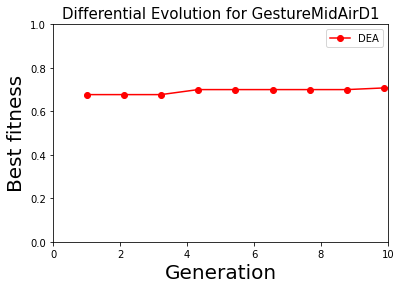

Currently dataset is GestureMidAirD2
(338, 1, 360)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/GestureMidAirD2_0_0.pkl
保存成功 ./generation/GestureMidAirD2_0_1.pkl
保存成功 ./generation/GestureMidAirD2_0_2.pkl
保存成功 ./generation/GestureMidAirD2_0_3.pkl
保存成功 ./generation/GestureMidAirD2_0_4.pkl
保存成功 ./generation/GestureMidAirD2_0_5.pkl
保存成功 ./generation/GestureMidAirD2_0_6.pkl
保存成功 ./generation/GestureMidAirD2_0_7.pkl
保存成功 ./generation/GestureMidAirD2_0_8.pkl
保存成功 ./generation/GestureMidAirD2_0_9.pkl
完成种群记录
第1个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1

epoch,train_loss,valid_loss,accuracy,time
0,3.281763,3.271473,0.053846,00:00
1,3.281172,3.268593,0.053846,00:00
2,3.280014,3.265082,0.061538,00:00
3,3.274242,3.260479,0.084615,00:00
4,3.270229,3.254613,0.084615,00:00
5,3.268902,3.246874,0.084615,00:00
6,3.264620,3.236907,0.092308,00:00
7,3.260262,3.224681,0.115385,00:00
8,3.253628,3.210088,0.138462,00:00
9,3.250289,3.192921,0.169231,00:00


训练耗时:14
第2个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.263868,3.234941,0.046154,00:00
1,3.267173,3.232398,0.061538,00:00
2,3.262687,3.229434,0.069231,00:00
3,3.260056,3.225026,0.092308,00:00
4,3.257514,3.219013,0.100000,00:00
5,3.253447,3.211514,0.123077,00:00
6,3.248014,3.201835,0.123077,00:00
7,3.246744,3.190330,0.123077,00:00
8,3.242185,3.176438,0.161538,00:00
9,3.234411,3.161310,0.184615,00:00


训练耗时:17
第3个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): Dropout(p=0.22549425575706972, inplace=False)
  (add_layer5): ConvBlock(
    (0): Conv1d(256, 8, kernel_size=(3,), stride=(1,), pad

epoch,train_loss,valid_loss,accuracy,time
0,3.308166,3.278532,0.015385,00:00
1,3.298117,3.275844,0.030769,00:00
2,3.293277,3.272478,0.030769,00:00
3,3.290944,3.268029,0.030769,00:00
4,3.289063,3.262069,0.038462,00:00
5,3.287227,3.254390,0.038462,00:00
6,3.280859,3.244751,0.046154,00:00
7,3.274865,3.232959,0.046154,00:00
8,3.269518,3.218892,0.084615,00:00
9,3.265474,3.202434,0.115385,00:00


训练耗时:14
第4个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): Linear(in_features=128, out_features=256, bias=True)
  (add_layer4): Softmax(d

epoch,train_loss,valid_loss,accuracy,time
0,3.276941,3.261250,0.046154,00:00
1,3.278117,3.258858,0.046154,00:00
2,3.274861,3.255831,0.053846,00:00
3,3.274920,3.251883,0.061538,00:00
4,3.268111,3.246811,0.061538,00:00
5,3.266215,3.240254,0.076923,00:00
6,3.265054,3.231972,0.092308,00:00
7,3.263102,3.221635,0.115385,00:00
8,3.253386,3.209210,0.138462,00:00
9,3.245171,3.194269,0.138462,00:00


训练耗时:15
第5个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.269866,3.262628,0.007692,00:00
1,3.271657,3.260139,0.007692,00:00
2,3.278022,3.257001,0.007692,00:00
3,3.272641,3.252933,0.015385,00:00
4,3.271363,3.247520,0.023077,00:00
5,3.264388,3.240509,0.023077,00:00
6,3.257573,3.231424,0.023077,00:00
7,3.252933,3.220295,0.030769,00:00
8,3.245563,3.207039,0.046154,00:00
9,3.237541,3.191236,0.076923,00:00


训练耗时:17
第6个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.18606928486401125, inplace=Fa

epoch,train_loss,valid_loss,accuracy,time
0,3.278911,3.253175,0.046154,00:00
1,3.267121,3.250325,0.046154,00:00
2,3.263560,3.246753,0.053846,00:00
3,3.256138,3.242135,0.061538,00:00
4,3.253151,3.236270,0.069231,00:00
5,3.251486,3.228656,0.069231,00:00
6,3.247928,3.219201,0.092308,00:00
7,3.243572,3.207742,0.100000,00:00
8,3.237329,3.194070,0.115385,00:00
9,3.231448,3.177677,0.130769,00:00


训练耗时:13
第7个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer6): MaxPool1d(kernel_s

epoch,train_loss,valid_loss,accuracy,time
0,3.260624,3.255239,0.038462,00:00
1,3.259267,3.252707,0.053846,00:00
2,3.267257,3.249504,0.061538,00:00
3,3.261109,3.245223,0.061538,00:00
4,3.257974,3.239523,0.061538,00:00
5,3.256708,3.232128,0.069231,00:00
6,3.250838,3.222899,0.061538,00:00
7,3.249071,3.211443,0.076923,00:00
8,3.241670,3.197780,0.092308,00:00
9,3.235260,3.181336,0.130769,00:00


训练耗时:14
第8个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.279243,3.264671,0.015385,00:00
1,3.273211,3.262388,0.030769,00:00
2,3.270799,3.258965,0.030769,00:00
3,3.269241,3.254469,0.030769,00:00
4,3.260637,3.248767,0.023077,00:00
5,3.259995,3.241132,0.030769,00:00
6,3.257344,3.231661,0.046154,00:00
7,3.253501,3.219588,0.100000,00:00
8,3.247483,3.205084,0.123077,00:00
9,3.242947,3.188939,0.146154,00:00


训练耗时:17
第9个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer3): Dropout(p=0.38208719440452893, inplace=False)
  (add_layer4): Dropout(p=0.26837394176581, inplace=False)
  (add_layer5): Softmax(dim=None)
  (add_layer6): Dropout(p=0.0570260

epoch,train_loss,valid_loss,accuracy,time
0,3.251336,3.248893,0.046154,00:00
1,3.261476,3.248035,0.069231,00:00
2,3.257224,3.246611,0.061538,00:00
3,3.253152,3.244276,0.061538,00:00
4,3.250333,3.240849,0.076923,00:00
5,3.248734,3.236434,0.100000,00:00
6,3.245557,3.231322,0.115385,00:00
7,3.240756,3.226393,0.115385,00:00
8,3.236006,3.222169,0.115385,00:00
9,3.229863,3.218856,0.100000,00:00


训练耗时:14
第10个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
 

epoch,train_loss,valid_loss,accuracy,time
0,3.262015,3.261042,0.023077,00:00
1,3.276606,3.259139,0.023077,00:00
2,3.270758,3.256710,0.023077,00:00
3,3.269630,3.253395,0.023077,00:00
4,3.268894,3.249059,0.030769,00:00
5,3.262766,3.243424,0.038462,00:00
6,3.258810,3.236198,0.061538,00:00
7,3.256425,3.227304,0.100000,00:00
8,3.250371,3.216542,0.107692,00:00
9,3.245190,3.203746,0.153846,00:00


训练耗时:14

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/GestureMidAirD2_1_0.pkl
保存成功./generation/GestureMidAirD2_1_1.pkl
保存成功./generation/GestureMidAirD2_1_2.pkl
保存成功./generation/GestureMidAirD2_1_3.pkl
保存成功./generation/GestureMidAirD2_1_4.pkl
保存成功./generation/GestureMidAirD2_1_5.pkl
保存成功./generation/GestureMidAirD2_1_6.pkl
保存成功./generation/GestureMidAirD2_1_7.pkl
保存成功./generation/GestureMidAirD2_1_8.pkl
保存成功./generation/GestureMidAirD2_1_9.pkl
完成种群记录
Parent_fitness: [[0.51538461]
 [0.53076923]
 [0.46923077]
 [0.52307695]
 [0.56923079]
 [0.59230769]
 [0.52307695]
 [0.56923079]
 [0.03076923]
 [0.44615385]]
第1个变异个体
子代个体基因型受限
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.266021,3.275233,0.038462,00:00
1,3.269167,3.271728,0.038462,00:00
2,3.275666,3.267858,0.038462,00:00
3,3.279829,3.263569,0.046154,00:00
4,3.273977,3.258055,0.046154,00:00
5,3.267873,3.250814,0.046154,00:00
6,3.265370,3.241496,0.046154,00:00
7,3.261511,3.229555,0.069231,00:00
8,3.255529,3.213783,0.092308,00:00
9,3.247826,3.195245,0.123077,00:00


训练耗时:17
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): Dropout(p=0.22549425575706972, inplace=False)
  (add_layer5): ConvBlock(
    (0): Conv1d(256, 8, kernel_size=(3,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.274750,3.251948,0.053846,00:00
1,3.267245,3.249354,0.053846,00:00
2,3.263630,3.246033,0.061538,00:00
3,3.260005,3.241639,0.061538,00:00
4,3.253417,3.235770,0.061538,00:00
5,3.252437,3.228175,0.069231,00:00
6,3.249795,3.218655,0.084615,00:00
7,3.245363,3.207046,0.084615,00:00
8,3.241551,3.193047,0.100000,00:00
9,3.234639,3.176509,0.123077,00:00


训练耗时:14
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.275539,3.250011,0.061538,00:00
1,3.268343,3.246833,0.061538,00:00
2,3.258157,3.243705,0.053846,00:00
3,3.255131,3.239319,0.061538,00:00
4,3.253146,3.233406,0.069231,00:00
5,3.247473,3.225683,0.069231,00:00
6,3.243101,3.216429,0.076923,00:00
7,3.239882,3.205293,0.092308,00:00
8,3.234214,3.191791,0.115385,00:00
9,3.227037,3.174751,0.146154,00:00


训练耗时:18
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.1860692848640

epoch,train_loss,valid_loss,accuracy,time
0,3.278034,3.253904,0.023077,00:00
1,3.269285,3.252368,0.023077,00:00
2,3.265395,3.250410,0.069231,00:00
3,3.264701,3.246170,0.069231,00:00
4,3.259449,3.240415,0.061538,00:00
5,3.254610,3.231227,0.046154,00:00
6,3.249942,3.219994,0.038462,00:00
7,3.242988,3.204921,0.038462,00:00
8,3.236830,3.188954,0.038462,00:00
9,3.228785,3.169631,0.038462,00:00


训练耗时:14
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.273734,3.256249,0.007692,00:00
1,3.270126,3.253985,0.015385,00:00
2,3.268304,3.250859,0.015385,00:00
3,3.267309,3.246924,0.015385,00:00
4,3.270148,3.241110,0.023077,00:00
5,3.266758,3.233501,0.061538,00:00
6,3.261585,3.224369,0.069231,00:00
7,3.259663,3.213219,0.076923,00:00
8,3.254245,3.199039,0.092308,00:00
9,3.249863,3.182895,0.100000,00:00


训练耗时:17
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer3): Dropout(p=0.38208719440452893, inplace=False)
  (add_layer4): Dropout(p=0.26837394176581, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, pa

epoch,train_loss,valid_loss,accuracy,time
0,3.267734,3.257038,0.084615,00:00
1,3.273394,3.256551,0.069231,00:00
2,3.272103,3.255327,0.053846,00:00
3,3.270125,3.253262,0.053846,00:00
4,3.268038,3.249184,0.061538,00:00
5,3.263258,3.243795,0.069231,00:00
6,3.260504,3.237814,0.076923,00:00
7,3.255403,3.229034,0.076923,00:00
8,3.249390,3.217450,0.076923,00:00
9,3.242383,3.202413,0.092308,00:00


训练耗时:14
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.269306,3.258496,0.092308,00:00
1,3.265601,3.256686,0.084615,00:00
2,3.261613,3.254283,0.084615,00:00
3,3.257061,3.251015,0.092308,00:00
4,3.252407,3.246876,0.092308,00:00
5,3.252124,3.241478,0.107692,00:00
6,3.249974,3.234632,0.123077,00:00
7,3.245013,3.226178,0.138462,00:00
8,3.239898,3.215983,0.146154,00:00
9,3.235870,3.204361,0.192308,00:00


训练耗时:15
Parent Better
Select完成
After selection [[0.51538461]
 [0.53076923]
 [0.49230769]
 [0.52307695]
 [0.56923079]
 [0.59230769]
 [0.52307695]
 [0.56923079]
 [0.2923077 ]
 [0.44615385]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.290145,3.278265,0.030769,00:00
1,3.287940,3.275713,0.038462,00:00
2,3.284516,3.272498,0.038462,00:00
3,3.278296,3.267604,0.030769,00:00
4,3.271209,3.261098,0.038462,00:00
5,3.269388,3.252813,0.053846,00:00
6,3.265042,3.242237,0.061538,00:00
7,3.261980,3.229467,0.061538,00:00
8,3.257191,3.214054,0.146154,00:00
9,3.251040,3.195053,0.169231,00:00


训练耗时:16
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.270241,3.254235,0.023077,00:00
1,3.255288,3.251805,0.023077,00:00
2,3.254224,3.248871,0.023077,00:00
3,3.255846,3.244893,0.030769,00:00
4,3.255005,3.239088,0.053846,00:00
5,3.248621,3.231850,0.061538,00:00
6,3.245644,3.222174,0.061538,00:00
7,3.244103,3.210525,0.069231,00:00
8,3.240154,3.195683,0.076923,00:00
9,3.230578,3.178695,0.092308,00:00


训练耗时:18
Parent Better
第3个变异个体
子代个体基因型受限
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=

epoch,train_loss,valid_loss,accuracy,time
0,3.315151,3.270012,0.076923,00:00
1,3.304133,3.267157,0.092308,00:00
2,3.295873,3.263826,0.100000,00:00
3,3.292257,3.259447,0.107692,00:00
4,3.290451,3.253814,0.107692,00:00
5,3.283287,3.246367,0.115385,00:00
6,3.279221,3.236975,0.130769,00:00
7,3.273740,3.225414,0.146154,00:00
8,3.268878,3.211712,0.176923,00:00
9,3.260885,3.195600,0.184615,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.18606928486401125, inplace=False)
  (add_layer4): Dropout(p=0.045393423570746605,

epoch,train_loss,valid_loss,accuracy,time
0,3.271772,3.251790,0.046154,00:00
1,3.265104,3.249241,0.046154,00:00
2,3.261864,3.245960,0.046154,00:00
3,3.255563,3.241450,0.038462,00:00
4,3.252789,3.235609,0.046154,00:00
5,3.252246,3.227834,0.046154,00:00
6,3.249274,3.218025,0.046154,00:00
7,3.247920,3.205701,0.061538,00:00
8,3.241606,3.190987,0.107692,00:00
9,3.233234,3.172697,0.146154,00:00


训练耗时:13
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.244155,3.247713,0.046154,00:00
1,3.248893,3.245147,0.046154,00:00
2,3.258116,3.241958,0.069231,00:00
3,3.256212,3.237791,0.076923,00:00
4,3.251714,3.232418,0.076923,00:00
5,3.248137,3.225368,0.092308,00:00
6,3.240846,3.215997,0.092308,00:00
7,3.235191,3.204649,0.130769,00:00
8,3.229240,3.191911,0.161538,00:00
9,3.220262,3.176551,0.207692,00:00


训练耗时:17
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer3): Dropout(p=0.38208719440452893, inplace=False)
  (add_layer4): Dropout(p=0.26837394176581, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, pa

epoch,train_loss,valid_loss,accuracy,time
0,3.273151,3.268900,0.053846,00:00
1,3.275255,3.267770,0.069231,00:00
2,3.275710,3.266584,0.069231,00:00
3,3.274541,3.264932,0.069231,00:00
4,3.273809,3.262130,0.076923,00:00
5,3.270519,3.257824,0.061538,00:00
6,3.265732,3.251912,0.053846,00:00
7,3.263059,3.244449,0.053846,00:00
8,3.257695,3.235588,0.061538,00:00
9,3.251792,3.224240,0.084615,00:00


训练耗时:14
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.273209,3.255798,0.023077,00:00
1,3.267843,3.253678,0.023077,00:00
2,3.263295,3.250910,0.030769,00:00
3,3.258868,3.247207,0.030769,00:00
4,3.250065,3.242290,0.023077,00:00
5,3.247346,3.236025,0.030769,00:00
6,3.245436,3.228162,0.053846,00:00
7,3.240177,3.218622,0.053846,00:00
8,3.234502,3.206953,0.084615,00:00
9,3.231332,3.193151,0.107692,00:00


训练耗时:13
Parent Better
Select完成
After selection [[0.51538461]
 [0.53076923]
 [0.49230769]
 [0.52307695]
 [0.56923079]
 [0.59230769]
 [0.52307695]
 [0.56923079]
 [0.43076923]
 [0.44615385]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.284695,3.267205,0.038462,00:00
1,3.287160,3.265655,0.053846,00:00
2,3.282804,3.263528,0.053846,00:00
3,3.280013,3.260944,0.046154,00:00
4,3.277513,3.257099,0.046154,00:00
5,3.274785,3.251681,0.046154,00:00
6,3.270419,3.245600,0.076923,00:00
7,3.264222,3.236783,0.092308,00:00
8,3.258974,3.225707,0.092308,00:00
9,3.252825,3.210405,0.115385,00:00


训练耗时:15
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_r

epoch,train_loss,valid_loss,accuracy,time
0,3.284828,3.251055,0.015385,00:00
1,3.275160,3.248153,0.023077,00:00
2,3.263997,3.244145,0.023077,00:00
3,3.252699,3.238746,0.030769,00:00
4,3.254517,3.231949,0.030769,00:00
5,3.249097,3.223499,0.038462,00:00
6,3.245150,3.213694,0.061538,00:00
7,3.240611,3.201505,0.084615,00:00
8,3.233314,3.186289,0.123077,00:00
9,3.224578,3.166496,0.130769,00:00


训练耗时:18
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): Dropout(p=0.1050215157422314, inplace=False)
  (add_layer4): Dropout(p=0.32676627546826437, inplace=False)
  (add_l

epoch,train_loss,valid_loss,accuracy,time
0,3.274029,3.265997,0.015385,00:00
1,3.274332,3.263448,0.015385,00:00
2,3.275162,3.260007,0.015385,00:00
3,3.266850,3.255433,0.015385,00:00
4,3.265743,3.249362,0.015385,00:00
5,3.266871,3.241523,0.030769,00:00
6,3.262623,3.231530,0.038462,00:00
7,3.259544,3.219316,0.030769,00:00
8,3.254020,3.204696,0.076923,00:00
9,3.243476,3.187572,0.100000,00:00


训练耗时:15
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.270340,3.245965,0.053846,00:00
1,3.259866,3.245123,0.069231,00:00
2,3.256000,3.244078,0.061538,00:00
3,3.247009,3.241814,0.061538,00:00
4,3.245408,3.237645,0.061538,00:00
5,3.241350,3.231110,0.061538,00:00
6,3.239190,3.222625,0.069231,00:00
7,3.233010,3.212618,0.069231,00:00
8,3.230264,3.199865,0.092308,00:00
9,3.223931,3.185724,0.153846,00:00


训练耗时:18
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.2474641355374

epoch,train_loss,valid_loss,accuracy,time
0,3.256599,3.252242,0.015385,00:00
1,3.244728,3.249962,0.023077,00:00
2,3.255701,3.246979,0.030769,00:00
3,3.258026,3.242817,0.038462,00:00
4,3.257123,3.237406,0.038462,00:00
5,3.255357,3.230398,0.038462,00:00
6,3.252866,3.221495,0.061538,00:00
7,3.246501,3.210806,0.100000,00:00
8,3.240798,3.197672,0.138462,00:00
9,3.233863,3.182187,0.184615,00:00


训练耗时:13
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.269636,3.249635,0.023077,00:00
1,3.287445,3.245255,0.030769,00:00
2,3.279319,3.241086,0.030769,00:00
3,3.276668,3.236509,0.030769,00:00
4,3.272357,3.230796,0.038462,00:00
5,3.266629,3.223655,0.053846,00:00
6,3.263621,3.215007,0.053846,00:00
7,3.258493,3.204322,0.092308,00:00
8,3.254013,3.191374,0.100000,00:00
9,3.248070,3.176156,0.115385,00:00


训练耗时:17
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode

epoch,train_loss,valid_loss,accuracy,time
0,3.266555,3.269506,0.023077,00:00
1,3.270905,3.268552,0.015385,00:00
2,3.269380,3.267036,0.030769,00:00
3,3.267129,3.265077,0.030769,00:00
4,3.267009,3.261638,0.053846,00:00
5,3.265797,3.257538,0.069231,00:00
6,3.262547,3.250699,0.076923,00:00
7,3.258695,3.241333,0.076923,00:00
8,3.254807,3.230366,0.084615,00:00
9,3.250675,3.218196,0.100000,00:00


训练耗时:14
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.254485,3.263459,0.038462,00:00
1,3.261440,3.261160,0.038462,00:00
2,3.262492,3.258302,0.053846,00:00
3,3.261656,3.254448,0.061538,00:00
4,3.261183,3.249535,0.069231,00:00
5,3.257108,3.243196,0.069231,00:00
6,3.253835,3.235260,0.069231,00:00
7,3.251744,3.225619,0.084615,00:00
8,3.247182,3.213897,0.130769,00:00
9,3.243239,3.200022,0.146154,00:00


训练耗时:14
Mutate better
Select完成
After selection [[0.51538461]
 [0.53076923]
 [0.51538461]
 [0.52307695]
 [0.56923079]
 [0.59230769]
 [0.52307695]
 [0.56923079]
 [0.58461541]
 [0.45384616]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.290740,3.261930,0.030769,00:00
1,3.281908,3.259676,0.030769,00:00
2,3.276072,3.256597,0.038462,00:00
3,3.271511,3.252394,0.046154,00:00
4,3.266873,3.247000,0.061538,00:00
5,3.261524,3.240012,0.069231,00:00
6,3.260629,3.230945,0.084615,00:00
7,3.258382,3.219806,0.084615,00:00
8,3.251206,3.206499,0.107692,00:00
9,3.244304,3.190880,0.146154,00:00


训练耗时:13
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.303148,3.269553,0.007692,00:00
1,3.286851,3.267020,0.007692,00:00
2,3.281133,3.263664,0.007692,00:00
3,3.279440,3.259345,0.007692,00:00
4,3.282310,3.253770,0.007692,00:00
5,3.280192,3.246262,0.030769,00:00
6,3.273233,3.236635,0.061538,00:00
7,3.267433,3.224523,0.076923,00:00
8,3.259585,3.209683,0.107692,00:00
9,3.254463,3.192086,0.138462,00:00


训练耗时:18
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): ConvBlock(
    (0): Conv1d(256, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(1

epoch,train_loss,valid_loss,accuracy,time
0,3.276973,3.267972,0.038462,00:00
1,3.276116,3.265361,0.038462,00:00
2,3.275060,3.262033,0.038462,00:00
3,3.268905,3.257639,0.038462,00:00
4,3.264716,3.251958,0.038462,00:00
5,3.263787,3.244710,0.038462,00:00
6,3.260542,3.235606,0.046154,00:00
7,3.254596,3.224525,0.053846,00:00
8,3.247104,3.211234,0.076923,00:00
9,3.239056,3.195553,0.107692,00:00


训练耗时:14
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.252148,3.253817,0.115385,00:00
1,3.258031,3.251072,0.130769,00:00
2,3.258294,3.247371,0.130769,00:00
3,3.261084,3.242328,0.138462,00:00
4,3.262819,3.235595,0.138462,00:00
5,3.256744,3.227219,0.146154,00:00
6,3.251301,3.216483,0.161538,00:00
7,3.246664,3.203584,0.169231,00:00
8,3.241971,3.187011,0.176923,00:00
9,3.235308,3.169669,0.184615,00:00


训练耗时:16
Mutate better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), p

epoch,train_loss,valid_loss,accuracy,time
0,3.264730,3.256690,0.023077,00:00
1,3.267129,3.254168,0.030769,00:00
2,3.264997,3.250831,0.038462,00:00
3,3.266856,3.246655,0.038462,00:00
4,3.264277,3.241469,0.046154,00:00
5,3.264910,3.234423,0.053846,00:00
6,3.259625,3.224783,0.076923,00:00
7,3.252798,3.213529,0.084615,00:00
8,3.246382,3.199868,0.107692,00:00
9,3.241601,3.184141,0.100000,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.1860692848640

epoch,train_loss,valid_loss,accuracy,time
0,3.272990,3.268394,0.015385,00:00
1,3.274398,3.265913,0.015385,00:00
2,3.269326,3.262627,0.015385,00:00
3,3.269185,3.258319,0.023077,00:00
4,3.264820,3.252459,0.030769,00:00
5,3.260977,3.244811,0.046154,00:00
6,3.257929,3.235322,0.053846,00:00
7,3.255596,3.223762,0.061538,00:00
8,3.250369,3.210123,0.092308,00:00
9,3.243285,3.193647,0.130769,00:00


训练耗时:13
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.273935,3.260041,0.053846,00:00
1,3.260630,3.257447,0.061538,00:00
2,3.263564,3.254143,0.069231,00:00
3,3.263423,3.249722,0.069231,00:00
4,3.263430,3.243670,0.069231,00:00
5,3.257267,3.235909,0.076923,00:00
6,3.252792,3.226658,0.084615,00:00
7,3.250188,3.215611,0.084615,00:00
8,3.245392,3.202123,0.084615,00:00
9,3.235868,3.185593,0.130769,00:00


训练耗时:16
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode

epoch,train_loss,valid_loss,accuracy,time
0,3.276183,3.262927,0.053846,00:00
1,3.276331,3.261652,0.046154,00:00
2,3.274170,3.260399,0.038462,00:00
3,3.270030,3.258417,0.038462,00:00
4,3.269962,3.255648,0.053846,00:00
5,3.268384,3.251403,0.069231,00:00
6,3.267039,3.245900,0.069231,00:00
7,3.261459,3.237303,0.076923,00:00
8,3.258459,3.227226,0.076923,00:00
9,3.253091,3.216366,0.107692,00:00


训练耗时:13
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.266450,3.254324,0.053846,00:00
1,3.259433,3.252249,0.053846,00:00
2,3.259932,3.249609,0.053846,00:00
3,3.262403,3.245953,0.053846,00:00
4,3.257535,3.241374,0.069231,00:00
5,3.253032,3.235487,0.084615,00:00
6,3.250897,3.228097,0.092308,00:00
7,3.247743,3.219038,0.130769,00:00
8,3.241728,3.207801,0.169231,00:00
9,3.236894,3.194665,0.192308,00:00


训练耗时:14
Mutate better
Select完成
After selection [[0.54615384]
 [0.53076923]
 [0.51538461]
 [0.54615384]
 [0.56923079]
 [0.59230769]
 [0.52307695]
 [0.56923079]
 [0.58461541]
 [0.52307695]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.259356,3.251632,0.076923,00:00
1,3.264730,3.248699,0.069231,00:00
2,3.263457,3.245260,0.084615,00:00
3,3.259183,3.240742,0.084615,00:00
4,3.254119,3.233755,0.084615,00:00
5,3.252560,3.225235,0.084615,00:00
6,3.245561,3.214033,0.092308,00:00
7,3.240446,3.200088,0.100000,00:00
8,3.232806,3.182775,0.146154,00:00
9,3.227463,3.160726,0.153846,00:00


训练耗时:14
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.288509,3.274012,0.015385,00:00
1,3.290785,3.274208,0.000000,00:00
2,3.285752,3.271835,0.000000,00:00
3,3.281880,3.266969,0.000000,00:00
4,3.281705,3.260516,0.007692,00:00
5,3.279414,3.251938,0.023077,00:00
6,3.274240,3.241250,0.038462,00:00
7,3.269075,3.228162,0.046154,00:00
8,3.262856,3.213051,0.069231,00:00
9,3.255749,3.196370,0.100000,00:00


训练耗时:16
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(256, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(1

epoch,train_loss,valid_loss,accuracy,time
0,3.295394,3.269633,0.007692,00:00
1,3.294903,3.266862,0.007692,00:00
2,3.291445,3.263496,0.007692,00:00
3,3.289023,3.259132,0.030769,00:00
4,3.283341,3.253454,0.038462,00:00
5,3.277938,3.246173,0.038462,00:00
6,3.273730,3.236970,0.046154,00:00
7,3.267134,3.225572,0.046154,00:00
8,3.259656,3.211878,0.076923,00:00
9,3.250898,3.195809,0.076923,00:00


训练耗时:14
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.300065,3.277387,0.000000,00:00
1,3.294594,3.272264,0.000000,00:00
2,3.289970,3.267000,0.000000,00:00
3,3.286658,3.261516,0.000000,00:00
4,3.278656,3.253497,0.007692,00:00
5,3.275105,3.243110,0.015385,00:00
6,3.270108,3.230573,0.030769,00:00
7,3.266549,3.215376,0.053846,00:00
8,3.258870,3.197984,0.084615,00:00
9,3.251415,3.177521,0.107692,00:00


训练耗时:16
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.266892,3.246197,0.023077,00:00
1,3.262512,3.243770,0.023077,00:00
2,3.260268,3.240302,0.038462,00:00
3,3.259892,3.236043,0.046154,00:00
4,3.259925,3.230557,0.053846,00:00
5,3.256449,3.223021,0.061538,00:00
6,3.253441,3.214205,0.076923,00:00
7,3.248050,3.202869,0.092308,00:00
8,3.241786,3.189209,0.115385,00:00
9,3.235503,3.173397,0.138462,00:00


训练耗时:18
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.18606928486401125, inplace=False)
  (add_layer4): Dropout(p=0.045393423570746605, inplace=False)
  (add_

epoch,train_loss,valid_loss,accuracy,time
0,3.298625,3.271362,0.015385,00:00
1,3.284799,3.268743,0.007692,00:00
2,3.285941,3.265380,0.015385,00:00
3,3.282306,3.260617,0.015385,00:00
4,3.277156,3.253687,0.030769,00:00
5,3.274080,3.244842,0.030769,00:00
6,3.267899,3.233601,0.030769,00:00
7,3.259601,3.219968,0.069231,00:00
8,3.250940,3.204500,0.123077,00:00
9,3.242619,3.184495,0.184615,00:00


训练耗时:13
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.266215,3.248187,0.092308,00:00
1,3.259195,3.246365,0.076923,00:00
2,3.249971,3.243047,0.076923,00:00
3,3.249241,3.238192,0.084615,00:00
4,3.250620,3.231300,0.092308,00:00
5,3.244617,3.222208,0.100000,00:00
6,3.242683,3.210214,0.107692,00:00
7,3.237335,3.195208,0.123077,00:00
8,3.226966,3.172758,0.138462,00:00
9,3.217897,3.143594,0.223077,00:00


训练耗时:17
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.238389,3.248688,0.038462,00:00
1,3.242408,3.245759,0.038462,00:00
2,3.244776,3.242253,0.038462,00:00
3,3.247175,3.237620,0.038462,00:00
4,3.250752,3.231016,0.046154,00:00
5,3.249480,3.222659,0.084615,00:00
6,3.242318,3.211687,0.084615,00:00
7,3.236297,3.197290,0.130769,00:00
8,3.228068,3.180714,0.169231,00:00
9,3.221324,3.161250,0.223077,00:00


训练耗时:18
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode

epoch,train_loss,valid_loss,accuracy,time
0,3.299283,3.274645,0.007692,00:00
1,3.287124,3.272214,0.007692,00:00
2,3.288145,3.268779,0.015385,00:00
3,3.284741,3.264924,0.023077,00:00
4,3.284779,3.259331,0.030769,00:00
5,3.280485,3.252875,0.046154,00:00
6,3.277826,3.244713,0.053846,00:00
7,3.272826,3.233907,0.069231,00:00
8,3.268059,3.220791,0.061538,00:00
9,3.261827,3.205223,0.084615,00:00


训练耗时:13
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.274264,3.261202,0.038462,00:00
1,3.270019,3.257908,0.030769,00:00
2,3.272249,3.255029,0.038462,00:00
3,3.269302,3.252040,0.053846,00:00
4,3.266136,3.247717,0.061538,00:00
5,3.259793,3.241513,0.069231,00:00
6,3.254814,3.233249,0.092308,00:00
7,3.250715,3.222610,0.084615,00:00
8,3.243417,3.207845,0.107692,00:00
9,3.235921,3.188247,0.138462,00:00


训练耗时:15
Mutate better
Select完成
After selection [[0.55384618]
 [0.53076923]
 [0.51538461]
 [0.54615384]
 [0.56923079]
 [0.59230769]
 [0.57692307]
 [0.56923079]
 [0.58461541]
 [0.56153846]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.247548,3.242508,0.061538,00:00
1,3.247125,3.239736,0.061538,00:00
2,3.249712,3.236299,0.069231,00:00
3,3.246068,3.232101,0.061538,00:00
4,3.241733,3.226235,0.061538,00:00
5,3.239077,3.219227,0.061538,00:00
6,3.235867,3.210277,0.076923,00:00
7,3.229873,3.199139,0.092308,00:00
8,3.225257,3.185022,0.100000,00:00
9,3.217103,3.168220,0.138462,00:00


训练耗时:15
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.285208,3.262504,0.015385,00:00
1,3.285060,3.260447,0.015385,00:00
2,3.282690,3.258508,0.015385,00:00
3,3.283742,3.254267,0.015385,00:00
4,3.280228,3.248518,0.030769,00:00
5,3.275603,3.241098,0.030769,00:00
6,3.267885,3.231811,0.015385,00:00
7,3.262194,3.219458,0.023077,00:00
8,3.255355,3.203918,0.030769,00:00
9,3.249187,3.184431,0.076923,00:00


训练耗时:18
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer4): Dropout(p=0.32676627546826437, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilatio

epoch,train_loss,valid_loss,accuracy,time
0,3.272058,3.262871,0.084615,00:00
1,3.287673,3.260279,0.092308,00:00
2,3.276996,3.256905,0.092308,00:00
3,3.272596,3.252402,0.092308,00:00
4,3.269920,3.246345,0.092308,00:00
5,3.265280,3.238589,0.100000,00:00
6,3.266143,3.228904,0.100000,00:00
7,3.259490,3.216995,0.100000,00:00
8,3.252774,3.202778,0.100000,00:00
9,3.243724,3.185930,0.100000,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.255714,3.262952,0.038462,00:00
1,3.268659,3.260265,0.038462,00:00
2,3.266006,3.256623,0.038462,00:00
3,3.264663,3.251900,0.053846,00:00
4,3.262610,3.245167,0.069231,00:00
5,3.257339,3.236715,0.069231,00:00
6,3.250385,3.225461,0.084615,00:00
7,3.245375,3.211373,0.092308,00:00
8,3.237955,3.194058,0.115385,00:00
9,3.228150,3.173267,0.123077,00:00


训练耗时:16
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.250962,3.238831,0.046154,00:00
1,3.265341,3.236183,0.061538,00:00
2,3.263013,3.232795,0.053846,00:00
3,3.260834,3.228493,0.061538,00:00
4,3.256576,3.222966,0.076923,00:00
5,3.256841,3.215871,0.092308,00:00
6,3.255455,3.206816,0.115385,00:00
7,3.249875,3.195620,0.130769,00:00
8,3.242409,3.182367,0.153846,00:00
9,3.235361,3.167226,0.192308,00:00


训练耗时:16
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.1860692848640

epoch,train_loss,valid_loss,accuracy,time
0,3.300772,3.266127,0.023077,00:00
1,3.283339,3.262987,0.023077,00:00
2,3.281765,3.259580,0.030769,00:00
3,3.271953,3.254970,0.038462,00:00
4,3.268365,3.248977,0.038462,00:00
5,3.262833,3.241597,0.046154,00:00
6,3.257362,3.232236,0.053846,00:00
7,3.250917,3.220409,0.061538,00:00
8,3.247390,3.206844,0.061538,00:00
9,3.241544,3.189935,0.100000,00:00


训练耗时:13
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.304352,3.268101,0.030769,00:00
1,3.293952,3.265504,0.038462,00:00
2,3.293640,3.262178,0.038462,00:00
3,3.290267,3.258000,0.046154,00:00
4,3.283202,3.252628,0.046154,00:00
5,3.276088,3.245684,0.046154,00:00
6,3.269363,3.237432,0.046154,00:00
7,3.267672,3.224772,0.053846,00:00
8,3.260987,3.210202,0.061538,00:00
9,3.254994,3.193824,0.069231,00:00


训练耗时:17
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode

epoch,train_loss,valid_loss,accuracy,time
0,3.275991,3.273205,0.023077,00:00
1,3.280519,3.270809,0.023077,00:00
2,3.279674,3.267729,0.023077,00:00
3,3.274528,3.263659,0.023077,00:00
4,3.266589,3.258297,0.023077,00:00
5,3.264244,3.251318,0.038462,00:00
6,3.262403,3.242561,0.046154,00:00
7,3.258821,3.231462,0.061538,00:00
8,3.253510,3.218133,0.092308,00:00
9,3.249949,3.202590,0.100000,00:00


训练耗时:13
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.266139,3.247997,0.038462,00:00
1,3.256769,3.246388,0.030769,00:00
2,3.255574,3.244499,0.046154,00:00
3,3.252377,3.241083,0.053846,00:00
4,3.248835,3.236113,0.061538,00:00
5,3.246412,3.229300,0.076923,00:00
6,3.243969,3.220372,0.084615,00:00
7,3.237154,3.208346,0.115385,00:00
8,3.228404,3.192711,0.161538,00:00
9,3.221179,3.171712,0.200000,00:00


训练耗时:15
Mutate better
Select完成
After selection [[0.55384618]
 [0.53076923]
 [0.51538461]
 [0.54615384]
 [0.56923079]
 [0.59230769]
 [0.57692307]
 [0.56923079]
 [0.58461541]
 [0.56923079]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.248744,3.225283,0.053846,00:00
1,3.242719,3.223753,0.053846,00:00
2,3.243400,3.219943,0.061538,00:00
3,3.243000,3.214731,0.061538,00:00
4,3.242923,3.208672,0.061538,00:00
5,3.238341,3.200145,0.076923,00:00
6,3.238035,3.188690,0.115385,00:00
7,3.232949,3.174639,0.123077,00:00
8,3.227274,3.158685,0.115385,00:00
9,3.221018,3.139567,0.123077,00:00


训练耗时:14
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.277687,3.253422,0.046154,00:00
1,3.265805,3.250877,0.046154,00:00
2,3.256767,3.247164,0.038462,00:00
3,3.255102,3.242693,0.053846,00:00
4,3.253481,3.236846,0.046154,00:00
5,3.250574,3.229611,0.053846,00:00
6,3.243984,3.219937,0.061538,00:00
7,3.239746,3.206893,0.076923,00:00
8,3.234579,3.191841,0.115385,00:00
9,3.227789,3.173920,0.130769,00:00


训练耗时:17
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): Dropout(p=0.1050215157422314, inplace=False)
  (add_layer4): Dropout(p=0.11433899440903772, inplace=False)
  (add_l

epoch,train_loss,valid_loss,accuracy,time
0,3.248554,3.241844,0.053846,00:00
1,3.256301,3.239073,0.061538,00:00
2,3.256629,3.235772,0.061538,00:00
3,3.257686,3.231454,0.061538,00:00
4,3.254242,3.225667,0.069231,00:00
5,3.252615,3.218249,0.084615,00:00
6,3.250240,3.208911,0.092308,00:00
7,3.243601,3.197602,0.100000,00:00
8,3.239311,3.183823,0.130769,00:00
9,3.231771,3.167357,0.184615,00:00


训练耗时:15
Mutate better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.255349,3.258992,0.084615,00:00
1,3.260130,3.256671,0.076923,00:00
2,3.256613,3.253747,0.076923,00:00
3,3.255850,3.249759,0.076923,00:00
4,3.254518,3.244612,0.076923,00:00
5,3.253561,3.237943,0.084615,00:00
6,3.250186,3.229539,0.084615,00:00
7,3.246760,3.219272,0.084615,00:00
8,3.242824,3.206927,0.092308,00:00
9,3.236319,3.192068,0.092308,00:00


训练耗时:17
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.13806290587662834, inplace=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e

epoch,train_loss,valid_loss,accuracy,time
0,3.302125,3.269531,0.038462,00:00
1,3.294045,3.267311,0.038462,00:00
2,3.284109,3.264585,0.038462,00:00
3,3.279668,3.260928,0.038462,00:00
4,3.276039,3.255858,0.038462,00:00
5,3.272115,3.249117,0.038462,00:00
6,3.270119,3.239549,0.038462,00:00
7,3.266193,3.228825,0.038462,00:00
8,3.263404,3.215546,0.038462,00:00
9,3.258028,3.199781,0.053846,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=16, bias=True)
  (add_layer3): Dropout(p=0.1860692848640

epoch,train_loss,valid_loss,accuracy,time
0,3.260754,3.268254,0.053846,00:00
1,3.265287,3.265277,0.046154,00:00
2,3.266115,3.261453,0.053846,00:00
3,3.268288,3.256956,0.053846,00:00
4,3.265839,3.250375,0.053846,00:00
5,3.261413,3.242358,0.061538,00:00
6,3.258930,3.232315,0.069231,00:00
7,3.255343,3.220379,0.076923,00:00
8,3.246063,3.206160,0.100000,00:00
9,3.238608,3.189381,0.130769,00:00


训练耗时:13
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,3.278551,3.266891,0.038462,00:00
1,3.268907,3.264626,0.046154,00:00
2,3.265973,3.260960,0.061538,00:00
3,3.261362,3.255865,0.069231,00:00
4,3.259622,3.248956,0.076923,00:00
5,3.262168,3.240165,0.084615,00:00
6,3.259191,3.228848,0.084615,00:00
7,3.257058,3.213541,0.092308,00:00
8,3.249538,3.194497,0.138462,00:00
9,3.243669,3.170804,0.161538,00:00


训练耗时:17
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.272990,3.257630,0.030769,00:00
1,3.268180,3.256082,0.023077,00:00
2,3.265449,3.253837,0.038462,00:00
3,3.260649,3.250363,0.069231,00:00
4,3.256635,3.245304,0.069231,00:00
5,3.255437,3.238123,0.069231,00:00
6,3.251940,3.228940,0.084615,00:00
7,3.245250,3.217387,0.107692,00:00
8,3.238851,3.201602,0.115385,00:00
9,3.232633,3.183280,0.130769,00:00


训练耗时:16
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode

epoch,train_loss,valid_loss,accuracy,time
0,3.262543,3.257252,0.038462,00:00
1,3.265067,3.253776,0.038462,00:00
2,3.262336,3.250957,0.053846,00:00
3,3.260898,3.247885,0.061538,00:00
4,3.259099,3.243814,0.061538,00:00
5,3.257257,3.238573,0.092308,00:00
6,3.255846,3.230623,0.084615,00:00
7,3.251531,3.221128,0.115385,00:00
8,3.248491,3.210659,0.123077,00:00
9,3.243015,3.196801,0.146154,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)

epoch,train_loss,valid_loss,accuracy,time
0,3.280392,3.264015,0.015385,00:00
1,3.277862,3.262852,0.000000,00:00
2,3.273073,3.261175,0.007692,00:00
3,3.269498,3.258249,0.015385,00:00
4,3.265817,3.254316,0.007692,00:00
5,3.264555,3.249491,0.038462,00:00
6,3.258821,3.242940,0.038462,00:00
7,3.256761,3.234794,0.061538,00:00
8,3.251388,3.223584,0.084615,00:00
9,3.244074,3.209766,0.115385,00:00


训练耗时:16
Parent Better
Select完成
After selection [[0.57692307]
 [0.53076923]
 [0.54615384]
 [0.54615384]
 [0.56923079]
 [0.59230769]
 [0.57692307]
 [0.56923079]
 [0.58461541]
 [0.56923079]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.275840,3.265785,0.023077,00:00
1,3.269661,3.261812,0.007692,00:00
2,3.273022,3.258146,0.038462,00:00
3,3.274001,3.253548,0.053846,00:00
4,3.272617,3.247575,0.046154,00:00
5,3.269720,3.239861,0.038462,00:00
6,3.264817,3.230296,0.053846,00:00
7,3.259076,3.216994,0.061538,00:00
8,3.253850,3.199853,0.100000,00:00
9,3.246816,3.178542,0.123077,00:00


训练耗时:14
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,3.291942,3.285283,0.015385,00:00
1,3.287296,3.282897,0.015385,00:00
2,3.286029,3.279896,0.023077,00:00
3,3.283640,3.275905,0.030769,00:00
4,3.280927,3.270420,0.030769,00:00
5,3.277470,3.263123,0.038462,00:00
6,3.276314,3.253806,0.046154,00:00
7,3.272916,3.242610,0.084615,00:00
8,3.268679,3.229342,0.123077,00:00
9,3.261630,3.213678,0.138462,00:00


训练耗时:17
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): Dropout(p=0.1050215157422314, inplace=False)
  (add_layer4): Dropout(p=0.11433899440903772, inplace=False)
  (add_l

epoch,train_loss,valid_loss,accuracy,time
0,3.283698,3.284094,0.046154,00:00
1,3.288501,3.281497,0.046154,00:00
2,3.292452,3.277862,0.046154,00:00
3,3.285319,3.273101,0.046154,00:00
4,3.283036,3.266935,0.053846,00:00
5,3.279977,3.258927,0.053846,00:00
6,3.275887,3.249057,0.061538,00:00
7,3.269292,3.236837,0.069231,00:00
8,3.261098,3.222219,0.092308,00:00
9,3.258913,3.204880,0.123077,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)

epoch,train_loss,valid_loss,accuracy,time
0,3.267361,3.243294,0.038462,00:00
1,3.261963,3.241107,0.038462,00:00
2,3.260628,3.237982,0.038462,00:00
3,3.261623,3.233603,0.038462,00:00
4,3.258873,3.227690,0.053846,00:00
5,3.254744,3.219720,0.053846,00:00
6,3.249594,3.209834,0.069231,00:00
7,3.242573,3.197340,0.100000,00:00
8,3.234756,3.181541,0.130769,00:00
9,3.229597,3.163801,0.176923,00:00


训练耗时:17
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.256572,3.256639,0.038462,00:00
1,3.267739,3.254053,0.046154,00:00
2,3.262584,3.250723,0.061538,00:00
3,3.262948,3.246387,0.069231,00:00
4,3.261284,3.239923,0.061538,00:00
5,3.259291,3.232134,0.069231,00:00
6,3.251751,3.221692,0.076923,00:00
7,3.244425,3.208555,0.100000,00:00
8,3.237407,3.193917,0.092308,00:00
9,3.230241,3.174490,0.130769,00:00


训练耗时:18
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,3.248678,3.253419,0.061538,00:00
1,3.245524,3.250790,0.061538,00:00
2,3.244764,3.246905,0.061538,00:00
3,3.248327,3.242319,0.061538,00:00
4,3.247857,3.236157,0.061538,00:00
5,3.243253,3.227735,0.069231,00:00
6,3.237858,3.217799,0.076923,00:00
7,3.232617,3.203872,0.100000,00:00
8,3.226043,3.187334,0.153846,00:00
9,3.219290,3.168917,0.200000,00:00


训练耗时:15
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.299799,3.277056,0.053846,00:00
1,3.294538,3.274633,0.053846,00:00
2,3.289281,3.271468,0.053846,00:00
3,3.291673,3.266970,0.053846,00:00
4,3.286606,3.261066,0.061538,00:00
5,3.281858,3.252994,0.092308,00:00
6,3.275674,3.242543,0.107692,00:00
7,3.269625,3.230053,0.107692,00:00
8,3.264296,3.214097,0.130769,00:00
9,3.259411,3.196262,0.161538,00:00


训练耗时:17
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode

epoch,train_loss,valid_loss,accuracy,time
0,3.275271,3.258659,0.046154,00:00
1,3.268357,3.257045,0.053846,00:00
2,3.265896,3.255190,0.053846,00:00
3,3.261657,3.252795,0.061538,00:00
4,3.262277,3.248775,0.061538,00:00
5,3.259171,3.243980,0.076923,00:00
6,3.257284,3.237572,0.076923,00:00
7,3.255039,3.229386,0.107692,00:00
8,3.250482,3.218637,0.123077,00:00
9,3.245982,3.207277,0.123077,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.247998,3.240187,0.084615,00:00
1,3.245049,3.240372,0.092308,00:00
2,3.250858,3.238400,0.092308,00:00
3,3.247040,3.234851,0.092308,00:00
4,3.247446,3.229526,0.100000,00:00
5,3.243190,3.221829,0.107692,00:00
6,3.239625,3.211375,0.130769,00:00
7,3.234223,3.196872,0.138462,00:00
8,3.226386,3.178525,0.146154,00:00
9,3.215270,3.154386,0.184615,00:00


训练耗时:15
Parent Better
Select完成
After selection [[0.57692307]
 [0.53076923]
 [0.54615384]
 [0.54615384]
 [0.56923079]
 [0.59230769]
 [0.57692307]
 [0.56923079]
 [0.58461541]
 [0.56923079]]
Round Best:
0.5923076868057251
structure is [['Maxpooling', 'Default'], ['Dense', 16], ['Dropout', 0.18606928486401125], ['Dropout', 0.045393423570746605], ['Dense', 16], ['Maxpooling', 'Default'], ['Dropout', 0.017439245583143415], ['Dropout', 0.3992380995547666], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['Dropout', 0.08138711912162755], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): 

epoch,train_loss,valid_loss,accuracy,time
0,3.288538,3.257154,0.038462,00:00
1,3.274686,3.254708,0.038462,00:00
2,3.274680,3.251832,0.038462,00:00
3,3.274261,3.247682,0.038462,00:00
4,3.269662,3.241721,0.038462,00:00
5,3.264055,3.232822,0.053846,00:00
6,3.260159,3.218884,0.053846,00:00
7,3.254055,3.199265,0.061538,00:00
8,3.248879,3.177677,0.076923,00:00
9,3.240369,3.153155,0.092308,00:00


训练耗时:17
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.262126,3.230625,0.123077,00:00
1,3.252477,3.228077,0.130769,00:00
2,3.242175,3.224743,0.130769,00:00
3,3.245832,3.220311,0.130769,00:00
4,3.241946,3.214355,0.146154,00:00
5,3.235694,3.207127,0.146154,00:00
6,3.231132,3.197680,0.153846,00:00
7,3.224540,3.185170,0.161538,00:00
8,3.217385,3.170471,0.192308,00:00
9,3.210301,3.152911,0.200000,00:00


训练耗时:16
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(256, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(1

epoch,train_loss,valid_loss,accuracy,time
0,3.288507,3.267056,0.015385,00:00
1,3.287339,3.264394,0.015385,00:00
2,3.286825,3.261066,0.015385,00:00
3,3.280757,3.256683,0.030769,00:00
4,3.276941,3.250888,0.038462,00:00
5,3.273746,3.243337,0.053846,00:00
6,3.271769,3.233973,0.053846,00:00
7,3.267701,3.222383,0.076923,00:00
8,3.261592,3.208679,0.084615,00:00
9,3.254347,3.192296,0.092308,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.259644,3.253789,0.023077,00:00
1,3.272088,3.252069,0.023077,00:00
2,3.268065,3.249843,0.053846,00:00
3,3.266838,3.246654,0.061538,00:00
4,3.261463,3.242469,0.061538,00:00
5,3.258259,3.236883,0.069231,00:00
6,3.255831,3.229866,0.076923,00:00
7,3.249933,3.221475,0.092308,00:00
8,3.242585,3.211412,0.107692,00:00
9,3.237654,3.199299,0.161538,00:00


训练耗时:15
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,3.262248,3.254110,0.069231,00:00
1,3.269275,3.251692,0.076923,00:00
2,3.265406,3.248459,0.076923,00:00
3,3.263416,3.244008,0.076923,00:00
4,3.256633,3.238153,0.084615,00:00
5,3.254856,3.230793,0.100000,00:00
6,3.250051,3.221085,0.107692,00:00
7,3.247034,3.208905,0.107692,00:00
8,3.241263,3.194746,0.115385,00:00
9,3.235474,3.177845,0.123077,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.271949,3.264746,0.061538,00:00
1,3.272232,3.263117,0.069231,00:00
2,3.267496,3.260830,0.076923,00:00
3,3.264270,3.256891,0.076923,00:00
4,3.262830,3.251255,0.076923,00:00
5,3.257174,3.242809,0.076923,00:00
6,3.251973,3.232186,0.092308,00:00
7,3.248205,3.219055,0.115385,00:00
8,3.240922,3.204142,0.153846,00:00
9,3.234932,3.183920,0.161538,00:00


训练耗时:15
Mutate better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.309072,3.271858,0.038462,00:00
1,3.302129,3.269083,0.038462,00:00
2,3.293106,3.265469,0.053846,00:00
3,3.286797,3.260419,0.046154,00:00
4,3.282527,3.253564,0.046154,00:00
5,3.275553,3.244299,0.061538,00:00
6,3.271433,3.232146,0.084615,00:00
7,3.265795,3.215922,0.092308,00:00
8,3.255847,3.194573,0.123077,00:00
9,3.248015,3.166214,0.107692,00:00


训练耗时:17
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(256, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8,

epoch,train_loss,valid_loss,accuracy,time
0,3.289215,3.250902,0.038462,00:00
1,3.275136,3.247959,0.023077,00:00
2,3.268448,3.244677,0.030769,00:00
3,3.265923,3.240017,0.046154,00:00
4,3.262970,3.233268,0.046154,00:00
5,3.256442,3.222443,0.076923,00:00
6,3.250151,3.210022,0.100000,00:00
7,3.242776,3.196625,0.115385,00:00
8,3.236311,3.180717,0.123077,00:00
9,3.227321,3.161791,0.161538,00:00


训练耗时:17
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.266816,3.257038,0.000000,00:00
1,3.260418,3.255406,0.046154,00:00
2,3.261369,3.252779,0.030769,00:00
3,3.259190,3.248527,0.046154,00:00
4,3.257171,3.243684,0.046154,00:00
5,3.253777,3.235563,0.061538,00:00
6,3.249110,3.224369,0.053846,00:00
7,3.244069,3.208885,0.092308,00:00
8,3.238393,3.185618,0.076923,00:00
9,3.230826,3.158609,0.084615,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.275059,3.265906,0.023077,00:00
1,3.277334,3.259636,0.023077,00:00
2,3.278525,3.255698,0.046154,00:00
3,3.272315,3.252474,0.053846,00:00
4,3.270805,3.248240,0.061538,00:00
5,3.268327,3.242982,0.076923,00:00
6,3.262658,3.235038,0.092308,00:00
7,3.256696,3.224490,0.123077,00:00
8,3.248627,3.211659,0.153846,00:00
9,3.240222,3.197084,0.176923,00:00


训练耗时:14
Parent Better
Select完成
After selection [[0.57692307]
 [0.53076923]
 [0.54615384]
 [0.54615384]
 [0.56923079]
 [0.61538464]
 [0.61538464]
 [0.56923079]
 [0.58461541]
 [0.56923079]]
Round Best:
0.6153846383094788
structure is [['conv', 32], ['conv', 16], ['Dropout', 0.18606928486401125], ['conv', 256], ['Dense', 16], ['conv', 32], ['Dropout', 0.017439245583143415], ['Dense', 32], ['conv', 64], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['conv', 16], ['Maxpooling', 'Default'], ['conv', 64], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-

epoch,train_loss,valid_loss,accuracy,time
0,3.282248,3.261930,0.053846,00:00
1,3.279388,3.258443,0.053846,00:00
2,3.273348,3.253995,0.061538,00:00
3,3.272096,3.247791,0.069231,00:00
4,3.267785,3.239088,0.076923,00:00
5,3.267060,3.227894,0.076923,00:00
6,3.262203,3.215145,0.100000,00:00
7,3.254429,3.198247,0.100000,00:00
8,3.245992,3.176700,0.115385,00:00
9,3.235691,3.152319,0.130769,00:00


训练耗时:15
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.275958,3.265896,0.084615,00:00
1,3.267579,3.263823,0.092308,00:00
2,3.263497,3.260598,0.092308,00:00
3,3.261268,3.256049,0.092308,00:00
4,3.260984,3.250028,0.092308,00:00
5,3.259656,3.241770,0.092308,00:00
6,3.258822,3.231000,0.115385,00:00
7,3.253150,3.218933,0.107692,00:00
8,3.248241,3.204078,0.115385,00:00
9,3.241096,3.186215,0.153846,00:00


训练耗时:17
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer3): Dropout(p=0.1050215157422314, inplace=False)
  (add_layer4): Dropout(p=0.11433899440903772, inplace=False)
  (add_l

epoch,train_loss,valid_loss,accuracy,time
0,3.286745,3.268596,0.000000,00:00
1,3.284106,3.266145,0.000000,00:00
2,3.284413,3.262979,0.000000,00:00
3,3.282666,3.258636,0.000000,00:00
4,3.280195,3.253046,0.000000,00:00
5,3.278127,3.245725,0.007692,00:00
6,3.272064,3.236248,0.007692,00:00
7,3.269517,3.224660,0.007692,00:00
8,3.264337,3.210835,0.030769,00:00
9,3.255309,3.194315,0.061538,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.293819,3.271887,0.007692,00:00
1,3.281504,3.269192,0.007692,00:00
2,3.280947,3.265982,0.007692,00:00
3,3.279006,3.261123,0.007692,00:00
4,3.273642,3.254999,0.030769,00:00
5,3.269320,3.247559,0.038462,00:00
6,3.262813,3.237214,0.053846,00:00
7,3.257939,3.224455,0.061538,00:00
8,3.255217,3.208845,0.092308,00:00
9,3.247472,3.190434,0.138462,00:00


训练耗时:17
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.250367,3.251836,0.046154,00:00
1,3.250194,3.249653,0.053846,00:00
2,3.251677,3.246601,0.076923,00:00
3,3.249758,3.242523,0.084615,00:00
4,3.248000,3.237143,0.084615,00:00
5,3.245063,3.230093,0.115385,00:00
6,3.243404,3.220318,0.115385,00:00
7,3.238625,3.209329,0.130769,00:00
8,3.234250,3.195519,0.138462,00:00
9,3.229332,3.178568,0.138462,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.279999,3.258061,0.053846,00:00
1,3.271549,3.256496,0.061538,00:00
2,3.261533,3.252775,0.061538,00:00
3,3.252540,3.247151,0.061538,00:00
4,3.244498,3.239750,0.069231,00:00
5,3.241689,3.227968,0.069231,00:00
6,3.235354,3.209010,0.076923,00:00
7,3.227014,3.181621,0.084615,00:00
8,3.216679,3.151692,0.084615,00:00
9,3.204302,3.116760,0.100000,00:00


训练耗时:16
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.304030,3.282717,0.007692,00:00
1,3.304361,3.279224,0.015385,00:00
2,3.301277,3.275605,0.015385,00:00
3,3.300282,3.270886,0.023077,00:00
4,3.294426,3.263955,0.023077,00:00
5,3.290105,3.254726,0.030769,00:00
6,3.284441,3.242086,0.053846,00:00
7,3.279139,3.226006,0.107692,00:00
8,3.271286,3.206125,0.123077,00:00
9,3.260292,3.183005,0.153846,00:00


训练耗时:17
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.297619,3.272008,0.038462,00:00
1,3.291493,3.269404,0.030769,00:00
2,3.290858,3.266359,0.046154,00:00
3,3.287953,3.262023,0.069231,00:00
4,3.285374,3.254808,0.069231,00:00
5,3.281869,3.248358,0.053846,00:00
6,3.277703,3.238499,0.061538,00:00
7,3.271469,3.225002,0.084615,00:00
8,3.267000,3.210212,0.084615,00:00
9,3.259076,3.193507,0.092308,00:00


训练耗时:17
Parent Better
第9个变异个体
子代个体基因型受限
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=T

epoch,train_loss,valid_loss,accuracy,time
0,3.264817,3.263887,0.000000,00:00
1,3.272887,3.261402,0.007692,00:00
2,3.268098,3.258875,0.007692,00:00
3,3.267840,3.255421,0.007692,00:00
4,3.264093,3.249181,0.007692,00:00
5,3.259426,3.240079,0.015385,00:00
6,3.252607,3.228220,0.038462,00:00
7,3.246624,3.211863,0.115385,00:00
8,3.239416,3.192485,0.146154,00:00
9,3.229090,3.169871,0.184615,00:00


训练耗时:15
Parent Better
Select完成
After selection [[0.58461541]
 [0.53076923]
 [0.54615384]
 [0.54615384]
 [0.56923079]
 [0.61538464]
 [0.61538464]
 [0.56923079]
 [0.58461541]
 [0.56923079]]
Round Best:
0.6153846383094788
structure is [['conv', 32], ['conv', 16], ['Dropout', 0.18606928486401125], ['conv', 256], ['Dense', 16], ['conv', 32], ['Dropout', 0.017439245583143415], ['Dense', 32], ['conv', 64], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['conv', 16], ['Maxpooling', 'Default'], ['conv', 64], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-

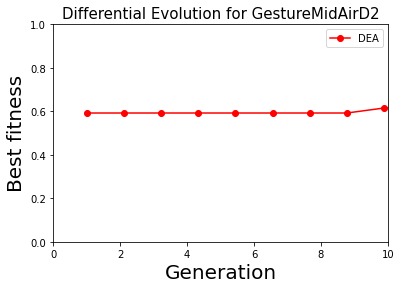

Currently dataset is GestureMidAirD3
(338, 1, 360)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/GestureMidAirD3_0_0.pkl
保存成功 ./generation/GestureMidAirD3_0_1.pkl
保存成功 ./generation/GestureMidAirD3_0_2.pkl
保存成功 ./generation/GestureMidAirD3_0_3.pkl
保存成功 ./generation/GestureMidAirD3_0_4.pkl
保存成功 ./generation/GestureMidAirD3_0_5.pkl
保存成功 ./generation/GestureMidAirD3_0_6.pkl
保存成功 ./generation/GestureMidAirD3_0_7.pkl
保存成功 ./generation/GestureMidAirD3_0_8.pkl
保存成功 ./generation/GestureMidAirD3_0_9.pkl
完成种群记录
第1个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05,

epoch,train_loss,valid_loss,accuracy,time
0,3.296165,3.266340,0.023077,00:00
1,3.289022,3.264028,0.023077,00:00
2,3.290763,3.261045,0.023077,00:00
3,3.285840,3.257055,0.030769,00:00
4,3.282345,3.251849,0.038462,00:00
5,3.274922,3.245156,0.046154,00:00
6,3.270853,3.236658,0.053846,00:00
7,3.264419,3.226160,0.053846,00:00
8,3.256839,3.213535,0.076923,00:00
9,3.251032,3.198493,0.100000,00:00


训练耗时:13
第2个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): SELU()
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias

epoch,train_loss,valid_loss,accuracy,time
0,3.267959,3.257293,0.046154,00:00
1,3.265413,3.255795,0.053846,00:00
2,3.261506,3.253227,0.053846,00:00
3,3.258603,3.248990,0.061538,00:00
4,3.254854,3.243975,0.061538,00:00
5,3.252597,3.236717,0.061538,00:00
6,3.249445,3.227368,0.061538,00:00
7,3.243264,3.216326,0.076923,00:00
8,3.239074,3.204048,0.069231,00:00
9,3.232070,3.188856,0.084615,00:00


训练耗时:14
第3个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.268457,3.269968,0.023077,00:00
1,3.262184,3.267444,0.030769,00:00
2,3.268979,3.264747,0.030769,00:00
3,3.267129,3.260863,0.015385,00:00
4,3.262392,3.255613,0.023077,00:00
5,3.256923,3.248945,0.023077,00:00
6,3.254679,3.240690,0.030769,00:00
7,3.250818,3.230482,0.053846,00:00
8,3.244472,3.217997,0.115385,00:00
9,3.238988,3.202734,0.138462,00:00


训练耗时:18
第4个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_l

epoch,train_loss,valid_loss,accuracy,time
0,3.290498,3.274297,0.046154,00:00
1,3.284613,3.271606,0.053846,00:00
2,3.281412,3.268693,0.053846,00:00
3,3.277055,3.264705,0.046154,00:00
4,3.275684,3.259747,0.046154,00:00
5,3.274702,3.252792,0.061538,00:00
6,3.271167,3.244017,0.076923,00:00
7,3.265624,3.233453,0.084615,00:00
8,3.258593,3.220577,0.084615,00:00
9,3.252563,3.205764,0.092308,00:00


训练耗时:15
第5个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,3.297426,3.268286,0.053846,00:00
1,3.288424,3.266016,0.061538,00:00
2,3.289381,3.263272,0.061538,00:00
3,3.285539,3.259508,0.046154,00:00
4,3.282735,3.254368,0.069231,00:00
5,3.280061,3.247234,0.092308,00:00
6,3.279116,3.237830,0.092308,00:00
7,3.273799,3.226618,0.130769,00:00
8,3.270718,3.213575,0.130769,00:00
9,3.264048,3.198228,0.138462,00:00


训练耗时:18
第6个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,3.295836,3.268321,0.030769,00:00
1,3.297160,3.266169,0.030769,00:00
2,3.283695,3.263403,0.030769,00:00
3,3.278720,3.259648,0.030769,00:00
4,3.274363,3.254782,0.023077,00:00
5,3.270375,3.248222,0.030769,00:00
6,3.266646,3.239678,0.038462,00:00
7,3.262553,3.229195,0.061538,00:00
8,3.255837,3.216265,0.084615,00:00
9,3.248385,3.200343,0.169231,00:00


训练耗时:15
第7个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): Linear(in_features=128, out_features=256, bias=True)
  (add_layer5): SELU()
  (add_layer6): ConvBlock(
    (0): Conv1d(256, 32, kernel_size=(3,), stride=(1,), padding=(1

epoch,train_loss,valid_loss,accuracy,time
0,3.282120,3.281079,0.023077,00:00
1,3.280363,3.277268,0.023077,00:00
2,3.281173,3.273519,0.030769,00:00
3,3.269464,3.269187,0.046154,00:00
4,3.262568,3.263637,0.038462,00:00
5,3.259020,3.256006,0.038462,00:00
6,3.254883,3.245524,0.053846,00:00
7,3.247677,3.232743,0.053846,00:00
8,3.241089,3.217225,0.053846,00:00
9,3.230605,3.199182,0.069231,00:00


训练耗时:14
第8个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): Linear(in_features=128, out_features=128, bias=True)
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 8, ker

epoch,train_loss,valid_loss,accuracy,time
0,3.279834,3.266189,0.030769,00:00
1,3.279387,3.263878,0.038462,00:00
2,3.277495,3.260914,0.038462,00:00
3,3.276093,3.257018,0.046154,00:00
4,3.273665,3.251675,0.046154,00:00
5,3.274135,3.244906,0.046154,00:00
6,3.266923,3.236318,0.053846,00:00
7,3.258592,3.225589,0.084615,00:00
8,3.251898,3.212634,0.100000,00:00
9,3.243124,3.197093,0.130769,00:00


训练耗时:14
第9个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer6): ELU(alpha=1.0)
  (

epoch,train_loss,valid_loss,accuracy,time
0,3.265039,3.245103,0.069231,00:00
1,3.256423,3.242621,0.076923,00:00
2,3.252979,3.239521,0.100000,00:00
3,3.253359,3.236475,0.107692,00:00
4,3.251480,3.231838,0.100000,00:00
5,3.252548,3.227862,0.100000,00:00
6,3.251507,3.221578,0.107692,00:00
7,3.247311,3.212971,0.100000,00:00
8,3.244606,3.202212,0.138462,00:00
9,3.237952,3.187981,0.130769,00:00


训练耗时:14
第10个个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.37120834744855796, inplace=False)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, 

epoch,train_loss,valid_loss,accuracy,time
0,3.268306,3.257396,0.046154,00:00
1,3.260056,3.255104,0.046154,00:00
2,3.257023,3.252235,0.046154,00:00
3,3.256427,3.248655,0.069231,00:00
4,3.251758,3.243428,0.092308,00:00
5,3.252719,3.236634,0.123077,00:00
6,3.247154,3.227672,0.138462,00:00
7,3.245712,3.217038,0.146154,00:00
8,3.243342,3.204085,0.146154,00:00
9,3.236861,3.190040,0.153846,00:00


训练耗时:14

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/GestureMidAirD3_1_0.pkl
保存成功./generation/GestureMidAirD3_1_1.pkl
保存成功./generation/GestureMidAirD3_1_2.pkl
保存成功./generation/GestureMidAirD3_1_3.pkl
保存成功./generation/GestureMidAirD3_1_4.pkl
保存成功./generation/GestureMidAirD3_1_5.pkl
保存成功./generation/GestureMidAirD3_1_6.pkl
保存成功./generation/GestureMidAirD3_1_7.pkl
保存成功./generation/GestureMidAirD3_1_8.pkl
保存成功./generation/GestureMidAirD3_1_9.pkl
完成种群记录
Parent_fitness: [[0.3923077 ]
 [0.38461539]
 [0.3923077 ]
 [0.38461539]
 [0.40769231]
 [0.31538463]
 [0.40769231]
 [0.36923078]
 [0.41538462]
 [0.17692308]]
第1个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (

epoch,train_loss,valid_loss,accuracy,time
0,3.286231,3.257460,0.038462,00:00
1,3.272771,3.255191,0.046154,00:00
2,3.261639,3.252339,0.053846,00:00
3,3.259524,3.248471,0.053846,00:00
4,3.260864,3.243507,0.061538,00:00
5,3.258117,3.237143,0.076923,00:00
6,3.254049,3.229246,0.092308,00:00
7,3.247705,3.219389,0.092308,00:00
8,3.242050,3.207602,0.115385,00:00
9,3.235676,3.193550,0.138462,00:00


训练耗时:14
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.291888,3.264070,0.046154,00:00
1,3.289811,3.261807,0.038462,00:00
2,3.283346,3.258838,0.038462,00:00
3,3.286357,3.254808,0.038462,00:00
4,3.278373,3.249722,0.038462,00:00
5,3.274594,3.243438,0.046154,00:00
6,3.271810,3.235268,0.053846,00:00
7,3.268521,3.225523,0.084615,00:00
8,3.259924,3.213884,0.092308,00:00
9,3.251033,3.199648,0.115385,00:00


训练耗时:17
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.276111,3.268508,0.046154,00:00
1,3.287413,3.266140,0.046154,00:00
2,3.278864,3.262743,0.069231,00:00
3,3.274518,3.258609,0.069231,00:00
4,3.276444,3.253006,0.069231,00:00
5,3.272243,3.245767,0.069231,00:00
6,3.266776,3.236756,0.069231,00:00
7,3.260681,3.225662,0.084615,00:00
8,3.255321,3.212811,0.130769,00:00
9,3.249983,3.197876,0.153846,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.267432,3.265198,0.053846,00:00
1,3.275501,3.263268,0.069231,00:00
2,3.270538,3.260759,0.076923,00:00
3,3.268073,3.257349,0.076923,00:00
4,3.264148,3.252618,0.084615,00:00
5,3.262199,3.246320,0.084615,00:00
6,3.259939,3.238561,0.092308,00:00
7,3.254877,3.228540,0.092308,00:00
8,3.249110,3.216376,0.092308,00:00
9,3.240376,3.201893,0.084615,00:00


训练耗时:16
Mutate better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): Linear(in_features=128, out_features=256, bias=True)
  (add_layer5): SELU()
  (add_layer6): Dropout(p=0.47527476190728385, inplace=False)
  (add_layer9):

epoch,train_loss,valid_loss,accuracy,time
0,3.277590,3.261209,0.053846,00:00
1,3.267956,3.257989,0.046154,00:00
2,3.259425,3.253580,0.069231,00:00
3,3.252585,3.246809,0.092308,00:00
4,3.247647,3.237554,0.092308,00:00
5,3.244353,3.225540,0.092308,00:00
6,3.240003,3.213122,0.100000,00:00
7,3.233711,3.198750,0.100000,00:00
8,3.227138,3.182960,0.138462,00:00
9,3.217455,3.164723,0.153846,00:00


训练耗时:14
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): Linear(in_features=128, out_features=128, bias=True)
  (add_layer5): ConvBlock(
    (0): Co

epoch,train_loss,valid_loss,accuracy,time
0,3.270860,3.251964,0.023077,00:00
1,3.269239,3.249698,0.023077,00:00
2,3.272491,3.246836,0.023077,00:00
3,3.272717,3.243126,0.053846,00:00
4,3.272579,3.238215,0.053846,00:00
5,3.264730,3.231850,0.053846,00:00
6,3.258903,3.223799,0.084615,00:00
7,3.254004,3.213885,0.084615,00:00
8,3.249082,3.201996,0.107692,00:00
9,3.241727,3.187752,0.146154,00:00


训练耗时:14
Mutate better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer6): Co

epoch,train_loss,valid_loss,accuracy,time
0,3.287458,3.255486,0.038462,00:00
1,3.286443,3.251046,0.046154,00:00
2,3.278314,3.248446,0.038462,00:00
3,3.274868,3.245409,0.030769,00:00
4,3.271179,3.240636,0.046154,00:00
5,3.266832,3.234759,0.046154,00:00
6,3.262243,3.226657,0.076923,00:00
7,3.257988,3.216698,0.100000,00:00
8,3.253051,3.205136,0.138462,00:00
9,3.247831,3.191017,0.153846,00:00


训练耗时:14
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.3923077 ]
 [0.38461539]
 [0.40000001]
 [0.38461539]
 [0.40769231]
 [0.36153847]
 [0.43846154]
 [0.38461539]
 [0.41538462]
 [0.17692308]]
Round Best:
0.4384615421295166
structure is [['Activate', 'elu'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Dense', 256], ['Activate', 'selu'], ['Dropout', 0.47527476190728385], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['conv', 32], ['Dropout', 0.07472233203733536], ['ZeroOp', 'Default'], ['conv', 64], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_s

epoch,train_loss,valid_loss,accuracy,time
0,3.275228,3.272275,0.015385,00:00
1,3.270569,3.270762,0.023077,00:00
2,3.273584,3.268896,0.030769,00:00
3,3.268385,3.266322,0.038462,00:00
4,3.266059,3.262663,0.038462,00:00
5,3.263667,3.257782,0.053846,00:00
6,3.259128,3.251409,0.061538,00:00
7,3.256141,3.243110,0.092308,00:00
8,3.249925,3.233151,0.100000,00:00
9,3.242134,3.222088,0.100000,00:00


训练耗时:13
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, mo

epoch,train_loss,valid_loss,accuracy,time
0,3.288352,3.269739,0.007692,00:00
1,3.282533,3.267347,0.000000,00:00
2,3.273432,3.264102,0.000000,00:00
3,3.275853,3.259621,0.007692,00:00
4,3.275185,3.254061,0.015385,00:00
5,3.268938,3.246529,0.015385,00:00
6,3.266468,3.236848,0.023077,00:00
7,3.263019,3.225251,0.046154,00:00
8,3.259009,3.211780,0.100000,00:00
9,3.251055,3.195728,0.130769,00:00


训练耗时:17
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,3.299693,3.260956,0.053846,00:00
1,3.284569,3.258953,0.038462,00:00
2,3.275070,3.255802,0.038462,00:00
3,3.273974,3.252029,0.038462,00:00
4,3.267617,3.246933,0.038462,00:00
5,3.264076,3.239925,0.038462,00:00
6,3.256252,3.231011,0.061538,00:00
7,3.248872,3.219880,0.092308,00:00
8,3.241796,3.206272,0.115385,00:00
9,3.237056,3.190819,0.153846,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): SELU()
  (add_layer6): Dropout

epoch,train_loss,valid_loss,accuracy,time
0,3.275652,3.265453,0.023077,00:00
1,3.274648,3.258915,0.023077,00:00
2,3.274323,3.253612,0.015385,00:00
3,3.270323,3.247184,0.015385,00:00
4,3.269187,3.240185,0.023077,00:00
5,3.261977,3.231941,0.023077,00:00
6,3.259130,3.222265,0.061538,00:00
7,3.255653,3.210455,0.069231,00:00
8,3.248787,3.196302,0.115385,00:00
9,3.242369,3.178586,0.146154,00:00


训练耗时:13
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): Linear(in_features=128, out_features=128, bias=True)
  (add_layer5): ConvBlock(
    (0): Co

epoch,train_loss,valid_loss,accuracy,time
0,3.270910,3.271231,0.053846,00:00
1,3.277989,3.268954,0.046154,00:00
2,3.273831,3.265923,0.046154,00:00
3,3.269060,3.261953,0.046154,00:00
4,3.265559,3.256830,0.053846,00:00
5,3.266428,3.250316,0.053846,00:00
6,3.261082,3.242098,0.069231,00:00
7,3.252974,3.231919,0.084615,00:00
8,3.245791,3.219647,0.115385,00:00
9,3.238993,3.205223,0.115385,00:00


训练耗时:14
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer6): EL

epoch,train_loss,valid_loss,accuracy,time
0,3.262545,3.261172,0.061538,00:00
1,3.256099,3.258127,0.053846,00:00
2,3.251393,3.255220,0.061538,00:00
3,3.251429,3.251141,0.076923,00:00
4,3.250997,3.245832,0.076923,00:00
5,3.249421,3.240658,0.053846,00:00
6,3.246060,3.232064,0.084615,00:00
7,3.243651,3.223758,0.100000,00:00
8,3.241235,3.212548,0.123077,00:00
9,3.234560,3.198600,0.130769,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.37120834744855796, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): Dropout(p=0.1119395035035815, 

epoch,train_loss,valid_loss,accuracy,time
0,3.283808,3.265932,0.038462,00:00
1,3.278078,3.263606,0.038462,00:00
2,3.276138,3.260349,0.030769,00:00
3,3.268496,3.255760,0.038462,00:00
4,3.270233,3.249889,0.046154,00:00
5,3.263021,3.242218,0.046154,00:00
6,3.259410,3.232726,0.084615,00:00
7,3.250447,3.221269,0.084615,00:00
8,3.246988,3.208167,0.138462,00:00
9,3.241001,3.192008,0.153846,00:00


训练耗时:13
Mutate better
Select完成
After selection [[0.3923077 ]
 [0.38461539]
 [0.40769231]
 [0.38461539]
 [0.40769231]
 [0.36153847]
 [0.43846154]
 [0.38461539]
 [0.41538462]
 [0.3923077 ]]
Round Best:
0.4384615421295166
structure is [['Activate', 'elu'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Dense', 256], ['Activate', 'selu'], ['Dropout', 0.47527476190728385], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['conv', 32], ['Dropout', 0.07472233203733536], ['ZeroOp', 'Default'], ['conv', 64], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2

epoch,train_loss,valid_loss,accuracy,time
0,3.243354,3.247301,0.046154,00:00
1,3.242771,3.244978,0.046154,00:00
2,3.242970,3.242001,0.053846,00:00
3,3.245909,3.237999,0.053846,00:00
4,3.245864,3.232645,0.053846,00:00
5,3.243821,3.225792,0.053846,00:00
6,3.243603,3.217409,0.084615,00:00
7,3.239476,3.207135,0.107692,00:00
8,3.232445,3.194829,0.107692,00:00
9,3.224014,3.180326,0.153846,00:00


训练耗时:13
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, mo

epoch,train_loss,valid_loss,accuracy,time
0,3.260523,3.253010,0.053846,00:00
1,3.265993,3.250141,0.061538,00:00
2,3.269331,3.246758,0.061538,00:00
3,3.265501,3.242625,0.084615,00:00
4,3.260758,3.237450,0.076923,00:00
5,3.254291,3.230286,0.076923,00:00
6,3.248658,3.221703,0.100000,00:00
7,3.245529,3.211048,0.100000,00:00
8,3.240364,3.198241,0.115385,00:00
9,3.233943,3.183236,0.123077,00:00


训练耗时:16
Mutate better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.306342,3.284147,0.046154,00:00
1,3.299856,3.282145,0.053846,00:00
2,3.296296,3.279372,0.053846,00:00
3,3.293708,3.275243,0.053846,00:00
4,3.288376,3.270097,0.053846,00:00
5,3.284447,3.262593,0.053846,00:00
6,3.281522,3.253394,0.053846,00:00
7,3.276461,3.242561,0.053846,00:00
8,3.270641,3.229820,0.084615,00:00
9,3.265053,3.214626,0.092308,00:00


训练耗时:15
Mutate better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.263129,3.258877,0.030769,00:00
1,3.262146,3.257848,0.046154,00:00
2,3.266769,3.255999,0.053846,00:00
3,3.268353,3.253052,0.061538,00:00
4,3.266014,3.248745,0.061538,00:00
5,3.264164,3.243354,0.061538,00:00
6,3.259058,3.236627,0.061538,00:00
7,3.255954,3.228715,0.092308,00:00
8,3.251553,3.219054,0.100000,00:00
9,3.245902,3.207014,0.138462,00:00


训练耗时:17
Mutate better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,3.288117,3.264612,0.015385,00:00
1,3.282285,3.262115,0.015385,00:00
2,3.278754,3.259108,0.015385,00:00
3,3.275609,3.254928,0.015385,00:00
4,3.270995,3.249114,0.023077,00:00
5,3.268186,3.241121,0.030769,00:00
6,3.262550,3.231343,0.046154,00:00
7,3.257509,3.219439,0.069231,00:00
8,3.250388,3.206662,0.107692,00:00
9,3.243190,3.190317,0.100000,00:00


训练耗时:15
Mutate better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,3.275242,3.269081,0.046154,00:00
1,3.281232,3.267239,0.038462,00:00
2,3.278604,3.264361,0.038462,00:00
3,3.274807,3.259124,0.038462,00:00
4,3.271492,3.252855,0.038462,00:00
5,3.264099,3.245393,0.038462,00:00
6,3.257109,3.235153,0.038462,00:00
7,3.249358,3.222658,0.046154,00:00
8,3.244743,3.207178,0.053846,00:00
9,3.235671,3.187847,0.092308,00:00


训练耗时:14
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Softmax(dim=None)
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=Fa

epoch,train_loss,valid_loss,accuracy,time
0,3.282179,3.265426,0.030769,00:00
1,3.286587,3.263018,0.038462,00:00
2,3.282783,3.259974,0.038462,00:00
3,3.276664,3.256027,0.038462,00:00
4,3.272105,3.250878,0.046154,00:00
5,3.267450,3.244402,0.053846,00:00
6,3.265918,3.236147,0.053846,00:00
7,3.265585,3.225910,0.092308,00:00
8,3.259968,3.213778,0.123077,00:00
9,3.254469,3.199341,0.161538,00:00


训练耗时:14
Mutate better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
 

epoch,train_loss,valid_loss,accuracy,time
0,3.252365,3.253426,0.038462,00:00
1,3.258208,3.250654,0.038462,00:00
2,3.256885,3.247640,0.038462,00:00
3,3.253663,3.244470,0.038462,00:00
4,3.254582,3.239172,0.046154,00:00
5,3.252143,3.232538,0.061538,00:00
6,3.248660,3.224884,0.084615,00:00
7,3.246312,3.215343,0.092308,00:00
8,3.241281,3.204179,0.123077,00:00
9,3.233744,3.189569,0.123077,00:00


训练耗时:15
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.37120834744855796, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): Dropout(p=0.1119395035035815, 

epoch,train_loss,valid_loss,accuracy,time
0,3.256617,3.263525,0.053846,00:00
1,3.261198,3.261100,0.061538,00:00
2,3.262014,3.257837,0.061538,00:00
3,3.259793,3.253344,0.069231,00:00
4,3.254593,3.247370,0.084615,00:00
5,3.254804,3.239532,0.092308,00:00
6,3.254089,3.229758,0.092308,00:00
7,3.248171,3.217753,0.100000,00:00
8,3.242542,3.203018,0.100000,00:00
9,3.234419,3.186060,0.115385,00:00


训练耗时:14
Parent Better
Select完成
After selection [[0.3923077 ]
 [0.38461539]
 [0.42307693]
 [0.3923077 ]
 [0.43076923]
 [0.42307693]
 [0.43846154]
 [0.40000001]
 [0.41538462]
 [0.3923077 ]]
Round Best:
0.4384615421295166
structure is [['Activate', 'elu'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Dense', 256], ['Activate', 'selu'], ['Dropout', 0.47527476190728385], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['conv', 32], ['Dropout', 0.07472233203733536], ['ZeroOp', 'Default'], ['conv', 64], ['ZeroOp', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2

epoch,train_loss,valid_loss,accuracy,time
0,3.257855,3.249204,0.069231,00:00
1,3.257895,3.246872,0.069231,00:00
2,3.261434,3.243779,0.069231,00:00
3,3.261277,3.239738,0.092308,00:00
4,3.259080,3.234486,0.100000,00:00
5,3.254230,3.227749,0.130769,00:00
6,3.251170,3.219379,0.146154,00:00
7,3.246208,3.209049,0.153846,00:00
8,3.240464,3.196618,0.169231,00:00
9,3.233065,3.181829,0.176923,00:00


训练耗时:15
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): SELU()
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), pa

epoch,train_loss,valid_loss,accuracy,time
0,3.269118,3.259331,0.061538,00:00
1,3.261371,3.257534,0.061538,00:00
2,3.258184,3.255210,0.053846,00:00
3,3.256404,3.251387,0.061538,00:00
4,3.253005,3.246248,0.076923,00:00
5,3.250089,3.239783,0.084615,00:00
6,3.248112,3.231016,0.123077,00:00
7,3.242367,3.220158,0.153846,00:00
8,3.236894,3.207280,0.146154,00:00
9,3.230020,3.192949,0.176923,00:00


训练耗时:14
Mutate better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, trac

epoch,train_loss,valid_loss,accuracy,time
0,3.270731,3.274713,0.030769,00:00
1,3.270214,3.272513,0.038462,00:00
2,3.275620,3.269490,0.046154,00:00
3,3.279051,3.266367,0.038462,00:00
4,3.279042,3.260517,0.038462,00:00
5,3.275555,3.253843,0.038462,00:00
6,3.271593,3.245878,0.038462,00:00
7,3.267298,3.235778,0.038462,00:00
8,3.260921,3.222582,0.046154,00:00
9,3.253415,3.206904,0.069231,00:00


训练耗时:15
Mutate better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.297356,3.261732,0.069231,00:00
1,3.281848,3.259183,0.061538,00:00
2,3.274395,3.256201,0.069231,00:00
3,3.267228,3.252361,0.061538,00:00
4,3.263839,3.247355,0.053846,00:00
5,3.261831,3.240684,0.061538,00:00
6,3.260451,3.232156,0.107692,00:00
7,3.257343,3.221474,0.123077,00:00
8,3.250097,3.209173,0.138462,00:00
9,3.243299,3.194263,0.161538,00:00


训练耗时:15
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.277324,3.266727,0.038462,00:00
1,3.271075,3.265087,0.023077,00:00
2,3.268528,3.262955,0.038462,00:00
3,3.268159,3.259810,0.053846,00:00
4,3.266662,3.255528,0.053846,00:00
5,3.263601,3.250179,0.053846,00:00
6,3.260330,3.243910,0.069231,00:00
7,3.255895,3.235450,0.076923,00:00
8,3.250261,3.224205,0.100000,00:00
9,3.245654,3.211622,0.123077,00:00


训练耗时:16
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, tra

epoch,train_loss,valid_loss,accuracy,time
0,3.291521,3.265383,0.023077,00:00
1,3.282965,3.263444,0.015385,00:00
2,3.276700,3.260727,0.023077,00:00
3,3.272204,3.256283,0.038462,00:00
4,3.265163,3.250476,0.030769,00:00
5,3.265548,3.243455,0.053846,00:00
6,3.263093,3.234344,0.061538,00:00
7,3.259182,3.222651,0.076923,00:00
8,3.255590,3.208916,0.107692,00:00
9,3.247853,3.194006,0.138462,00:00


训练耗时:15
Mutate better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,3.238168,3.251293,0.038462,00:00
1,3.240062,3.248468,0.053846,00:00
2,3.236602,3.244785,0.030769,00:00
3,3.233025,3.239916,0.030769,00:00
4,3.228353,3.233185,0.038462,00:00
5,3.221388,3.224117,0.053846,00:00
6,3.212892,3.213148,0.076923,00:00
7,3.207448,3.198961,0.076923,00:00
8,3.197962,3.182202,0.123077,00:00
9,3.190837,3.163275,0.176923,00:00


训练耗时:16
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Softmax(dim=None)
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=Fa

epoch,train_loss,valid_loss,accuracy,time
0,3.277559,3.253701,0.046154,00:00
1,3.268513,3.251667,0.046154,00:00
2,3.266127,3.248901,0.046154,00:00
3,3.268723,3.245257,0.053846,00:00
4,3.266090,3.240479,0.053846,00:00
5,3.267131,3.234273,0.053846,00:00
6,3.263860,3.226549,0.053846,00:00
7,3.258898,3.217070,0.061538,00:00
8,3.253889,3.205545,0.069231,00:00
9,3.247029,3.192322,0.107692,00:00


训练耗时:14
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer6): EL

epoch,train_loss,valid_loss,accuracy,time
0,3.271632,3.258916,0.015385,00:00
1,3.279226,3.256638,0.007692,00:00
2,3.274796,3.253495,0.007692,00:00
3,3.267059,3.249520,0.038462,00:00
4,3.266857,3.244020,0.046154,00:00
5,3.262504,3.236748,0.061538,00:00
6,3.257900,3.227993,0.061538,00:00
7,3.252625,3.217396,0.100000,00:00
8,3.249298,3.204191,0.130769,00:00
9,3.242446,3.188861,0.161538,00:00


训练耗时:14
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.37120834744855796, inplace=False)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128

epoch,train_loss,valid_loss,accuracy,time
0,3.274108,3.261063,0.053846,00:00
1,3.267979,3.258678,0.038462,00:00
2,3.266591,3.255400,0.038462,00:00
3,3.261896,3.251354,0.038462,00:00
4,3.261256,3.245781,0.038462,00:00
5,3.258524,3.238582,0.038462,00:00
6,3.255699,3.229588,0.053846,00:00
7,3.248432,3.218971,0.084615,00:00
8,3.243753,3.206111,0.123077,00:00
9,3.238086,3.190916,0.146154,00:00


训练耗时:16
Parent Better
Select完成
After selection [[0.40769231]
 [0.43846154]
 [0.43846154]
 [0.3923077 ]
 [0.43076923]
 [0.45384616]
 [0.43846154]
 [0.40000001]
 [0.43076923]
 [0.3923077 ]]
Round Best:
0.45384615659713745
structure is [['Activate', 'Relu'], ['conv', 128], ['ZeroOp', 'Default'], ['conv', 8], ['conv', 8], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Dropout', 0.05517811641034115], ['Dense', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Maxpooling', 'Default'], ['Dense', 32], ['Maxpooling', 'Default']]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(25

epoch,train_loss,valid_loss,accuracy,time
0,3.268470,3.248558,0.015385,00:00
1,3.263651,3.246046,0.015385,00:00
2,3.263118,3.242871,0.015385,00:00
3,3.267015,3.238746,0.023077,00:00
4,3.264820,3.233514,0.038462,00:00
5,3.262716,3.226709,0.061538,00:00
6,3.260017,3.218101,0.069231,00:00
7,3.256846,3.207677,0.084615,00:00
8,3.249331,3.195131,0.115385,00:00
9,3.242782,3.180477,0.146154,00:00


训练耗时:14
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,3.285120,3.273600,0.038462,00:00
1,3.283602,3.271729,0.038462,00:00
2,3.280008,3.269928,0.038462,00:00
3,3.275830,3.267056,0.038462,00:00
4,3.272055,3.262824,0.046154,00:00
5,3.268736,3.256822,0.061538,00:00
6,3.265935,3.249493,0.076923,00:00
7,3.262150,3.240557,0.092308,00:00
8,3.257217,3.229625,0.107692,00:00
9,3.251672,3.216175,0.115385,00:00


训练耗时:14
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, trac

epoch,train_loss,valid_loss,accuracy,time
0,3.274625,3.268684,0.030769,00:00
1,3.278065,3.266451,0.038462,00:00
2,3.279519,3.263710,0.046154,00:00
3,3.276225,3.259787,0.046154,00:00
4,3.272707,3.254496,0.046154,00:00
5,3.269191,3.248239,0.061538,00:00
6,3.264971,3.239717,0.084615,00:00
7,3.260026,3.228400,0.100000,00:00
8,3.253895,3.215277,0.100000,00:00
9,3.246426,3.199579,0.107692,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.243055,3.245953,0.130769,00:00
1,3.249496,3.243873,0.138462,00:00
2,3.248451,3.241312,0.138462,00:00
3,3.250418,3.237780,0.138462,00:00
4,3.248477,3.233134,0.138462,00:00
5,3.244443,3.227313,0.146154,00:00
6,3.244385,3.219821,0.146154,00:00
7,3.239629,3.210308,0.146154,00:00
8,3.233823,3.199165,0.153846,00:00
9,3.229723,3.185434,0.153846,00:00


训练耗时:15
Mutate better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Softmax(dim=None)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,3.263080,3.254661,0.069231,00:00
1,3.261622,3.252869,0.053846,00:00
2,3.264515,3.250833,0.053846,00:00
3,3.264600,3.247789,0.038462,00:00
4,3.260905,3.243788,0.046154,00:00
5,3.258416,3.238574,0.046154,00:00
6,3.253731,3.231817,0.069231,00:00
7,3.250560,3.223213,0.107692,00:00
8,3.244325,3.212773,0.115385,00:00
9,3.237539,3.200474,0.115385,00:00


训练耗时:15
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=T

epoch,train_loss,valid_loss,accuracy,time
0,3.265148,3.268905,0.015385,00:00
1,3.264808,3.265498,0.007692,00:00
2,3.250531,3.262265,0.015385,00:00
3,3.244422,3.257432,0.007692,00:00
4,3.240465,3.249184,0.015385,00:00
5,3.238307,3.239064,0.038462,00:00
6,3.230790,3.226191,0.038462,00:00
7,3.223560,3.208313,0.061538,00:00
8,3.217909,3.187376,0.092308,00:00
9,3.209575,3.168147,0.092308,00:00


训练耗时:15
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,3.270084,3.263925,0.053846,00:00
1,3.266670,3.261925,0.084615,00:00
2,3.270405,3.258819,0.092308,00:00
3,3.268399,3.255541,0.092308,00:00
4,3.264196,3.250203,0.100000,00:00
5,3.260462,3.243354,0.107692,00:00
6,3.255701,3.235204,0.107692,00:00
7,3.251604,3.225082,0.115385,00:00
8,3.245882,3.213081,0.107692,00:00
9,3.235330,3.196635,0.123077,00:00


训练耗时:15
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
   

epoch,train_loss,valid_loss,accuracy,time
0,3.269365,3.264089,0.030769,00:00
1,3.272600,3.261684,0.030769,00:00
2,3.276575,3.258554,0.030769,00:00
3,3.275444,3.254490,0.030769,00:00
4,3.274033,3.249156,0.030769,00:00
5,3.271877,3.242311,0.030769,00:00
6,3.265632,3.233795,0.053846,00:00
7,3.263283,3.223556,0.069231,00:00
8,3.260496,3.211204,0.092308,00:00
9,3.254421,3.196411,0.123077,00:00


训练耗时:16
Mutate better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): Si

epoch,train_loss,valid_loss,accuracy,time
0,3.262397,3.265213,0.038462,00:00
1,3.252353,3.262761,0.046154,00:00
2,3.248958,3.260183,0.046154,00:00
3,3.244179,3.257084,0.053846,00:00
4,3.240793,3.252954,0.053846,00:00
5,3.237096,3.247614,0.053846,00:00
6,3.232687,3.240438,0.069231,00:00
7,3.227273,3.230447,0.100000,00:00
8,3.218065,3.217257,0.115385,00:00
9,3.207362,3.201478,0.138462,00:00


训练耗时:14
Mutate better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): D

epoch,train_loss,valid_loss,accuracy,time
0,3.253873,3.243964,0.061538,00:00
1,3.256625,3.241430,0.061538,00:00
2,3.255227,3.238034,0.061538,00:00
3,3.249182,3.233484,0.069231,00:00
4,3.252146,3.227441,0.076923,00:00
5,3.249800,3.219446,0.084615,00:00
6,3.249364,3.209173,0.107692,00:00
7,3.244444,3.196074,0.107692,00:00
8,3.236792,3.180439,0.123077,00:00
9,3.228331,3.162288,0.153846,00:00


训练耗时:14
Mutate better
Select完成
After selection [[0.40769231]
 [0.43846154]
 [0.43846154]
 [0.40769231]
 [0.43076923]
 [0.45384616]
 [0.44615385]
 [0.41538462]
 [0.53076923]
 [0.40000001]]
Round Best:
0.5307692289352417
structure is [['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid'], ['Dense', 32], ['conv', 128], ['Dense', 128], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['conv', 32], ['Dense', 256]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): 

epoch,train_loss,valid_loss,accuracy,time
0,3.299058,3.271950,0.023077,00:00
1,3.290345,3.269550,0.023077,00:00
2,3.289601,3.266548,0.023077,00:00
3,3.288733,3.262554,0.023077,00:00
4,3.285536,3.257148,0.038462,00:00
5,3.283078,3.250134,0.038462,00:00
6,3.282157,3.241275,0.053846,00:00
7,3.279697,3.230482,0.061538,00:00
8,3.272769,3.217589,0.092308,00:00
9,3.266755,3.202717,0.130769,00:00


训练耗时:14
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): SELU()
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05,

epoch,train_loss,valid_loss,accuracy,time
0,3.267528,3.269976,0.053846,00:00
1,3.266732,3.268117,0.069231,00:00
2,3.264552,3.265133,0.061538,00:00
3,3.261316,3.260963,0.061538,00:00
4,3.260584,3.255074,0.061538,00:00
5,3.255070,3.247751,0.061538,00:00
6,3.249163,3.238827,0.061538,00:00
7,3.242987,3.229357,0.092308,00:00
8,3.235768,3.217262,0.123077,00:00
9,3.227647,3.202822,0.169231,00:00


训练耗时:14
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, trac

epoch,train_loss,valid_loss,accuracy,time
0,3.262215,3.263359,0.030769,00:00
1,3.266464,3.261036,0.030769,00:00
2,3.268456,3.257899,0.030769,00:00
3,3.270117,3.253807,0.038462,00:00
4,3.266813,3.248584,0.030769,00:00
5,3.263967,3.242304,0.030769,00:00
6,3.256341,3.233861,0.038462,00:00
7,3.251637,3.223427,0.069231,00:00
8,3.245343,3.210411,0.092308,00:00
9,3.238452,3.194413,0.115385,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.282545,3.262215,0.030769,00:00
1,3.275231,3.260034,0.038462,00:00
2,3.267244,3.256978,0.038462,00:00
3,3.267977,3.253142,0.038462,00:00
4,3.262306,3.248558,0.038462,00:00
5,3.262030,3.241689,0.061538,00:00
6,3.258112,3.233422,0.092308,00:00
7,3.255874,3.224190,0.115385,00:00
8,3.252947,3.212737,0.115385,00:00
9,3.242966,3.200839,0.115385,00:00


训练耗时:15
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.275910,3.258365,0.023077,00:00
1,3.277306,3.256692,0.023077,00:00
2,3.274297,3.253930,0.023077,00:00
3,3.271263,3.249949,0.023077,00:00
4,3.271608,3.244740,0.030769,00:00
5,3.267216,3.238108,0.046154,00:00
6,3.263860,3.229569,0.069231,00:00
7,3.255697,3.218893,0.092308,00:00
8,3.249478,3.206565,0.130769,00:00
9,3.242117,3.191890,0.153846,00:00


训练耗时:17
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, tra

epoch,train_loss,valid_loss,accuracy,time
0,3.260219,3.268921,0.061538,00:00
1,3.277501,3.266637,0.061538,00:00
2,3.278304,3.263829,0.061538,00:00
3,3.276710,3.259877,0.061538,00:00
4,3.273883,3.254270,0.061538,00:00
5,3.269914,3.247698,0.061538,00:00
6,3.267343,3.238495,0.061538,00:00
7,3.261964,3.226934,0.061538,00:00
8,3.258131,3.214141,0.069231,00:00
9,3.249368,3.199291,0.146154,00:00


训练耗时:16
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,3.278178,3.253372,0.061538,00:00
1,3.279357,3.251008,0.084615,00:00
2,3.270826,3.248144,0.084615,00:00
3,3.268296,3.243953,0.084615,00:00
4,3.259871,3.237491,0.084615,00:00
5,3.258400,3.228390,0.076923,00:00
6,3.254032,3.217358,0.092308,00:00
7,3.248548,3.205978,0.107692,00:00
8,3.240829,3.190614,0.115385,00:00
9,3.231289,3.173873,0.146154,00:00


训练耗时:14
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.269121,3.263208,0.015385,00:00
1,3.273604,3.261078,0.015385,00:00
2,3.269151,3.258557,0.015385,00:00
3,3.268722,3.254557,0.015385,00:00
4,3.265906,3.249440,0.023077,00:00
5,3.261048,3.242976,0.061538,00:00
6,3.256753,3.234500,0.092308,00:00
7,3.252044,3.223830,0.130769,00:00
8,3.248510,3.210969,0.176923,00:00
9,3.244622,3.195874,0.176923,00:00


训练耗时:16
Mutate better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): Si

epoch,train_loss,valid_loss,accuracy,time
0,3.269271,3.269532,0.038462,00:00
1,3.268104,3.263944,0.038462,00:00
2,3.262324,3.259232,0.038462,00:00
3,3.254224,3.254338,0.038462,00:00
4,3.253561,3.248757,0.030769,00:00
5,3.247504,3.242231,0.000000,00:00
6,3.244711,3.235018,0.000000,00:00
7,3.239560,3.226079,0.030769,00:00
8,3.234652,3.215061,0.046154,00:00
9,3.227556,3.202446,0.092308,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.3454419197476422, inplace=False)
  (add_layer4): SELU()
  (add_layer5): MaxPool1

epoch,train_loss,valid_loss,accuracy,time
0,3.246186,3.235752,0.046154,00:00
1,3.254722,3.233526,0.046154,00:00
2,3.253837,3.230581,0.053846,00:00
3,3.252041,3.226688,0.076923,00:00
4,3.248967,3.221579,0.076923,00:00
5,3.248580,3.214901,0.100000,00:00
6,3.240092,3.206443,0.123077,00:00
7,3.235404,3.196191,0.130769,00:00
8,3.228753,3.183662,0.153846,00:00
9,3.220563,3.168658,0.161538,00:00


训练耗时:15
Mutate better
Select完成
After selection [[0.40769231]
 [0.43846154]
 [0.43846154]
 [0.40769231]
 [0.43076923]
 [0.45384616]
 [0.44615385]
 [0.43846154]
 [0.53076923]
 [0.43076923]]
Round Best:
0.5307692289352417
structure is [['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid'], ['Dense', 32], ['conv', 128], ['Dense', 128], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['conv', 32], ['Dense', 256]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): 

epoch,train_loss,valid_loss,accuracy,time
0,3.288589,3.270684,0.015385,00:00
1,3.281578,3.268941,0.015385,00:00
2,3.280819,3.266690,0.015385,00:00
3,3.276686,3.263772,0.015385,00:00
4,3.270633,3.259885,0.023077,00:00
5,3.268323,3.254699,0.023077,00:00
6,3.266932,3.248094,0.030769,00:00
7,3.262908,3.239933,0.046154,00:00
8,3.261200,3.230164,0.069231,00:00
9,3.257740,3.218512,0.115385,00:00


训练耗时:16
Parent Better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer4): SELU()
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentu

epoch,train_loss,valid_loss,accuracy,time
0,3.268492,3.262097,0.038462,00:00
1,3.271557,3.260345,0.030769,00:00
2,3.268223,3.257893,0.030769,00:00
3,3.265985,3.255306,0.038462,00:00
4,3.261532,3.250881,0.038462,00:00
5,3.258196,3.243439,0.053846,00:00
6,3.252927,3.231856,0.053846,00:00
7,3.248811,3.220173,0.053846,00:00
8,3.241079,3.208465,0.053846,00:00
9,3.233559,3.194664,0.053846,00:00


训练耗时:14
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, trac

epoch,train_loss,valid_loss,accuracy,time
0,3.270147,3.275171,0.015385,00:00
1,3.276994,3.272667,0.015385,00:00
2,3.271855,3.269730,0.023077,00:00
3,3.275421,3.265506,0.023077,00:00
4,3.276065,3.259581,0.030769,00:00
5,3.272125,3.253704,0.030769,00:00
6,3.269863,3.244727,0.038462,00:00
7,3.263037,3.232261,0.061538,00:00
8,3.256383,3.219229,0.100000,00:00
9,3.249449,3.202403,0.130769,00:00


训练耗时:15
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=128, bias=True)
  (add_layer2): Dropout(p=0.1568847750664935, inplace=False)
  (add_layer4): ELU(alpha=1.0)
  (add_layer5): ConvBlock(
    (0): Con

epoch,train_loss,valid_loss,accuracy,time
0,3.278821,3.269429,0.038462,00:00
1,3.276286,3.266882,0.046154,00:00
2,3.276499,3.264176,0.046154,00:00
3,3.276490,3.259635,0.053846,00:00
4,3.273508,3.254349,0.061538,00:00
5,3.267819,3.247001,0.061538,00:00
6,3.264923,3.237397,0.061538,00:00
7,3.261642,3.226361,0.061538,00:00
8,3.256352,3.213104,0.092308,00:00
9,3.251905,3.197360,0.138462,00:00


训练耗时:14
Parent Better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.273009,3.262520,0.061538,00:00
1,3.270683,3.260624,0.061538,00:00
2,3.270245,3.258193,0.061538,00:00
3,3.269194,3.254832,0.061538,00:00
4,3.262876,3.250059,0.076923,00:00
5,3.257909,3.243621,0.076923,00:00
6,3.257229,3.235865,0.076923,00:00
7,3.254616,3.226454,0.076923,00:00
8,3.251780,3.214436,0.084615,00:00
9,3.242986,3.200583,0.092308,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1

epoch,train_loss,valid_loss,accuracy,time
0,3.279848,3.278538,0.007692,00:00
1,3.274808,3.276557,0.007692,00:00
2,3.268193,3.273721,0.007692,00:00
3,3.271685,3.269694,0.007692,00:00
4,3.271725,3.264472,0.023077,00:00
5,3.268390,3.257771,0.030769,00:00
6,3.263819,3.248941,0.038462,00:00
7,3.259388,3.238115,0.046154,00:00
8,3.254680,3.224918,0.107692,00:00
9,3.248408,3.210050,0.138462,00:00


训练耗时:15
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.300446,3.274956,0.000000,00:00
1,3.289726,3.272614,0.000000,00:00
2,3.290069,3.269487,0.007692,00:00
3,3.289557,3.265722,0.023077,00:00
4,3.282778,3.260664,0.030769,00:00
5,3.285682,3.253432,0.038462,00:00
6,3.275769,3.243083,0.053846,00:00
7,3.272534,3.231192,0.076923,00:00
8,3.268840,3.217361,0.076923,00:00
9,3.263807,3.201853,0.115385,00:00


训练耗时:16
Parent Better
第9个变异个体
子代个体基因型受限
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.3454419197476422, inplace=False)
  (add_layer4):

epoch,train_loss,valid_loss,accuracy,time
0,3.283192,3.274049,0.030769,00:00
1,3.276633,3.271448,0.038462,00:00
2,3.277282,3.268197,0.038462,00:00
3,3.267609,3.263834,0.046154,00:00
4,3.265237,3.258057,0.053846,00:00
5,3.261788,3.250756,0.053846,00:00
6,3.261889,3.241543,0.084615,00:00
7,3.257003,3.230561,0.123077,00:00
8,3.253903,3.217201,0.146154,00:00
9,3.245405,3.201808,0.169231,00:00


训练耗时:14
Parent Better
Select完成
After selection [[0.40769231]
 [0.43846154]
 [0.43846154]
 [0.40769231]
 [0.43076923]
 [0.45384616]
 [0.44615385]
 [0.43846154]
 [0.53076923]
 [0.43076923]]
Round Best:
0.5307692289352417
structure is [['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid'], ['Dense', 32], ['conv', 128], ['Dense', 128], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['conv', 32], ['Dense', 256]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): 

epoch,train_loss,valid_loss,accuracy,time
0,3.245984,3.261936,0.023077,00:00
1,3.250555,3.259964,0.007692,00:00
2,3.251889,3.257715,0.023077,00:00
3,3.254534,3.255181,0.046154,00:00
4,3.251775,3.250875,0.046154,00:00
5,3.250558,3.245735,0.046154,00:00
6,3.248962,3.238184,0.046154,00:00
7,3.246175,3.228815,0.053846,00:00
8,3.241182,3.216186,0.046154,00:00
9,3.235122,3.200981,0.046154,00:00


训练耗时:15
Mutate better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, trac

epoch,train_loss,valid_loss,accuracy,time
0,3.302592,3.269218,0.053846,00:00
1,3.296252,3.267038,0.053846,00:00
2,3.283293,3.263827,0.053846,00:00
3,3.278263,3.259824,0.053846,00:00
4,3.272144,3.254374,0.061538,00:00
5,3.267612,3.247343,0.069231,00:00
6,3.263841,3.238437,0.100000,00:00
7,3.257827,3.227425,0.115385,00:00
8,3.249642,3.214399,0.153846,00:00
9,3.245522,3.198648,0.200000,00:00


训练耗时:16
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,3.260211,3.260482,0.038462,00:00
1,3.260807,3.257849,0.038462,00:00
2,3.264083,3.254641,0.038462,00:00
3,3.263265,3.250150,0.046154,00:00
4,3.263691,3.244506,0.046154,00:00
5,3.258378,3.237025,0.046154,00:00
6,3.254969,3.227789,0.053846,00:00
7,3.250813,3.216455,0.084615,00:00
8,3.244967,3.203027,0.115385,00:00
9,3.237962,3.187480,0.146154,00:00


训练耗时:16
Mutate better
第5个变异个体
子代个体基因型受限
Parent Better
第6个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05

epoch,train_loss,valid_loss,accuracy,time
0,3.259942,3.259127,0.030769,00:00
1,3.255961,3.257071,0.030769,00:00
2,3.252588,3.254183,0.030769,00:00
3,3.247157,3.250525,0.038462,00:00
4,3.245124,3.244992,0.038462,00:00
5,3.242232,3.235465,0.053846,00:00
6,3.235052,3.224804,0.107692,00:00
7,3.231649,3.212032,0.123077,00:00
8,3.221727,3.195310,0.169231,00:00
9,3.215706,3.175548,0.184615,00:00


训练耗时:17
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=T

epoch,train_loss,valid_loss,accuracy,time
0,3.238786,3.235596,0.084615,00:00
1,3.240741,3.233945,0.084615,00:00
2,3.236199,3.230440,0.076923,00:00
3,3.233888,3.225487,0.100000,00:00
4,3.231394,3.218651,0.084615,00:00
5,3.227256,3.209347,0.100000,00:00
6,3.218879,3.197195,0.115385,00:00
7,3.211374,3.183355,0.130769,00:00
8,3.205729,3.158986,0.138462,00:00
9,3.197184,3.137037,0.130769,00:00


训练耗时:16
Mutate better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): Dropout(p=0.14724611053261416, inplace=False)
  (add_layer3): Linear(in_features=128, out_features=16, bias=True)
  (add_layer4): ConvBlock(
    (0): Conv1d(1

epoch,train_loss,valid_loss,accuracy,time
0,3.269957,3.263166,0.030769,00:00
1,3.273476,3.261177,0.030769,00:00
2,3.275812,3.258275,0.030769,00:00
3,3.267462,3.254509,0.038462,00:00
4,3.262021,3.249689,0.038462,00:00
5,3.260325,3.243340,0.038462,00:00
6,3.254631,3.235173,0.038462,00:00
7,3.249707,3.225090,0.100000,00:00
8,3.245097,3.212613,0.115385,00:00
9,3.237076,3.196627,0.161538,00:00


训练耗时:18
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Softmax(dim=None)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stri

epoch,train_loss,valid_loss,accuracy,time
0,3.271538,3.267516,0.038462,00:00
1,3.271677,3.263326,0.038462,00:00
2,3.271535,3.260346,0.038462,00:00
3,3.267430,3.258495,0.038462,00:00
4,3.266322,3.253242,0.030769,00:00
5,3.262508,3.247882,0.030769,00:00
6,3.261847,3.241427,0.053846,00:00
7,3.259164,3.234278,0.053846,00:00
8,3.254653,3.225693,0.061538,00:00
9,3.250431,3.215063,0.100000,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Dropout(p=0.3981837322800887, inplace=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128,

epoch,train_loss,valid_loss,accuracy,time
0,3.274418,3.244449,0.061538,00:00
1,3.263707,3.242254,0.069231,00:00
2,3.255184,3.239254,0.084615,00:00
3,3.254262,3.235302,0.084615,00:00
4,3.253253,3.230125,0.084615,00:00
5,3.251642,3.223295,0.092308,00:00
6,3.248926,3.214772,0.100000,00:00
7,3.241182,3.203973,0.115385,00:00
8,3.233745,3.191153,0.123077,00:00
9,3.225966,3.175905,0.138462,00:00


训练耗时:14
Parent Better
Select完成
After selection [[0.40769231]
 [0.46153846]
 [0.43846154]
 [0.41538462]
 [0.43076923]
 [0.45384616]
 [0.46923077]
 [0.43846154]
 [0.53076923]
 [0.43076923]]
Round Best:
0.5307692289352417
structure is [['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid'], ['Dense', 32], ['conv', 128], ['Dense', 128], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['conv', 32], ['Dense', 256]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): 

epoch,train_loss,valid_loss,accuracy,time
0,3.256383,3.250451,0.038462,00:00
1,3.255187,3.248621,0.061538,00:00
2,3.254291,3.247024,0.038462,00:00
3,3.249900,3.244021,0.046154,00:00
4,3.245842,3.239129,0.053846,00:00
5,3.242135,3.232542,0.084615,00:00
6,3.238581,3.223129,0.107692,00:00
7,3.232869,3.210537,0.138462,00:00
8,3.227815,3.192316,0.176923,00:00
9,3.219038,3.173502,0.215385,00:00


训练耗时:16
Mutate better
第2个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,3.265993,3.258879,0.015385,00:00
1,3.266056,3.254506,0.038462,00:00
2,3.264793,3.251641,0.030769,00:00
3,3.259724,3.248068,0.030769,00:00
4,3.258282,3.243382,0.038462,00:00
5,3.254858,3.237949,0.046154,00:00
6,3.250374,3.229880,0.076923,00:00
7,3.244774,3.219971,0.092308,00:00
8,3.239746,3.207918,0.161538,00:00
9,3.233376,3.192666,0.153846,00:00


训练耗时:16
Mutate better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), p

epoch,train_loss,valid_loss,accuracy,time
0,3.255648,3.254178,0.030769,00:00
1,3.260011,3.253103,0.030769,00:00
2,3.257852,3.251203,0.053846,00:00
3,3.253610,3.248232,0.038462,00:00
4,3.253909,3.243547,0.046154,00:00
5,3.251132,3.238062,0.061538,00:00
6,3.247584,3.230718,0.069231,00:00
7,3.243768,3.221596,0.076923,00:00
8,3.240372,3.209635,0.100000,00:00
9,3.235155,3.197101,0.107692,00:00


训练耗时:15
Mutate better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,),

epoch,train_loss,valid_loss,accuracy,time
0,3.279371,3.251467,0.030769,00:00
1,3.269042,3.249260,0.030769,00:00
2,3.270285,3.246336,0.038462,00:00
3,3.264825,3.242481,0.053846,00:00
4,3.261995,3.237444,0.076923,00:00
5,3.258415,3.230828,0.092308,00:00
6,3.254055,3.222416,0.115385,00:00
7,3.247971,3.212041,0.138462,00:00
8,3.244556,3.199484,0.184615,00:00
9,3.237308,3.184696,0.200000,00:00


训练耗时:17
Mutate better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True,

epoch,train_loss,valid_loss,accuracy,time
0,3.273105,3.270468,0.038462,00:00
1,3.272848,3.268807,0.030769,00:00
2,3.272430,3.266823,0.030769,00:00
3,3.269721,3.263773,0.030769,00:00
4,3.265736,3.259848,0.030769,00:00
5,3.262597,3.254535,0.038462,00:00
6,3.261395,3.247811,0.038462,00:00
7,3.258351,3.239983,0.046154,00:00
8,3.252773,3.229424,0.069231,00:00
9,3.246809,3.218690,0.092308,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, e

epoch,train_loss,valid_loss,accuracy,time
0,3.293292,3.272073,0.030769,00:00
1,3.287713,3.269516,0.030769,00:00
2,3.281420,3.266192,0.030769,00:00
3,3.282478,3.261729,0.030769,00:00
4,3.275845,3.255781,0.053846,00:00
5,3.271705,3.247695,0.053846,00:00
6,3.269238,3.238523,0.053846,00:00
7,3.263601,3.226348,0.084615,00:00
8,3.257933,3.211162,0.100000,00:00
9,3.248627,3.193321,0.123077,00:00


训练耗时:17
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)


epoch,train_loss,valid_loss,accuracy,time
0,3.259902,3.252996,0.092308,00:00
1,3.252497,3.251080,0.092308,00:00
2,3.249164,3.248446,0.100000,00:00
3,3.244618,3.244838,0.100000,00:00
4,3.241423,3.239780,0.100000,00:00
5,3.238867,3.233008,0.092308,00:00
6,3.234482,3.223942,0.092308,00:00
7,3.229285,3.213245,0.115385,00:00
8,3.222781,3.201389,0.146154,00:00
9,3.213513,3.188728,0.184615,00:00


训练耗时:16
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)

epoch,train_loss,valid_loss,accuracy,time
0,3.283219,3.262572,0.030769,00:00
1,3.274517,3.260430,0.046154,00:00
2,3.273348,3.258083,0.053846,00:00
3,3.267582,3.255445,0.061538,00:00
4,3.265795,3.251763,0.061538,00:00
5,3.260440,3.245721,0.061538,00:00
6,3.256588,3.238516,0.053846,00:00
7,3.252578,3.229824,0.076923,00:00
8,3.246039,3.217419,0.076923,00:00
9,3.238256,3.203537,0.076923,00:00


训练耗时:16
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.46923077]
 [0.46923077]
 [0.44615385]
 [0.42307693]
 [0.43076923]
 [0.45384616]
 [0.46923077]
 [0.43846154]
 [0.53076923]
 [0.43076923]]
Round Best:
0.5307692289352417
structure is [['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid'], ['Dense', 32], ['conv', 128], ['Dense', 128], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['conv', 32], ['Dense', 256]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), pa

epoch,train_loss,valid_loss,accuracy,time
0,3.260343,3.256114,0.046154,00:00
1,3.258116,3.254346,0.046154,00:00
2,3.262888,3.251846,0.053846,00:00
3,3.259503,3.248797,0.061538,00:00
4,3.257849,3.244042,0.053846,00:00
5,3.255116,3.238372,0.053846,00:00
6,3.252544,3.230021,0.053846,00:00
7,3.249125,3.219158,0.069231,00:00
8,3.239818,3.205218,0.084615,00:00
9,3.233068,3.189241,0.138462,00:00


训练耗时:15
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): SELU()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 16, ke

epoch,train_loss,valid_loss,accuracy,time
0,3.261399,3.256022,0.038462,00:00
1,3.255001,3.252774,0.038462,00:00
2,3.248594,3.249553,0.038462,00:00
3,3.246210,3.245646,0.053846,00:00
4,3.250313,3.240894,0.046154,00:00
5,3.247071,3.233848,0.053846,00:00
6,3.245016,3.225173,0.092308,00:00
7,3.241072,3.214563,0.107692,00:00
8,3.236395,3.201971,0.138462,00:00
9,3.230096,3.187834,0.146154,00:00


训练耗时:14
Parent Better
第4个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), 

epoch,train_loss,valid_loss,accuracy,time
0,3.296761,3.261598,0.053846,00:00
1,3.278658,3.259191,0.053846,00:00
2,3.273987,3.255933,0.061538,00:00
3,3.269542,3.251808,0.061538,00:00
4,3.272237,3.246263,0.061538,00:00
5,3.267239,3.239024,0.069231,00:00
6,3.266531,3.230225,0.076923,00:00
7,3.260984,3.218338,0.107692,00:00
8,3.253342,3.203804,0.153846,00:00
9,3.245544,3.185127,0.184615,00:00


训练耗时:17
Mutate better
第5个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,3.269369,3.260772,0.046154,00:00
1,3.265012,3.259481,0.046154,00:00
2,3.260356,3.257604,0.046154,00:00
3,3.261681,3.254479,0.053846,00:00
4,3.259356,3.251328,0.053846,00:00
5,3.254042,3.246506,0.053846,00:00
6,3.251140,3.236672,0.046154,00:00
7,3.245985,3.226662,0.092308,00:00
8,3.240787,3.212831,0.130769,00:00
9,3.233626,3.197713,0.107692,00:00


训练耗时:17
Parent Better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ELU(alpha=1.0)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(256, e

epoch,train_loss,valid_loss,accuracy,time
0,3.263237,3.255621,0.069231,00:00
1,3.260551,3.253413,0.053846,00:00
2,3.257896,3.250112,0.053846,00:00
3,3.262737,3.246246,0.084615,00:00
4,3.258849,3.240597,0.084615,00:00
5,3.255733,3.233965,0.107692,00:00
6,3.251385,3.224532,0.138462,00:00
7,3.245606,3.213123,0.146154,00:00
8,3.235590,3.198776,0.161538,00:00
9,3.228650,3.180784,0.200000,00:00


训练耗时:15
Parent Better
第8个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Sigmoid()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, tr

epoch,train_loss,valid_loss,accuracy,time
0,3.280185,3.269001,0.053846,00:00
1,3.279269,3.266441,0.046154,00:00
2,3.271807,3.262916,0.046154,00:00
3,3.266890,3.258577,0.046154,00:00
4,3.262746,3.252947,0.053846,00:00
5,3.259978,3.245825,0.053846,00:00
6,3.255018,3.236826,0.061538,00:00
7,3.247725,3.224832,0.076923,00:00
8,3.243886,3.209931,0.107692,00:00
9,3.233053,3.189518,0.123077,00:00


训练耗时:18
Parent Better
第9个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer8): Si

epoch,train_loss,valid_loss,accuracy,time
0,3.278079,3.264752,0.046154,00:00
1,3.278603,3.262707,0.046154,00:00
2,3.274879,3.260661,0.053846,00:00
3,3.271330,3.257920,0.069231,00:00
4,3.270538,3.254703,0.061538,00:00
5,3.268444,3.250399,0.069231,00:00
6,3.266335,3.245263,0.076923,00:00
7,3.263116,3.238832,0.038462,00:00
8,3.258037,3.234742,0.038462,00:00
9,3.252298,3.239191,0.038462,00:00


训练耗时:14
Parent Better
第10个变异个体
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Dropout(p=0.20927694128313512, inplace=False)
  (add_layer2): Dropout(p=0.3454419197476422, inplace=False)
  (add_layer4): SELU()
  (add_layer5): ConvBlock(
    (0): Conv1d(128, 32, k

epoch,train_loss,valid_loss,accuracy,time
0,3.275478,3.257426,0.015385,00:00
1,3.273597,3.254274,0.015385,00:00
2,3.265956,3.250633,0.015385,00:00
3,3.269364,3.245937,0.023077,00:00
4,3.270781,3.239889,0.038462,00:00
5,3.264110,3.232283,0.061538,00:00
6,3.260614,3.222572,0.084615,00:00
7,3.253800,3.210083,0.100000,00:00
8,3.249146,3.194652,0.115385,00:00
9,3.241974,3.176085,0.123077,00:00


训练耗时:15
Parent Better
Select完成
After selection [[0.46923077]
 [0.46923077]
 [0.44615385]
 [0.43076923]
 [0.43076923]
 [0.45384616]
 [0.46923077]
 [0.43846154]
 [0.53076923]
 [0.43076923]]
Round Best:
0.5307692289352417
structure is [['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['Maxpooling', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['ZeroOp', 'Default'], ['Activate', 'sigmoid'], ['Dense', 32], ['conv', 128], ['Dense', 128], ['Activate', 'sigmoid'], ['ZeroOp', 'Default'], ['conv', 32], ['Dense', 256]]
360
NewModel
NewModel(
  (rnn): LSTM(360, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): 

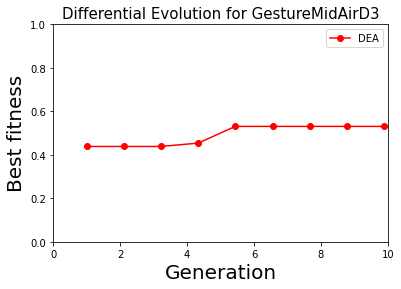

Currently dataset is GesturePebbleZ1
(304, 1, 455)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/GesturePebbleZ1_0_0.pkl
保存成功 ./generation/GesturePebbleZ1_0_1.pkl
保存成功 ./generation/GesturePebbleZ1_0_2.pkl
保存成功 ./generation/GesturePebbleZ1_0_3.pkl
保存成功 ./generation/GesturePebbleZ1_0_4.pkl
保存成功 ./generation/GesturePebbleZ1_0_5.pkl
保存成功 ./generation/GesturePebbleZ1_0_6.pkl
保存成功 ./generation/GesturePebbleZ1_0_7.pkl
保存成功 ./generation/GesturePebbleZ1_0_8.pkl
保存成功 ./generation/GesturePebbleZ1_0_9.pkl
完成种群记录
第1个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.808003,1.807536,0.151163,00:00
1,1.806037,1.807451,0.145349,00:00
2,1.806329,1.807307,0.151163,00:00
3,1.802106,1.807068,0.156977,00:00
4,1.803498,1.806771,0.151163,00:00
5,1.803563,1.806436,0.156977,00:00
6,1.799322,1.805963,0.162791,00:00
7,1.793079,1.805370,0.162791,00:00
8,1.788724,1.804597,0.168605,00:00
9,1.783740,1.803778,0.162791,00:00


训练耗时:13
第2个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer4): MaxPool1d(kernel_size=3, stride=1, paddin

epoch,train_loss,valid_loss,accuracy,time
0,1.827374,1.815389,0.151163,00:00
1,1.824687,1.816907,0.122093,00:00
2,1.815834,1.817393,0.110465,00:00
3,1.810886,1.817704,0.122093,00:00
4,1.811914,1.818387,0.110465,00:00
5,1.809184,1.819093,0.127907,00:00
6,1.806840,1.819861,0.127907,00:00
7,1.804092,1.820820,0.122093,00:00
8,1.800586,1.822284,0.127907,00:00
9,1.795547,1.824101,0.127907,00:00


训练耗时:11
第3个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,1.803827,1.799723,0.127907,00:00
1,1.810768,1.800066,0.127907,00:00
2,1.809143,1.800104,0.122093,00:00
3,1.805573,1.799917,0.122093,00:00
4,1.799186,1.799486,0.127907,00:00
5,1.801269,1.798754,0.133721,00:00
6,1.796442,1.797518,0.139535,00:00
7,1.791259,1.795786,0.139535,00:00
8,1.785670,1.793942,0.145349,00:00
9,1.779039,1.792034,0.145349,00:00


训练耗时:13
第4个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0)

epoch,train_loss,valid_loss,accuracy,time
0,1.786102,1.780554,0.232558,00:00
1,1.794265,1.780368,0.232558,00:00
2,1.792761,1.780124,0.232558,00:00
3,1.792857,1.779813,0.232558,00:00
4,1.795513,1.779464,0.232558,00:00
5,1.794319,1.778955,0.255814,00:00
6,1.791609,1.778324,0.261628,00:00
7,1.790282,1.777605,0.244186,00:00
8,1.784003,1.776805,0.244186,00:00
9,1.778499,1.775908,0.244186,00:00


训练耗时:12
第5个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,1.810314,1.787870,0.180233,00:00
1,1.814584,1.787753,0.174419,00:00
2,1.817906,1.787335,0.168605,00:00
3,1.812043,1.786814,0.162791,00:00
4,1.815291,1.786300,0.162791,00:00
5,1.807386,1.785559,0.168605,00:00
6,1.802728,1.784668,0.180233,00:00
7,1.797354,1.783388,0.180233,00:00
8,1.795218,1.781950,0.186047,00:00
9,1.791433,1.780665,0.174419,00:00


训练耗时:13
第6个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=T

epoch,train_loss,valid_loss,accuracy,time
0,1.828757,1.796632,0.087209,00:00
1,1.813450,1.796168,0.093023,00:00
2,1.807030,1.795667,0.104651,00:00
3,1.809498,1.795082,0.104651,00:00
4,1.807154,1.794365,0.122093,00:00
5,1.803543,1.793410,0.127907,00:00
6,1.803935,1.792251,0.122093,00:00
7,1.798088,1.790765,0.133721,00:00
8,1.792744,1.788960,0.156977,00:00
9,1.784930,1.786504,0.180233,00:00


训练耗时:11
第7个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,1.801929,1.780741,0.232558,00:00
1,1.806272,1.780460,0.238372,00:00
2,1.813776,1.780190,0.232558,00:00
3,1.813946,1.779874,0.232558,00:00
4,1.811254,1.779455,0.226744,00:00
5,1.808511,1.778866,0.226744,00:00
6,1.805738,1.778089,0.209302,00:00
7,1.796367,1.777086,0.203488,00:00
8,1.789753,1.775879,0.203488,00:00
9,1.784650,1.774578,0.215116,00:00


训练耗时:11
第8个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,1.819875,1.802238,0.156977,00:00
1,1.818062,1.801963,0.162791,00:00
2,1.819809,1.801460,0.168605,00:00
3,1.817256,1.800625,0.168605,00:00
4,1.817313,1.800069,0.174419,00:00
5,1.811287,1.799304,0.174419,00:00
6,1.807436,1.798775,0.180233,00:00
7,1.805523,1.798143,0.191860,00:00
8,1.799562,1.796192,0.191860,00:00
9,1.796249,1.794377,0.186047,00:00


训练耗时:13
第9个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): Dropout(p=0.17877960246478408, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=F

epoch,train_loss,valid_loss,accuracy,time
0,1.821788,1.795823,0.156977,00:00
1,1.814346,1.795467,0.156977,00:00
2,1.815705,1.795117,0.151163,00:00
3,1.808943,1.794561,0.156977,00:00
4,1.807288,1.793955,0.168605,00:00
5,1.804734,1.793261,0.168605,00:00
6,1.801681,1.792518,0.162791,00:00
7,1.800491,1.791837,0.168605,00:00
8,1.795884,1.791127,0.168605,00:00
9,1.790146,1.790827,0.168605,00:00


训练耗时:12
第10个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )

epoch,train_loss,valid_loss,accuracy,time
0,1.812365,1.796979,0.180233,00:00
1,1.801544,1.796957,0.168605,00:00
2,1.804217,1.796928,0.162791,00:00
3,1.797616,1.796766,0.162791,00:00
4,1.795568,1.796625,0.168605,00:00
5,1.795981,1.795945,0.174419,00:00
6,1.796949,1.795123,0.174419,00:00
7,1.794403,1.794123,0.180233,00:00
8,1.791128,1.793050,0.180233,00:00
9,1.785533,1.791670,0.197674,00:00


训练耗时:13

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/GesturePebbleZ1_1_0.pkl
保存成功./generation/GesturePebbleZ1_1_1.pkl
保存成功./generation/GesturePebbleZ1_1_2.pkl
保存成功./generation/GesturePebbleZ1_1_3.pkl
保存成功./generation/GesturePebbleZ1_1_4.pkl
保存成功./generation/GesturePebbleZ1_1_5.pkl
保存成功./generation/GesturePebbleZ1_1_6.pkl
保存成功./generation/GesturePebbleZ1_1_7.pkl
保存成功./generation/GesturePebbleZ1_1_8.pkl
保存成功./generation/GesturePebbleZ1_1_9.pkl
完成种群记录
Parent_fitness: [[0.28488371]
 [0.22674419]
 [0.28488371]
 [0.25      ]
 [0.25      ]
 [0.26744187]
 [0.27325583]
 [0.30813953]
 [0.23255815]
 [0.30813953]]
第1个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (

epoch,train_loss,valid_loss,accuracy,time
0,1.791528,1.788475,0.244186,00:00
1,1.798610,1.788264,0.244186,00:00
2,1.798255,1.787966,0.250000,00:00
3,1.802176,1.787597,0.244186,00:00
4,1.802359,1.787187,0.244186,00:00
5,1.802390,1.786511,0.261628,00:00
6,1.800855,1.785776,0.255814,00:00
7,1.799465,1.784777,0.244186,00:00
8,1.796423,1.783679,0.244186,00:00
9,1.793328,1.782321,0.244186,00:00


训练耗时:13
Mutate better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): Linear(in_features=128, out_features=32, bias=True)
  (add_layer4): ConvBlock(
    (0): Conv1

epoch,train_loss,valid_loss,accuracy,time
0,1.778576,1.762790,0.250000,00:00
1,1.783183,1.760136,0.267442,00:00
2,1.789001,1.758937,0.250000,00:00
3,1.782571,1.759148,0.250000,00:00
4,1.778448,1.758462,0.250000,00:00
5,1.776368,1.758015,0.250000,00:00
6,1.777169,1.756026,0.250000,00:00
7,1.772375,1.752928,0.250000,00:00
8,1.764845,1.749824,0.220930,00:00
9,1.759144,1.745757,0.215116,00:00


训练耗时:12
Mutate better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.824540,1.780820,0.168605,00:00
1,1.821630,1.780186,0.186047,00:00
2,1.807121,1.778521,0.186047,00:00
3,1.804340,1.777410,0.191860,00:00
4,1.801102,1.776188,0.174419,00:00
5,1.795968,1.773906,0.180233,00:00
6,1.790331,1.770813,0.174419,00:00
7,1.785498,1.766798,0.203488,00:00
8,1.780494,1.762310,0.203488,00:00
9,1.774557,1.756469,0.197674,00:00


训练耗时:14
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,1.796467,1.809900,0.110465,00:00
1,1.795203,1.807292,0.116279,00:00
2,1.785142,1.802909,0.133721,00:00
3,1.781509,1.801720,0.145349,00:00
4,1.776326,1.799863,0.156977,00:00
5,1.770744,1.796193,0.156977,00:00
6,1.766387,1.789995,0.174419,00:00
7,1.758081,1.783892,0.180233,00:00
8,1.748475,1.774998,0.191860,00:00
9,1.736892,1.775025,0.174419,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.789801,1.798743,0.174419,00:00
1,1.794096,1.798518,0.162791,00:00
2,1.806747,1.798290,0.180233,00:00
3,1.806623,1.798008,0.168605,00:00
4,1.808712,1.797678,0.191860,00:00
5,1.805709,1.797132,0.191860,00:00
6,1.800815,1.796304,0.186047,00:00
7,1.796513,1.795383,0.197674,00:00
8,1.790592,1.794326,0.197674,00:00
9,1.787457,1.793082,0.203488,00:00


训练耗时:12
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.827984,1.788805,0.162791,00:00
1,1.814588,1.788706,0.168605,00:00
2,1.812396,1.788214,0.162791,00:00
3,1.817794,1.788054,0.151163,00:00
4,1.815783,1.787377,0.151163,00:00
5,1.810836,1.786442,0.180233,00:00
6,1.811068,1.785617,0.186047,00:00
7,1.806683,1.784466,0.174419,00:00
8,1.802154,1.782503,0.180233,00:00
9,1.793461,1.780603,0.191860,00:00


训练耗时:11
Mutate better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): SELU()
  (add_layer3): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_r

epoch,train_loss,valid_loss,accuracy,time
0,1.813891,1.803447,0.151163,00:00
1,1.804565,1.802738,0.156977,00:00
2,1.804474,1.801751,0.151163,00:00
3,1.797466,1.802100,0.156977,00:00
4,1.792261,1.802007,0.156977,00:00
5,1.789235,1.801577,0.162791,00:00
6,1.785170,1.798200,0.156977,00:00
7,1.779487,1.790378,0.162791,00:00
8,1.776705,1.786598,0.162791,00:00
9,1.773126,1.784026,0.174419,00:00


训练耗时:12
Parent Better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): Dropout(p=0.17877960246478408, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilatio

epoch,train_loss,valid_loss,accuracy,time
0,1.843462,1.835554,0.162791,00:00
1,1.842045,1.834445,0.156977,00:00
2,1.839736,1.833082,0.156977,00:00
3,1.835339,1.831352,0.156977,00:00
4,1.832389,1.829244,0.156977,00:00
5,1.832897,1.826587,0.156977,00:00
6,1.828000,1.823422,0.156977,00:00
7,1.824512,1.819664,0.133721,00:00
8,1.818582,1.815316,0.151163,00:00
9,1.813750,1.810438,0.139535,00:00


训练耗时:13
Mutate better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.794702,1.779889,0.215116,00:00
1,1.795711,1.779742,0.203488,00:00
2,1.795182,1.779697,0.186047,00:00
3,1.793538,1.779487,0.186047,00:00
4,1.786318,1.779387,0.186047,00:00
5,1.791722,1.779672,0.186047,00:00
6,1.789518,1.778782,0.180233,00:00
7,1.787869,1.776330,0.180233,00:00
8,1.781136,1.775107,0.168605,00:00
9,1.774654,1.774000,0.162791,00:00


训练耗时:13
Mutate better
Select完成
After selection [[0.3488372 ]
 [0.37209302]
 [0.28488371]
 [0.25      ]
 [0.25      ]
 [0.26744187]
 [0.29651162]
 [0.30813953]
 [0.26162791]
 [0.31976745]]
Round Best:
0.3720930218696594
structure is [['Maxpooling', 'Default'], ['Dense', 32], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 8], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 16], ['conv', 32], ['conv', 8], ['conv', 16], ['conv', 16], ['conv', 32]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_runnin

epoch,train_loss,valid_loss,accuracy,time
0,1.817540,1.797579,0.139535,00:00
1,1.815698,1.798050,0.133721,00:00
2,1.819373,1.797686,0.127907,00:00
3,1.815661,1.797279,0.139535,00:00
4,1.816754,1.796293,0.139535,00:00
5,1.813204,1.794820,0.133721,00:00
6,1.810794,1.792586,0.151163,00:00
7,1.807081,1.790384,0.162791,00:00
8,1.801355,1.786959,0.180233,00:00
9,1.793350,1.782109,0.191860,00:00


训练耗时:13
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.838468,1.810730,0.168605,00:00
1,1.827937,1.810512,0.168605,00:00
2,1.814343,1.810232,0.139535,00:00
3,1.821334,1.809915,0.139535,00:00
4,1.816920,1.809526,0.139535,00:00
5,1.815865,1.808987,0.145349,00:00
6,1.811745,1.808142,0.139535,00:00
7,1.805094,1.807063,0.133721,00:00
8,1.802284,1.805792,0.127907,00:00
9,1.798834,1.804309,0.127907,00:00


训练耗时:12
Mutate better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=

epoch,train_loss,valid_loss,accuracy,time
0,1.802976,1.798749,0.156977,00:00
1,1.794276,1.798532,0.156977,00:00
2,1.801428,1.798205,0.162791,00:00
3,1.794704,1.797971,0.174419,00:00
4,1.793540,1.797410,0.186047,00:00
5,1.789273,1.796682,0.191860,00:00
6,1.788485,1.795761,0.186047,00:00
7,1.786997,1.794800,0.191860,00:00
8,1.778952,1.793799,0.191860,00:00
9,1.771478,1.792372,0.186047,00:00


训练耗时:13
Mutate better
第6个变异个体
子代个体基因型受限
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,1.795907,1.781248,0.174419,00:00
1,1.788852,1.780263,0.191860,00:00
2,1.800348,1.779029,0.191860,00:00
3,1.799003,1.778236,0.191860,00:00
4,1.796469,1.777697,0.186047,00:00
5,1.794741,1.776296,0.191860,00:00
6,1.792962,1.773988,0.197674,00:00
7,1.787012,1.772282,0.191860,00:00
8,1.779547,1.772644,0.180233,00:00
9,1.775339,1.771703,0.186047,00:00


训练耗时:12
Mutate better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.773870,1.792850,0.174419,00:00
1,1.778989,1.792626,0.186047,00:00
2,1.776403,1.792317,0.180233,00:00
3,1.770489,1.791906,0.186047,00:00
4,1.770606,1.791418,0.186047,00:00
5,1.763329,1.790455,0.191860,00:00
6,1.760676,1.789144,0.191860,00:00
7,1.757398,1.787079,0.203488,00:00
8,1.751446,1.784309,0.197674,00:00
9,1.744973,1.781296,0.197674,00:00


训练耗时:13
Parent Better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): Dropout(p=0.17877960246478408, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilatio

epoch,train_loss,valid_loss,accuracy,time
0,1.818179,1.801818,0.156977,00:00
1,1.807573,1.801722,0.162791,00:00
2,1.808596,1.801390,0.162791,00:00
3,1.806439,1.800861,0.162791,00:00
4,1.803491,1.800230,0.162791,00:00
5,1.798012,1.799483,0.174419,00:00
6,1.795653,1.798722,0.186047,00:00
7,1.789938,1.797868,0.197674,00:00
8,1.786981,1.797320,0.191860,00:00
9,1.783208,1.796897,0.191860,00:00


训练耗时:14
Parent Better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.799773,1.807422,0.156977,00:00
1,1.794819,1.807046,0.162791,00:00
2,1.787115,1.807132,0.180233,00:00
3,1.781406,1.806308,0.186047,00:00
4,1.780868,1.805815,0.180233,00:00
5,1.779285,1.804808,0.186047,00:00
6,1.777356,1.803271,0.191860,00:00
7,1.777079,1.801420,0.197674,00:00
8,1.773305,1.799134,0.215116,00:00
9,1.766641,1.797445,0.197674,00:00


训练耗时:13
Parent Better
Select完成
After selection [[0.3488372 ]
 [0.37209302]
 [0.33139536]
 [0.25      ]
 [0.27906978]
 [0.26744187]
 [0.36046511]
 [0.30813953]
 [0.26162791]
 [0.31976745]]
Round Best:
0.3720930218696594
structure is [['Maxpooling', 'Default'], ['Dense', 32], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 8], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 16], ['conv', 32], ['conv', 8], ['conv', 16], ['conv', 16], ['conv', 32]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_runnin

epoch,train_loss,valid_loss,accuracy,time
0,1.834130,1.819141,0.162791,00:00
1,1.832036,1.817460,0.180233,00:00
2,1.829165,1.816264,0.174419,00:00
3,1.824989,1.815488,0.174419,00:00
4,1.817623,1.814916,0.156977,00:00
5,1.809158,1.814705,0.151163,00:00
6,1.804807,1.814864,0.127907,00:00
7,1.795353,1.815610,0.127907,00:00
8,1.781808,1.817189,0.127907,00:00
9,1.768643,1.820025,0.127907,00:00


训练耗时:14
Parent Better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
 

epoch,train_loss,valid_loss,accuracy,time
0,1.777155,1.791346,0.156977,00:00
1,1.789747,1.791222,0.156977,00:00
2,1.801320,1.791795,0.168605,00:00
3,1.804292,1.792009,0.162791,00:00
4,1.801954,1.791988,0.162791,00:00
5,1.797728,1.791497,0.168605,00:00
6,1.793837,1.790578,0.174419,00:00
7,1.793983,1.789591,0.186047,00:00
8,1.786739,1.789350,0.180233,00:00
9,1.783911,1.786356,0.197674,00:00


训练耗时:12
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.823932,1.803988,0.215116,00:00
1,1.826393,1.803605,0.226744,00:00
2,1.818782,1.803242,0.215116,00:00
3,1.810098,1.802530,0.215116,00:00
4,1.805364,1.801854,0.203488,00:00
5,1.802332,1.800592,0.197674,00:00
6,1.796334,1.799036,0.203488,00:00
7,1.791989,1.796234,0.203488,00:00
8,1.785852,1.793015,0.215116,00:00
9,1.778899,1.789950,0.203488,00:00


训练耗时:13
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=

epoch,train_loss,valid_loss,accuracy,time
0,1.801455,1.793607,0.145349,00:00
1,1.790757,1.793440,0.145349,00:00
2,1.795059,1.792680,0.174419,00:00
3,1.791853,1.791589,0.168605,00:00
4,1.790674,1.787083,0.186047,00:00
5,1.786285,1.780508,0.203488,00:00
6,1.781077,1.769622,0.186047,00:00
7,1.775204,1.761214,0.168605,00:00
8,1.767215,1.756554,0.174419,00:00
9,1.758964,1.749184,0.174419,00:00


训练耗时:13
Mutate better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.793252,1.799533,0.156977,00:00
1,1.797762,1.799093,0.145349,00:00
2,1.794504,1.798631,0.145349,00:00
3,1.787532,1.798163,0.151163,00:00
4,1.778990,1.797585,0.145349,00:00
5,1.775231,1.796925,0.151163,00:00
6,1.769262,1.796154,0.156977,00:00
7,1.759038,1.795442,0.156977,00:00
8,1.747941,1.794777,0.156977,00:00
9,1.736992,1.794286,0.139535,00:00


训练耗时:13
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.799684,1.799409,0.122093,00:00
1,1.784923,1.800858,0.127907,00:00
2,1.780282,1.800674,0.133721,00:00
3,1.781381,1.799765,0.133721,00:00
4,1.772840,1.798130,0.139535,00:00
5,1.768884,1.796210,0.145349,00:00
6,1.765923,1.793167,0.145349,00:00
7,1.764001,1.789740,0.156977,00:00
8,1.757572,1.786460,0.156977,00:00
9,1.749779,1.781642,0.186047,00:00


训练耗时:12
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.810944,1.806229,0.063953,00:00
1,1.806676,1.806355,0.058140,00:00
2,1.804594,1.806262,0.052326,00:00
3,1.807116,1.806081,0.046512,00:00
4,1.806679,1.805154,0.046512,00:00
5,1.802453,1.803985,0.046512,00:00
6,1.798337,1.802940,0.069767,00:00
7,1.795331,1.801506,0.087209,00:00
8,1.790946,1.800273,0.093023,00:00
9,1.786421,1.798453,0.122093,00:00


训练耗时:13
Mutate better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=256, bias=True)
  (add_layer2): Dropout(p=0.17877960246478408, inplace=False)
  (add_layer5): MaxPool1d(kernel_size=3, stride=1, padding=0, dilatio

epoch,train_loss,valid_loss,accuracy,time
0,1.807557,1.777162,0.250000,00:00
1,1.796074,1.776712,0.238372,00:00
2,1.800412,1.776322,0.220930,00:00
3,1.800239,1.775847,0.244186,00:00
4,1.802051,1.775318,0.238372,00:00
5,1.798480,1.774738,0.250000,00:00
6,1.795004,1.774091,0.267442,00:00
7,1.791885,1.773357,0.267442,00:00
8,1.788155,1.772381,0.261628,00:00
9,1.783291,1.771345,0.255814,00:00


训练耗时:14
Parent Better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.807781,1.808680,0.145349,00:00
1,1.816351,1.808390,0.156977,00:00
2,1.817423,1.808114,0.151163,00:00
3,1.814309,1.807621,0.151163,00:00
4,1.814401,1.806888,0.145349,00:00
5,1.812002,1.805654,0.151163,00:00
6,1.805352,1.804024,0.139535,00:00
7,1.801029,1.802061,0.139535,00:00
8,1.794235,1.799950,0.133721,00:00
9,1.787221,1.797644,0.139535,00:00


训练耗时:13
Parent Better
Select完成
After selection [[0.3488372 ]
 [0.37209302]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.26744187]
 [0.36046511]
 [0.35465115]
 [0.26162791]
 [0.31976745]]
Round Best:
0.3720930218696594
structure is [['Maxpooling', 'Default'], ['Dense', 32], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 8], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 16], ['conv', 32], ['conv', 8], ['conv', 16], ['conv', 16], ['conv', 32]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_runnin

epoch,train_loss,valid_loss,accuracy,time
0,1.815720,1.804368,0.151163,00:00
1,1.807974,1.804349,0.162791,00:00
2,1.802236,1.803886,0.156977,00:00
3,1.807348,1.803651,0.156977,00:00
4,1.801043,1.803347,0.174419,00:00
5,1.799637,1.802617,0.180233,00:00
6,1.796572,1.802092,0.174419,00:00
7,1.793759,1.801262,0.174419,00:00
8,1.789291,1.800092,0.180233,00:00
9,1.784654,1.798841,0.191860,00:00


训练耗时:13
Parent Better
第2个变异个体
子代个体基因型受限
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,1.786900,1.808135,0.162791,00:00
1,1.795715,1.807784,0.151163,00:00
2,1.805102,1.807301,0.162791,00:00
3,1.804047,1.806775,0.156977,00:00
4,1.801526,1.806049,0.156977,00:00
5,1.795215,1.805187,0.145349,00:00
6,1.790008,1.803942,0.145349,00:00
7,1.784201,1.801953,0.168605,00:00
8,1.777662,1.799946,0.168605,00:00
9,1.770601,1.797910,0.145349,00:00


训练耗时:12
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=

epoch,train_loss,valid_loss,accuracy,time
0,1.822883,1.789976,0.156977,00:00
1,1.808153,1.790605,0.156977,00:00
2,1.802922,1.790052,0.186047,00:00
3,1.795937,1.789915,0.186047,00:00
4,1.794571,1.789518,0.191860,00:00
5,1.791312,1.787875,0.180233,00:00
6,1.786720,1.787751,0.220930,00:00
7,1.780063,1.783512,0.255814,00:00
8,1.773982,1.778560,0.255814,00:00
9,1.765138,1.770399,0.290698,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.814713,1.769868,0.255814,00:00
1,1.812333,1.768708,0.255814,00:00
2,1.805811,1.768088,0.284884,00:00
3,1.796518,1.767209,0.284884,00:00
4,1.790411,1.766066,0.296512,00:00
5,1.788346,1.764687,0.302326,00:00
6,1.786030,1.763058,0.308140,00:00
7,1.780916,1.760908,0.302326,00:00
8,1.775792,1.758340,0.290698,00:00
9,1.769272,1.754844,0.296512,00:00


训练耗时:12
Mutate better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,1.815132,1.798919,0.151163,00:00
1,1.798035,1.798552,0.139535,00:00
2,1.790673,1.797302,0.151163,00:00
3,1.784543,1.797147,0.145349,00:00
4,1.783584,1.796723,0.156977,00:00
5,1.780785,1.795595,0.156977,00:00
6,1.779139,1.793262,0.174419,00:00
7,1.776871,1.790138,0.168605,00:00
8,1.772174,1.786915,0.174419,00:00
9,1.766610,1.783175,0.156977,00:00


训练耗时:13
Parent Better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.835119,1.804362,0.197674,00:00
1,1.829994,1.803606,0.197674,00:00
2,1.819503,1.802799,0.197674,00:00
3,1.821238,1.801547,0.197674,00:00
4,1.821824,1.799892,0.197674,00:00
5,1.818940,1.797950,0.197674,00:00
6,1.813630,1.795695,0.197674,00:00
7,1.811562,1.793070,0.197674,00:00
8,1.806420,1.790238,0.197674,00:00
9,1.803315,1.787228,0.215116,00:00


训练耗时:11
Mutate better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.3488372 ]
 [0.37209302]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.35465115]
 [0.27906978]
 [0.31976745]]
Round Best:
0.3720930218696594
structure is [['Maxpooling', 'Default'], ['Dense', 32], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 8], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 16], ['conv', 32], ['conv', 8], ['conv', 16], ['conv', 16], ['conv', 32]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, moment

epoch,train_loss,valid_loss,accuracy,time
0,1.819142,1.777853,0.273256,00:00
1,1.798201,1.778040,0.279070,00:00
2,1.798459,1.778301,0.290698,00:00
3,1.801296,1.778429,0.279070,00:00
4,1.796093,1.778453,0.255814,00:00
5,1.795762,1.778362,0.226744,00:00
6,1.793679,1.778111,0.232558,00:00
7,1.787962,1.777726,0.238372,00:00
8,1.780088,1.777242,0.226744,00:00
9,1.774743,1.776707,0.209302,00:00


训练耗时:14
Parent Better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)

epoch,train_loss,valid_loss,accuracy,time
0,1.802642,1.806226,0.087209,00:00
1,1.790310,1.800516,0.110465,00:00
2,1.795372,1.798357,0.110465,00:00
3,1.796149,1.795088,0.145349,00:00
4,1.788503,1.790253,0.226744,00:00
5,1.781129,1.784924,0.250000,00:00
6,1.771467,1.777839,0.209302,00:00
7,1.760950,1.768407,0.191860,00:00
8,1.747184,1.761634,0.180233,00:00
9,1.730355,1.774170,0.156977,00:00


训练耗时:17
Mutate better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.797784,1.784359,0.209302,00:00
1,1.796067,1.784158,0.209302,00:00
2,1.797704,1.783756,0.209302,00:00
3,1.796774,1.783182,0.220930,00:00
4,1.793971,1.782331,0.215116,00:00
5,1.787957,1.781081,0.220930,00:00
6,1.783450,1.779353,0.209302,00:00
7,1.781520,1.777996,0.215116,00:00
8,1.776714,1.776799,0.238372,00:00
9,1.769710,1.774717,0.255814,00:00


训练耗时:12
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=

epoch,train_loss,valid_loss,accuracy,time
0,1.824620,1.789217,0.145349,00:00
1,1.805403,1.790167,0.122093,00:00
2,1.802264,1.791712,0.127907,00:00
3,1.801754,1.791147,0.145349,00:00
4,1.795837,1.789541,0.151163,00:00
5,1.790135,1.787962,0.151163,00:00
6,1.784088,1.784879,0.156977,00:00
7,1.779335,1.786819,0.156977,00:00
8,1.772756,1.796763,0.156977,00:00
9,1.763932,1.802009,0.156977,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.787266,1.789028,0.191860,00:00
1,1.788997,1.787804,0.197674,00:00
2,1.783079,1.786484,0.197674,00:00
3,1.782216,1.785068,0.197674,00:00
4,1.779627,1.783010,0.203488,00:00
5,1.777976,1.780901,0.209302,00:00
6,1.776457,1.778386,0.197674,00:00
7,1.772666,1.775388,0.191860,00:00
8,1.763328,1.772063,0.186047,00:00
9,1.753196,1.768682,0.180233,00:00


训练耗时:13
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.790867,1.798110,0.127907,00:00
1,1.801837,1.796314,0.139535,00:00
2,1.808276,1.794734,0.145349,00:00
3,1.801480,1.792453,0.139535,00:00
4,1.797858,1.790652,0.145349,00:00
5,1.796639,1.788034,0.168605,00:00
6,1.791213,1.784251,0.168605,00:00
7,1.781662,1.775396,0.168605,00:00
8,1.769622,1.768364,0.174419,00:00
9,1.759083,1.766023,0.174419,00:00


训练耗时:11
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.807175,1.803530,0.104651,00:00
1,1.804651,1.803079,0.098837,00:00
2,1.796456,1.802409,0.098837,00:00
3,1.796310,1.801498,0.110465,00:00
4,1.791821,1.800718,0.127907,00:00
5,1.789399,1.799295,0.145349,00:00
6,1.783327,1.797415,0.156977,00:00
7,1.778053,1.795732,0.168605,00:00
8,1.772723,1.793267,0.168605,00:00
9,1.766636,1.789586,0.162791,00:00


训练耗时:13
Mutate better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.821620,1.805415,0.180233,00:00
1,1.828671,1.804732,0.174419,00:00
2,1.827991,1.803754,0.174419,00:00
3,1.823305,1.802708,0.186047,00:00
4,1.817653,1.801471,0.203488,00:00
5,1.812099,1.799105,0.220930,00:00
6,1.807778,1.795548,0.232558,00:00
7,1.802987,1.791957,0.220930,00:00
8,1.795233,1.786951,0.215116,00:00
9,1.788692,1.781702,0.220930,00:00


训练耗时:13
Mutate better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.816729,1.793641,0.203488,00:00
1,1.806405,1.794065,0.191860,00:00
2,1.806308,1.793568,0.191860,00:00
3,1.809266,1.792826,0.215116,00:00
4,1.806976,1.791594,0.209302,00:00
5,1.807417,1.790394,0.209302,00:00
6,1.803766,1.788205,0.220930,00:00
7,1.803577,1.785940,0.226744,00:00
8,1.795779,1.783092,0.232558,00:00
9,1.789647,1.779631,0.238372,00:00


训练耗时:13
Mutate better
Select完成
After selection [[0.3488372 ]
 [0.40697673]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.36627907]
 [0.29651162]
 [0.3255814 ]]
Round Best:
0.40697672963142395
structure is [['Maxpooling', 'Default'], ['conv', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 64], ['conv', 32], ['conv', 8], ['conv', 256], ['conv', 256], ['conv', 256]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_r

epoch,train_loss,valid_loss,accuracy,time
0,1.795754,1.794932,0.127907,00:00
1,1.804311,1.794353,0.127907,00:00
2,1.805415,1.793970,0.156977,00:00
3,1.803489,1.793118,0.162791,00:00
4,1.803380,1.792710,0.156977,00:00
5,1.803838,1.791557,0.156977,00:00
6,1.799846,1.790122,0.162791,00:00
7,1.798321,1.789045,0.162791,00:00
8,1.795231,1.787091,0.168605,00:00
9,1.791155,1.785684,0.180233,00:00


训练耗时:13
Parent Better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,1.767287,1.794027,0.215116,00:00
1,1.774451,1.794002,0.215116,00:00
2,1.777527,1.793440,0.215116,00:00
3,1.775179,1.792436,0.215116,00:00
4,1.771862,1.791076,0.215116,00:00
5,1.766415,1.789227,0.220930,00:00
6,1.762223,1.786862,0.255814,00:00
7,1.759362,1.784421,0.255814,00:00
8,1.752267,1.778703,0.226744,00:00
9,1.742147,1.768242,0.186047,00:00


训练耗时:15
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.774002,1.797919,0.168605,00:00
1,1.770639,1.797571,0.174419,00:00
2,1.776856,1.797086,0.174419,00:00
3,1.771590,1.796061,0.180233,00:00
4,1.769087,1.794577,0.186047,00:00
5,1.765015,1.792694,0.186047,00:00
6,1.758393,1.789803,0.203488,00:00
7,1.755028,1.786471,0.197674,00:00
8,1.747208,1.782366,0.191860,00:00
9,1.739363,1.778583,0.191860,00:00


训练耗时:14
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,1.795525,1.799129,0.156977,00:00
1,1.794738,1.803976,0.156977,00:00
2,1.791968,1.803742,0.162791,00:00
3,1.791095,1.802994,0.162791,00:00
4,1.788831,1.801771,0.162791,00:00
5,1.783592,1.800184,0.162791,00:00
6,1.778760,1.797643,0.162791,00:00
7,1.774032,1.795170,0.162791,00:00
8,1.768140,1.792145,0.197674,00:00
9,1.761575,1.797235,0.261628,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.805342,1.803284,0.133721,00:00
1,1.808302,1.798985,0.139535,00:00
2,1.800859,1.795606,0.116279,00:00
3,1.794147,1.792936,0.133721,00:00
4,1.784585,1.789489,0.145349,00:00
5,1.779400,1.784613,0.238372,00:00
6,1.771834,1.776218,0.215116,00:00
7,1.762182,1.764920,0.215116,00:00
8,1.749523,1.762169,0.180233,00:00
9,1.736987,1.760646,0.186047,00:00


训练耗时:14
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)

epoch,train_loss,valid_loss,accuracy,time
0,1.829793,1.823548,0.063953,00:00
1,1.815139,1.821319,0.087209,00:00
2,1.820473,1.818727,0.098837,00:00
3,1.814589,1.815981,0.110465,00:00
4,1.814089,1.813680,0.122093,00:00
5,1.812837,1.810876,0.127907,00:00
6,1.808361,1.807643,0.145349,00:00
7,1.804978,1.804324,0.156977,00:00
8,1.799424,1.800622,0.174419,00:00
9,1.791919,1.794882,0.186047,00:00


训练耗时:12
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.832741,1.812320,0.145349,00:00
1,1.834425,1.809810,0.168605,00:00
2,1.824883,1.808370,0.180233,00:00
3,1.825248,1.807441,0.186047,00:00
4,1.815849,1.807266,0.180233,00:00
5,1.812459,1.806586,0.180233,00:00
6,1.806082,1.806563,0.186047,00:00
7,1.799441,1.806373,0.197674,00:00
8,1.795884,1.805380,0.203488,00:00
9,1.790923,1.803426,0.220930,00:00


训练耗时:13
Parent Better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.822035,1.759462,0.261628,00:00
1,1.807285,1.761539,0.267442,00:00
2,1.821358,1.761325,0.261628,00:00
3,1.818243,1.760935,0.261628,00:00
4,1.818507,1.759784,0.273256,00:00
5,1.815483,1.758545,0.302326,00:00
6,1.812138,1.756431,0.302326,00:00
7,1.801674,1.754339,0.313953,00:00
8,1.794443,1.752101,0.331395,00:00
9,1.787840,1.750469,0.354651,00:00


训练耗时:13
Parent Better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.817706,1.804383,0.151163,00:00
1,1.816508,1.804190,0.139535,00:00
2,1.805960,1.803926,0.145349,00:00
3,1.807522,1.803666,0.145349,00:00
4,1.803772,1.803238,0.145349,00:00
5,1.805231,1.802545,0.151163,00:00
6,1.803282,1.801179,0.151163,00:00
7,1.799270,1.799603,0.133721,00:00
8,1.796321,1.797467,0.151163,00:00
9,1.791901,1.794668,0.156977,00:00


训练耗时:12
Parent Better
Select完成
After selection [[0.3488372 ]
 [0.40697673]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.36627907]
 [0.29651162]
 [0.3255814 ]]
Round Best:
0.40697672963142395
structure is [['Maxpooling', 'Default'], ['conv', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 64], ['conv', 32], ['conv', 8], ['conv', 256], ['conv', 256], ['conv', 256]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_r

epoch,train_loss,valid_loss,accuracy,time
0,1.799592,1.780254,0.284884,00:00
1,1.798299,1.780765,0.261628,00:00
2,1.787576,1.780767,0.238372,00:00
3,1.788497,1.779868,0.261628,00:00
4,1.787395,1.778518,0.255814,00:00
5,1.780761,1.776396,0.250000,00:00
6,1.772737,1.773373,0.250000,00:00
7,1.768558,1.767969,0.261628,00:00
8,1.761582,1.761954,0.308140,00:00
9,1.755278,1.753282,0.331395,00:00


训练耗时:11
Mutate better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)

epoch,train_loss,valid_loss,accuracy,time
0,1.809464,1.786550,0.215116,00:00
1,1.807627,1.786173,0.220930,00:00
2,1.802837,1.785778,0.215116,00:00
3,1.802988,1.785162,0.215116,00:00
4,1.803022,1.784189,0.215116,00:00
5,1.799492,1.782953,0.215116,00:00
6,1.795943,1.780987,0.232558,00:00
7,1.791181,1.778736,0.244186,00:00
8,1.787226,1.775485,0.255814,00:00
9,1.781570,1.772195,0.267442,00:00


训练耗时:14
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.822779,1.812690,0.093023,00:00
1,1.805174,1.811451,0.087209,00:00
2,1.795981,1.810650,0.093023,00:00
3,1.784024,1.809259,0.093023,00:00
4,1.786366,1.807572,0.098837,00:00
5,1.776359,1.805165,0.116279,00:00
6,1.769167,1.801572,0.133721,00:00
7,1.764260,1.796431,0.133721,00:00
8,1.758376,1.790421,0.133721,00:00
9,1.752712,1.784794,0.133721,00:00


训练耗时:13
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias

epoch,train_loss,valid_loss,accuracy,time
0,1.812244,1.814119,0.139535,00:00
1,1.802310,1.810874,0.116279,00:00
2,1.802030,1.808294,0.098837,00:00
3,1.797355,1.805892,0.093023,00:00
4,1.794269,1.803980,0.110465,00:00
5,1.789540,1.800479,0.116279,00:00
6,1.785107,1.796939,0.122093,00:00
7,1.779905,1.794225,0.145349,00:00
8,1.774684,1.787776,0.186047,00:00
9,1.769240,1.781551,0.197674,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.844289,1.800210,0.162791,00:00
1,1.821968,1.800021,0.162791,00:00
2,1.819089,1.799440,0.162791,00:00
3,1.811977,1.798038,0.168605,00:00
4,1.810466,1.796646,0.180233,00:00
5,1.805133,1.795265,0.191860,00:00
6,1.800281,1.793628,0.226744,00:00
7,1.794289,1.791181,0.238372,00:00
8,1.787198,1.787980,0.244186,00:00
9,1.779926,1.783717,0.250000,00:00


训练耗时:12
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.839086,1.781914,0.232558,00:00
1,1.827684,1.778110,0.220930,00:00
2,1.831133,1.776116,0.244186,00:00
3,1.825522,1.774579,0.250000,00:00
4,1.823147,1.772972,0.244186,00:00
5,1.818066,1.770631,0.255814,00:00
6,1.810919,1.768606,0.250000,00:00
7,1.805479,1.766836,0.209302,00:00
8,1.798902,1.765085,0.215116,00:00
9,1.792419,1.762326,0.197674,00:00


训练耗时:12
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=128, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(3

epoch,train_loss,valid_loss,accuracy,time
0,1.779785,1.778901,0.180233,00:00
1,1.787128,1.779458,0.168605,00:00
2,1.787329,1.779434,0.186047,00:00
3,1.787609,1.779358,0.186047,00:00
4,1.788227,1.778788,0.191860,00:00
5,1.785114,1.777836,0.180233,00:00
6,1.777034,1.776671,0.220930,00:00
7,1.774014,1.773546,0.238372,00:00
8,1.769864,1.770911,0.261628,00:00
9,1.763292,1.770108,0.220930,00:00


训练耗时:13
Parent Better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.789151,1.789928,0.191860,00:00
1,1.797150,1.789350,0.203488,00:00
2,1.792192,1.788498,0.197674,00:00
3,1.787198,1.787077,0.220930,00:00
4,1.785640,1.784991,0.203488,00:00
5,1.786945,1.782182,0.209302,00:00
6,1.783373,1.777820,0.279070,00:00
7,1.773947,1.771920,0.290698,00:00
8,1.766554,1.764814,0.279070,00:00
9,1.760951,1.756963,0.238372,00:00


训练耗时:12
Mutate better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.803354,1.789069,0.180233,00:00
1,1.802719,1.789210,0.197674,00:00
2,1.795851,1.789323,0.197674,00:00
3,1.801296,1.788559,0.191860,00:00
4,1.799281,1.787751,0.191860,00:00
5,1.794668,1.786704,0.191860,00:00
6,1.794335,1.785414,0.191860,00:00
7,1.790390,1.783511,0.209302,00:00
8,1.788299,1.780908,0.197674,00:00
9,1.783192,1.777607,0.197674,00:00


训练耗时:13
Parent Better
Select完成
After selection [[0.36627907]
 [0.40697673]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.36627907]
 [0.33139536]
 [0.3255814 ]]
Round Best:
0.40697672963142395
structure is [['Maxpooling', 'Default'], ['conv', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 64], ['conv', 32], ['conv', 8], ['conv', 256], ['conv', 256], ['conv', 256]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_r

epoch,train_loss,valid_loss,accuracy,time
0,1.787011,1.804290,0.191860,00:00
1,1.785513,1.803047,0.203488,00:00
2,1.789641,1.801904,0.203488,00:00
3,1.790220,1.800946,0.203488,00:00
4,1.792741,1.800009,0.203488,00:00
5,1.791360,1.798488,0.203488,00:00
6,1.786034,1.796888,0.203488,00:00
7,1.783994,1.794787,0.191860,00:00
8,1.779970,1.791996,0.197674,00:00
9,1.773204,1.788883,0.226744,00:00


训练耗时:12
Parent Better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.792294,1.790099,0.174419,00:00
1,1.796161,1.790534,0.168605,00:00
2,1.797421,1.788675,0.162791,00:00
3,1.792452,1.786878,0.168605,00:00
4,1.786453,1.784666,0.180233,00:00
5,1.782498,1.784040,0.186047,00:00
6,1.777141,1.781695,0.197674,00:00
7,1.770345,1.776386,0.226744,00:00
8,1.761595,1.771098,0.250000,00:00
9,1.748598,1.763378,0.244186,00:00


训练耗时:15
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.823854,1.798595,0.127907,00:00
1,1.820221,1.798357,0.122093,00:00
2,1.812244,1.798040,0.127907,00:00
3,1.798484,1.797560,0.133721,00:00
4,1.793970,1.797111,0.116279,00:00
5,1.789680,1.796663,0.116279,00:00
6,1.788666,1.796004,0.133721,00:00
7,1.785055,1.794897,0.145349,00:00
8,1.782679,1.793486,0.145349,00:00
9,1.776975,1.791892,0.168605,00:00


训练耗时:13
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=

epoch,train_loss,valid_loss,accuracy,time
0,1.785295,1.799050,0.174419,00:00
1,1.795107,1.794632,0.180233,00:00
2,1.790609,1.792701,0.191860,00:00
3,1.788320,1.790717,0.197674,00:00
4,1.783701,1.789324,0.203488,00:00
5,1.781881,1.787767,0.209302,00:00
6,1.778477,1.785521,0.220930,00:00
7,1.776268,1.782779,0.220930,00:00
8,1.774813,1.779322,0.232558,00:00
9,1.769479,1.774109,0.244186,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.814978,1.787924,0.156977,00:00
1,1.813273,1.787067,0.145349,00:00
2,1.809818,1.786311,0.151163,00:00
3,1.808276,1.785197,0.168605,00:00
4,1.805344,1.783991,0.168605,00:00
5,1.804184,1.782758,0.162791,00:00
6,1.802186,1.781061,0.156977,00:00
7,1.798419,1.779145,0.162791,00:00
8,1.791282,1.777513,0.191860,00:00
9,1.785617,1.775699,0.197674,00:00


训练耗时:12
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.806748,1.795311,0.127907,00:00
1,1.803248,1.790411,0.162791,00:00
2,1.799757,1.790930,0.162791,00:00
3,1.793005,1.790886,0.151163,00:00
4,1.788120,1.789492,0.162791,00:00
5,1.779925,1.785608,0.180233,00:00
6,1.767681,1.775269,0.267442,00:00
7,1.756191,1.765089,0.255814,00:00
8,1.744021,1.755284,0.191860,00:00
9,1.729007,1.747876,0.180233,00:00


训练耗时:12
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.827251,1.798916,0.162791,00:00
1,1.820352,1.797741,0.168605,00:00
2,1.816184,1.797541,0.180233,00:00
3,1.813775,1.797534,0.180233,00:00
4,1.815896,1.797610,0.180233,00:00
5,1.812421,1.797399,0.174419,00:00
6,1.810928,1.797433,0.174419,00:00
7,1.807722,1.797040,0.186047,00:00
8,1.799869,1.796519,0.191860,00:00
9,1.794010,1.794151,0.209302,00:00


训练耗时:13
Parent Better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.809692,1.776997,0.209302,00:00
1,1.816950,1.777368,0.203488,00:00
2,1.811214,1.776862,0.209302,00:00
3,1.809058,1.775646,0.215116,00:00
4,1.801821,1.774124,0.226744,00:00
5,1.796584,1.772049,0.220930,00:00
6,1.792929,1.769938,0.220930,00:00
7,1.787475,1.766514,0.220930,00:00
8,1.779732,1.762793,0.226744,00:00
9,1.771085,1.757678,0.238372,00:00


训练耗时:14
Mutate better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
   

epoch,train_loss,valid_loss,accuracy,time
0,1.801102,1.803387,0.139535,00:00
1,1.797427,1.796402,0.151163,00:00
2,1.793928,1.794476,0.156977,00:00
3,1.797134,1.793521,0.162791,00:00
4,1.793512,1.792383,0.156977,00:00
5,1.786453,1.789833,0.162791,00:00
6,1.781507,1.785748,0.162791,00:00
7,1.776127,1.781090,0.186047,00:00
8,1.770452,1.777434,0.209302,00:00
9,1.761659,1.771832,0.215116,00:00


训练耗时:12
Mutate better
Select完成
After selection [[0.36627907]
 [0.40697673]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.36627907]
 [0.36046511]
 [0.33720931]]
Round Best:
0.40697672963142395
structure is [['Maxpooling', 'Default'], ['conv', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 64], ['conv', 32], ['conv', 8], ['conv', 256], ['conv', 256], ['conv', 256]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_r

epoch,train_loss,valid_loss,accuracy,time
0,1.815181,1.804174,0.139535,00:00
1,1.802696,1.804479,0.133721,00:00
2,1.796512,1.803987,0.133721,00:00
3,1.800553,1.803281,0.156977,00:00
4,1.794724,1.802593,0.151163,00:00
5,1.792710,1.801562,0.162791,00:00
6,1.791121,1.800018,0.151163,00:00
7,1.787335,1.797390,0.162791,00:00
8,1.780446,1.793401,0.174419,00:00
9,1.771793,1.787522,0.180233,00:00


训练耗时:12
Parent Better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,1.778659,1.790858,0.151163,00:00
1,1.779046,1.791239,0.139535,00:00
2,1.772474,1.792233,0.122093,00:00
3,1.769977,1.790726,0.122093,00:00
4,1.772084,1.788707,0.122093,00:00
5,1.770536,1.786433,0.122093,00:00
6,1.765633,1.783944,0.133721,00:00
7,1.757429,1.781297,0.151163,00:00
8,1.748339,1.778031,0.151163,00:00
9,1.739307,1.773516,0.191860,00:00


训练耗时:14
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.815999,1.815576,0.110465,00:00
1,1.821054,1.814779,0.110465,00:00
2,1.810992,1.814149,0.116279,00:00
3,1.818345,1.813428,0.116279,00:00
4,1.817164,1.812958,0.110465,00:00
5,1.816539,1.811674,0.116279,00:00
6,1.813172,1.810278,0.122093,00:00
7,1.808912,1.809227,0.133721,00:00
8,1.802102,1.807731,0.133721,00:00
9,1.795757,1.807659,0.145349,00:00


训练耗时:12
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=Tr

epoch,train_loss,valid_loss,accuracy,time
0,1.822000,1.785763,0.156977,00:00
1,1.817596,1.785305,0.168605,00:00
2,1.814876,1.785361,0.197674,00:00
3,1.809200,1.784707,0.197674,00:00
4,1.801727,1.783974,0.191860,00:00
5,1.802620,1.783294,0.220930,00:00
6,1.800294,1.782634,0.220930,00:00
7,1.797510,1.781149,0.220930,00:00
8,1.790203,1.778684,0.215116,00:00
9,1.781685,1.776451,0.226744,00:00


训练耗时:13
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.803000,1.802783,0.162791,00:00
1,1.809413,1.801592,0.162791,00:00
2,1.809415,1.800404,0.168605,00:00
3,1.804407,1.797855,0.186047,00:00
4,1.803252,1.795184,0.203488,00:00
5,1.800411,1.791959,0.220930,00:00
6,1.792817,1.788341,0.244186,00:00
7,1.784782,1.784263,0.244186,00:00
8,1.777858,1.780836,0.250000,00:00
9,1.769789,1.778296,0.238372,00:00


训练耗时:12
Parent Better
第7个变异个体
子代个体基因型受限
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True

epoch,train_loss,valid_loss,accuracy,time
0,1.833568,1.810419,0.122093,00:00
1,1.826679,1.804712,0.133721,00:00
2,1.820751,1.802768,0.122093,00:00
3,1.817235,1.802075,0.104651,00:00
4,1.812068,1.800821,0.104651,00:00
5,1.806706,1.798198,0.133721,00:00
6,1.801226,1.795489,0.145349,00:00
7,1.795643,1.791658,0.156977,00:00
8,1.787474,1.788060,0.191860,00:00
9,1.779286,1.778005,0.220930,00:00


训练耗时:13
Mutate better
第9个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.798300,1.793245,0.139535,00:00
1,1.798210,1.792566,0.145349,00:00
2,1.790015,1.791692,0.145349,00:00
3,1.779046,1.790352,0.151163,00:00
4,1.777788,1.788639,0.151163,00:00
5,1.770572,1.785834,0.151163,00:00
6,1.769567,1.782098,0.156977,00:00
7,1.761852,1.776974,0.168605,00:00
8,1.755046,1.771566,0.186047,00:00
9,1.747534,1.763311,0.215116,00:00


训练耗时:13
Parent Better
第10个变异个体
子代个体基因型受限
Parent Better
Select完成
After selection [[0.36627907]
 [0.40697673]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.38953489]
 [0.36046511]
 [0.33720931]]
Round Best:
0.40697672963142395
structure is [['Maxpooling', 'Default'], ['conv', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 64], ['conv', 32], ['conv', 8], ['conv', 256], ['conv', 256], ['conv', 256]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, m

epoch,train_loss,valid_loss,accuracy,time
0,1.834566,1.809618,0.116279,00:00
1,1.829923,1.808522,0.122093,00:00
2,1.824511,1.807722,0.139535,00:00
3,1.821102,1.806445,0.145349,00:00
4,1.814422,1.804239,0.145349,00:00
5,1.810754,1.802682,0.145349,00:00
6,1.806272,1.802340,0.145349,00:00
7,1.800427,1.801110,0.133721,00:00
8,1.792042,1.799040,0.174419,00:00
9,1.784620,1.798025,0.191860,00:00


训练耗时:12
Parent Better
第2个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): ConvBlock(
    (0): Conv1d(128, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)


epoch,train_loss,valid_loss,accuracy,time
0,1.782515,1.789918,0.139535,00:00
1,1.785427,1.791013,0.133721,00:00
2,1.780176,1.790729,0.110465,00:00
3,1.775215,1.788967,0.093023,00:00
4,1.774588,1.785326,0.093023,00:00
5,1.767547,1.779019,0.127907,00:00
6,1.761842,1.767444,0.174419,00:00
7,1.753278,1.753335,0.250000,00:00
8,1.742805,1.735395,0.331395,00:00
9,1.730810,1.717157,0.337209,00:00


训练耗时:13
Parent Better
第3个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.822845,1.814621,0.139535,00:00
1,1.820158,1.814131,0.139535,00:00
2,1.811572,1.813521,0.145349,00:00
3,1.808913,1.812977,0.151163,00:00
4,1.803412,1.811914,0.145349,00:00
5,1.798618,1.810239,0.156977,00:00
6,1.797408,1.807765,0.156977,00:00
7,1.791751,1.804902,0.156977,00:00
8,1.784747,1.802903,0.168605,00:00
9,1.778512,1.800486,0.162791,00:00


训练耗时:12
Parent Better
第4个变异个体
子代个体基因型受限
Parent Better
第5个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=64, bias=True)
  (add_layer2): ConvBlock(
    (0): Conv1d(64, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=

epoch,train_loss,valid_loss,accuracy,time
0,1.794352,1.793464,0.191860,00:00
1,1.791546,1.791475,0.220930,00:00
2,1.787068,1.790704,0.215116,00:00
3,1.784782,1.789902,0.226744,00:00
4,1.785467,1.788605,0.244186,00:00
5,1.782269,1.787590,0.255814,00:00
6,1.781535,1.784835,0.261628,00:00
7,1.776895,1.782204,0.290698,00:00
8,1.770270,1.779767,0.290698,00:00
9,1.764363,1.776772,0.313953,00:00


训练耗时:12
Parent Better
第6个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ReLU()
  (add_layer2): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track

epoch,train_loss,valid_loss,accuracy,time
0,1.796503,1.797148,0.162791,00:00
1,1.806050,1.796983,0.162791,00:00
2,1.811922,1.796181,0.162791,00:00
3,1.805249,1.794762,0.162791,00:00
4,1.804588,1.793062,0.145349,00:00
5,1.801712,1.791528,0.156977,00:00
6,1.794239,1.789943,0.156977,00:00
7,1.788768,1.788610,0.156977,00:00
8,1.782511,1.786370,0.168605,00:00
9,1.774487,1.783913,0.191860,00:00


训练耗时:12
Parent Better
第7个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.803590,1.808104,0.104651,00:00
1,1.806654,1.807832,0.093023,00:00
2,1.804907,1.806985,0.093023,00:00
3,1.803098,1.805991,0.093023,00:00
4,1.800758,1.804822,0.093023,00:00
5,1.798457,1.803296,0.116279,00:00
6,1.793919,1.801168,0.122093,00:00
7,1.787082,1.798289,0.127907,00:00
8,1.783369,1.794512,0.145349,00:00
9,1.776177,1.791013,0.174419,00:00


训练耗时:12
Parent Better
第8个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    

epoch,train_loss,valid_loss,accuracy,time
0,1.807444,1.808592,0.127907,00:00
1,1.799141,1.801722,0.127907,00:00
2,1.797203,1.796867,0.127907,00:00
3,1.791716,1.792507,0.145349,00:00
4,1.780876,1.790820,0.174419,00:00
5,1.768221,1.778974,0.209302,00:00
6,1.753496,1.765321,0.226744,00:00
7,1.735091,1.751115,0.191860,00:00
8,1.716014,1.745224,0.127907,00:00
9,1.689832,1.749230,0.133721,00:00


训练耗时:16
Parent Better
第9个变异个体
子代个体基因型受限
Parent Better
第10个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=Tru

epoch,train_loss,valid_loss,accuracy,time
0,1.796876,1.778573,0.215116,00:00
1,1.788529,1.779583,0.226744,00:00
2,1.789268,1.779382,0.226744,00:00
3,1.788112,1.778126,0.209302,00:00
4,1.789413,1.778491,0.186047,00:00
5,1.785424,1.776135,0.191860,00:00
6,1.778705,1.772519,0.191860,00:00
7,1.772759,1.770985,0.168605,00:00
8,1.765195,1.766703,0.168605,00:00
9,1.760353,1.782042,0.168605,00:00


训练耗时:13
Parent Better
Select完成
After selection [[0.36627907]
 [0.40697673]
 [0.33139536]
 [0.25      ]
 [0.36046511]
 [0.34302327]
 [0.36046511]
 [0.38953489]
 [0.36046511]
 [0.33720931]]
Round Best:
0.40697672963142395
structure is [['Maxpooling', 'Default'], ['conv', 256], ['ZeroOp', 'Default'], ['conv', 128], ['conv', 64], ['Dropout', 0.3832205129621959], ['conv', 8], ['conv', 128], ['conv', 16], ['conv', 64], ['conv', 32], ['conv', 8], ['conv', 256], ['conv', 256], ['conv', 256]]
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_r

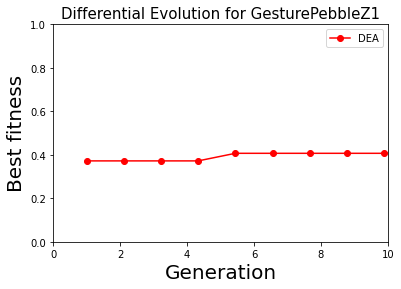

Currently dataset is GesturePebbleZ2
(304, 1, 455)
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
初始化不满足约束，重置当前基因型
完成初始化
保存成功 ./generation/GesturePebbleZ2_0_0.pkl
保存成功 ./generation/GesturePebbleZ2_0_1.pkl
保存成功 ./generation/GesturePebbleZ2_0_2.pkl
保存成功 ./generation/GesturePebbleZ2_0_3.pkl
保存成功 ./generation/GesturePebbleZ2_0_4.pkl
保存成功 ./generation/GesturePebbleZ2_0_5.pkl
保存成功 ./generation/GesturePebbleZ2_0_6.pkl
保存成功 ./generation/GesturePebbleZ2_0_7.pkl
保存成功 ./generation/GesturePebbleZ2_0_8.pkl
保存成功 ./generation/GesturePebbleZ2_0_9.pkl
完成种群记录
第1个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
  

epoch,train_loss,valid_loss,accuracy,time
0,1.837639,1.825529,0.050633,00:00
1,1.838550,1.825432,0.056962,00:00
2,1.838092,1.825218,0.063291,00:00
3,1.839076,1.824925,0.075949,00:00
4,1.835644,1.824602,0.069620,00:00
5,1.832521,1.824334,0.063291,00:00
6,1.826946,1.824131,0.056962,00:00
7,1.823899,1.823853,0.056962,00:00
8,1.821786,1.823477,0.050633,00:00
9,1.816245,1.823074,0.069620,00:00


训练耗时:10
第2个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()


epoch,train_loss,valid_loss,accuracy,time
0,1.784800,1.793598,0.139241,00:00
1,1.784982,1.792787,0.139241,00:00
2,1.789350,1.791890,0.151899,00:00
3,1.784658,1.790249,0.170886,00:00
4,1.781900,1.787946,0.164557,00:00
5,1.776248,1.783920,0.164557,00:00
6,1.770132,1.778152,0.158228,00:00
7,1.762347,1.771239,0.158228,00:00
8,1.753208,1.765606,0.158228,00:00
9,1.741908,1.769699,0.158228,00:00


训练耗时:14
第3个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,1.810649,1.796889,0.151899,00:00
1,1.803955,1.796479,0.139241,00:00
2,1.806166,1.796165,0.120253,00:00
3,1.801665,1.795743,0.132911,00:00
4,1.797380,1.795595,0.132911,00:00
5,1.796723,1.795170,0.126582,00:00
6,1.793226,1.795128,0.132911,00:00
7,1.789574,1.795477,0.126582,00:00
8,1.784867,1.795745,0.132911,00:00
9,1.782099,1.795970,0.120253,00:00


训练耗时:13
第4个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer2): Linear(in_features=128, out_features=8, bias=True)
  (add_layer3): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer4): Linear(in_features=8, out_features=32, bia

epoch,train_loss,valid_loss,accuracy,time
0,1.782724,1.787897,0.164557,00:00
1,1.790973,1.787812,0.170886,00:00
2,1.787550,1.787725,0.164557,00:00
3,1.780372,1.787565,0.164557,00:00
4,1.780953,1.787343,0.170886,00:00
5,1.779140,1.787131,0.177215,00:00
6,1.777437,1.786754,0.177215,00:00
7,1.775899,1.786333,0.177215,00:00
8,1.772796,1.785873,0.183544,00:00
9,1.768938,1.785252,0.189873,00:00


训练耗时:10
第5个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 16, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,1.796117,1.782153,0.170886,00:00
1,1.792293,1.781345,0.221519,00:00
2,1.789891,1.780396,0.240506,00:00
3,1.785466,1.778544,0.246835,00:00
4,1.781209,1.774709,0.227848,00:00
5,1.777664,1.769961,0.196203,00:00
6,1.773701,1.763745,0.164557,00:00
7,1.765049,1.758450,0.158228,00:00
8,1.757520,1.759302,0.158228,00:00
9,1.745341,1.773104,0.158228,00:00


训练耗时:12
第6个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,1.785744,1.809729,0.196203,00:00
1,1.800654,1.809474,0.196203,00:00
2,1.798663,1.809157,0.196203,00:00
3,1.796291,1.808848,0.196203,00:00
4,1.793923,1.808813,0.189873,00:00
5,1.787374,1.808398,0.196203,00:00
6,1.787582,1.807578,0.196203,00:00
7,1.786289,1.807621,0.208861,00:00
8,1.784124,1.805403,0.202532,00:00
9,1.778031,1.803399,0.202532,00:00


训练耗时:13
第7个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  

epoch,train_loss,valid_loss,accuracy,time
0,1.817542,1.818176,0.177215,00:00
1,1.815291,1.815073,0.170886,00:00
2,1.813130,1.813958,0.164557,00:00
3,1.810000,1.813331,0.164557,00:00
4,1.810869,1.811282,0.151899,00:00
5,1.807006,1.808707,0.164557,00:00
6,1.802886,1.808861,0.139241,00:00
7,1.799698,1.806302,0.158228,00:00
8,1.794855,1.804505,0.170886,00:00
9,1.792444,1.801200,0.177215,00:00


训练耗时:11
第8个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )


epoch,train_loss,valid_loss,accuracy,time
0,1.790609,1.797836,0.126582,00:00
1,1.794124,1.795757,0.113924,00:00
2,1.793342,1.795576,0.132911,00:00
3,1.790267,1.795391,0.139241,00:00
4,1.787746,1.795089,0.139241,00:00
5,1.789658,1.794813,0.139241,00:00
6,1.785977,1.794284,0.139241,00:00
7,1.783390,1.793729,0.151899,00:00
8,1.782743,1.793291,0.158228,00:00
9,1.779328,1.792538,0.183544,00:00


训练耗时:13
第9个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): Linear(in_features=128, out_features=16, bias=True)
  (add_layer2): MaxPool1d(kernel_size=3, stride=1, padding=0, dilation=1, ceil_mode=False)
  (add_layer3): Linear(in_features=16, out_features=128, 

epoch,train_loss,valid_loss,accuracy,time
0,1.807671,1.799521,0.145570,00:00
1,1.803692,1.799262,0.151899,00:00
2,1.798850,1.798986,0.151899,00:00
3,1.797012,1.798739,0.158228,00:00
4,1.792736,1.798545,0.151899,00:00
5,1.794149,1.798180,0.164557,00:00
6,1.791672,1.797674,0.151899,00:00
7,1.788648,1.797264,0.158228,00:00
8,1.784535,1.796923,0.158228,00:00
9,1.782089,1.796454,0.139241,00:00


训练耗时:11
第10个个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (0): Conv1d(128, 256, kernel_size=(5,), stride=(1,), padding=(2,), bias=False)
    (1): BatchNorm1d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock3): ConvBlock(
    (0): Conv1d(256, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (add_layer1): ConvBlock(
    (0): Conv1d(128, 8, kernel_size=(3,), stride=(1,), padding=(1,), bias=False)
    (1): BatchNorm1d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )

epoch,train_loss,valid_loss,accuracy,time
0,1.798881,1.799435,0.234177,00:00
1,1.810739,1.799820,0.227848,00:00
2,1.817715,1.799586,0.227848,00:00
3,1.811113,1.798766,0.221519,00:00
4,1.814685,1.798760,0.215190,00:00
5,1.816178,1.798227,0.221519,00:00
6,1.814966,1.797521,0.221519,00:00
7,1.809152,1.796508,0.208861,00:00
8,1.805306,1.796038,0.196203,00:00
9,1.801991,1.794494,0.215190,00:00


训练耗时:13

Generation 1
(10, 15, 2)
Mutate 完成
Crossover完成
保存成功./generation/GesturePebbleZ2_1_0.pkl
保存成功./generation/GesturePebbleZ2_1_1.pkl
保存成功./generation/GesturePebbleZ2_1_2.pkl
保存成功./generation/GesturePebbleZ2_1_3.pkl
保存成功./generation/GesturePebbleZ2_1_4.pkl
保存成功./generation/GesturePebbleZ2_1_5.pkl
保存成功./generation/GesturePebbleZ2_1_6.pkl
保存成功./generation/GesturePebbleZ2_1_7.pkl
保存成功./generation/GesturePebbleZ2_1_8.pkl
保存成功./generation/GesturePebbleZ2_1_9.pkl
完成种群记录
Parent_fitness: [[0.17721519]
 [0.47468355]
 [0.18354431]
 [0.22151899]
 [0.23417722]
 [0.21518987]
 [0.15822785]
 [0.16455697]
 [0.2278481 ]
 [0.20253165]]
第1个变异个体
455
NewModel
NewModel(
  (rnn): LSTM(455, 100, batch_first=True)
  (rnn_dropout): Dropout(p=0.8, inplace=False)
  (convblock1): ConvBlock(
    (0): Conv1d(1, 128, kernel_size=(7,), stride=(1,), padding=(3,), bias=False)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (convblock2): ConvBlock(
    (

epoch,train_loss,valid_loss,accuracy,time
0,1.792121,1.785905,0.208861,00:00
1,1.792716,1.784784,0.208861,00:00
2,1.795160,1.783457,0.202532,00:00
3,1.784329,1.781903,0.196203,00:00
4,1.781689,1.779738,0.202532,00:00
5,1.782730,1.776893,0.215190,00:00
6,1.778973,1.773812,0.227848,00:00
7,1.778328,1.770637,0.240506,00:00
8,1.772668,1.767689,0.259494,00:00
9,1.764675,1.764207,0.246835,00:00


In [ ]:
# coding:UTF-8
# V2, LSTM-FCN Imporve
# 3.11.2022 run data, GPU

from __future__ import division
from numpy import *
import random as rd
import pandas as pd
import pickle

NP = 10
size = 15
xMin = -10
xMax = 10
F = 0.8
CR = 0.5
LAYER_THRESHOLD = 0.9
GEN_MAX = 10
TRAIN_EPOCHES = 100

# 神经结构的参数设置
Convolution = [8, 16, 32, 64, 128, 256]
# ZeroOp, 默认
# MaxPooling, 默认
# Dropout, 0-0.5之间
# Activate = {1: 'softmax', 2: 'elu', 3: 'Relu', 4: 'selu', 5: 'sigmoid'}
Activate = ['softmax', 'elu', 'Relu', 'selu', 'sigmoid']
Dense = [8, 16, 32, 64, 128, 256]



# all_dataset = ['ACSF1', 'Adiac', 'AllGestureWiimoteX', 'AllGestureWiimoteY', 'AllGestureWiimoteZ', 
#                'ArrowHead', 'Beef', 'BeetleFly', 'BirdChicken', 'BME', 'Car', 'CBF', 'Chinatown', 
#                'ChlorineConcentration', 'CinCECGTorso', 'Coffee', 'Computers', 'CricketX', 'CricketY', 
#                'CricketZ', 'Crop', 'DiatomSizeReduction', 'DistalPhalanxOutlineAgeGroup', 
#                'DistalPhalanxOutlineCorrect', 'DistalPhalanxTW', 'DodgerLoopDay', 'DodgerLoopGame', 
#                'DodgerLoopWeekend', 'Earthquakes', 'ECG200', 'ECG5000', 'ECGFiveDays', 'ElectricDevices', 
#                'EOGHorizontalSignal', 'EOGVerticalSignal', 'EthanolLevel', 'FaceAll', 'FaceFour', 'FacesUCR', 
#                'FiftyWords', 'Fish', 'FordA', 'FordB', 'FreezerRegularTrain', 'FreezerSmallTrain', 'Fungi', 
#                'GestureMidAirD1', 'GestureMidAirD2', 'GestureMidAirD3', 'GesturePebbleZ1', 'GesturePebbleZ2', 
#                'GunPoint', 'GunPointAgeSpan', 'GunPointMaleVersusFemale', 'GunPointOldVersusYoung', 'Ham', 
#                'HandOutlines', 'Haptics', 'Herring', 'HouseTwenty', 'InlineSkate', 'InsectEPGRegularTrain', 
#                'InsectEPGSmallTrain', 'InsectWingbeatSound', 'ItalyPowerDemand', 'LargeKitchenAppliances', 
#                'Lightning2', 'Lightning7', 'Mallat', 'Meat', 'MedicalImages', 'MelbournePedestrian', 
#                'MiddlePhalanxOutlineAgeGroup', 'MiddlePhalanxOutlineCorrect', 'MiddlePhalanxTW', 
#                'MixedShapesRegularTrain', 'MixedShapesSmallTrain', 'MoteStrain', 'NonInvasiveFetalECGThorax1', 
#                'NonInvasiveFetalECGThorax2', 'OliveOil', 'OSULeaf', 'PhalangesOutlinesCorrect', 'Phoneme', 
#                'PickupGestureWiimoteZ', 'PigAirwayPressure', 'PigArtPressure', 'PigCVP', 'PLAID', 'Plane', 
#                'PowerCons', 'ProximalPhalanxOutlineAgeGroup', 'ProximalPhalanxOutlineCorrect', 'ProximalPhalanxTW', 
#                'RefrigerationDevices', 'Rock', 'ScreenType', 'SemgHandGenderCh2', 'SemgHandMovementCh2', 
#                'SemgHandSubjectCh2', 'ShakeGestureWiimoteZ', 'ShapeletSim', 'ShapesAll', 'SmallKitchenAppliances', 
#                'SmoothSubspace', 'SonyAIBORobotSurface1', 'SonyAIBORobotSurface2', 'StarLightCurves', 'Strawberry', 
#                'SwedishLeaf', 'Symbols', 'SyntheticControl', 'ToeSegmentation1', 'ToeSegmentation2', 'Trace', 
#                'TwoLeadECG', 'TwoPatterns', 'UMD', 'UWaveGestureLibraryAll', 'UWaveGestureLibraryX', 
#                'UWaveGestureLibraryY', 'UWaveGestureLibraryZ', 'Wafer', 'Wine', 'WordSynonyms', 'Worms', 
#                'WormsTwoClass', 'Yoga']


# 完成的数据集: 'ACSF1', 'Adiac', 'ArrowHead', 'Beef', 'BeetleFly', 'BirdChicken', 'BME', 'Car', 'CBF', 'Chinatown', 'ChlorineConcentration', 
#             'CinCECGTorso', 'Coffee', 'Computers', 'CricketX', 'CricketY', 'CricketZ', 'DiatomSizeReduction', 'DistalPhalanxOutlineAgeGroup', 
#             'DistalPhalanxOutlineCorrect', 'DistalPhalanxTW','Earthquakes', 'ECG200', 'ECG5000', 'ECGFiveDays', 'EOGHorizontalSignal', 
#             'EOGVerticalSignal', 'EthanolLevel','FaceAll', 'FaceFour', 'FacesUCR', 'FiftyWords', 'Fish', 'FordA', 'FreezerRegularTrain', 'FreezerSmallTrain', 'Fungi', 
#             'GunPoint','GunPointAgeSpan', 'GunPointMaleVersusFemale', 'GunPointOldVersusYoung', 'Ham', 
#             'HandOutlines', 'Haptics', 'Herring', 'HouseTwenty', 'InlineSkate', 'InsectEPGRegularTrain', 'InsectEPGSmallTrain', 'InsectWingbeatSound', 'ItalyPowerDemand', 'LargeKitchenAppliances',             
#             'Lightning2', 'Lightning7', 'Mallat', 'Meat', 'MedicalImages',  'MiddlePhalanxOutlineAgeGroup', 'MiddlePhalanxOutlineCorrect',  'MiddlePhalanxTW',  
#             'MixedShapesRegularTrain', 'MixedShapesSmallTrain', 'MoteStrain', 'NonInvasiveFetalECGThorax1','OliveOil', 'OSULeaf', 'PhalangesOutlinesCorrect', 'Phoneme', 
#             'PigAirwayPressure', 'PigArtPressure', 'PigCVP',  'Plane', 'PowerCons', 'ProximalPhalanxOutlineAgeGroup', 'ProximalPhalanxOutlineCorrect', 'ProximalPhalanxTW', 
#             'RefrigerationDevices', 'Rock', 'ScreenType', 'SemgHandGenderCh2', 'SemgHandMovementCh2', 'SemgHandSubjectCh2', 
#             'ShapeletSim', 'ShapesAll', 'SmallKitchenAppliances', 'SmoothSubspace', 'SonyAIBORobotSurface1', 'SonyAIBORobotSurface2', 'Strawberry', 
#             'SwedishLeaf', 'Symbols', 'SyntheticControl', 'ToeSegmentation1', 'ToeSegmentation2', 'Trace', 'TwoLeadECG', 'TwoPatterns', 'UMD',
#             'UWaveGestureLibraryX', 'UWaveGestureLibraryY', 'UWaveGestureLibraryZ', 'Wafer', 'Wine', 'WordSynonyms', 'Worms', 'WormsTwoClass', 'Yoga'
#             'AllGestureWiimoteX', 'AllGestureWiimoteY', 'AllGestureWiimoteZ',                
#             
#             
#             
# 异常数据集:    'AllGestureWiimoteX', 'AllGestureWiimoteY', 'AllGestureWiimoteZ', 'DodgerLoopDay', 'DodgerLoopGame', 'DodgerLoopWeekend', 
#              'GestureMidAirD1', 'GestureMidAirD2', 'GestureMidAirD3', 'GesturePebbleZ1', 'GesturePebbleZ2', 'PickupGestureWiimoteZ', 'PLAID',
#              'ShakeGestureWiimoteZ', 'MelbournePedestrian',
#           
# 没跑完的数据集: 'Crop', 'ElectricDevices', 'FordB', 'NonInvasiveFetalECGThorax2', 'StarLightCurves', 'UWaveGestureLibraryAll', 


dataset_with_nan = ['AllGestureWiimoteX', 'AllGestureWiimoteY', 'AllGestureWiimoteZ', 'DodgerLoopDay', 'DodgerLoopGame', 'DodgerLoopWeekend', 
             'GestureMidAirD1', 'GestureMidAirD2', 'GestureMidAirD3', 'GesturePebbleZ1', 'GesturePebbleZ2', 'PickupGestureWiimoteZ', 'PLAID',
             'ShakeGestureWiimoteZ', 'MelbournePedestrian',]


all_dataset = ['DodgerLoopDay', 'DodgerLoopGame', 'DodgerLoopWeekend', 
             'GestureMidAirD1', 'GestureMidAirD2', 'GestureMidAirD3', 'GesturePebbleZ1', 'GesturePebbleZ2', 'PickupGestureWiimoteZ', 'PLAID',
             'ShakeGestureWiimoteZ', 'MelbournePedestrian',]


# 优点：可以并行计算，可以模拟nature中的进化规律，获得constraint 之外的结构


# 翻译此时的结构
def translate_architecture(Individual, display=False):
    m, n = shape(Individual)
    Actual_structure = zeros((m, n))
    layers = []
    # 15 * 2
    for i in range(m):
        # Conv layer
        if Individual[i][0] == 0:
            single_layer = ["conv"]
            single_layer.append(Convolution[int(Individual[i][1] * 6)])
            Actual_structure[i] = [Individual[i][0], int(Individual[i][1] * 6)]
        # ZeroOp layer
        elif Individual[i][0] == 1:
            single_layer = ["ZeroOp"]
            single_layer.append("Default")
            Actual_structure[i] = [Individual[i][0], Individual[i][1]]
        # Maxpooling layer
        elif Individual[i][0] == 2:
            single_layer = ["Maxpooling"]
            single_layer.append("Default")
            Actual_structure[i] = [Individual[i][0], Individual[i][1]]
        # Dropout layer
        elif Individual[i][0] == 3:
            single_layer = ["Dropout"]
            single_layer.append(0.5*Individual[i][1])
            Actual_structure[i] = [Individual[i][0], 0.5*Individual[i][1]]
        # Activate layer
        elif Individual[i][0] == 4:
            single_layer = ["Activate"]
            single_layer.append(Activate[int(Individual[i][1] * 5)])
            Actual_structure[i] = [Individual[i][0], int(Individual[i][1] * 5)]
        # Dense layer
        elif Individual[i][0] == 5:
            single_layer = ["Dense"]
            single_layer.append(Dense[int(Individual[i][1] * 6)])
            Actual_structure[i] = [Individual[i][0], int(Individual[i][1] * 6)]
        layers.append(single_layer)
    if display:
        print(f"structure is {layers}")
    return Actual_structure


def checkifweak(Individual):
    # 判断此时是否已经是弱基因
    # Add basic constraint

    m, n = shape(Individual)
    for i in range(m - 1):
        # 如果此时是两个连续的下采样就返回true
        if Individual[i][0] == 2 and Individual[i + 1][0] == 2:
            return True
        # 如果此时是两个连续的激活函数就返回True
        elif Individual[i][0] == 4 and Individual[i + 1][0] == 4:
            return True
        # 如果此时是两个相邻的FCN，同时有一个降维特别大，就返回True
        elif Individual[i][0] == 5 and Individual[i + 1][0] == 5:
            if Individual[i][1] < 0.5 or Individual[i + 1][1] < 0.5:
              return True
    return False


# 通过此时的基因型获取模型
def GetModel(Phenotype, dls):    
    m, n = shape(Phenotype)
    arch = NewModel
    model = create_model(arch, dls=dls, Phenotype=Phenotype)
    # arch = LSTM_FCN
    # model = create_model(arch, dls=dls)
    print(arch.__name__)
    print(model)
    return model


# 获取单个个体的基因型对应的适应度(Pred)
def getPred(Phenotype, dls):
    
    # 训练
    model = GetModel(Phenotype, dls)
    
    learn = Learner(dls, model,  metrics=accuracy)
    start = time.time()
    learn.fit_one_cycle(TRAIN_EPOCHES, 1e-3)
    elapsed = time.time() - start
    vals = learn.recorder.values[-1]
    print(f"训练耗时:{int(elapsed)}")
    # vals 的结构：val[3] = ["train loss", "valid loss", "accuracy"]
    return vals[2]


# 计算适应值函数
def calFitness(Individual, dls):
    # Translate Individual Architecture
    # 目标: pred
    # Phenotype = translate_architecture(Individual, display=True)
    Phenotype = translate_architecture(Individual)
    fitness = getPred(Phenotype, dls)
    return fitness


# 变异函数
def mutation(X_Parent, F, LAYER_THRESHOLD):
    # Mutate for Neural network
    print(shape(X_Parent))
    m, n, k = shape(X_Parent)
    # print()
    XMutationTmp = zeros((m, n, k))

    # 对于此时来说，需要额外设定一个layer_rate, 如果大于layer_rate，那么就mutate，layer，如果小于layer_rate，调整parameter。

    count = 0

    for i in range(m):
      # 需要调整，此时的r1应该删掉，随后改成其他的
        r1 = 0
        r2 = 0
        r3 = 0
        while r1 == i or r2 == i or r3 == i or r1 == r2 or r1 == r3 or r2 == r3:
            r1 = rd.randint(0, m - 1)
            r2 = rd.randint(0, m - 1)
            r3 = rd.randint(0, m - 1)

        for j in range(n):
            # 如果需要修改layer
            layer_change = rd.random()
            if (layer_change > LAYER_THRESHOLD):
                changed_layer = rd.randint(0, 5)
                XMutationTmp[i, j] = [changed_layer, rd.random()]
                continue

            # 如果不需要修改layer， 这里会有点担心会产生越界

            # 首先要看一下此时是不是同一类的r1, r2, r3，因为真的太严格了，所以就是说mutate也要考虑基因突变
            # 如果r1、r2都满足的话，就可以按照操作开始变换。
            if X_Parent[r1, j, 0] == X_Parent[r2, j, 0] or X_Parent[r1, j, 0] == X_Parent[r3, j, 0]:
                # 用6完成一次取余操作
                XMutationTmp[i, j] = [X_Parent[r1, j, 0], (X_Parent[r1, j, 1] + F * (X_Parent[r2, j, 1] - X_Parent[r3, j, 1])) % 1]
                # print("差分操作完成", count)
                # count += 1
            else:
                XMutationTmp[i, j] = X_Parent[i, j]
    # print()
    return XMutationTmp


# 交叉函数
def crossover(X_Parent, XMutationTmp, CR):
    # Binomial strategy
    # 按照CR crossrate完成修正增

    m, n, k = shape(X_Parent)
    X_Crossover = zeros((m, n, k))

    for i in range(m):
        for j in range(n):
            r = rd.random()
            if r <= CR:
                X_Crossover[i, j] = XMutationTmp[i, j]
            else:
                X_Crossover[i, j] = X_Parent[i, j]
    return X_Crossover


# 选择函数
def selection(X_Parent, XCrossover, fitnessVal, dls):
    # 从母代和子代中选取最高适应度的个体
    # 同时增加constraint机制，如果出现了低性状变异，就不需要测试其适应度

    m, n, k = shape(X_Parent)
    print("Parent_fitness:", fitnessVal)
    fitnessCrossOverVal = zeros((m, 1))
    for i in range(m):
        print(f"第{i + 1}个变异个体")

        if checkifweak(XCrossover[i]):
            print("子代个体基因型受限")
            print("Parent Better")
            continue

        fitnessCrossOverVal[i, 0] = calFitness(XCrossover[i], dls)
        if (fitnessCrossOverVal[i, 0] > fitnessVal[i, 0]):
            print("Mutate better")
            for j in range(n):
                X_Parent[i, j] = XCrossover[i, j]
            fitnessVal[i, 0] = fitnessCrossOverVal[i, 0]
        else:    
            print("Parent Better")
    return X_Parent, fitnessVal


# 保存最佳函数
def saveBest(XTemp, fitnessVal, round, dataset, dls):
    m = shape(fitnessVal)[0]
    print("After selection", fitnessVal)
    tmp = 0
    for i in range(1, m):
        if (fitnessVal[tmp] < fitnessVal[i]):
            tmp = i


    print("Round Best:")
    print(fitnessVal[tmp][0])
    best_individual_phenotype = translate_architecture(XTemp[tmp], display=True)

    model = GetModel(best_individual_phenotype, dls)
    
    if not os.path.exists("./model"):
        os.makedirs("./model") # 如果不存在目录figure_save_path，则创建

    torch.save(model, f"./model/{dataset}_{round}_{fitnessVal[tmp][0]}.pkl")

    if not os.path.exists("./genotype"):
        os.makedirs("./genotype") # 如果不存在目录figure_save_path，则创建

    np.save(f"./genotype/{dataset}_{round}_{fitnessVal[tmp][0]}.pkl", XTemp[tmp], allow_pickle=True)
    
    return fitnessVal[tmp][0]


# Differential_Evolution_Algorithm
def DEA(dsid, dls):
    # 初始化
    XTemp = zeros((NP, size, 2))
    # 构造对应的NP = 50, 基因长度size = 15, 每个size里包含的一个超参数，长度为2

    for i in range(NP):
        if checkifweak(XTemp[i - 1]):
            i -= 1
            print("初始化不满足约束，重置当前基因型")
        for j in range(size):
            # 初始化规则：对于每个XTemp[i, j]，[x, y]相当于初始化此时的类型x以及参数y
            # Conv的类型:          0; Conv的参数: [8, 16, 32, 64, 128, 256]; 一共6个参数，在乘以对应比例后截取整数部
            # ZeroOP的类型:        1; 没有参数
            # Maxpooling的类型:    2; MaxPooling，没有参数
            # Dropout的类型:       3; Dropout的参数: [0, 0.5]; random后乘以0.5
            # Activate的类型:      4; Activate的参数: ['softmax', 'elu', 'Relu', 'selu', 'sigmoid']; 5个参数，random后乘比例
            # Dense的类型:         5; Dense的参数: [4, 16, 32, 64, 128, 256]; 6个参数, random后乘比例。
            type = rd.randint(0, 5)
            XTemp[i, j] = [type, rd.random()]
        
    print("完成初始化")
    

    if not os.path.exists("./generation"):
        os.makedirs("./generation") # 如果不存在目录figure_save_path，则创建
        
    for individual in range(NP):
        np.save(f"./generation/{dsid}_0_{individual}.pkl", XTemp[individual], allow_pickle=True)
        print(f"保存成功 ./generation/{dsid}_0_{individual}.pkl")
    print("完成种群记录")

    
    
    # 计算初始适应值
    fitnessVal = zeros((NP, 1))
    for i in range(NP):
        print(f"第{i + 1}个个体")
        fitnessVal[i, 0] = calFitness(XTemp[i], dls)

    acc_map = []
    fitness_for_record = np.empty(shape=(NP, 1))

    gen = 1
    while gen <= GEN_MAX:
        print("")
        print(f"Generation {gen}")
        
        # mutate完成
        XMutationTmp = mutation(XTemp, F, LAYER_THRESHOLD)
        print("Mutate 完成")
        # translate_architecture(XMutationTmp[0], display=True)

        print("Crossover完成")
        XCrossover = crossover(XTemp, XMutationTmp, CR)
        # translate_architecture(XCrossover[0], display=True)

        # 保存每一代个体
        if not os.path.exists("./generation"):
            os.makedirs("./generation") # 如果不存在目录figure_save_path，则创建
        
        for individual in range(NP):
            np.save(f"./generation/{dsid}_{gen}_{individual}.pkl", XCrossover[individual], allow_pickle=True)
            print(f"保存成功./generation/{dsid}_{gen}_{individual}.pkl")
        
        print("完成种群记录")

        XTemp, fitnessVal = selection(XTemp, XCrossover, fitnessVal, dls)
        print("Select完成")
        # calFitness(XCrossover[0])
        best_acc = saveBest(XTemp, fitnessVal, gen, dsid, dls)

        acc_map.append(best_acc)
        # fitness_for_record.append(fitnessVal)
        fitness_for_record = np.append(fitness_for_record, fitnessVal, axis=1)

        gen += 1
    print(fitness_for_record)
    test = pd.DataFrame(data=fitness_for_record)
    print("以下是原始数据")
    print(test)
    test.to_csv(f'./{dsid}_raw_data.csv',encoding='gbk')

    return acc_map




# # 正文代码----------------

if __name__ == '__main__':


    dataset_acc = []
    for dsid in all_dataset:
        print(f"Currently dataset is {dsid}")
        bs = 64
        X, y, splits = get_UCR_data(dsid, return_split=False)
        print(X.shape)
        tfms  = [None, [Categorize()]]
        dsets = TSDatasets(X, y, tfms=tfms, splits=splits)
        
        if dsid in dataset_with_nan:
            batch_transforms = [TSStandardize(by_sample=True), Nan2Value()]
            dls   = TSDataLoaders.from_dsets(dsets.train, dsets.valid, bs=[bs, bs*2], batch_tfms=batch_transforms)
        else:
            dls   = TSDataLoaders.from_dsets(dsets.train, dsets.valid, bs=[bs, bs*2])


        dataset_best_acc = DEA(dsid, dls)

        # 作图
        
        x = np.linspace(1, GEN_MAX + 1, GEN_MAX)
        plt.figure(figsize=(6, 4))# 新建一个图像，设置图像大小
        plt.plot(x, dataset_best_acc, 'ro-', label='DEA')# 设置颜色、标记符号、线型、图例标签
        plt.title(f'Differential Evolution for {dsid}', fontsize=15)# 标题
        plt.xlim(0, GEN_MAX)# x轴范围
        plt.ylim(0, 1)# y轴范围
        plt.xlabel('Generation', fontsize=20)# x轴标签
        plt.ylabel('Best fitness', fontsize=20)# y轴标签
        plt.legend(loc='best')# 图例
        if not os.path.exists("./svg"):
            os.makedirs("./svg") # 如果不存在目录figure_save_path，则创建
        plt.savefig(f'./svg/{dsid}.svg',format='svg')
        plt.show()  

        # 保存此时的raw_data
        dataset_acc.append(dataset_best_acc)
    forsave = pd.DataFrame(data=dataset_acc)
    forsave.to_csv("./overall.csv", encoding='gbk')




    